<a href="https://colab.research.google.com/github/AdrianMartinezCode/python_machine_learning_collabs/blob/main/hotel_booking_ml.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
import pandas as pd

# Replace 'path_to_your_file.csv' with the actual path of your CSV file
file_path = '/content/drive/My Drive/Colab Notebooks/exercises/booking.csv'
df = pd.read_csv(file_path)

# Now you can work with the dataframe 'df'


Official page where I extracted the dataset:
https://www.kaggle.com/datasets/youssefaboelwafa/hotel-booking-cancellation-prediction/data

**Text**:
Welcome to the Hotel Booking Cancellation Prediction dataset, a comprehensive collection of data aimed at predicting hotel booking cancellations. This dataset is ideal for data scientists, researchers, and machine learning enthusiasts seeking to develop models that can accurately forecast the likelihood of hotel reservation cancellations.

Dataset Overview:
This dataset comprises a diverse range of features, including booking details, customer information, and reservation specifics. The information has been meticulously gathered from real-world hotel booking scenarios, ensuring authenticity and relevance for predictive modeling.

**Booking_ID**:
Unique identifier for each booking

**number of adults**: Number of adults included in the booking

**number of children**: Number of children included in the booking

**number of weekend nights**: Number of weekend nights included in the booking

**number of week nights**: Number of week nights included in the booking

**type of meal**: Type of meal included in the booking

**car parking space**: Indicates whether a car parking space was requested or included in the booking

**room type**: Type of room booked

**lead time**: Number of days between the booking date and the arrival date

**market segment type**: Type of market segment associated with the booking

In this sheet we want to predict if the reservation will be cancelled in any moment or not.

In [7]:
print(df.columns)

Index(['Booking_ID', 'number of adults', 'number of children',
       'number of weekend nights', 'number of week nights', 'type of meal',
       'car parking space', 'room type', 'lead time', 'market segment type',
       'repeated', 'P-C', 'P-not-C', 'average price', 'special requests',
       'date of reservation', 'booking status'],
      dtype='object')


In [8]:
print(df.head(3))

  Booking_ID  number of adults  number of children  number of weekend nights  \
0   INN00001                 1                   1                         2   
1   INN00002                 1                   0                         1   
2   INN00003                 2                   1                         1   

   number of week nights  type of meal  car parking space    room type  \
0                      5   Meal Plan 1                  0  Room_Type 1   
1                      3  Not Selected                  0  Room_Type 1   
2                      3   Meal Plan 1                  0  Room_Type 1   

   lead time market segment type  repeated  P-C  P-not-C  average price  \
0        224             Offline         0    0        0          88.00   
1          5              Online         0    0        0         106.68   
2          1              Online         0    0        0          50.00   

   special requests date of reservation booking status  
0                 0     

# PREPROCESSING


In [9]:
for c in df.columns:
  print(f"Unique values in '{c}': {df[c].unique()}")

Unique values in 'Booking_ID': ['INN00001' 'INN00002' 'INN00003' ... 'INN36284' 'INN36285' 'INN36286']
Unique values in 'number of adults': [1 2 3 0 4]
Unique values in 'number of children': [ 1  0  2  3 10  9]
Unique values in 'number of weekend nights': [2 1 0 4 3 6 5 7]
Unique values in 'number of week nights': [ 5  3  2  4  0  1 10  6 11  7 15  9 13  8 14 12 17 16]
Unique values in 'type of meal': ['Meal Plan 1' 'Not Selected' 'Meal Plan 2' 'Meal Plan 3']
Unique values in 'car parking space': [0 1]
Unique values in 'room type': ['Room_Type 1' 'Room_Type 4' 'Room_Type 2' 'Room_Type 6' 'Room_Type 5'
 'Room_Type 7' 'Room_Type 3']
Unique values in 'lead time': [224   5   1 211  48 346  34  83 121  44   0  35  30  95  47 256  99  12
 122   2  37 130  60  56   3 107  72  23 289 247 186  64  96  41  55 146
  32  57   7 124 169   6  51  13 100 139 117  39  86  19 192 179  26  74
 143 177  18 267 155  46 128  20  40 196 188  17 110  68  73  92 171 134
 320 118 189  16  24   8  10 182 116 12

In [10]:
# Iterate over each column and print the count of missing values
for column in df.columns:
    missing_values = df[column].isnull().sum()
    print(f"Number of missing values in '{column}': {missing_values}")

Number of missing values in 'Booking_ID': 0
Number of missing values in 'number of adults': 0
Number of missing values in 'number of children': 0
Number of missing values in 'number of weekend nights': 0
Number of missing values in 'number of week nights': 0
Number of missing values in 'type of meal': 0
Number of missing values in 'car parking space': 0
Number of missing values in 'room type': 0
Number of missing values in 'lead time': 0
Number of missing values in 'market segment type': 0
Number of missing values in 'repeated': 0
Number of missing values in 'P-C': 0
Number of missing values in 'P-not-C': 0
Number of missing values in 'average price': 0
Number of missing values in 'special requests': 0
Number of missing values in 'date of reservation': 0
Number of missing values in 'booking status': 0


No missing values. Let's transform the different fields to numeric.

In [11]:
import matplotlib.pyplot as plt
import seaborn as sns

In [12]:
def plot_column(column, df):
  if pd.api.types.is_numeric_dtype(df[column]):
    # Histogram
    sns.histplot(df[column], kde=True)
    plt.title(f'Histogram of {column}')
    plt.show()

    # Box Plot
    sns.boxplot(x=df[column])
    plt.title(f'Box Plot of {column}')
    plt.show()

  # If the column is non-numeric
  else:
      # Bar Chart of value counts
      df[column].value_counts().plot(kind='bar')
      plt.title(f'Bar Chart of {column}')
      plt.ylabel('Frequency')
      plt.show()

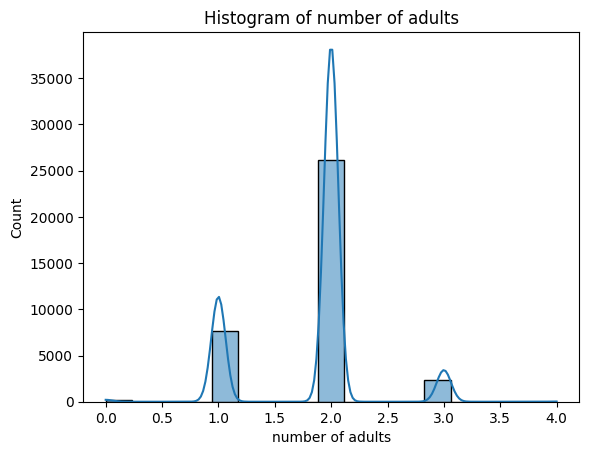

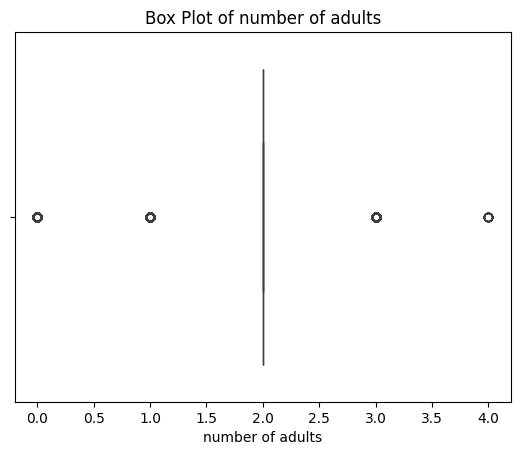

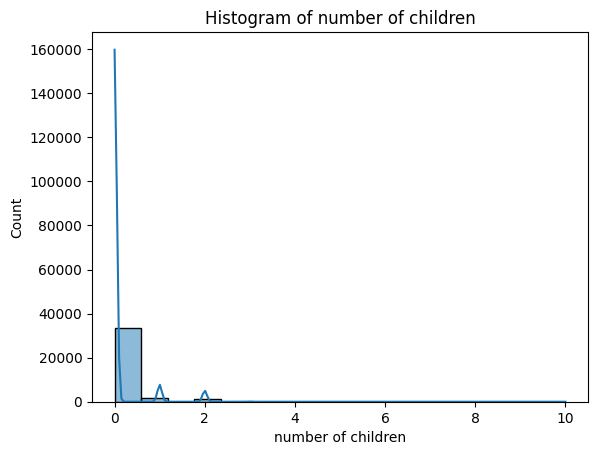

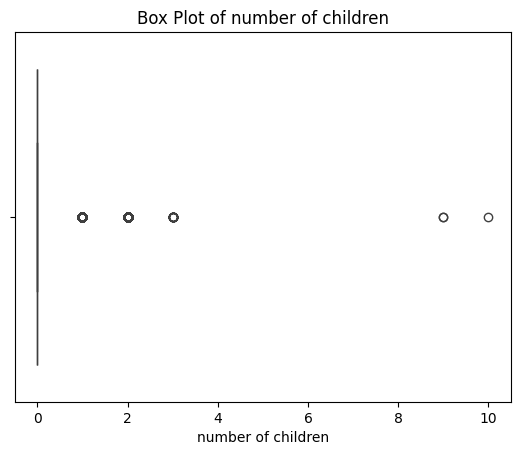

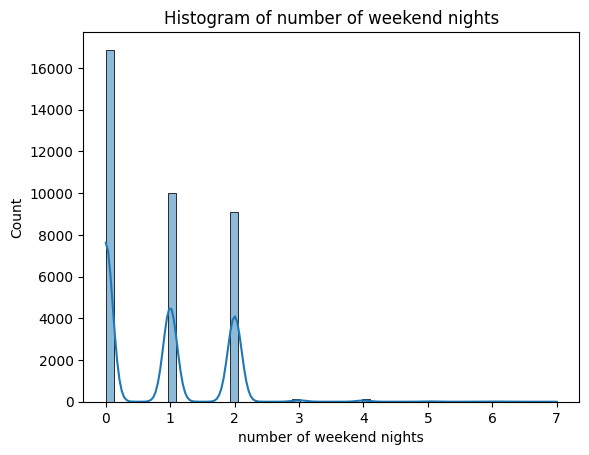

...

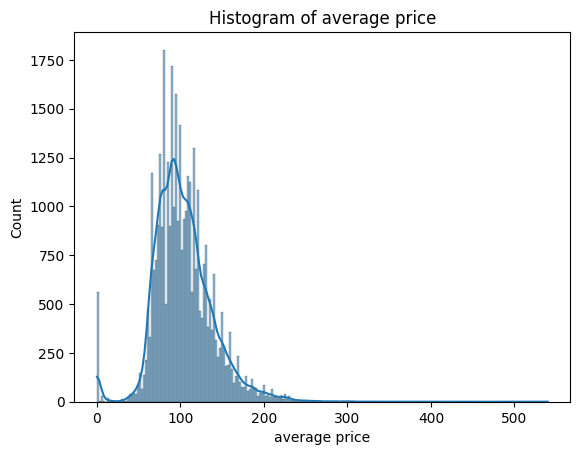

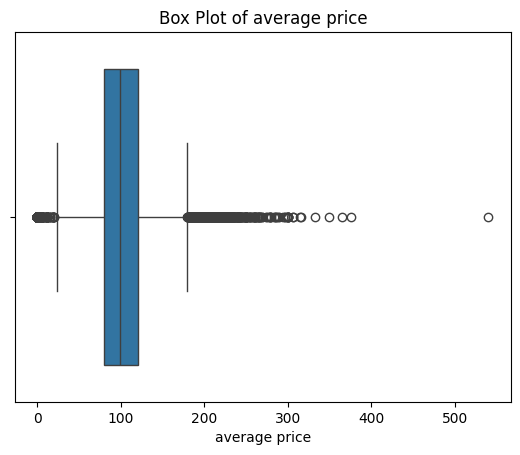

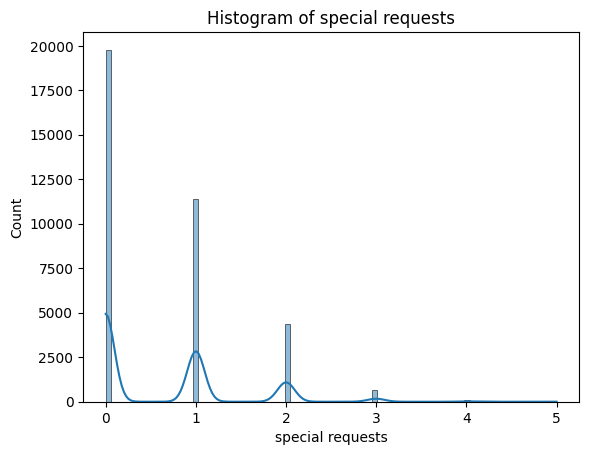

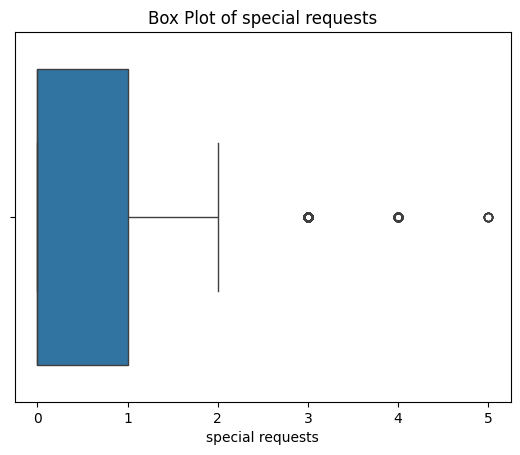

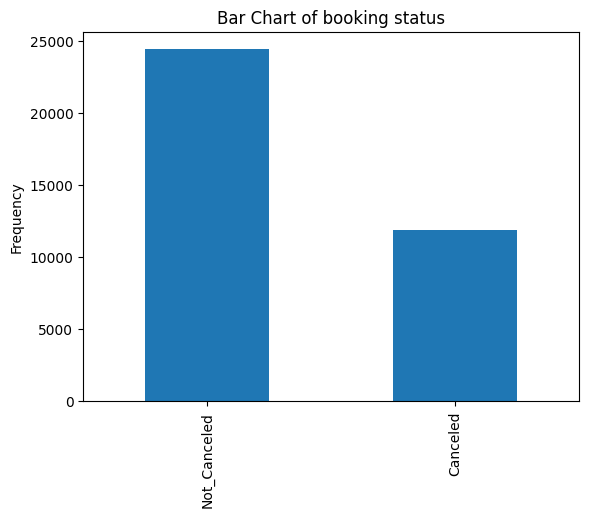

In [13]:
# Loop through each column
for column in df.columns:
    # Check if the column is numeric
    if not column == 'Booking_ID' and not column == 'date of reservation':
      plot_column(column, df)


Transformation of categorical values into numerical features.

We use one hot encoding instead of using a bijective function because if we assign a one number inside a range in a one variable we are making a certain order which can lead to confuse the model.

It is a better practice to use the one hot encoding and increase the dimensionality of the overall feature vectors.

This is not valid for all categorical variables, for example the number of children is a categorical variable and follows a certain order, it is more probable that the reservation will includes 2 children than 10.

In [14]:
# type of meal into one hot encoding
type_of_meal_encoded = pd.get_dummies(df['type of meal'], prefix='type of meal')
print(type_of_meal_encoded)
df = df.join(type_of_meal_encoded)

       type of meal_Meal Plan 1  type of meal_Meal Plan 2  \
0                             1                         0   
1                             0                         0   
2                             1                         0   
3                             1                         0   
4                             0                         0   
...                         ...                       ...   
36280                         0                         1   
36281                         1                         0   
36282                         1                         0   
36283                         1                         0   
36284                         1                         0   

       type of meal_Meal Plan 3  type of meal_Not Selected  
0                             0                          0  
1                             0                          1  
2                             0                          0  
3                      

In [15]:
# room_type into one hot encoding
room_type_encoded = pd.get_dummies(df['room type'], prefix='room type')
print(room_type_encoded)
df = df.join(room_type_encoded)

       room type_Room_Type 1  room type_Room_Type 2  room type_Room_Type 3  \
0                          1                      0                      0   
1                          1                      0                      0   
2                          1                      0                      0   
3                          1                      0                      0   
4                          1                      0                      0   
...                      ...                    ...                    ...   
36280                      1                      0                      0   
36281                      1                      0                      0   
36282                      0                      0                      0   
36283                      1                      0                      0   
36284                      0                      0                      0   

       room type_Room_Type 4  room type_Room_Type 5  room type_

In [16]:
# market segment type into one hot encoding
market_segment_type_encoded = pd.get_dummies(df['market segment type'], prefix='market segment type')
print(market_segment_type_encoded)
df = df.join(market_segment_type_encoded)

       market segment type_Aviation  market segment type_Complementary  \
0                                 0                                  0   
1                                 0                                  0   
2                                 0                                  0   
3                                 0                                  0   
4                                 0                                  0   
...                             ...                                ...   
36280                             0                                  0   
36281                             0                                  0   
36282                             0                                  0   
36283                             0                                  0   
36284                             0                                  0   

       market segment type_Corporate  market segment type_Offline  \
0                                  0      

In [17]:
# Create a mapping from categories to integers
booking_status_map = {category: idx for idx, category in enumerate(df['booking status'].unique())}
df['booking status encoded'] = df['booking status'].map(booking_status_map)

In [18]:
# removal of non relevant columns to fit the model
del df['Booking_ID']
del df['type of meal']
del df['room type']
del df['market segment type']
del df['booking status']

# date of reservation won't provide any relevant information to the model,
# maybe the density of reservations in time, it's hard to map to any resevration
# function instead of dates, to simplify we will delete this variabel
del df['date of reservation']

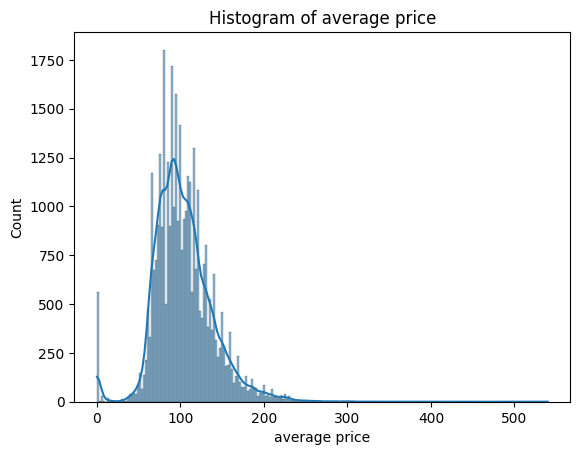

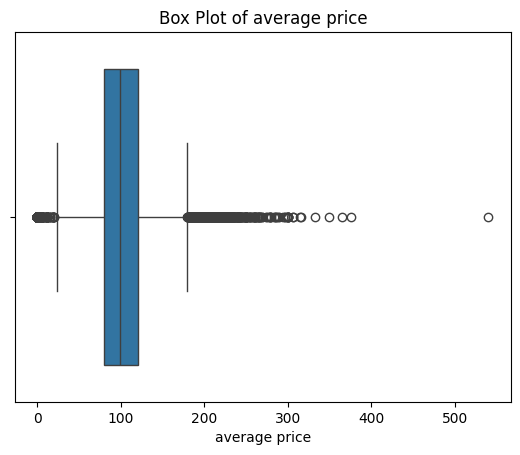

In [19]:
plot_column('average price', df)

We can see that the average price has too many zeroes, we can try to predict these...

In [20]:
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split

# Splitting the data into rows with zeros and without zeros
df_with_zeros = df[df['average price'] == 0]
df_without_zeros = df[df['average price'] != 0]

# Splitting into features (X) and target (y)
X = df_without_zeros.drop('average price', axis=1)
y = df_without_zeros['average price']

# Train-Test Split for model validation (optional)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Creating and training the regression model
model = LinearRegression()
model.fit(X_train, y_train)

# Predicting the zero values
predicted_values = model.predict(df_with_zeros.drop('average price', axis=1))

# Replace zeros in the original DataFrame
df.loc[df['average price'] == 0, 'average price'] = predicted_values

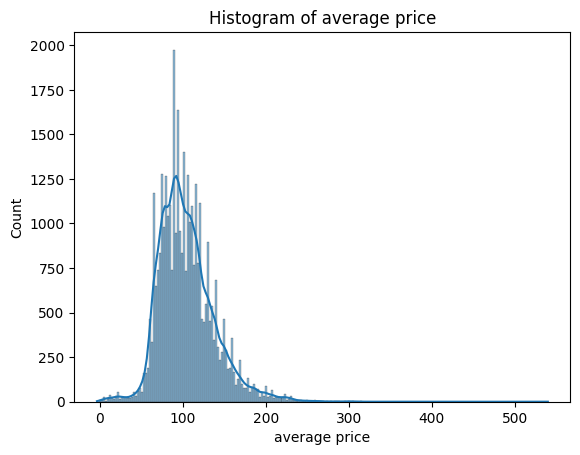

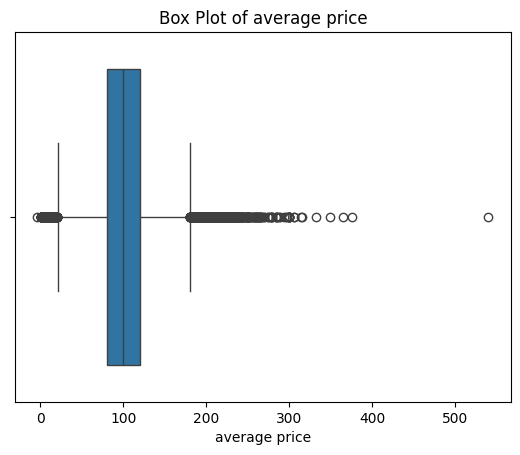

In [21]:
# Check again the average price, we can see that the zeroes has been changed for more estimated values
plot_column('average price', df)

# FEATURE SELECTION
Let's analyze the

In [22]:
from sklearn.feature_selection import VarianceThreshold

vt = VarianceThreshold(threshold=0.5)
vt.fit(df)

# find the features that meet the variance threshold
mask = vt.get_support()
chosen_features = list(df.loc[:, mask].columns)
removed_features = [feature for feature in df.columns if feature not in chosen_features]

# show the chosen and removed features
print('Chosen features: {}'.format(chosen_features))
print('Removed features: {}'.format(removed_features))

Chosen features: ['number of weekend nights', 'number of week nights', 'lead time', 'P-not-C', 'average price', 'special requests']
Removed features: ['number of adults', 'number of children', 'car parking space', 'repeated', 'P-C', 'type of meal_Meal Plan 1', 'type of meal_Meal Plan 2', 'type of meal_Meal Plan 3', 'type of meal_Not Selected', 'room type_Room_Type 1', 'room type_Room_Type 2', 'room type_Room_Type 3', 'room type_Room_Type 4', 'room type_Room_Type 5', 'room type_Room_Type 6', 'room type_Room_Type 7', 'market segment type_Aviation', 'market segment type_Complementary', 'market segment type_Corporate', 'market segment type_Offline', 'market segment type_Online', 'booking status encoded']


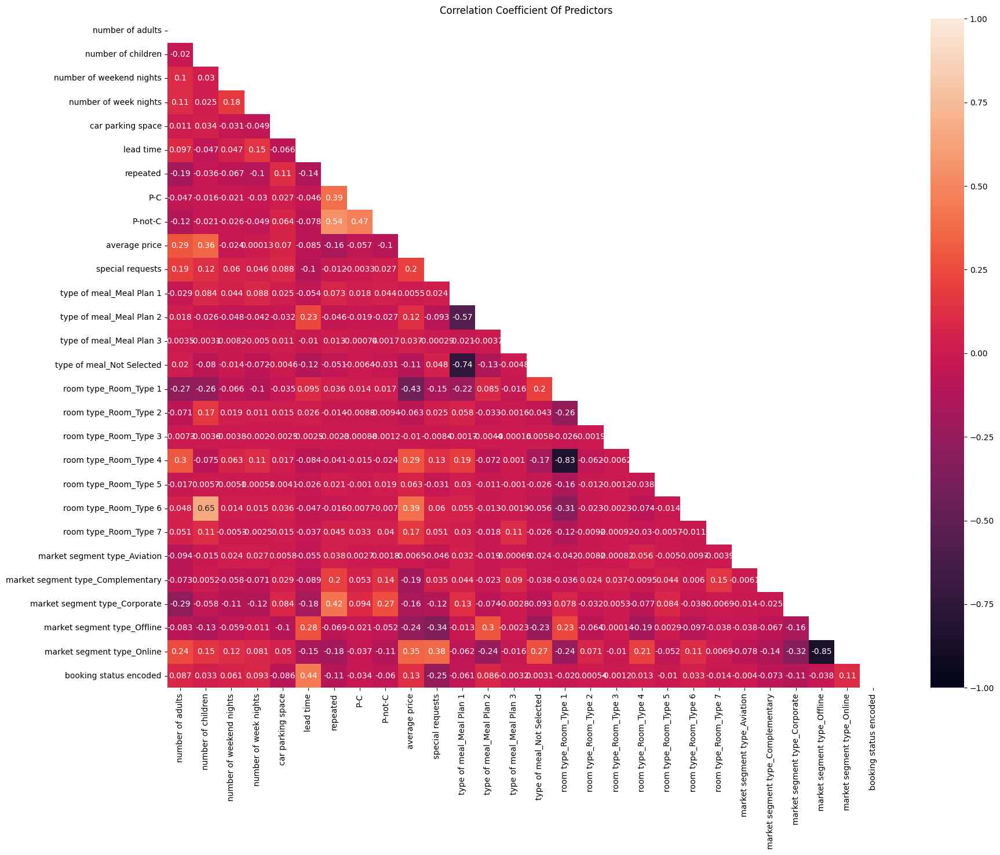

In [23]:
import numpy as np

# plot heatmap
plt.figure(figsize=(20,15))


# Generate a mask to onlyshow the bottom triangle
mask = np.triu(np.ones_like(df.corr(), dtype=bool))

# generate heatmap
sns.heatmap(df.corr(), annot=True, mask=mask, vmin=-1, vmax=1)
plt.title('Correlation Coefficient Of Predictors')
plt.show()

# Training and selection of the model
We've preprocessed the data and cleaned the different variables.
The next step is start to train different models and evaluate each of them.
The steps for each model will be:
- Split the train data into 5 folds.
- Choose a set of values for the hyperparameters of the model.
- Train the model for each element from the set.
- Evaluate each fold:
  1. Confusion matrix
  2. Precision/Recall
  3. Accuracy
  4. Cost-Sensitive Accuracy
  5. Area under the ROC Curve (AUC)
- Choose the best set of hyperparameters.

When we have all the models trained with a good hyperparameter selection for each, we can try to compare all the results and choose the definitive model.

Models that will be utilized:
- Linear Regression
- Logistic Regression
- Decission Tree Learning
- Support Vector Machine
- Neural Network

NOTE: we will evalute each execution with a reduced dimensionality plot, that means that will not be accurated but is done just to see how the boundary line is positionated.

In [24]:
def print_scores(scores_arrays):
  for t in scores_arrays:
    print(t)

In [25]:
from sklearn.model_selection import train_test_split

def split_train_test_validation(df):
  # Splitting into training (70%) and a temporary set (30%)
  train_df, temp_df = train_test_split(df, test_size=0.3, random_state=42)

  # Splitting the temporary set into validation and test sets (50% each of temp_df)
  validation_df, test_df = train_test_split(temp_df, test_size=0.5, random_state=42)

  # Now, train_df, validation_df, and test_df are 70%, 15%, and 15% of the original dataset respectively.
  return [train_df, test_df, validation_df]

In [26]:
import pandas as pd
import numpy as np

def slice_n(df, slices):
  # Shuffle the DataFrame using sample with frac=1
  shuffled_df = df.sample(frac=1, random_state=42)

  # Calculate the size of each slice
  slice_size = len(shuffled_df) // slices

  # Create a list to store each slice
  slices_list = []

  # Split the DataFrame into n slices
  for i in range(slices):
      start = i * slice_size
      if i == slices - 1:
          # Last slice takes the remainder of the DataFrame
          end = len(shuffled_df)
      else:
          end = (i + 1) * slice_size
      slices_list.append(shuffled_df.iloc[start:end])

  # slices[0], slices[1], ..., slices[n-1] are your n slices
  return slices_list

In [27]:
def extract_features_X_y(df):
  X = df[df.columns]  # Example feature columns
  del X['booking status encoded']
  y = df['booking status encoded']
  return [X, y]

In [28]:
def map_float_predictions(predictions):
  # Define the threshold
  threshold = 0.5

  # Apply the threshold to each prediction
  binary_predictions = (predictions > threshold).astype(int)

  return binary_predictions

In [29]:
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, roc_auc_score

# Let's try to create an score to be able to choose lately the best
# resulted option, so, the less value scored will be the best option
# because will have the less quantity of errors.

# Assign weights to be able to make more relevant some metrics than others.
#mse_ratio = .7
#r2_ratio = .4 # Normally it is higher than mse
#accuracy_ratio = 1
#auc_score_ratio = .8
#cost_sensitive_accuracy_ratio = .6


def evaluate_results(y, predictions, basic_error_eval=False):

  score = {}

  mse = mean_squared_error(y, predictions)
  r2 = r2_score(y, predictions)
  print(f"Mean Squared Error: {mse}")
  print(f"R-squared: {r2}")

  score["mse"] = mse
  score["r2"] = r2

  #score = score + mse*mse_ratio + r2*r2_ratio

  predictions = map_float_predictions(predictions)

  accuracy = accuracy_score(y, predictions)
  print(f"Accuracy: {accuracy}")

  score["accuracy"] = accuracy
  #score = score + (1 - accuracy)*accuracy_ratio

  if not basic_error_eval:
    report = classification_report(y, predictions)
    conf_matrix = confusion_matrix(y, predictions)
    print("Classification Report:")
    print(report)
    print("Confusion Matrix:")
    print(conf_matrix)

    # auc = roc_auc_score(y, predictions)
    # print(f"Area Under the ROC Curve (AUC): {auc}")
    # Compute the ROC Curve
    fpr, tpr, thresholds = roc_curve(y, predictions)

    # Compute the AUC score
    auc_score = roc_auc_score(y, predictions)
    print(f"AUC: {auc_score}")
    score["auc"] = auc_score

    # Plot the ROC Curve
    plt.figure(figsize=(8, 6))
    plt.plot(fpr, tpr, color='blue', lw=2, label=f'ROC curve (area = {auc_score:.2f})')
    plt.plot([0, 1], [0, 1], color='darkgrey', lw=2, linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic (ROC) Curve')
    plt.legend(loc="lower right")
    plt.grid(True)
    plt.show()

    #score = score + (1 - auc_score)*auc_score_ratio

    # Define the cost of a false positive and false negative
    cost_fp = 1  # Example cost
    cost_fn = 1  # Example cost

    # Assuming you have the actual labels (y_test) and predictions (y_pred)

    # Calculate confusion matrix
    tn, fp, fn, tp = conf_matrix.ravel()
    # tn, fp, fn, tp = confusion_matrix(y_test, y_pred).ravel()

    # Calculate the total cost
    total_cost = fp * cost_fp + fn * cost_fn

    # Calculate cost-sensitive accuracy
    total_samples = len(y)
    normal_accuracy = (tp + tn) / total_samples
    cost_sensitive_accuracy = normal_accuracy - (total_cost / total_samples)

    print(f"Cost-Sensitive Accuracy: {cost_sensitive_accuracy}")

    #score = score + (1 - cost_sensitive_accuracy)*cost_sensitive_accuracy_ratio
    score["cost-sensitive-acc"] = cost_sensitive_accuracy
  return score

# Linear Regression

In [30]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.decomposition import PCA

def train_linear_regression(df):
  [df_train, df_test, df_validation] = split_train_test_validation(df)

  [X_train, y_train] = extract_features_X_y(df_train)
  [X_test, y_test] = extract_features_X_y(df_test)
  [X_validation, y_validation] = extract_features_X_y(df_validation)

  model = LinearRegression()
  model.fit(X_train, y_train)

  predictions = model.predict(X_test)

  score = evaluate_results(y_test, predictions)

  # Apply PCA for dimensionality reduction
  pca = PCA(n_components=2)
  X_pca = pca.fit_transform(X_train)

  # Fit linear regression on the reduced data
  model = LinearRegression()
  model.fit(X_pca, y_train)

  # Plotting
  plt.figure(figsize=(8, 6))
  plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train, cmap='viridis', edgecolor='k', s=50)


  # Creating a meshgrid to plot the regression plane
  xx, yy = np.meshgrid(np.linspace(X_pca[:, 0].min(), X_pca[:, 0].max(), 30),
                      np.linspace(X_pca[:, 1].min(), X_pca[:, 1].max(), 30))

  # Predicting on the meshgrid
  Z = model.predict(np.c_[xx.ravel(), yy.ravel()])
  Z = Z.reshape(xx.shape)


  # Plotting the regression plane
  plt.contourf(xx, yy, Z, alpha=0.5, cmap='viridis')
  plt.colorbar(label='Target')
  plt.xlabel('Principal Component 1')
  plt.ylabel('Principal Component 2')
  plt.title('Linear Regression Fit with PCA')
  plt.show()

  return score

Mean Squared Error: 0.1462930003380903
R-squared: 0.343421286689077
Accuracy: 0.7936799559066691
Classification Report:
              precision    recall  f1-score   support

           0       0.80      0.91      0.85      3619
           1       0.76      0.56      0.64      1824

    accuracy                           0.79      5443
   macro avg       0.78      0.74      0.75      5443
weighted avg       0.79      0.79      0.78      5443

Confusion Matrix:
[[3303  316]
 [ 807 1017]]
AUC: 0.735124425546458


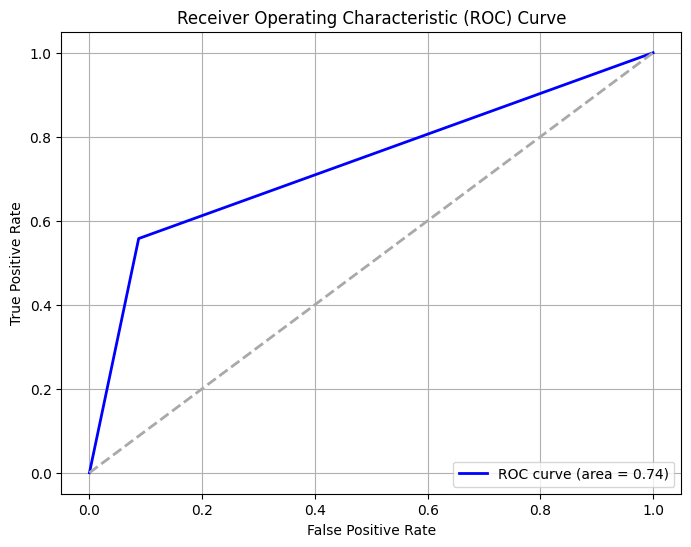

Cost-Sensitive Accuracy: 0.5873599118133381


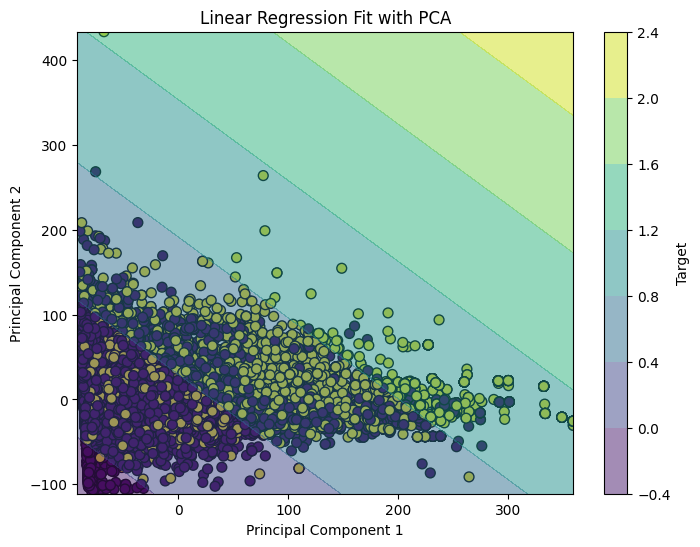

Score for Linear Regression {'mse': 0.1462930003380903, 'r2': 0.343421286689077, 'accuracy': 0.7936799559066691, 'auc': 0.735124425546458, 'cost-sensitive-acc': 0.5873599118133381}


In [31]:
# There aren't hyperparameters in linear regression because it is not learned with stochastic gradient descent.
# https://github.com/scikit-learn/scikit-learn/issues/12572
score = train_linear_regression(df)
print(f"Score for Linear Regression {score}")

# Logistic Regression

In [32]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA


def train_logistic_regression(df, penalty='l2', C=1.0, solver='lbfgs', max_iter=100):

  [df_train, df_test, df_validation] = split_train_test_validation(df)

  [X_train, y_train] = extract_features_X_y(df_train)
  [X_test, y_test] = extract_features_X_y(df_test)
  [X_validation, y_validation] = extract_features_X_y(df_validation)

  # Since we have problems to converge the function to a reasonable approximation
  # with the logistic regression, we opted to use an standard scaler for this
  # model to make easier to the model to converge
  pipe = make_pipeline(StandardScaler(), LogisticRegression(penalty=penalty, C=C, solver=solver, max_iter=max_iter))
  pipe.fit(X_train, y_train)
  predictions = pipe.predict(X_test)

  score = evaluate_results(y_test, predictions)

  # Exmple reducing the dimensionality of the features to be able to plot
  # the boundary line of the model.

  # Step 1: Apply PCA for dimensionality reduction
  pca = PCA(n_components=2)
  X_pca = pca.fit_transform(X_train)
  # Fit logistic regression on the reduced data
  model_pca = LogisticRegression()
  model_pca.fit(X_pca, y_train)
  # Step 2: Plot the decision boundary
  # Create a mesh to plot in 2D
  x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
  y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
  xx, yy = np.meshgrid(np.linspace(x_min, x_max, 500), np.linspace(y_min, y_max, 500))
  # Predict probabilities on the mesh
  Z = model_pca.predict_proba(np.c_[xx.ravel(), yy.ravel()])[:, 1]
  Z = Z.reshape(xx.shape)
  # Plotting decision boundary
  plt.contourf(xx, yy, Z, levels=[0, 0.5, 1], cmap='RdBu', alpha=0.8)
  plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train, cmap='RdBu', edgecolors='k')

  plt.xlabel('PCA Feature 1')
  plt.ylabel('PCA Feature 2')
  plt.title('Logistic Regression Decision Boundary with PCA')
  plt.show()
  return score

Executing logistic regression with: lbfgs, l2, 0.1, 50
Mean Squared Error: 0.20044093330883703
R-squared: 0.1003995421338646
Accuracy: 0.799559066691163
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 738 1086]]
AUC: 0.7489269898634401


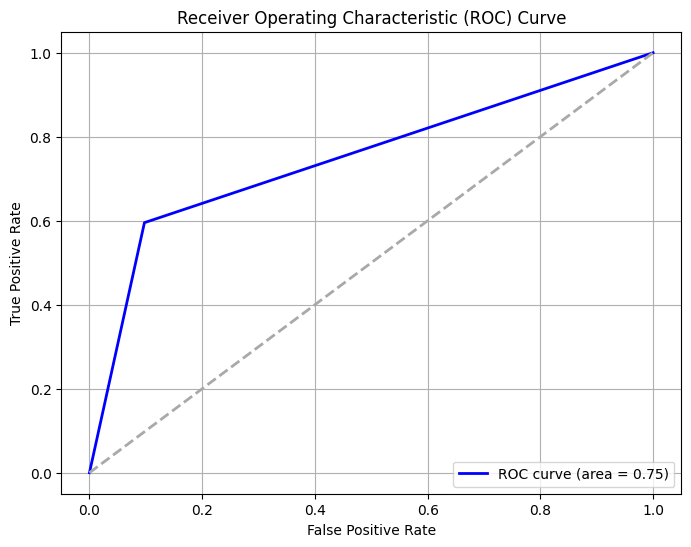

Cost-Sensitive Accuracy: 0.5991181333823259


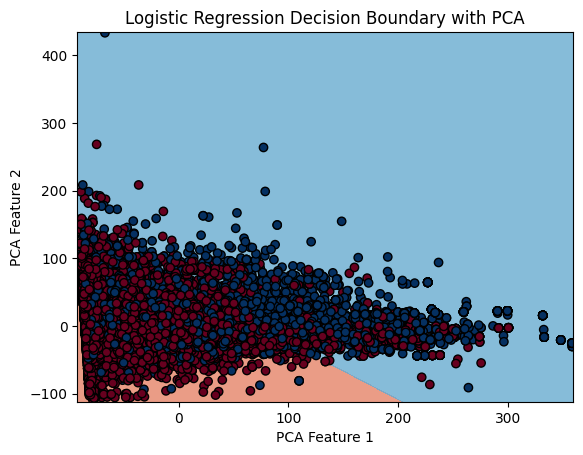

Executing logistic regression with: lbfgs, l2, 0.1, 100
Mean Squared Error: 0.20044093330883703
R-squared: 0.1003995421338646
Accuracy: 0.799559066691163
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 738 1086]]
AUC: 0.7489269898634401


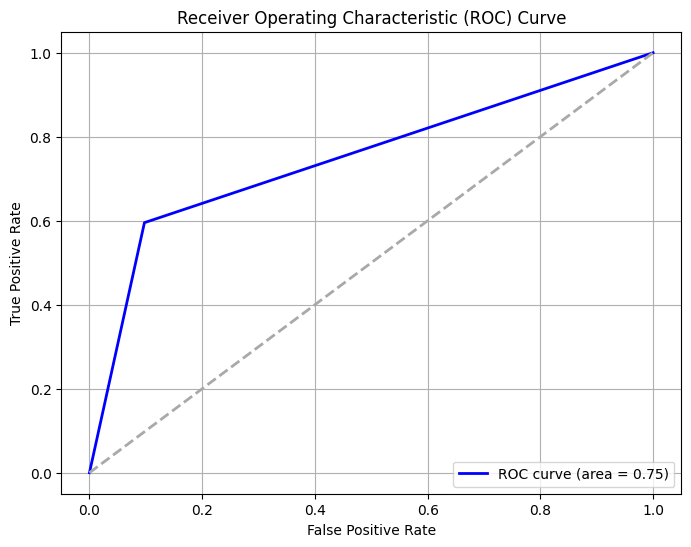

Cost-Sensitive Accuracy: 0.5991181333823259


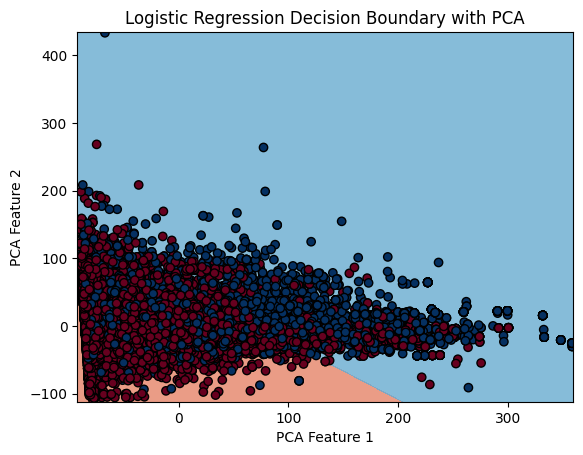

Executing logistic regression with: lbfgs, l2, 0.3, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


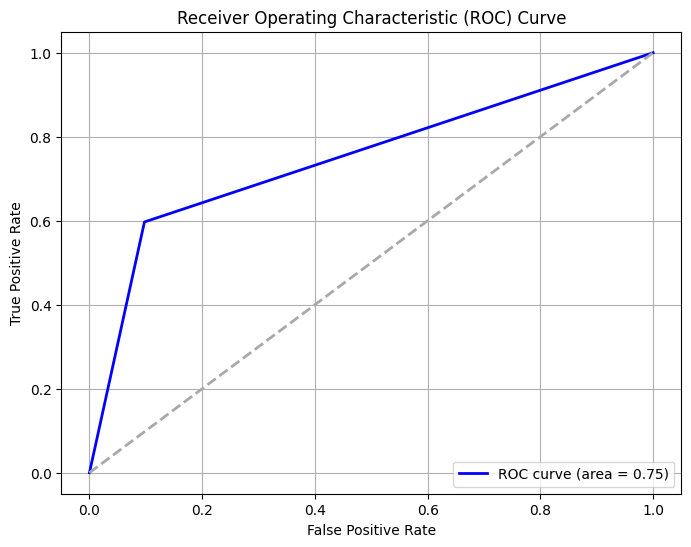

Cost-Sensitive Accuracy: 0.6002204666544184


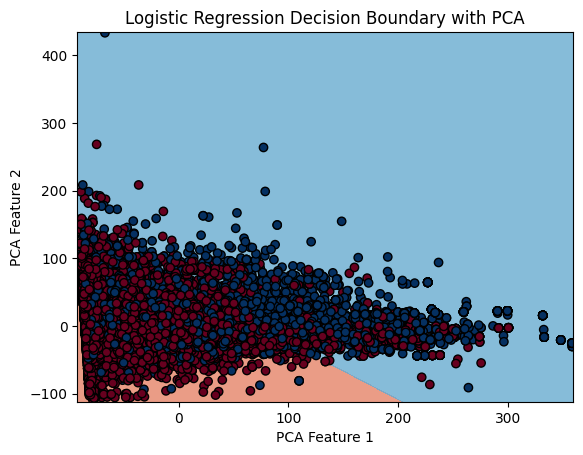

Executing logistic regression with: lbfgs, l2, 0.3, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


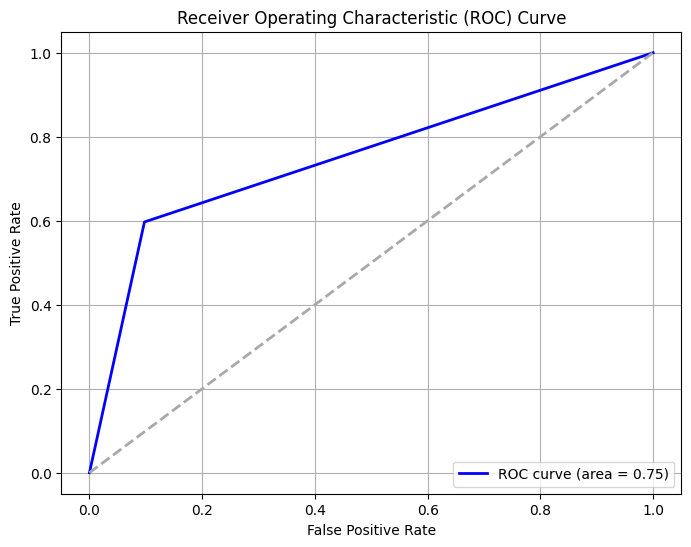

Cost-Sensitive Accuracy: 0.6002204666544184


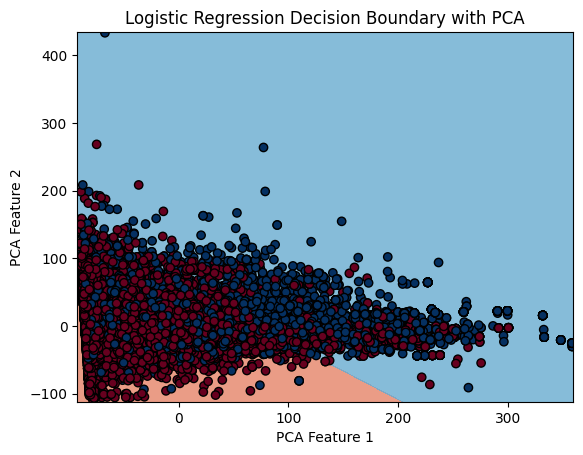

Executing logistic regression with: lbfgs, l2, 0.5, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


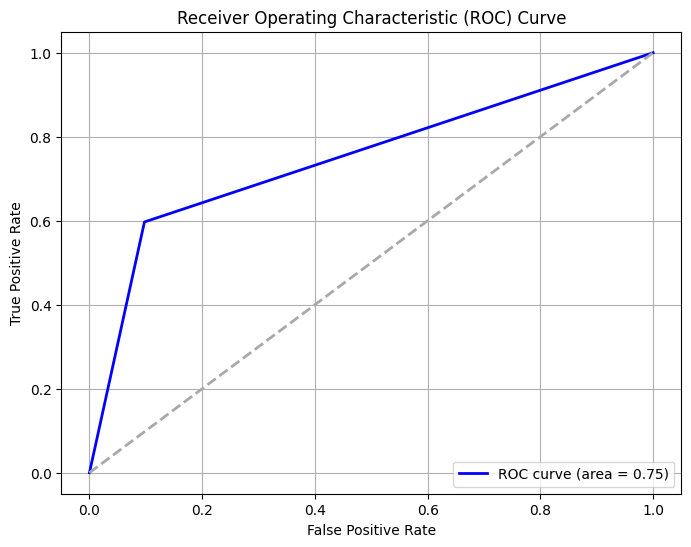

Cost-Sensitive Accuracy: 0.6002204666544184


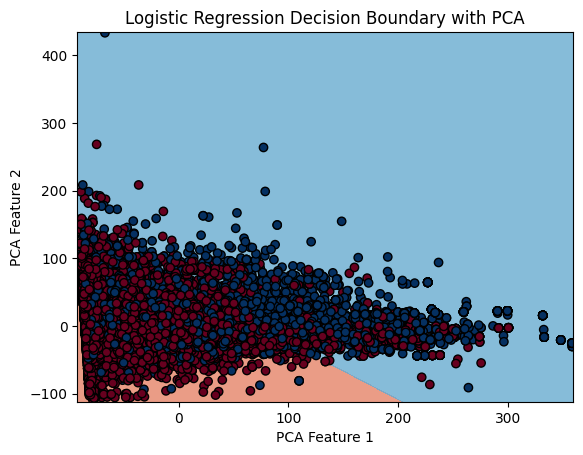

Executing logistic regression with: lbfgs, l2, 0.5, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


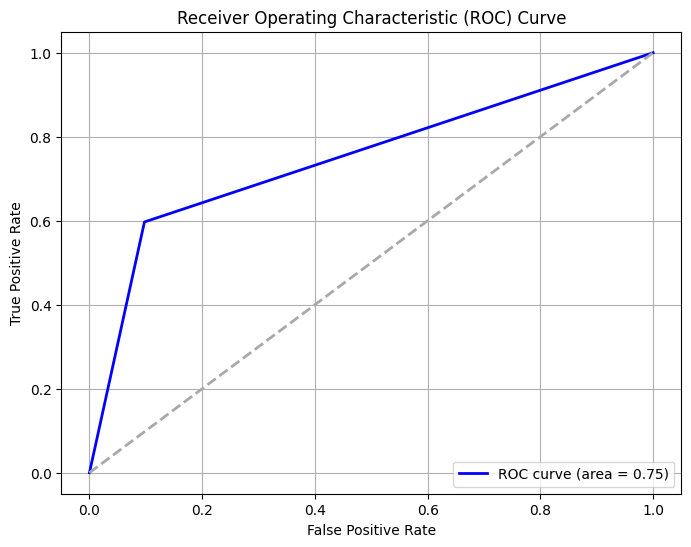

Cost-Sensitive Accuracy: 0.6002204666544184


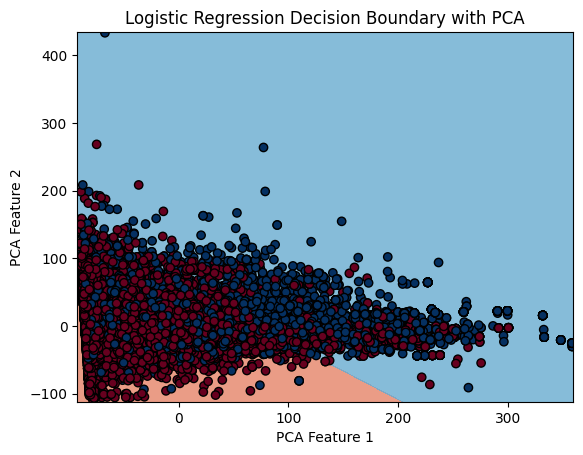

Executing logistic regression with: lbfgs, l2, 0.7, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


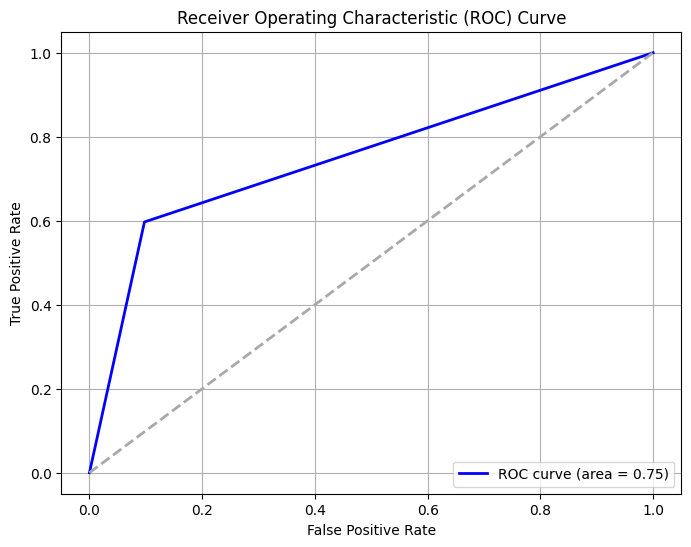

Cost-Sensitive Accuracy: 0.6002204666544184


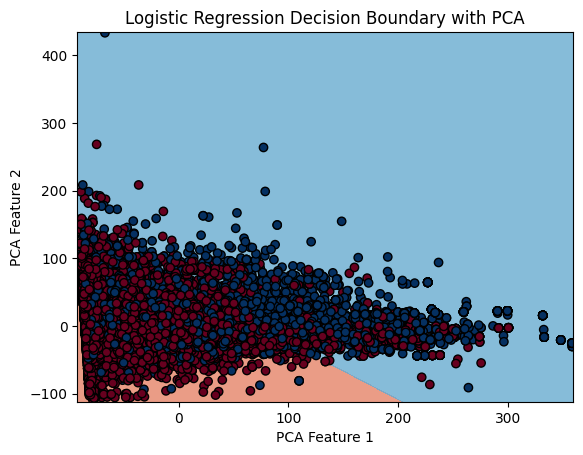

Executing logistic regression with: lbfgs, l2, 0.7, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


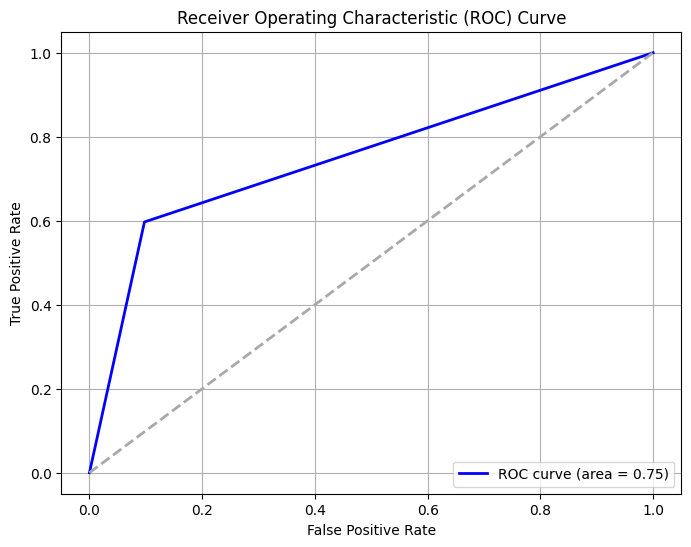

Cost-Sensitive Accuracy: 0.6002204666544184


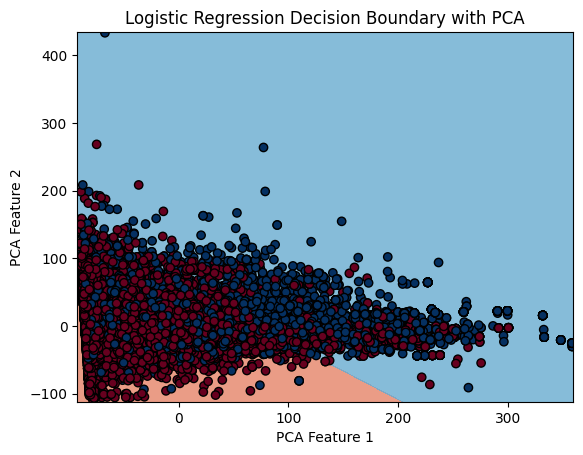

Executing logistic regression with: lbfgs, l2, 0.9, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


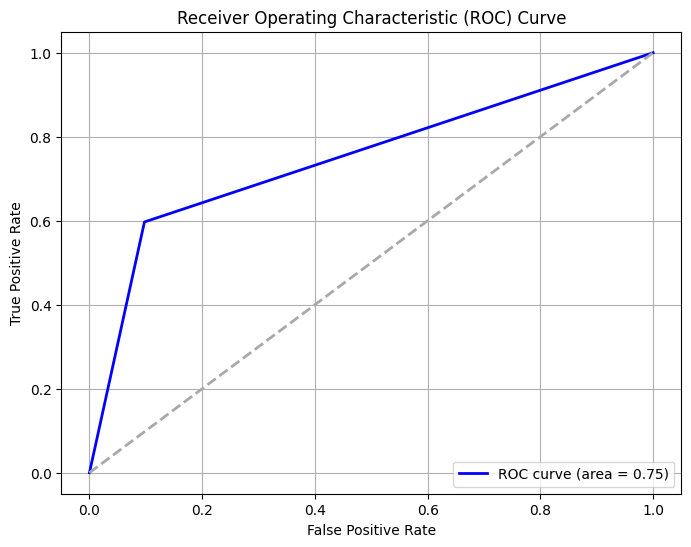

Cost-Sensitive Accuracy: 0.6002204666544184


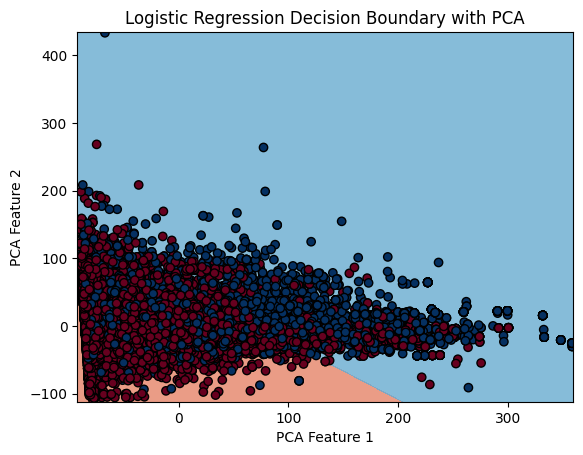

Executing logistic regression with: lbfgs, l2, 0.9, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


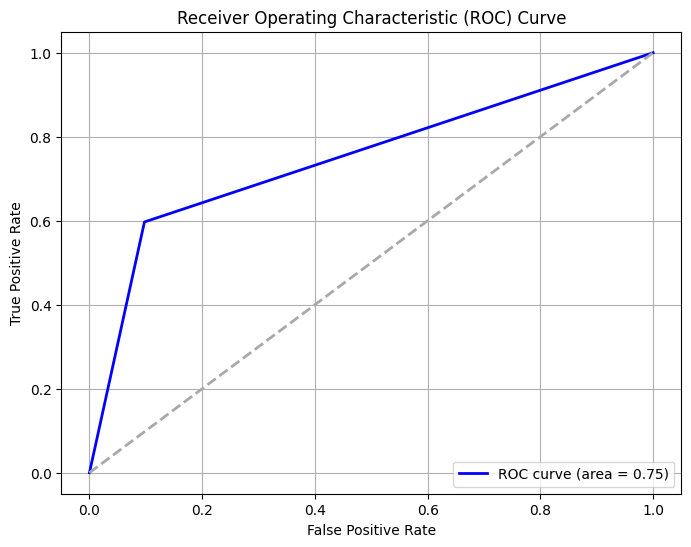

Cost-Sensitive Accuracy: 0.6002204666544184


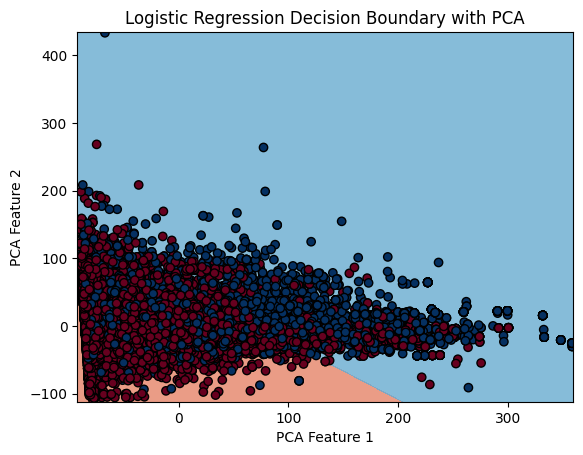

Executing logistic regression with: lbfgs, None, 0.1, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


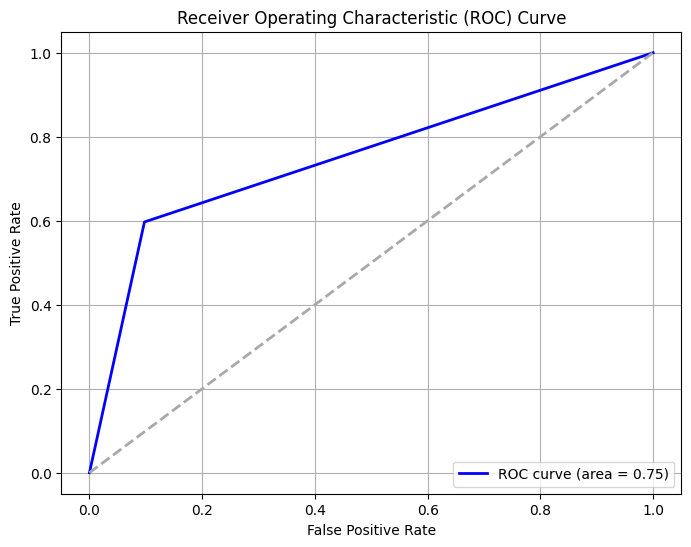

Cost-Sensitive Accuracy: 0.6002204666544184


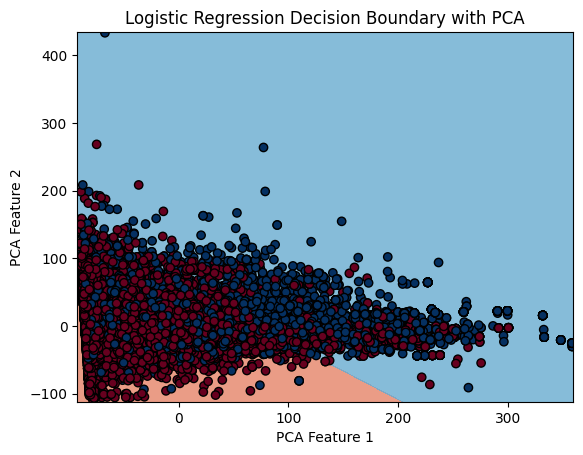

Executing logistic regression with: lbfgs, None, 0.1, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


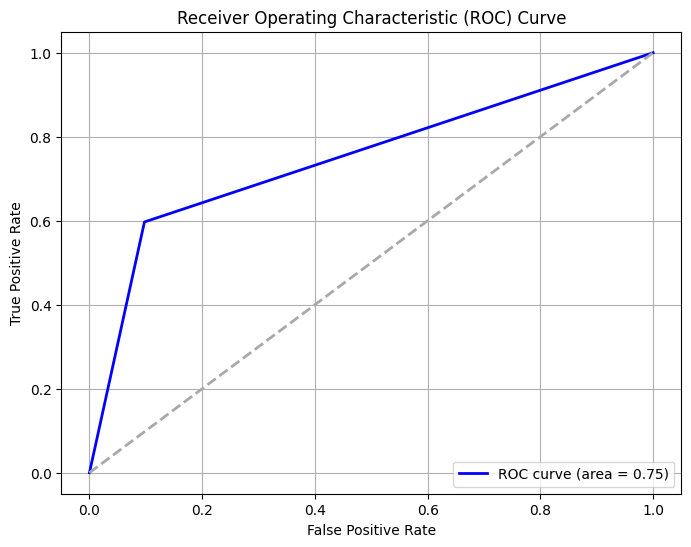

Cost-Sensitive Accuracy: 0.6002204666544184


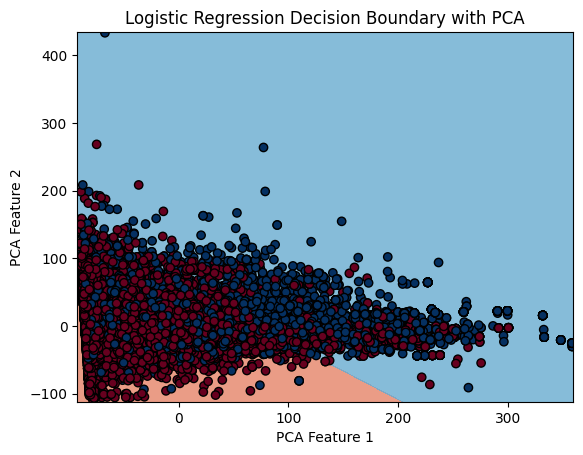

Executing logistic regression with: lbfgs, None, 0.3, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


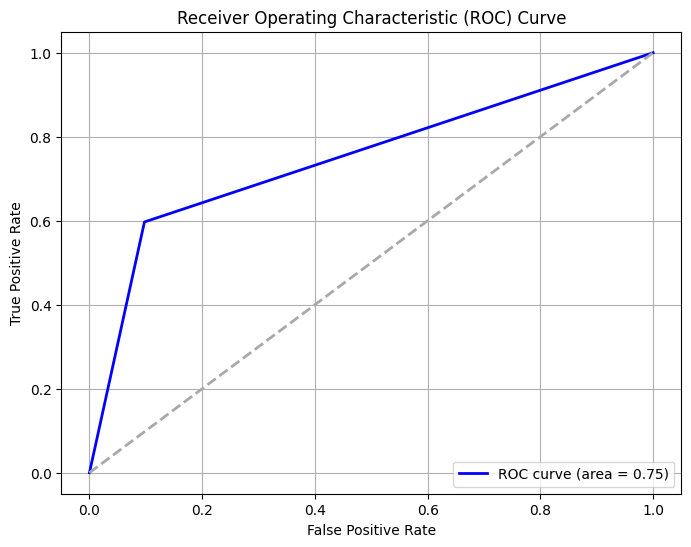

Cost-Sensitive Accuracy: 0.6002204666544184


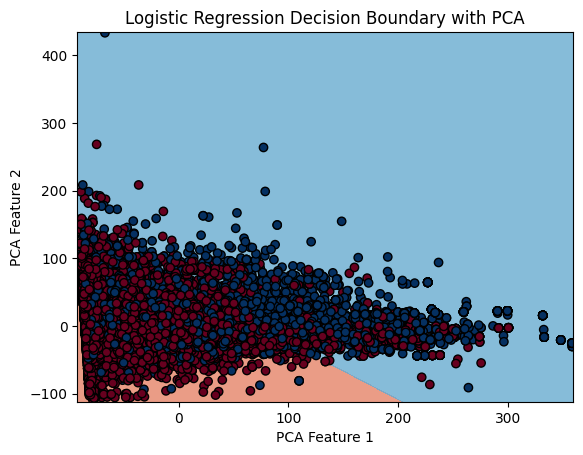

Executing logistic regression with: lbfgs, None, 0.3, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


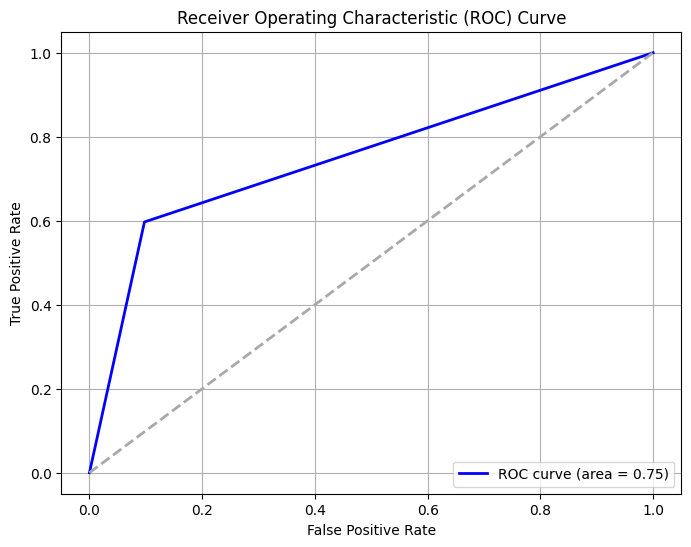

Cost-Sensitive Accuracy: 0.6002204666544184


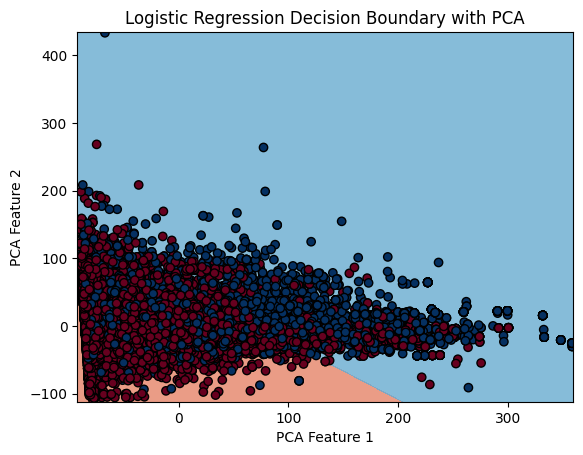

Executing logistic regression with: lbfgs, None, 0.5, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


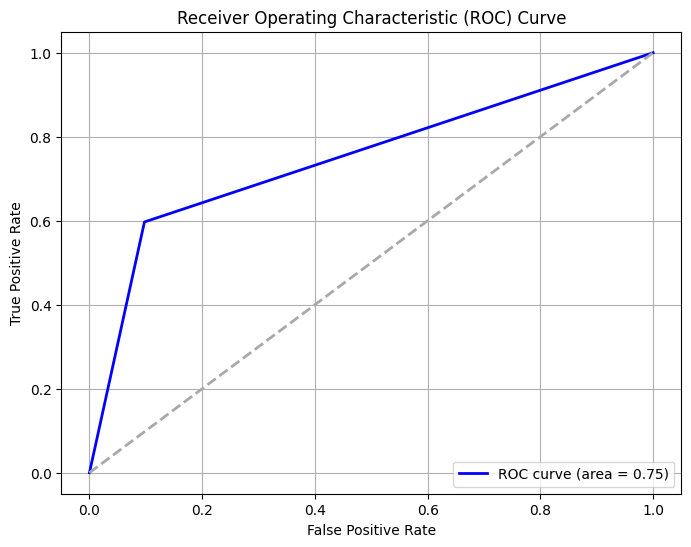

Cost-Sensitive Accuracy: 0.6002204666544184


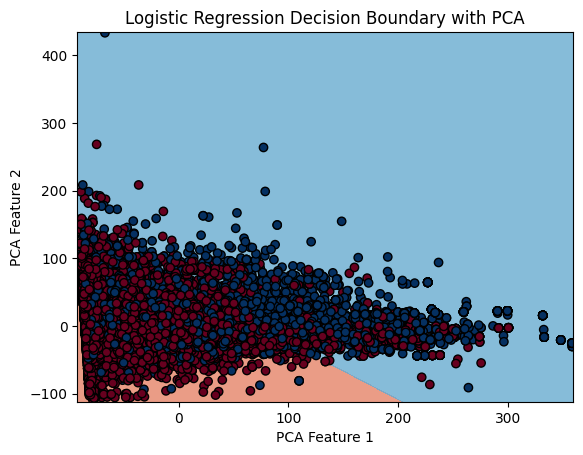

Executing logistic regression with: lbfgs, None, 0.5, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


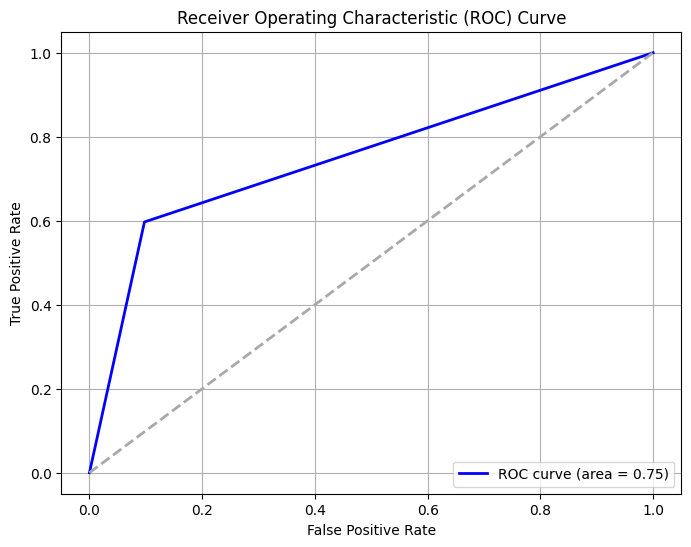

Cost-Sensitive Accuracy: 0.6002204666544184


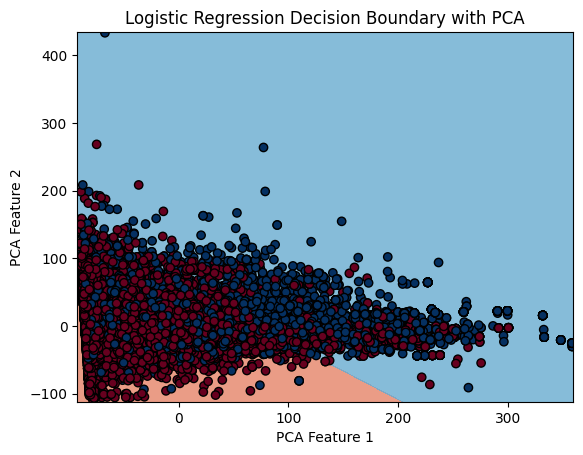

Executing logistic regression with: lbfgs, None, 0.7, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


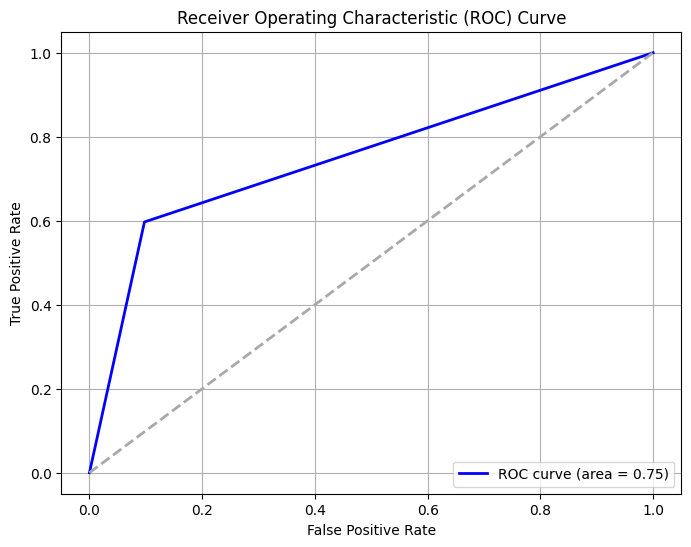

Cost-Sensitive Accuracy: 0.6002204666544184


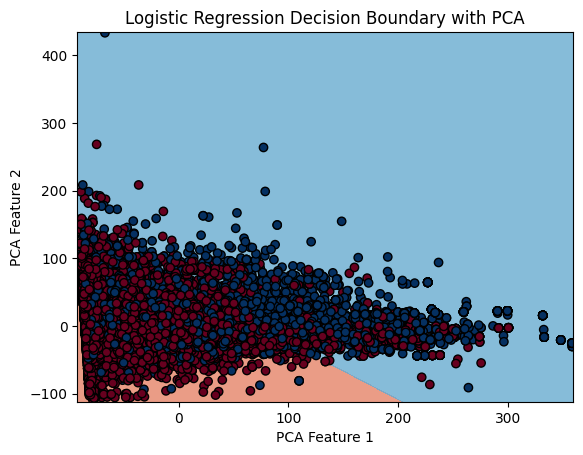

Executing logistic regression with: lbfgs, None, 0.7, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


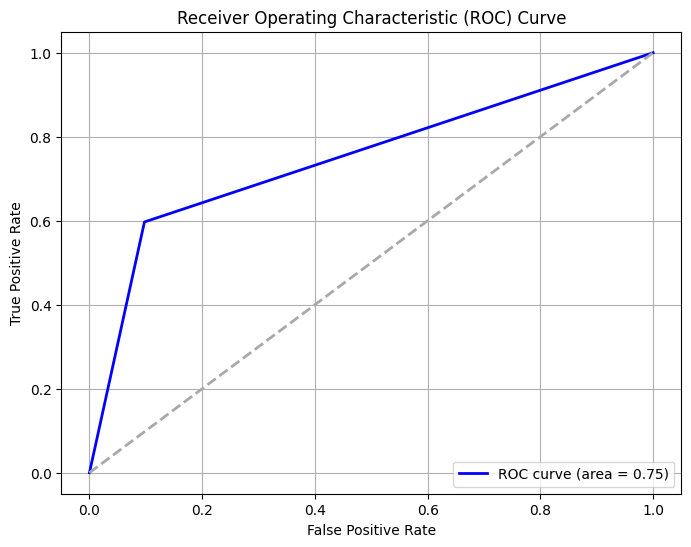

Cost-Sensitive Accuracy: 0.6002204666544184


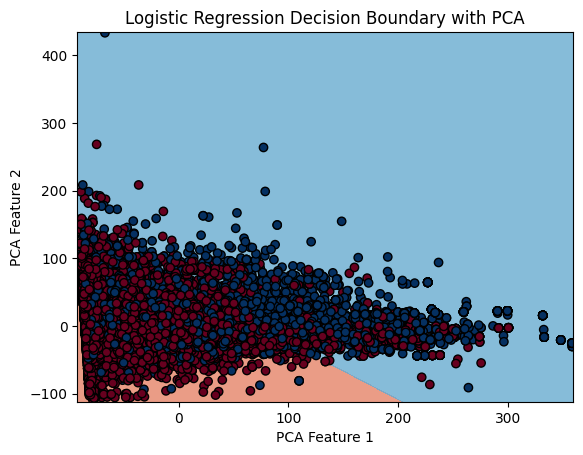

Executing logistic regression with: lbfgs, None, 0.9, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


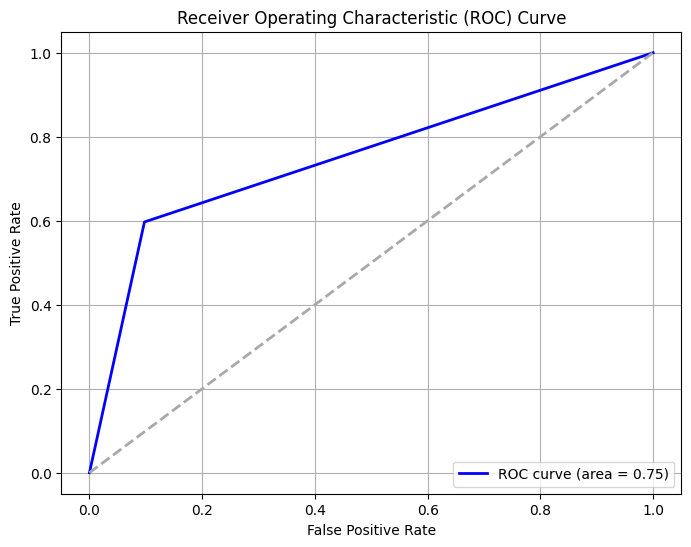

Cost-Sensitive Accuracy: 0.6002204666544184


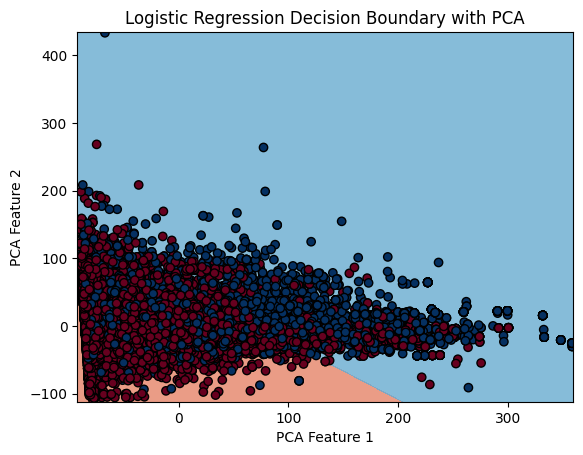

Executing logistic regression with: lbfgs, None, 0.9, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


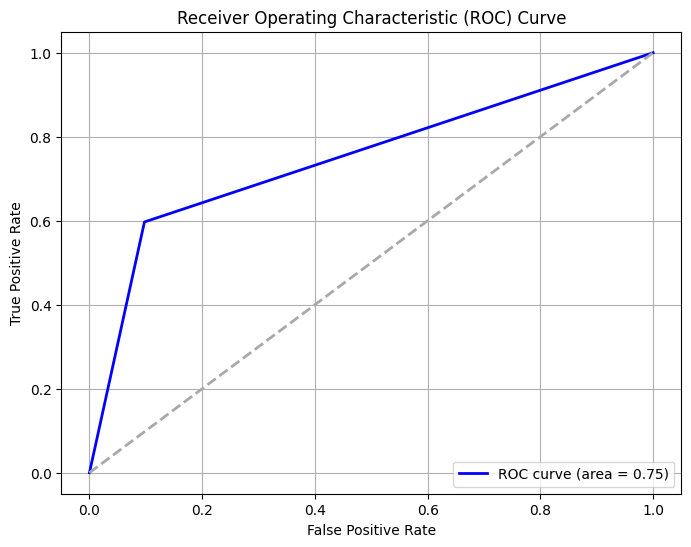

Cost-Sensitive Accuracy: 0.6002204666544184


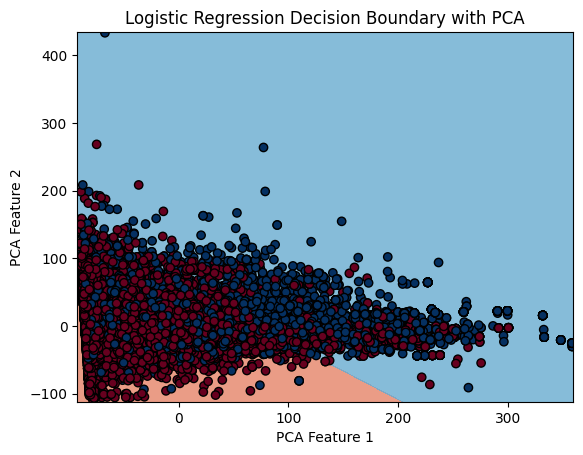

Executing logistic regression with: liblinear, l1, 0.1, 50
Mean Squared Error: 0.20080837773286792
R-squared: 0.09875041205528323
Accuracy: 0.7991916222671321
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.78      0.75      0.76      5443
weighted avg       0.79      0.80      0.79      5443

Confusion Matrix:
[[3264  355]
 [ 738 1086]]
AUC: 0.7486506704381845


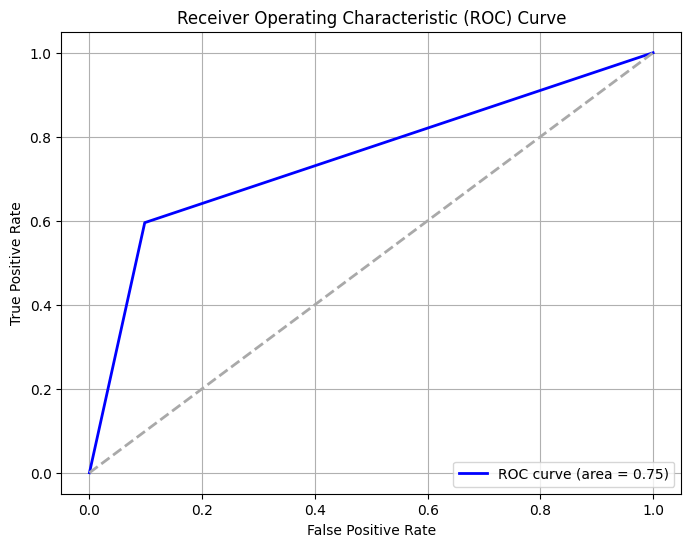

Cost-Sensitive Accuracy: 0.5983832445342643


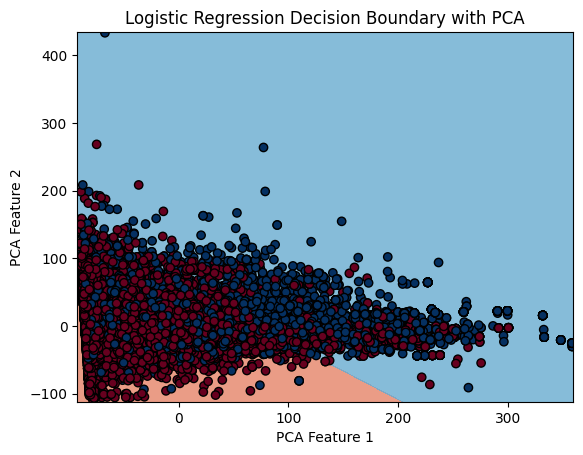

Executing logistic regression with: liblinear, l1, 0.1, 100
Mean Squared Error: 0.20080837773286792
R-squared: 0.09875041205528323
Accuracy: 0.7991916222671321
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.78      0.75      0.76      5443
weighted avg       0.79      0.80      0.79      5443

Confusion Matrix:
[[3264  355]
 [ 738 1086]]
AUC: 0.7486506704381845


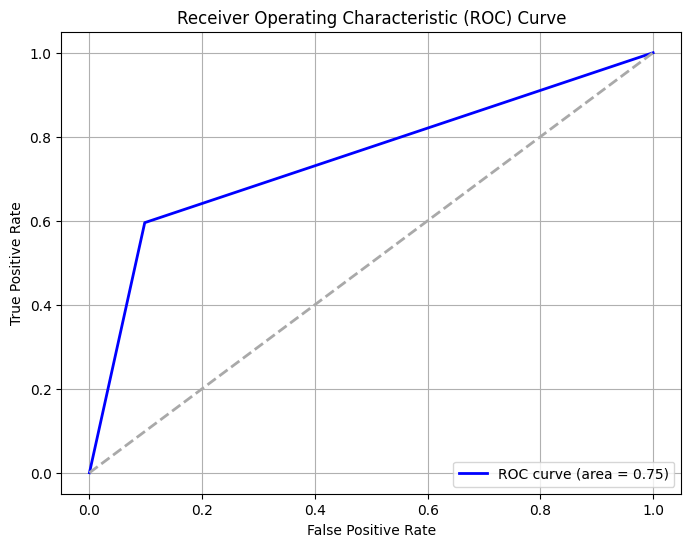

Cost-Sensitive Accuracy: 0.5983832445342643


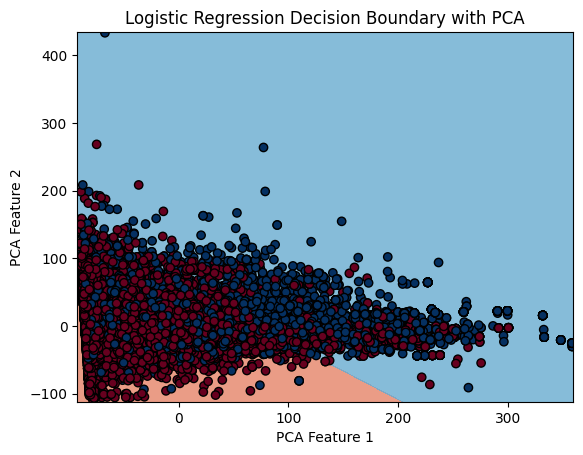

Executing logistic regression with: liblinear, l1, 0.3, 50
Mean Squared Error: 0.20044093330883703
R-squared: 0.1003995421338646
Accuracy: 0.799559066691163
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 737 1087]]
AUC: 0.7490629529578298


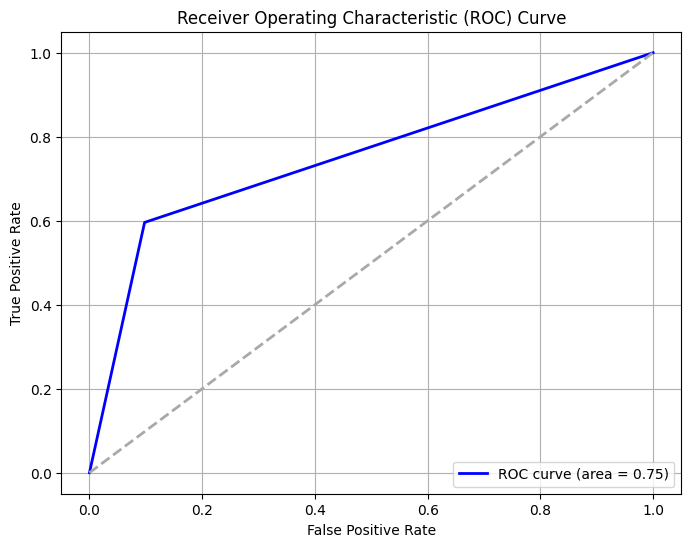

Cost-Sensitive Accuracy: 0.5991181333823259


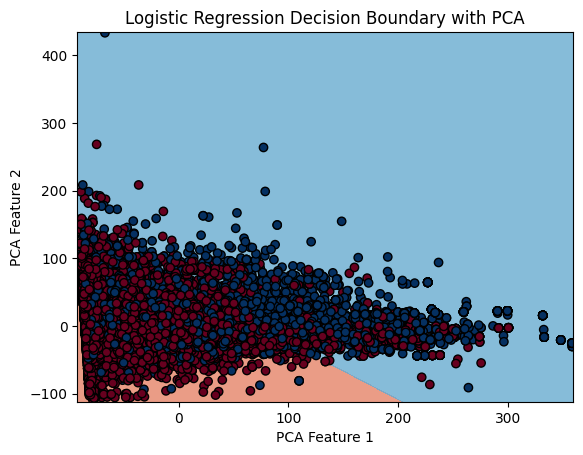

Executing logistic regression with: liblinear, l1, 0.3, 100
Mean Squared Error: 0.20044093330883703
R-squared: 0.1003995421338646
Accuracy: 0.799559066691163
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 737 1087]]
AUC: 0.7490629529578298


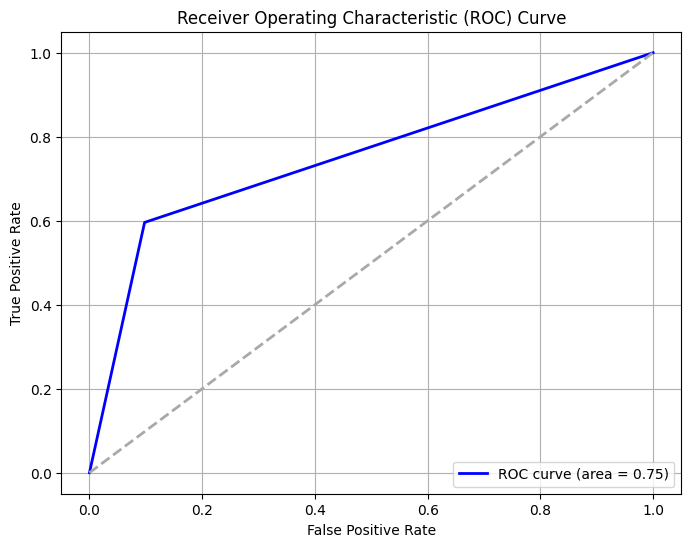

Cost-Sensitive Accuracy: 0.5991181333823259


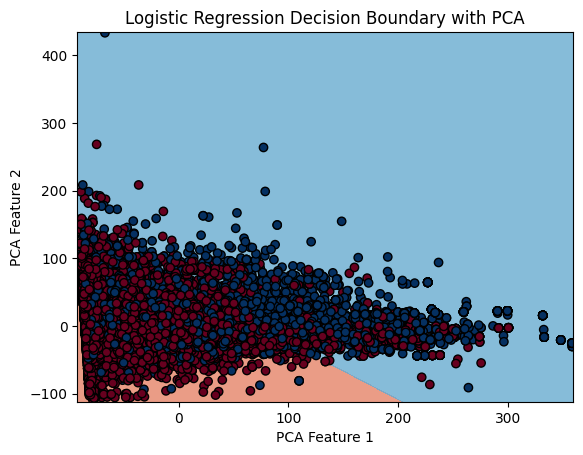

Executing logistic regression with: liblinear, l1, 0.5, 50
Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


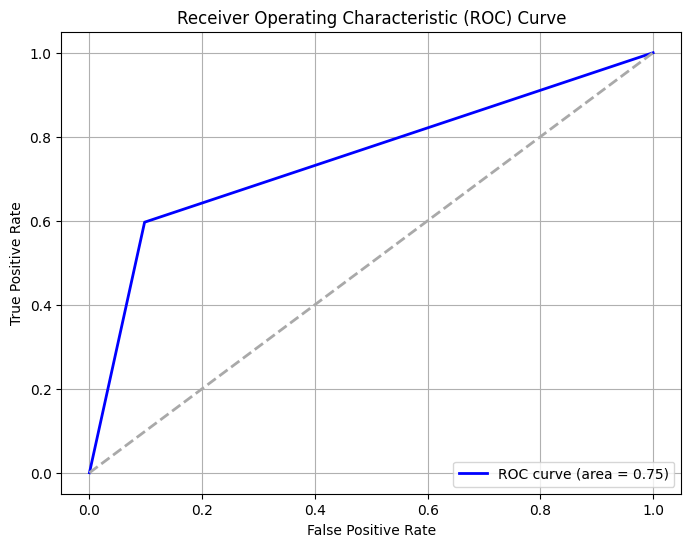

Cost-Sensitive Accuracy: 0.5994855778063568


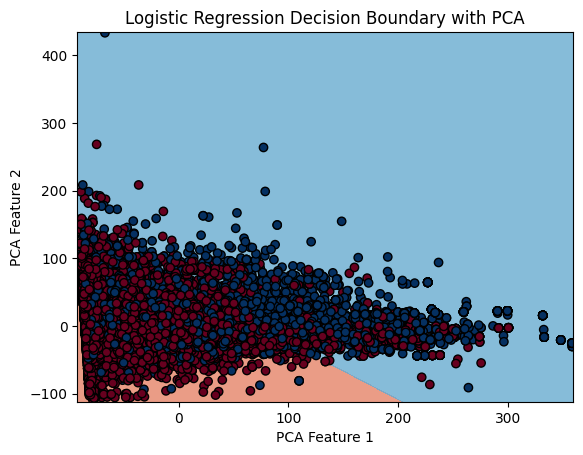

Executing logistic regression with: liblinear, l1, 0.5, 100
Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


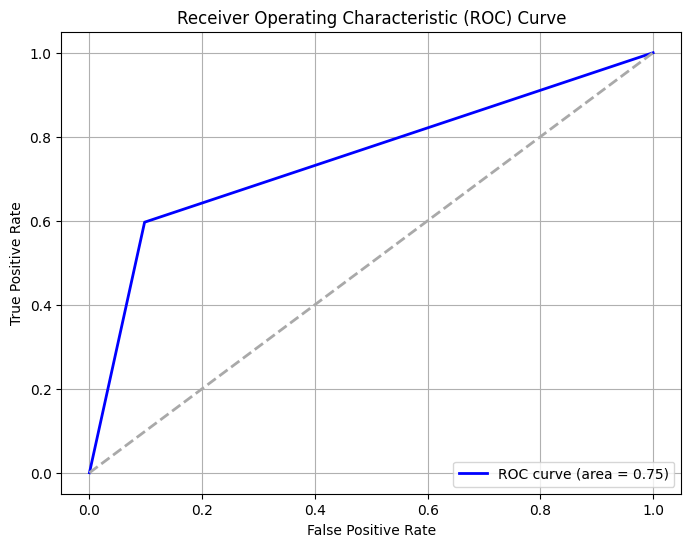

Cost-Sensitive Accuracy: 0.5994855778063568


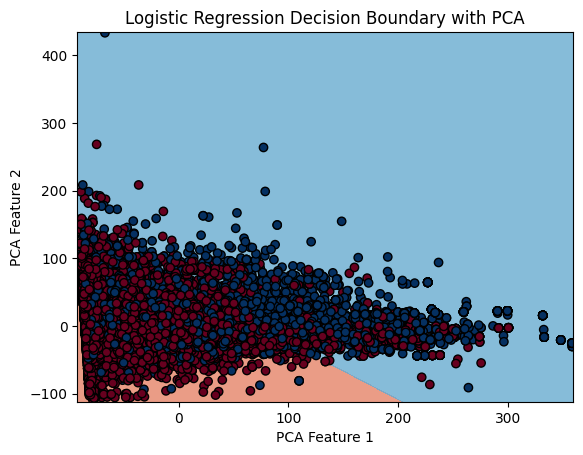

Executing logistic regression with: liblinear, l1, 0.7, 50
Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


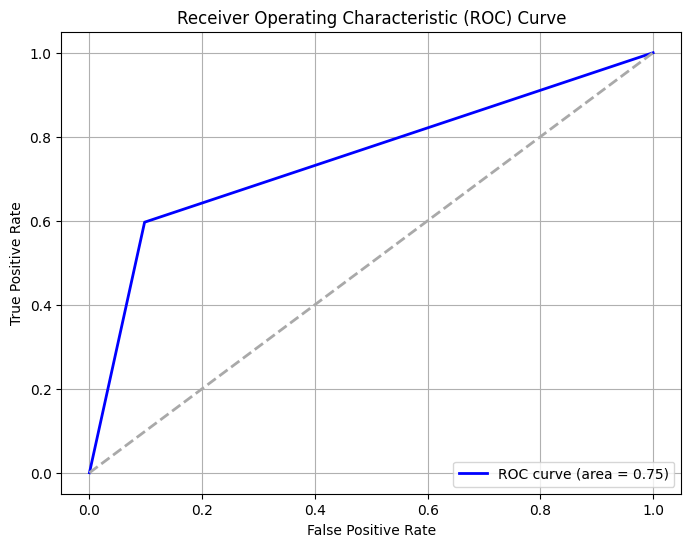

Cost-Sensitive Accuracy: 0.5994855778063568


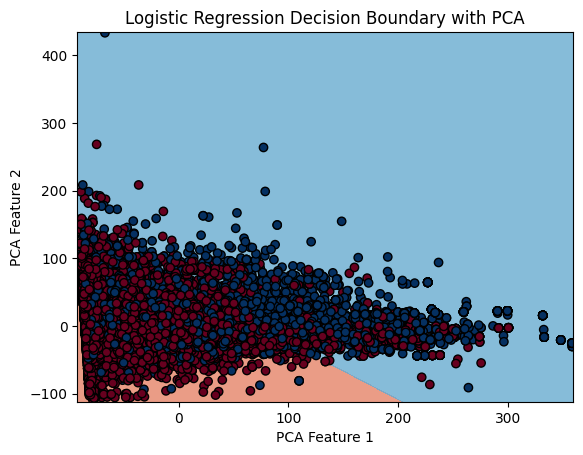

Executing logistic regression with: liblinear, l1, 0.7, 100
Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


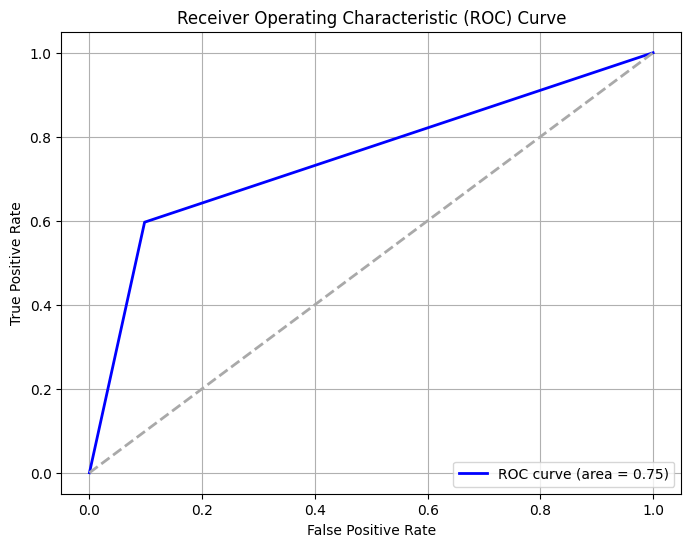

Cost-Sensitive Accuracy: 0.5994855778063568


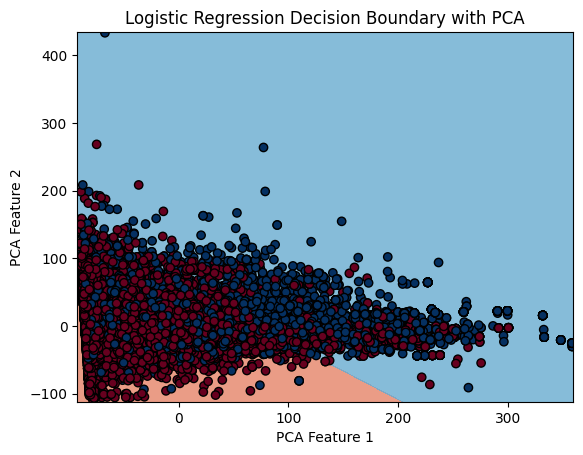

Executing logistic regression with: liblinear, l1, 0.9, 50
Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


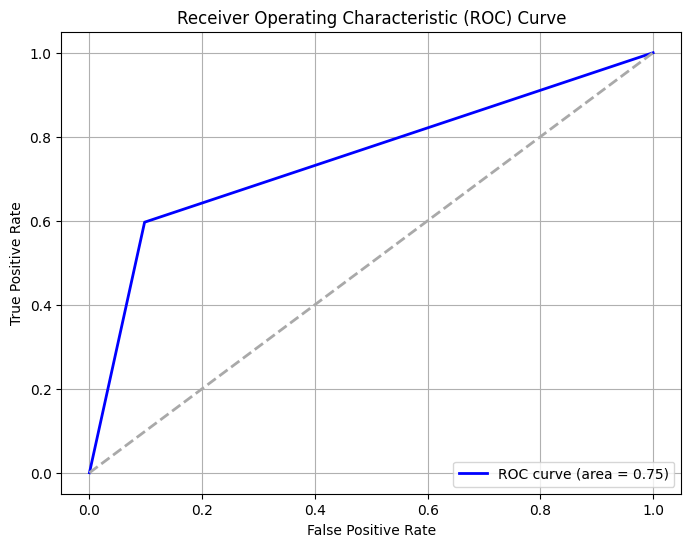

Cost-Sensitive Accuracy: 0.5994855778063568


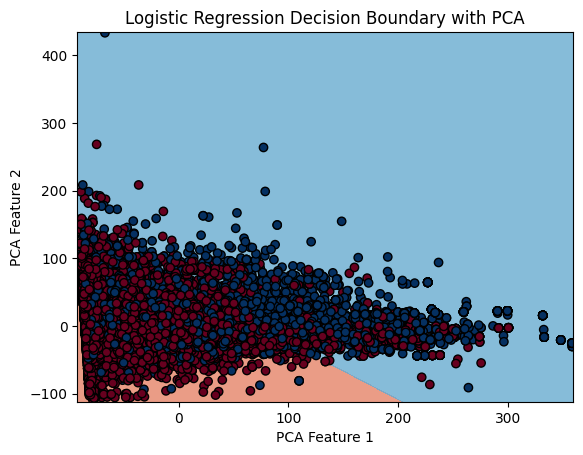

Executing logistic regression with: liblinear, l1, 0.9, 100
Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


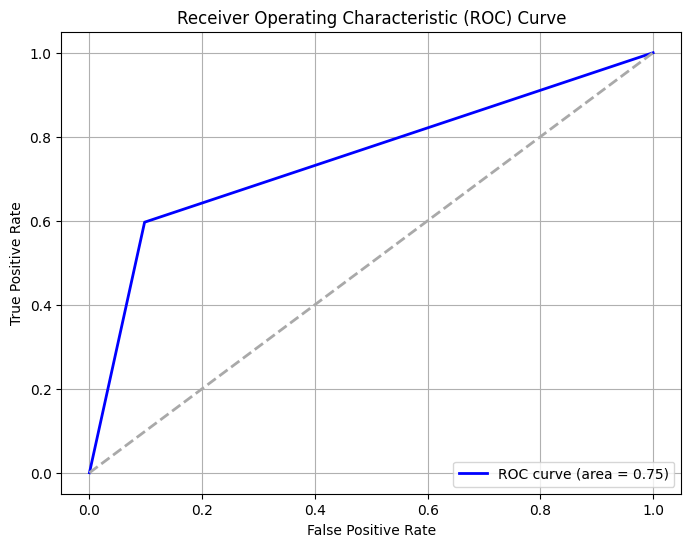

Cost-Sensitive Accuracy: 0.5994855778063568


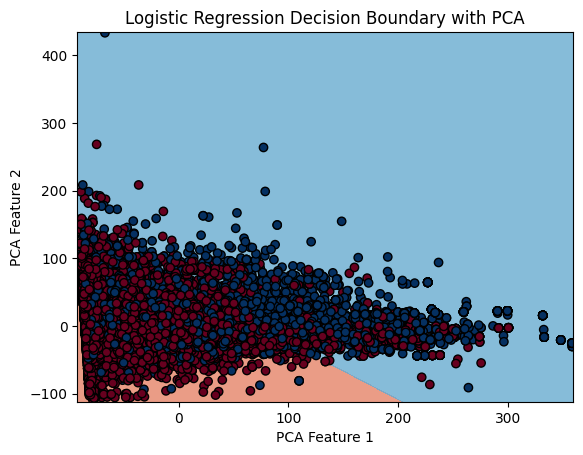

Executing logistic regression with: liblinear, l2, 0.1, 50
Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


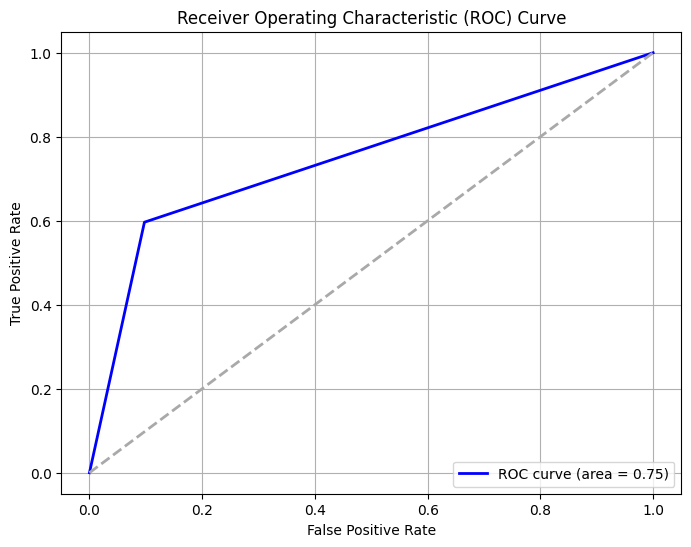

Cost-Sensitive Accuracy: 0.5998530222303877


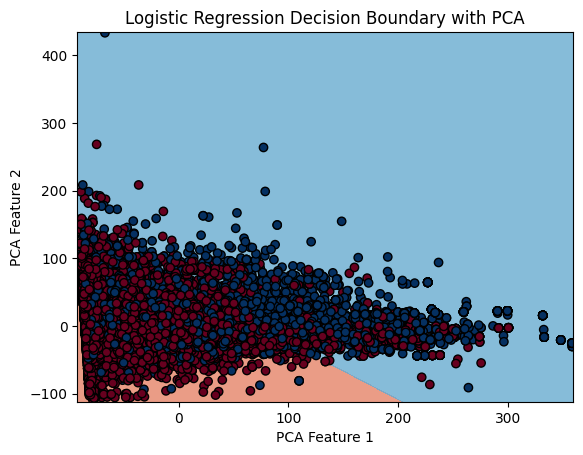

Executing logistic regression with: liblinear, l2, 0.1, 100
Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


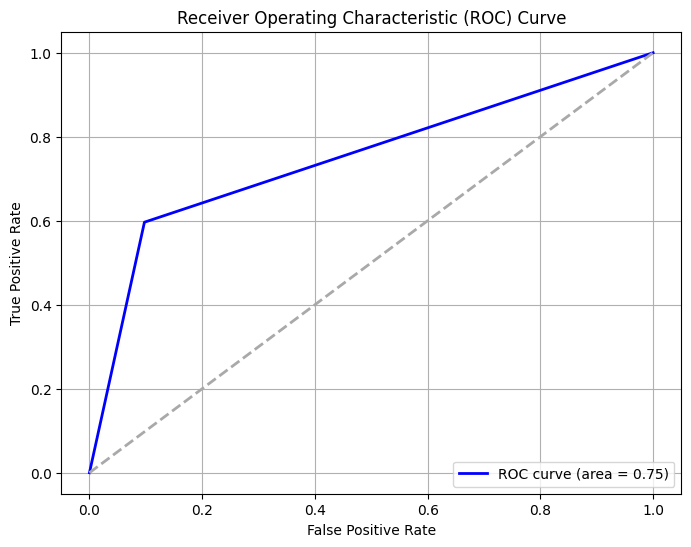

Cost-Sensitive Accuracy: 0.5998530222303877


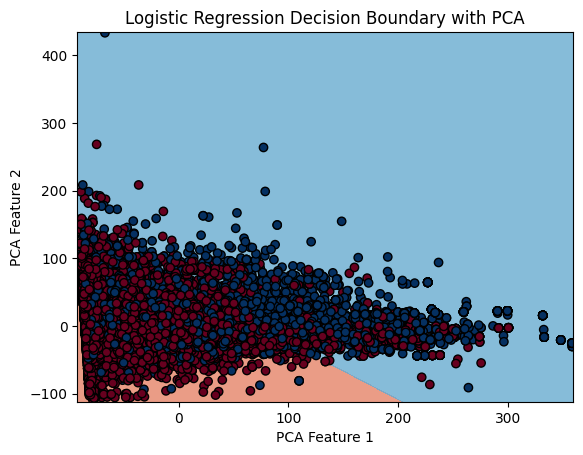

Executing logistic regression with: liblinear, l2, 0.3, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


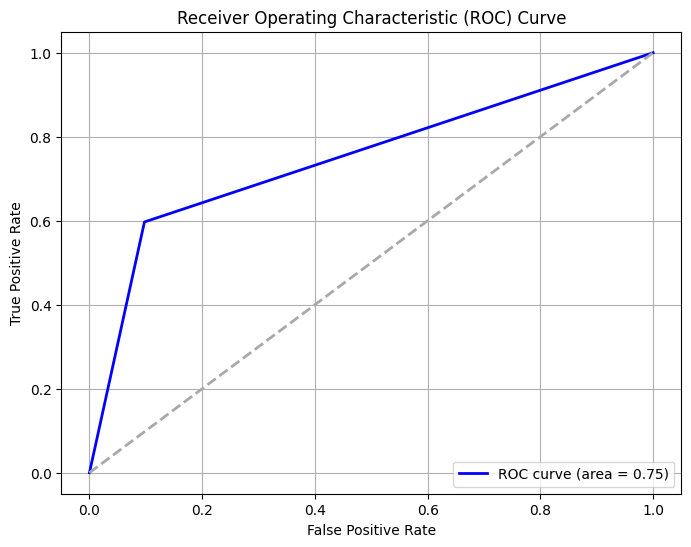

Cost-Sensitive Accuracy: 0.6002204666544184


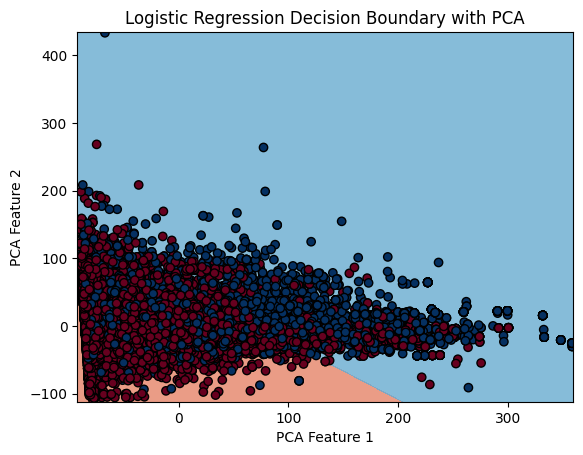

Executing logistic regression with: liblinear, l2, 0.3, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


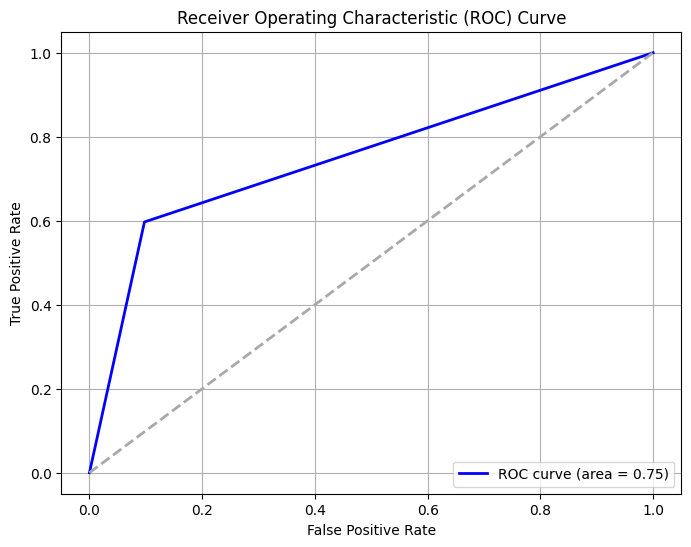

Cost-Sensitive Accuracy: 0.6002204666544184


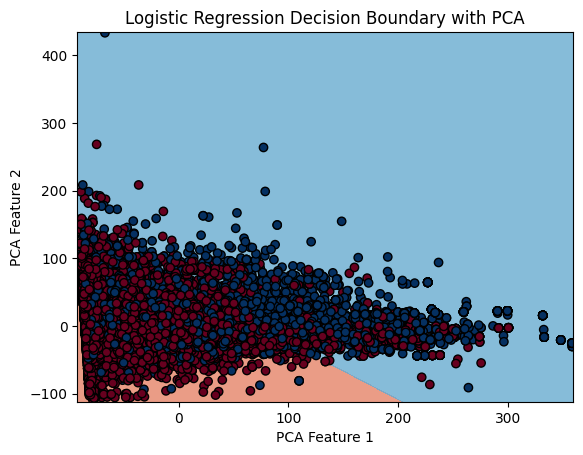

Executing logistic regression with: liblinear, l2, 0.5, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


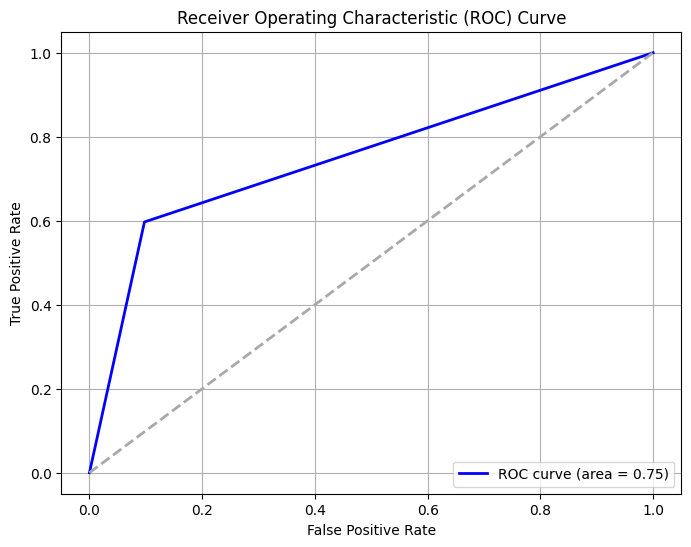

Cost-Sensitive Accuracy: 0.6002204666544184


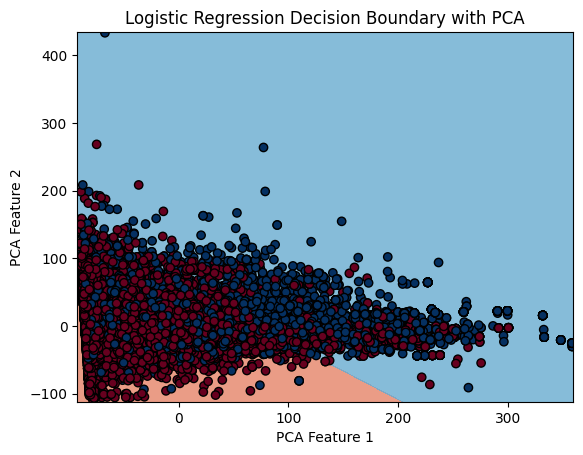

Executing logistic regression with: liblinear, l2, 0.5, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


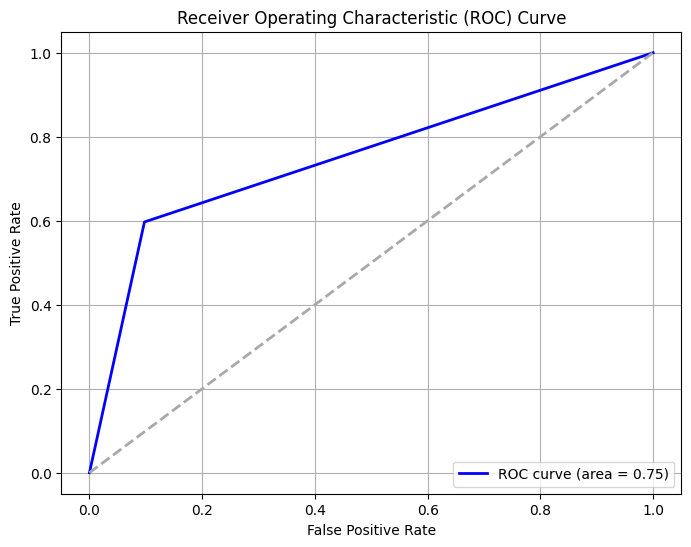

Cost-Sensitive Accuracy: 0.6002204666544184


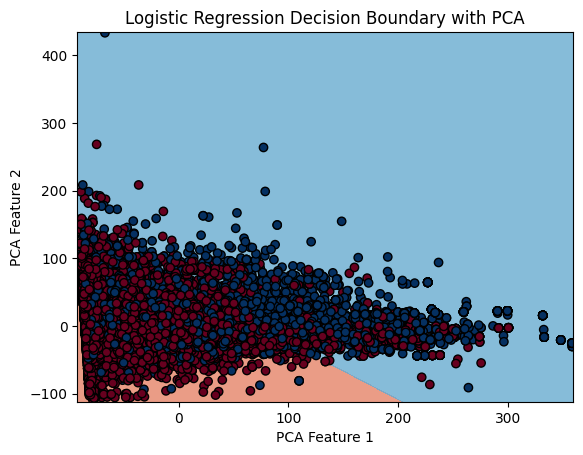

Executing logistic regression with: liblinear, l2, 0.7, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


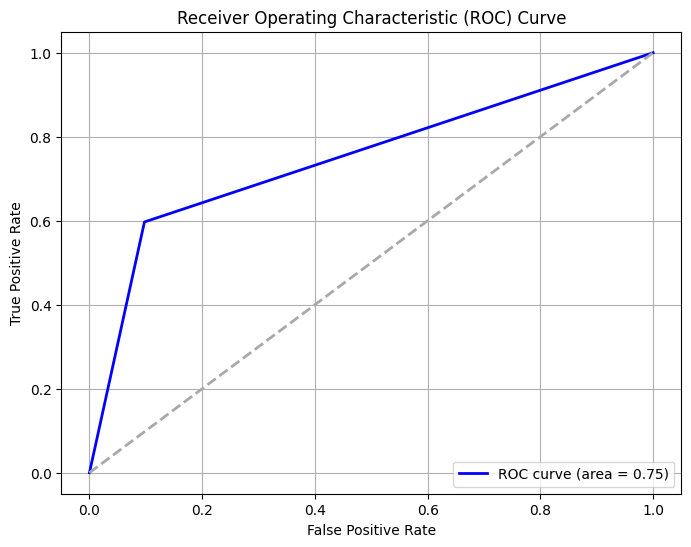

Cost-Sensitive Accuracy: 0.6002204666544184


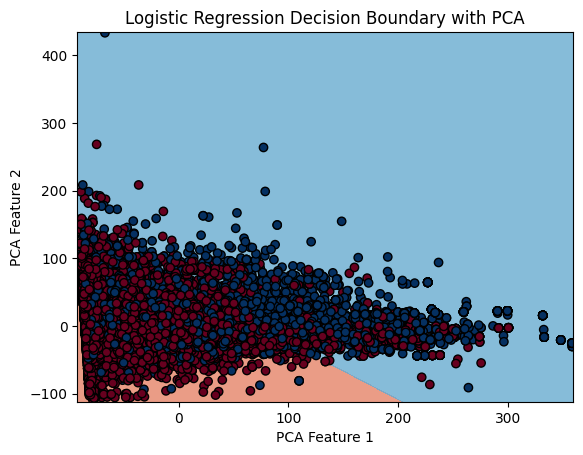

Executing logistic regression with: liblinear, l2, 0.7, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


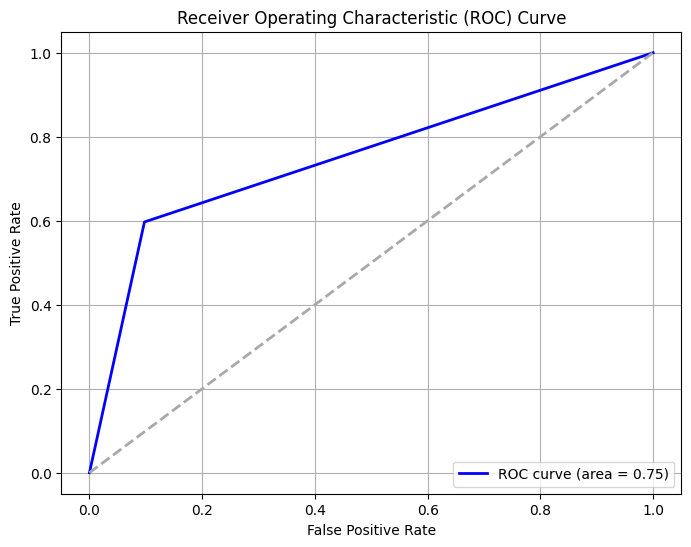

Cost-Sensitive Accuracy: 0.6002204666544184


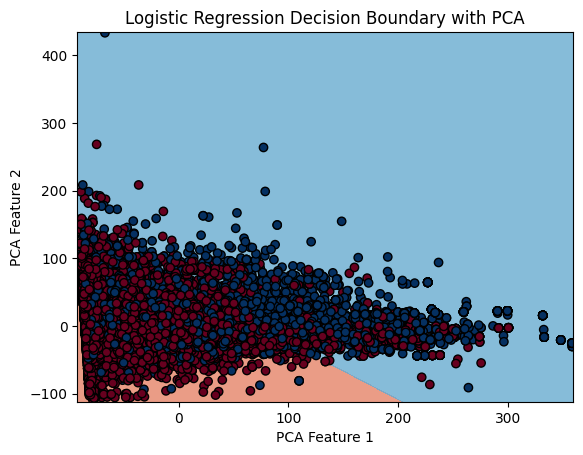

Executing logistic regression with: liblinear, l2, 0.9, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


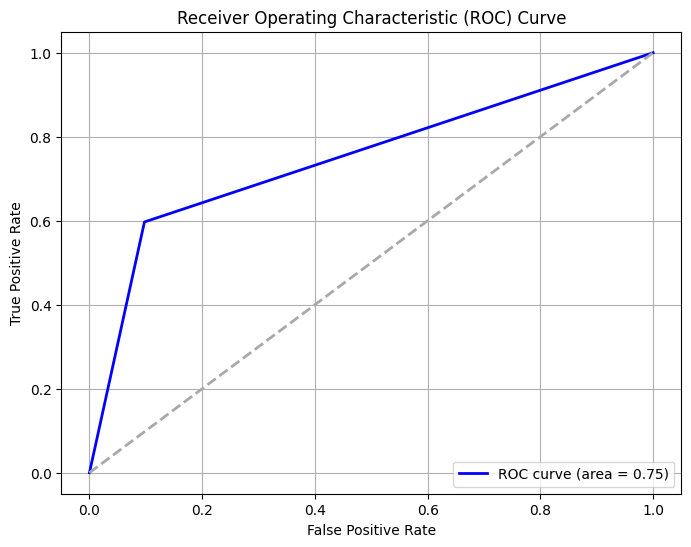

Cost-Sensitive Accuracy: 0.6002204666544184


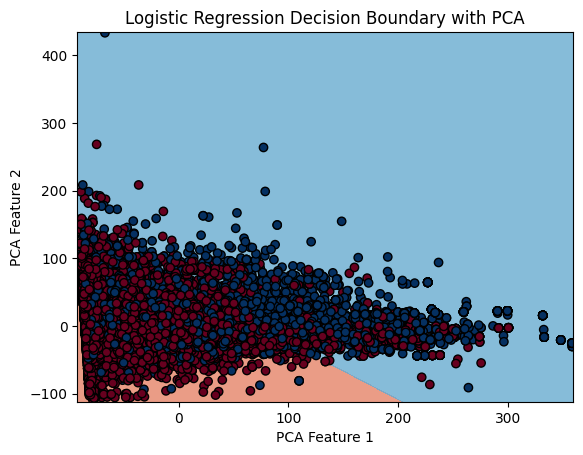

Executing logistic regression with: liblinear, l2, 0.9, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


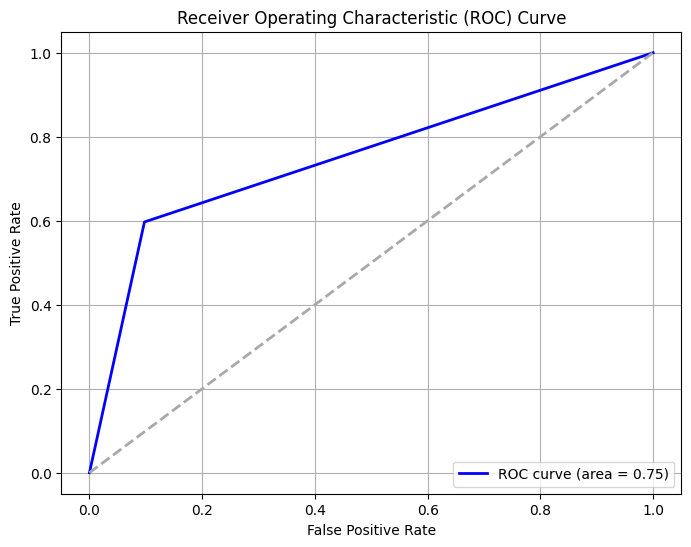

Cost-Sensitive Accuracy: 0.6002204666544184


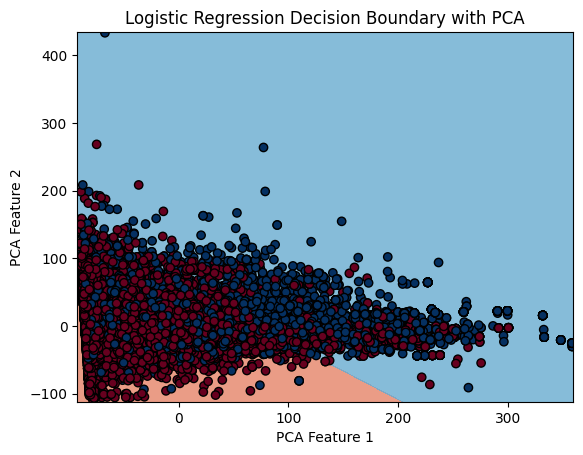

Executing logistic regression with: newton-cg, l2, 0.1, 50
Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.59      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 739 1085]]
AUC: 0.7486528670564225


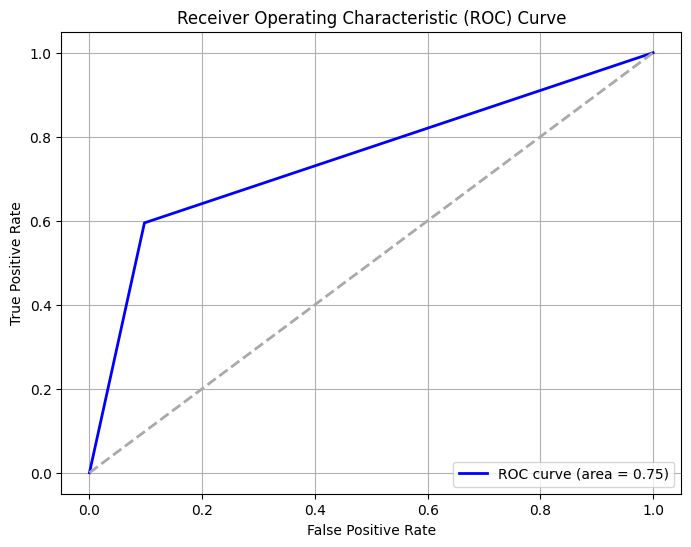

Cost-Sensitive Accuracy: 0.598750688958295


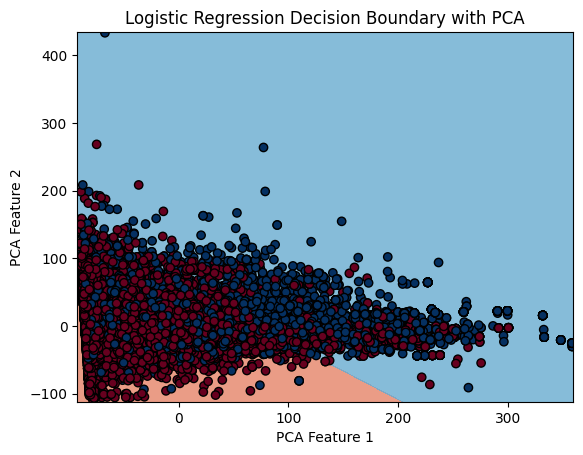

Executing logistic regression with: newton-cg, l2, 0.1, 100
Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.59      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 739 1085]]
AUC: 0.7486528670564225


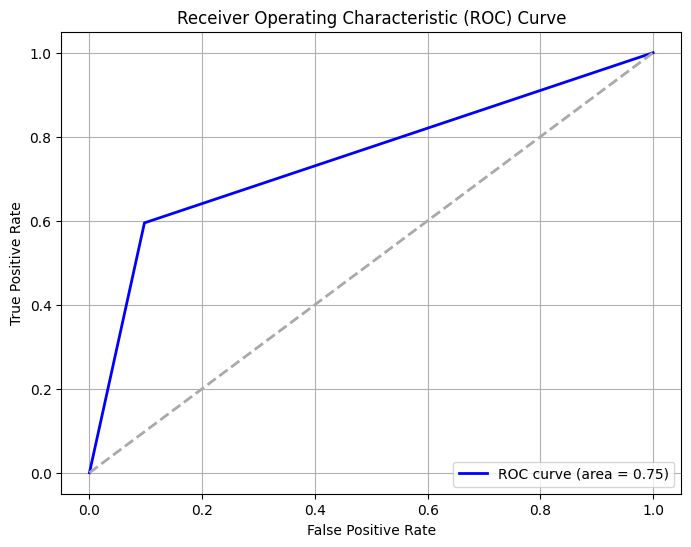

Cost-Sensitive Accuracy: 0.598750688958295


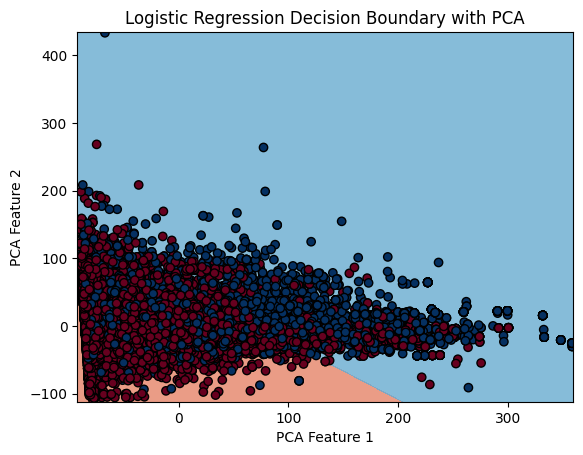

Executing logistic regression with: newton-cg, l2, 0.3, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


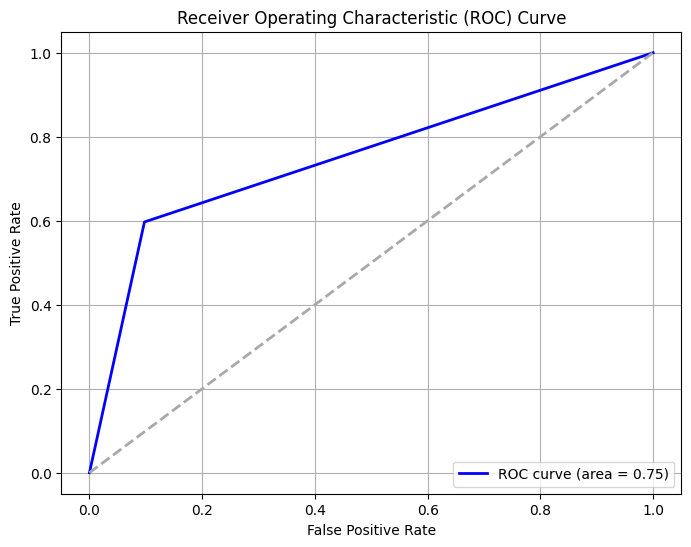

Cost-Sensitive Accuracy: 0.6002204666544184


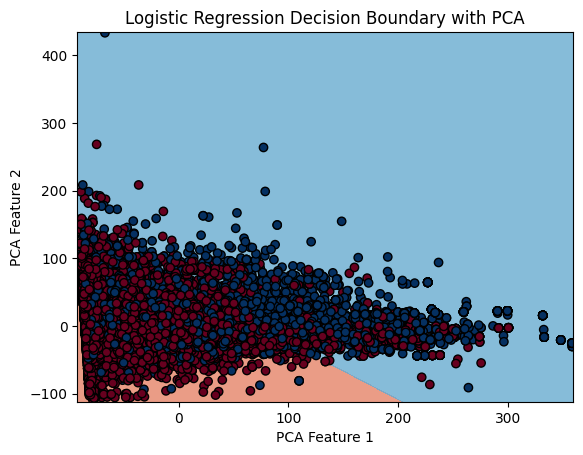

Executing logistic regression with: newton-cg, l2, 0.3, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


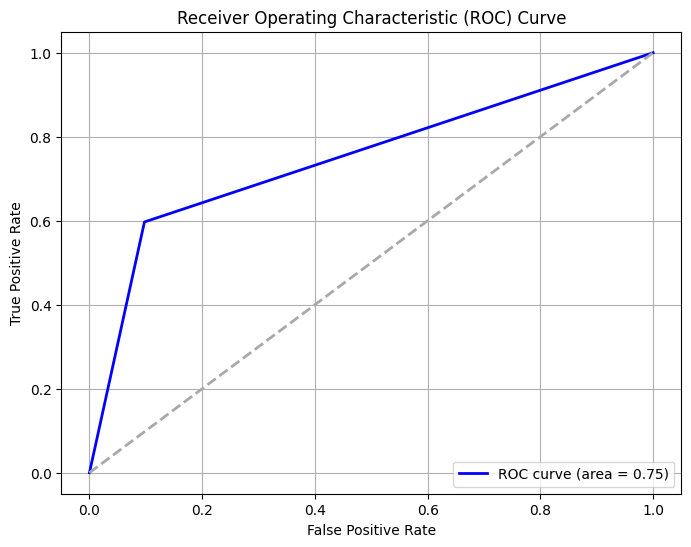

Cost-Sensitive Accuracy: 0.6002204666544184


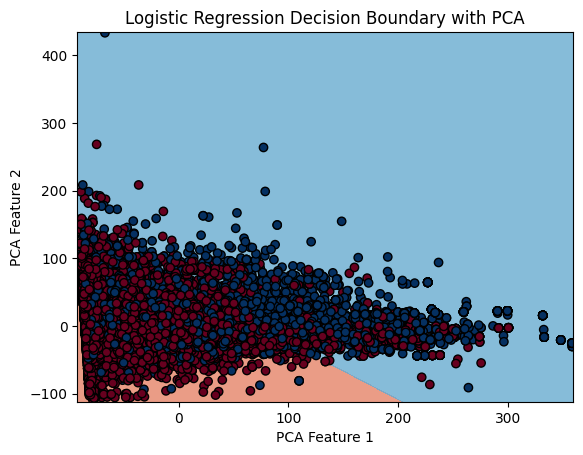

Executing logistic regression with: newton-cg, l2, 0.5, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


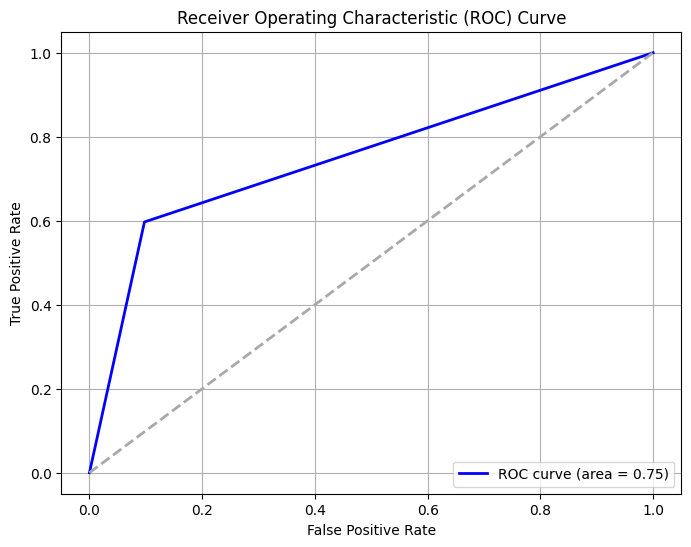

Cost-Sensitive Accuracy: 0.6002204666544184


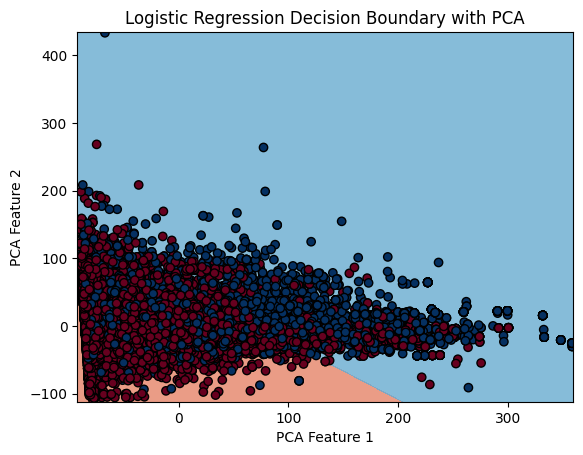

Executing logistic regression with: newton-cg, l2, 0.5, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


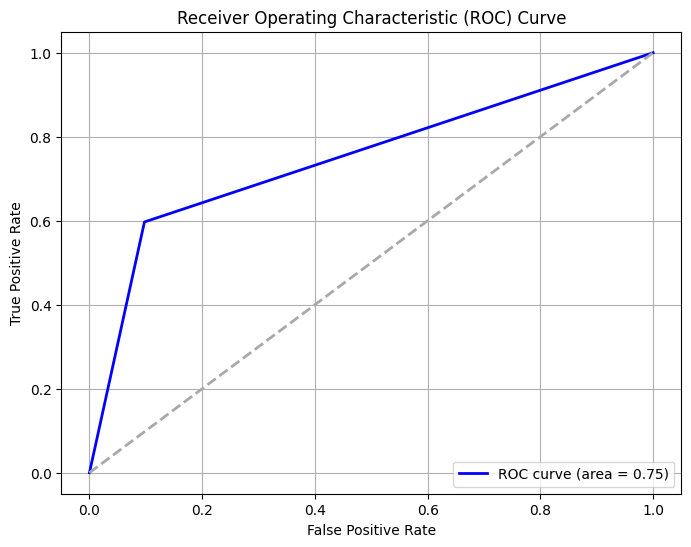

Cost-Sensitive Accuracy: 0.6002204666544184


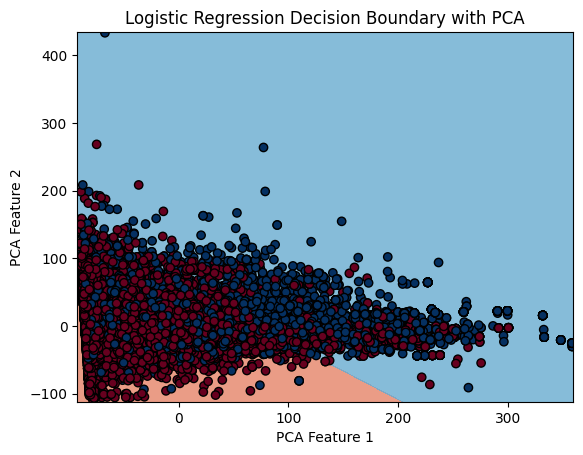

Executing logistic regression with: newton-cg, l2, 0.7, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


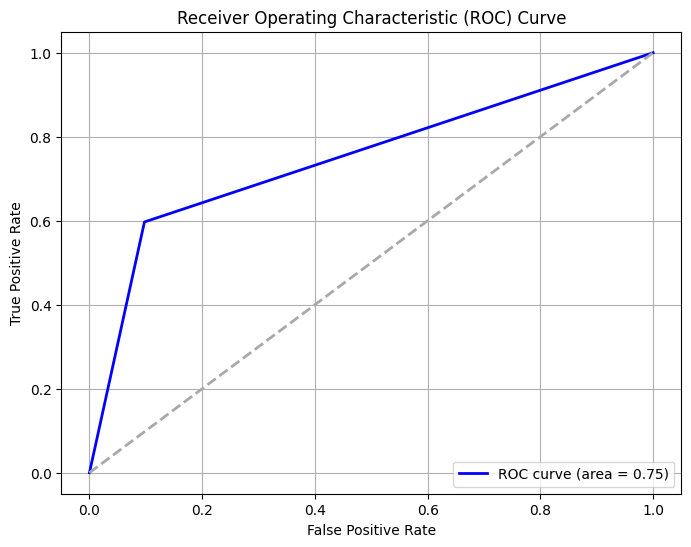

Cost-Sensitive Accuracy: 0.6002204666544184


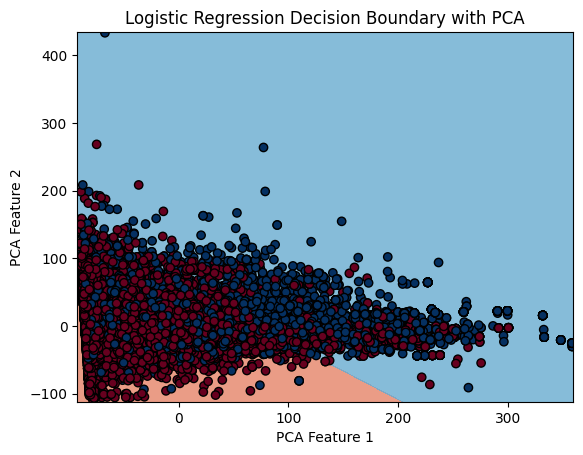

Executing logistic regression with: newton-cg, l2, 0.7, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


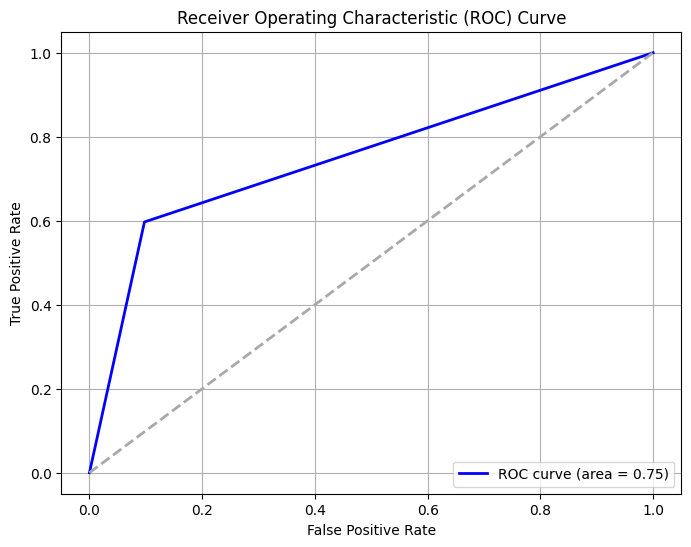

Cost-Sensitive Accuracy: 0.6002204666544184


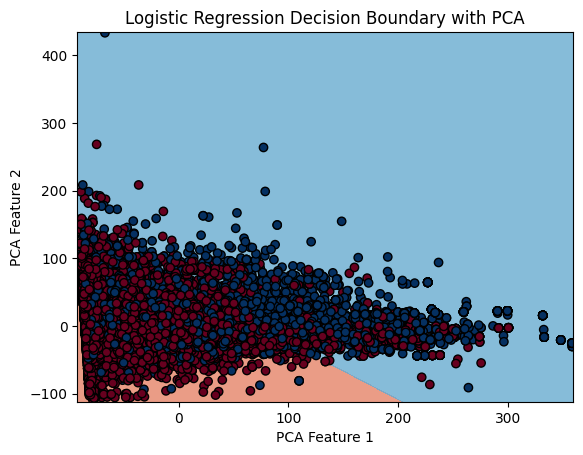

Executing logistic regression with: newton-cg, l2, 0.9, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


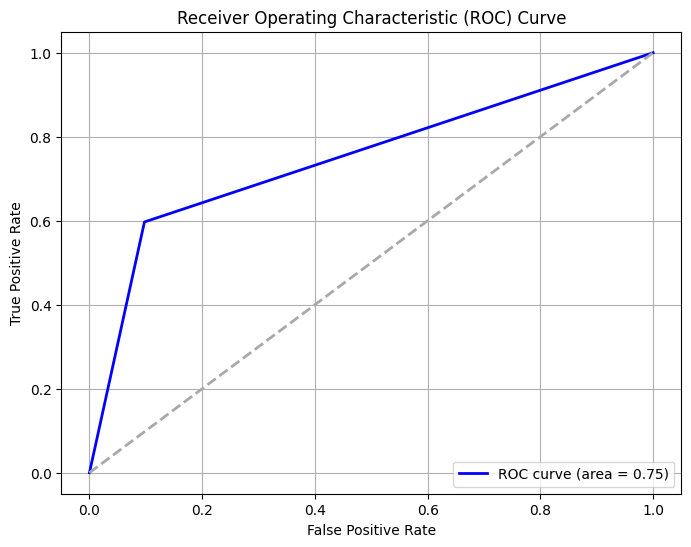

Cost-Sensitive Accuracy: 0.6002204666544184


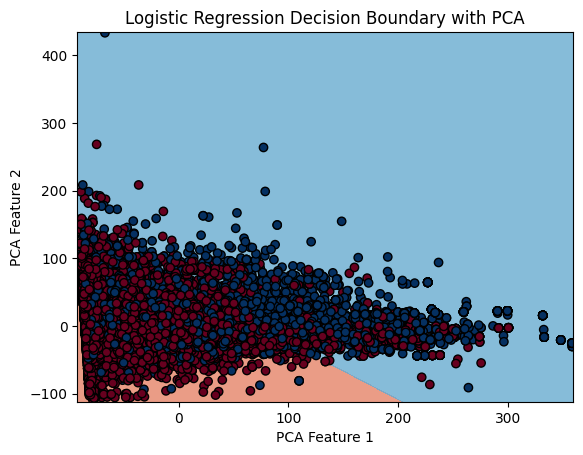

Executing logistic regression with: newton-cg, l2, 0.9, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


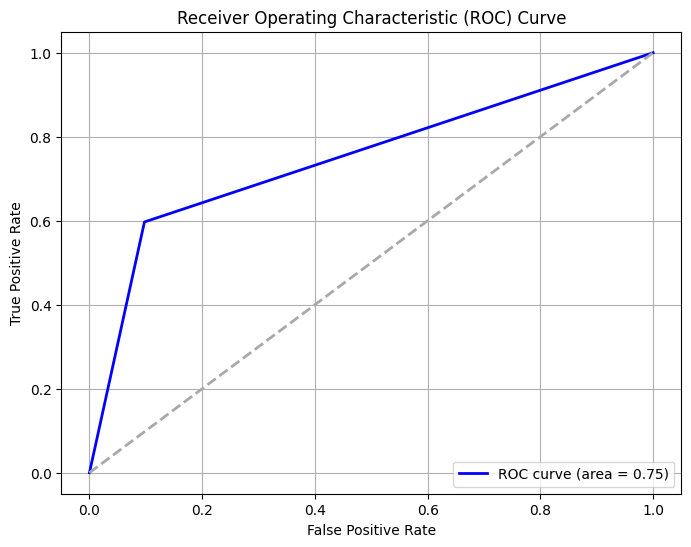

Cost-Sensitive Accuracy: 0.6002204666544184


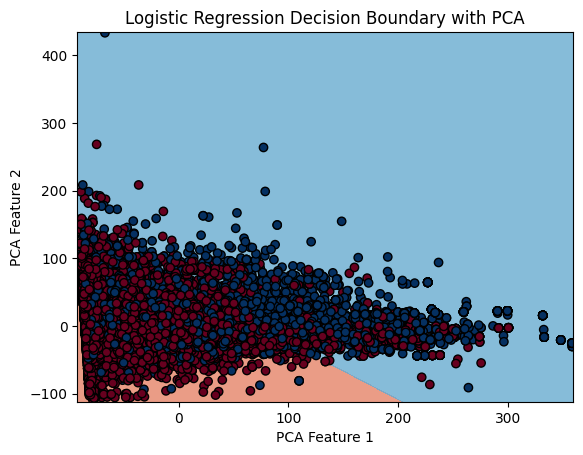

Executing logistic regression with: newton-cg, None, 0.1, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


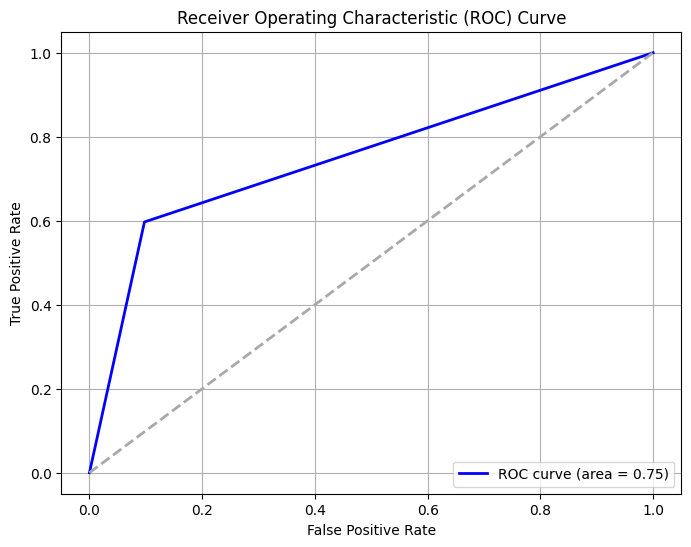

Cost-Sensitive Accuracy: 0.6002204666544184


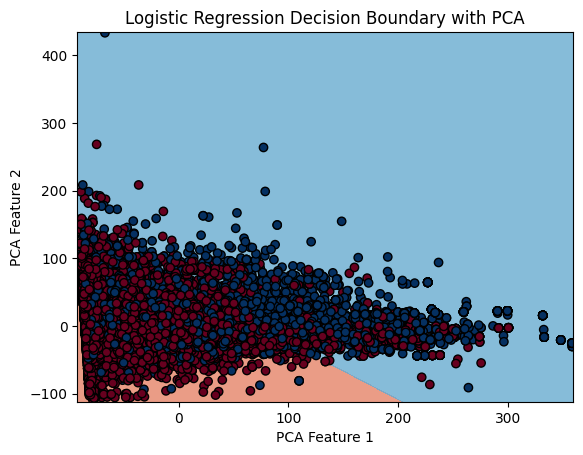

Executing logistic regression with: newton-cg, None, 0.1, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


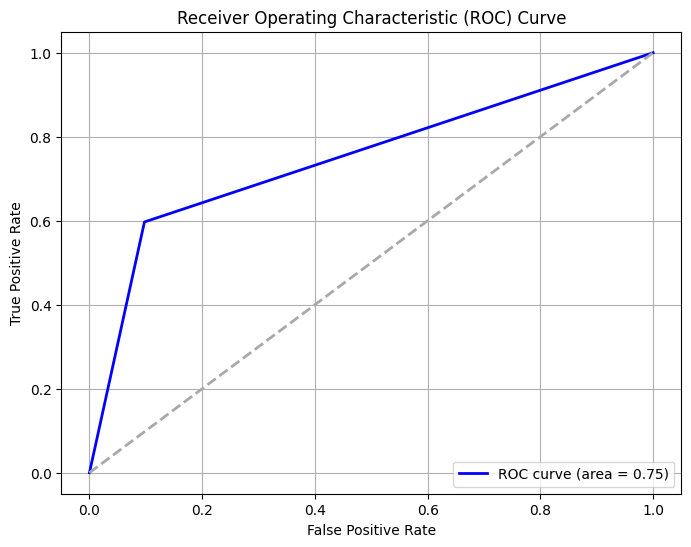

Cost-Sensitive Accuracy: 0.6002204666544184


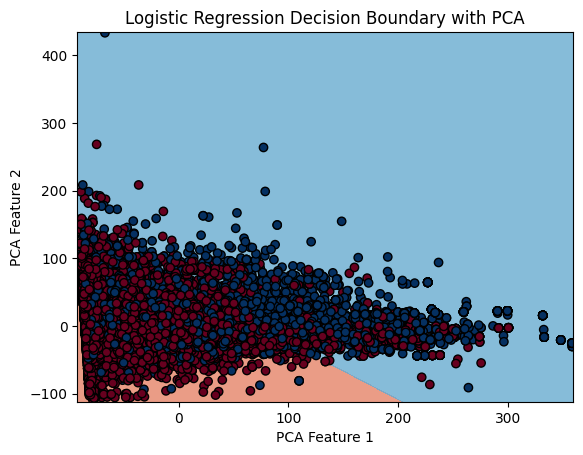

Executing logistic regression with: newton-cg, None, 0.3, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


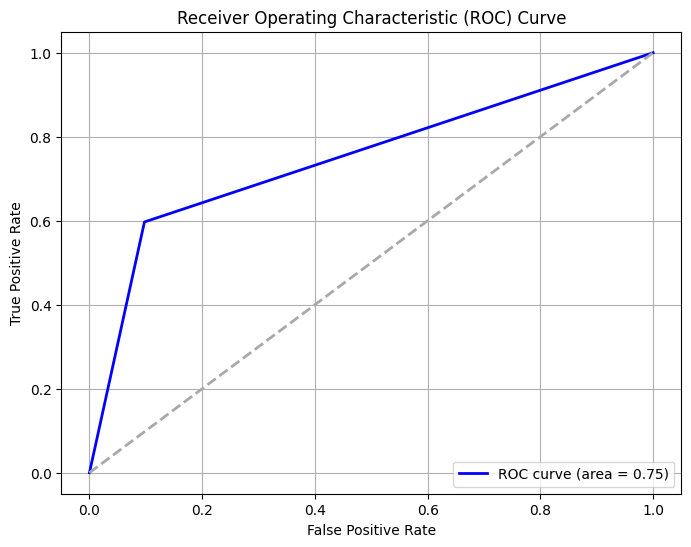

Cost-Sensitive Accuracy: 0.6002204666544184


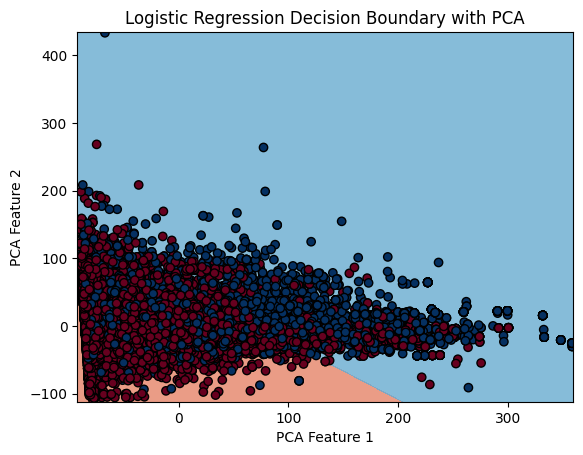

Executing logistic regression with: newton-cg, None, 0.3, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


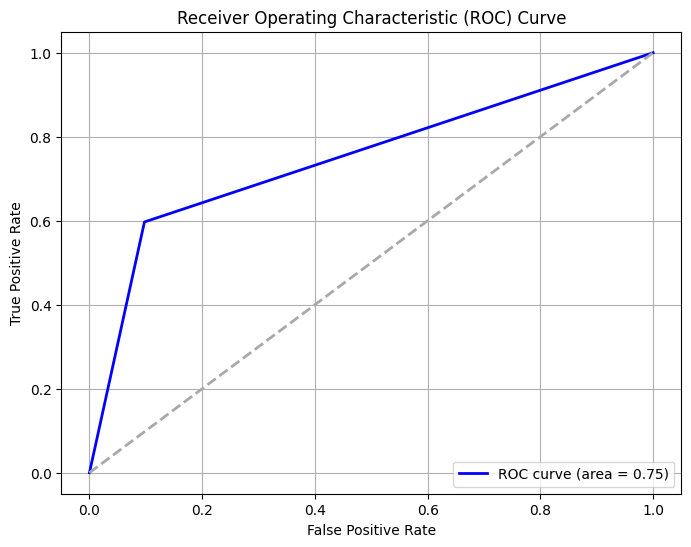

Cost-Sensitive Accuracy: 0.6002204666544184


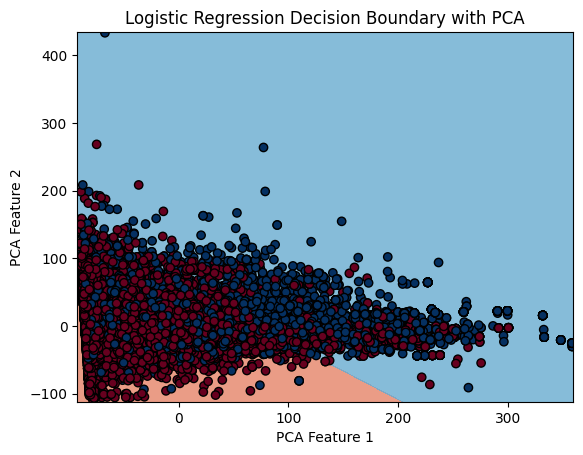

Executing logistic regression with: newton-cg, None, 0.5, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


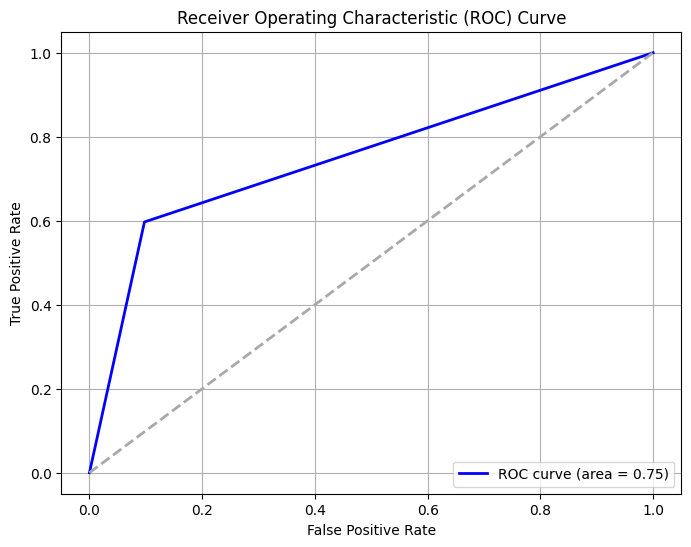

Cost-Sensitive Accuracy: 0.6002204666544184


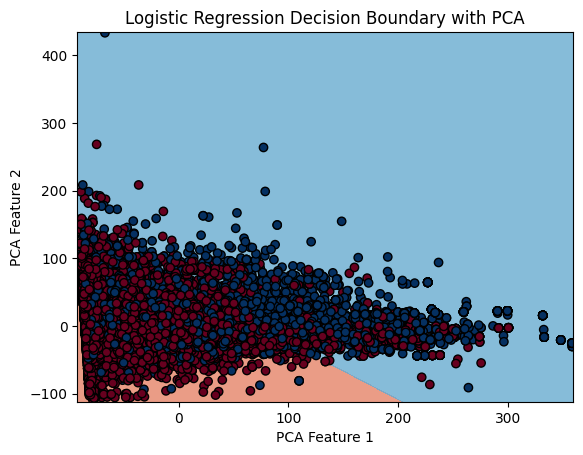

Executing logistic regression with: newton-cg, None, 0.5, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


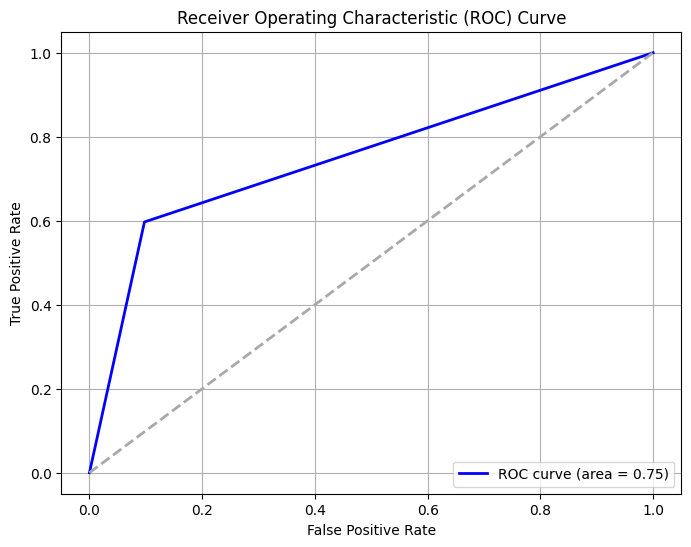

Cost-Sensitive Accuracy: 0.6002204666544184


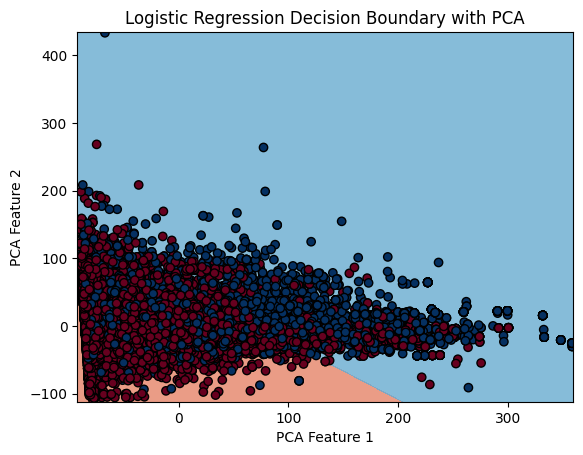

Executing logistic regression with: newton-cg, None, 0.7, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


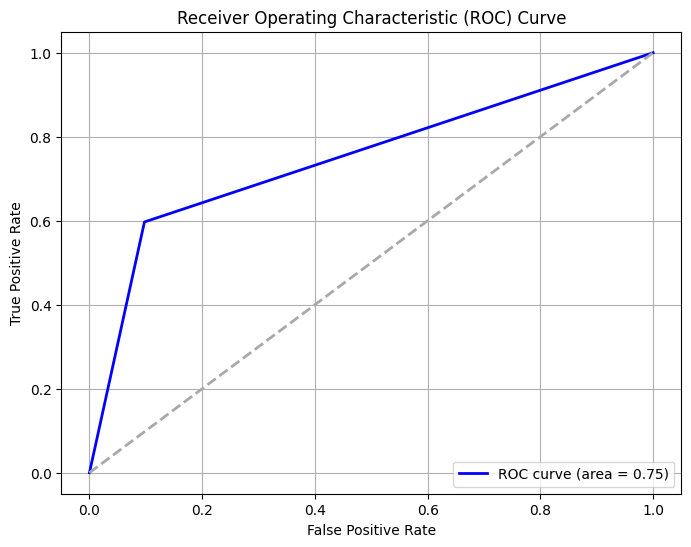

Cost-Sensitive Accuracy: 0.6002204666544184


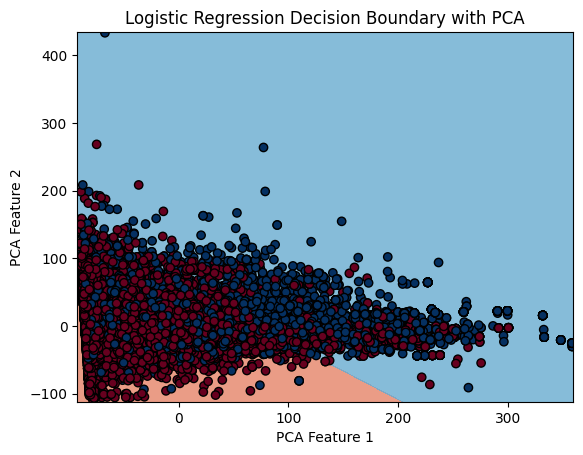

Executing logistic regression with: newton-cg, None, 0.7, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


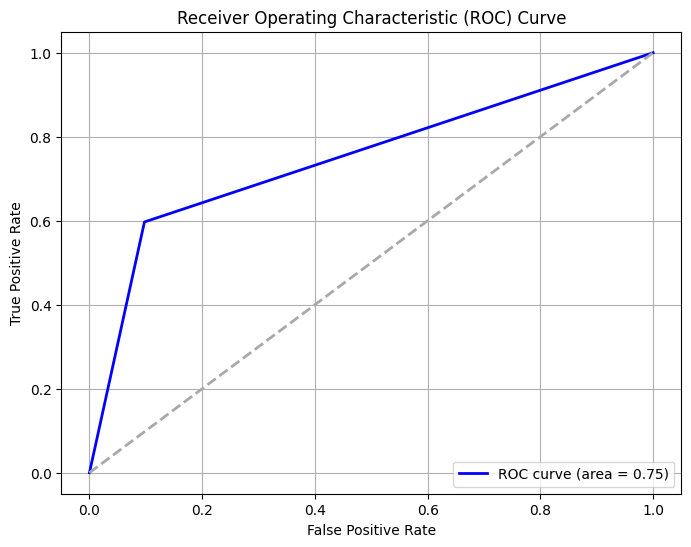

Cost-Sensitive Accuracy: 0.6002204666544184


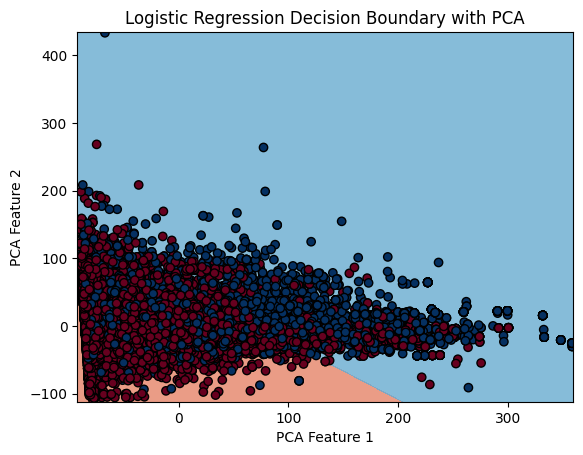

Executing logistic regression with: newton-cg, None, 0.9, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


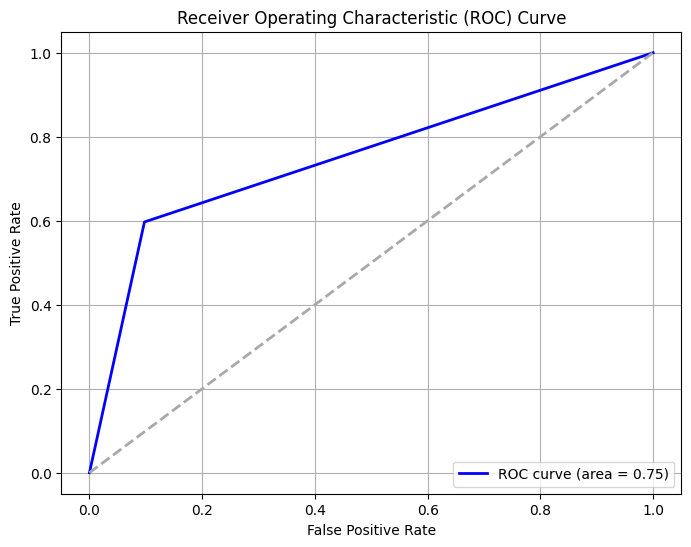

Cost-Sensitive Accuracy: 0.6002204666544184


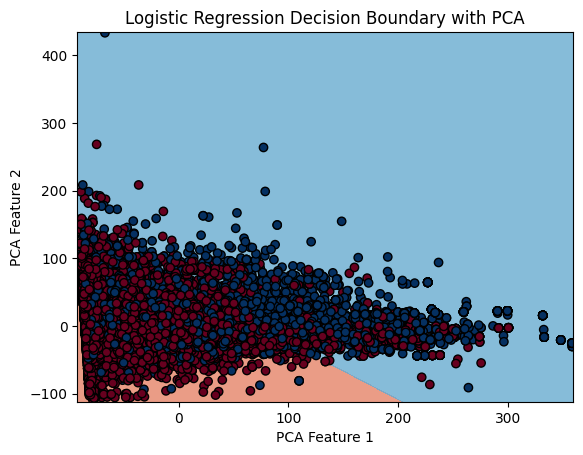

Executing logistic regression with: newton-cg, None, 0.9, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


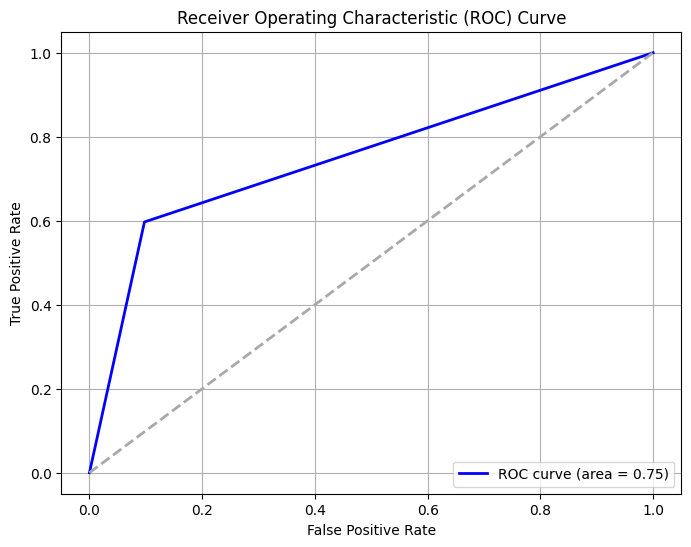

Cost-Sensitive Accuracy: 0.6002204666544184


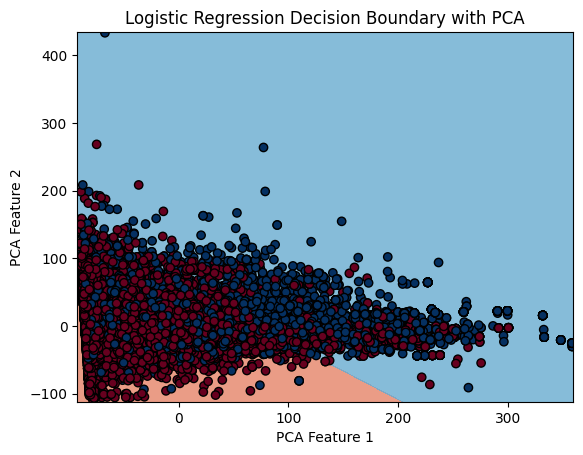

Executing logistic regression with: newton-cholesky, l2, 0.1, 50
Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.59      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 739 1085]]
AUC: 0.7486528670564225


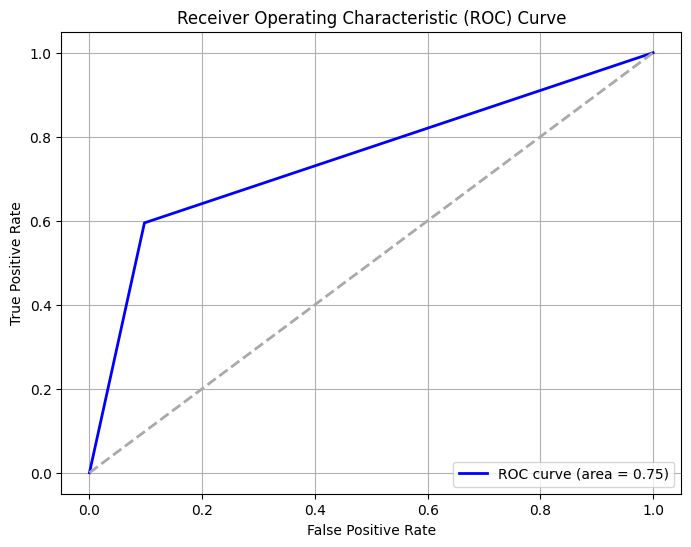

Cost-Sensitive Accuracy: 0.598750688958295


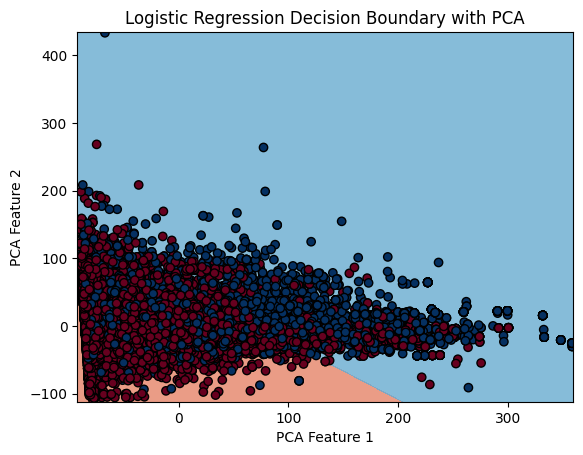

Executing logistic regression with: newton-cholesky, l2, 0.1, 100
Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.59      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 739 1085]]
AUC: 0.7486528670564225


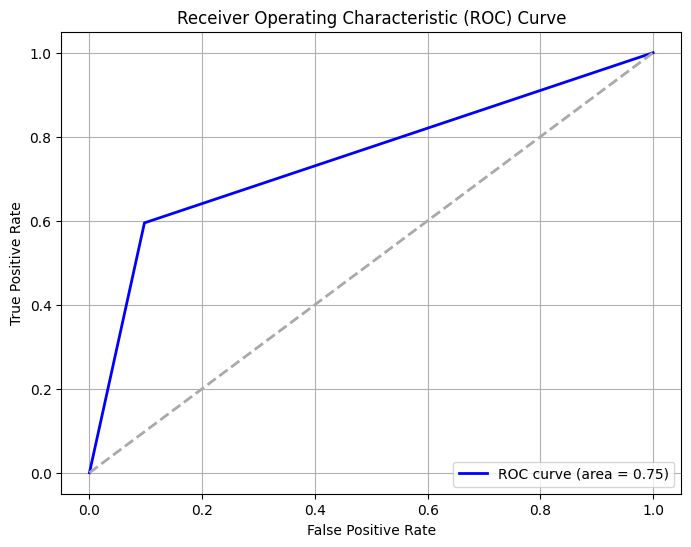

Cost-Sensitive Accuracy: 0.598750688958295


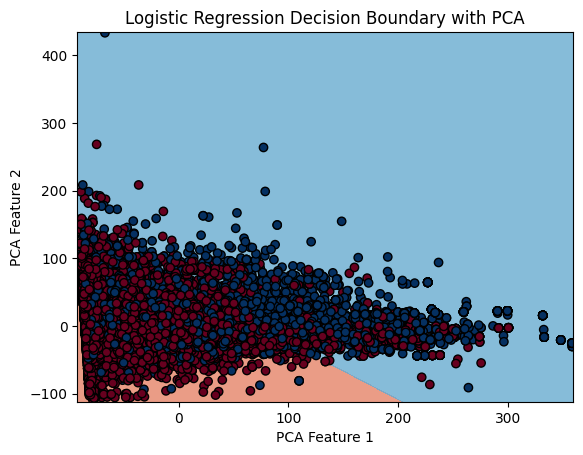

Executing logistic regression with: newton-cholesky, l2, 0.3, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


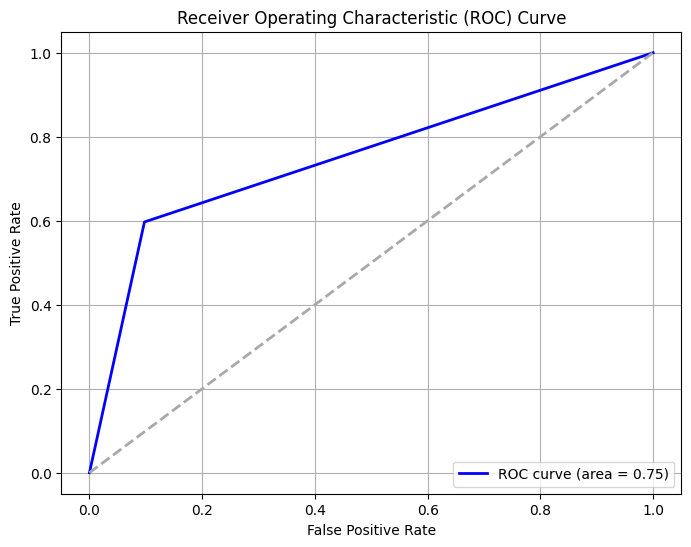

Cost-Sensitive Accuracy: 0.6002204666544184


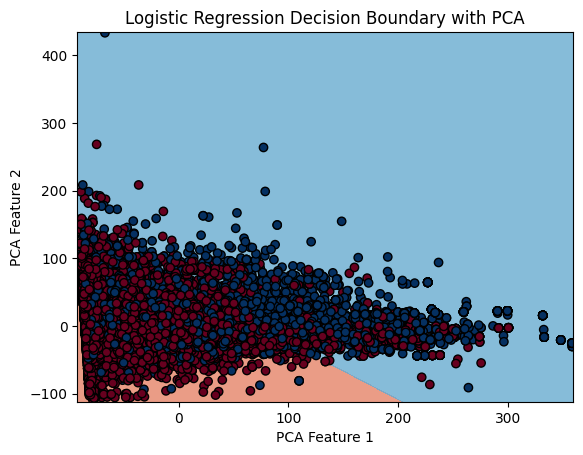

Executing logistic regression with: newton-cholesky, l2, 0.3, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


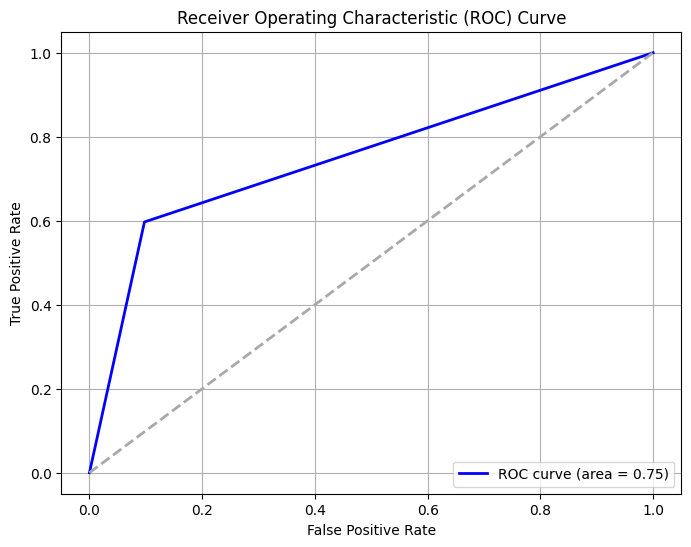

Cost-Sensitive Accuracy: 0.6002204666544184


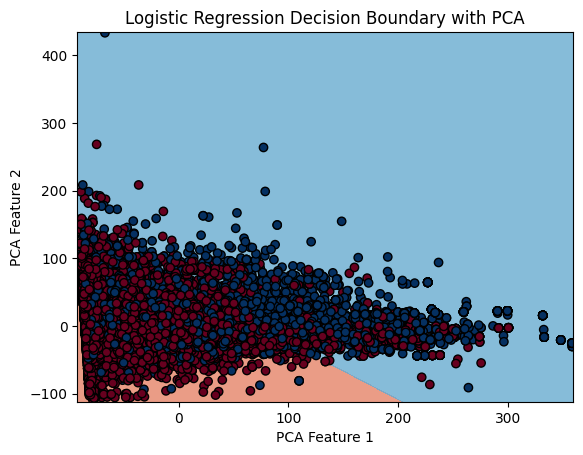

Executing logistic regression with: newton-cholesky, l2, 0.5, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


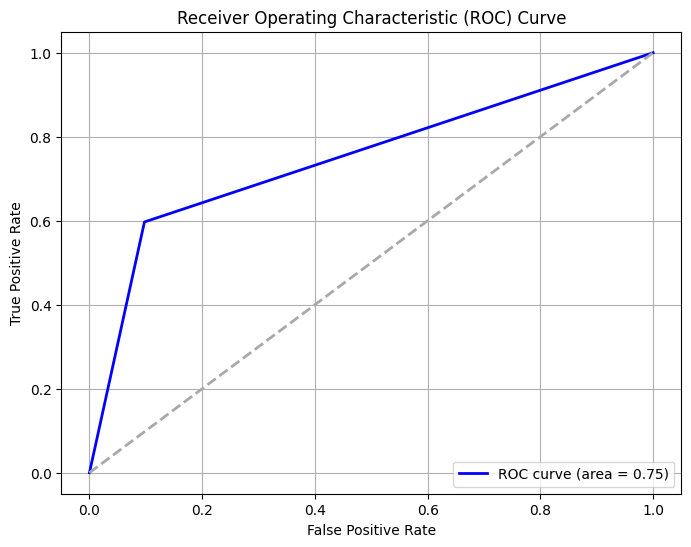

Cost-Sensitive Accuracy: 0.6002204666544184


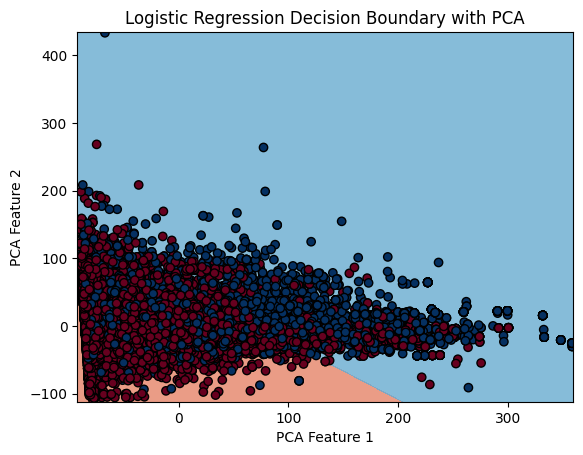

Executing logistic regression with: newton-cholesky, l2, 0.5, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


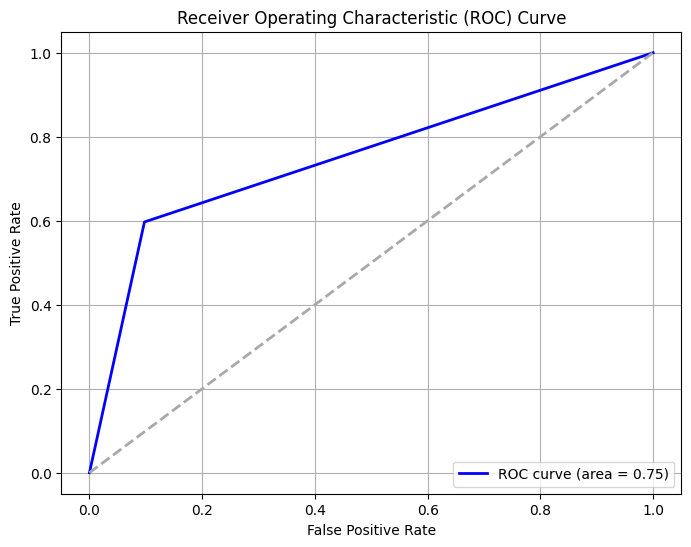

Cost-Sensitive Accuracy: 0.6002204666544184


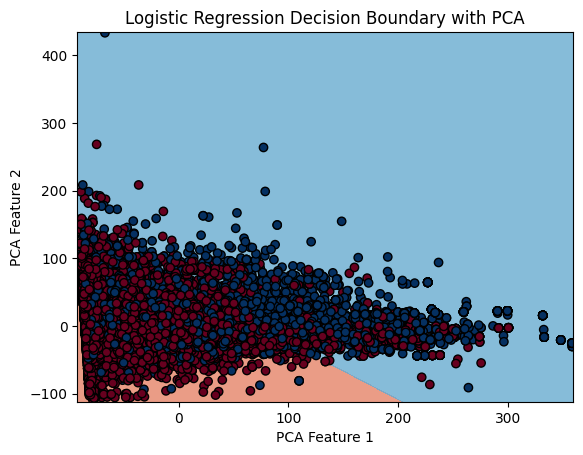

Executing logistic regression with: newton-cholesky, l2, 0.7, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


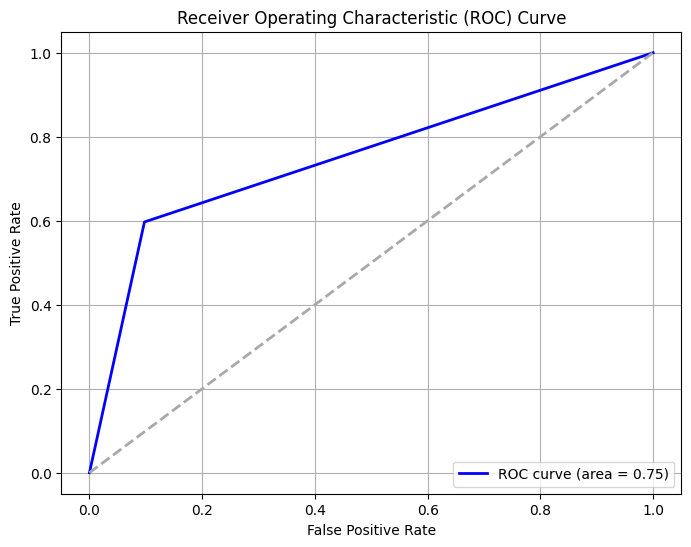

Cost-Sensitive Accuracy: 0.6002204666544184


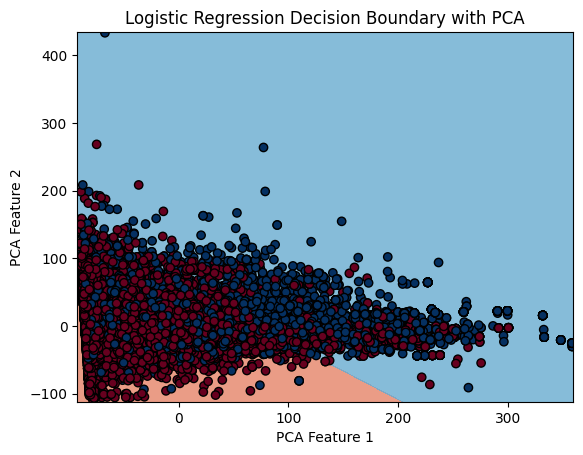

Executing logistic regression with: newton-cholesky, l2, 0.7, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


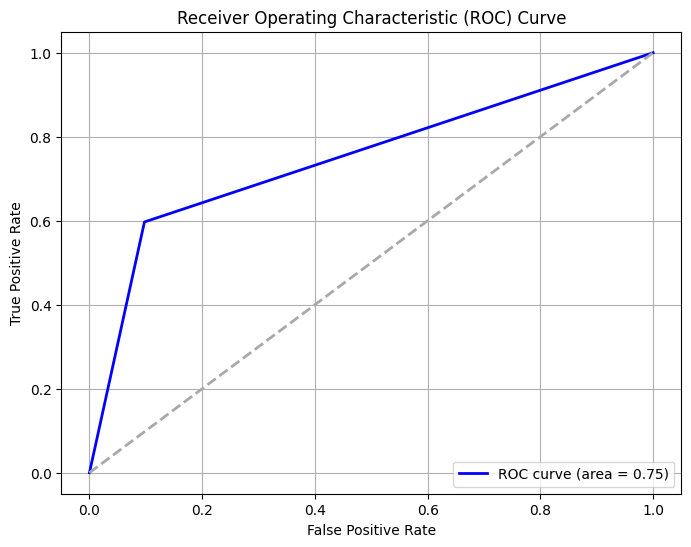

Cost-Sensitive Accuracy: 0.6002204666544184


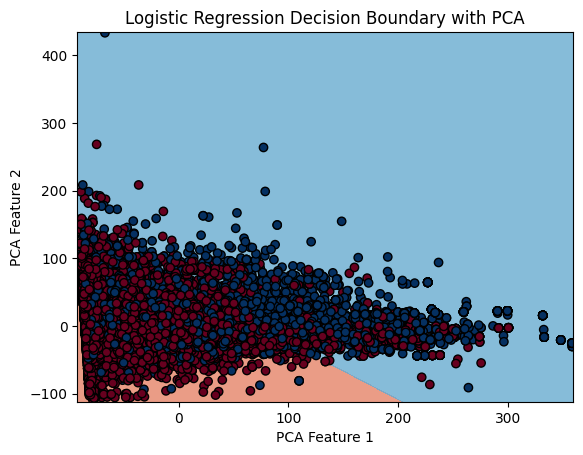

Executing logistic regression with: newton-cholesky, l2, 0.9, 50
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


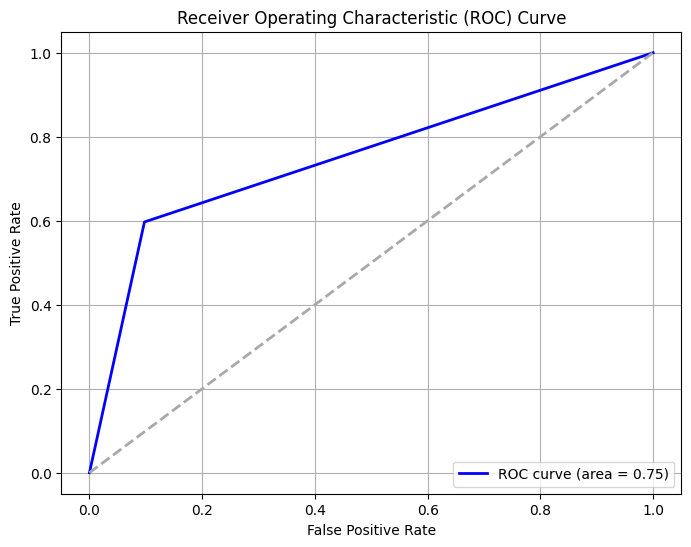

Cost-Sensitive Accuracy: 0.6002204666544184


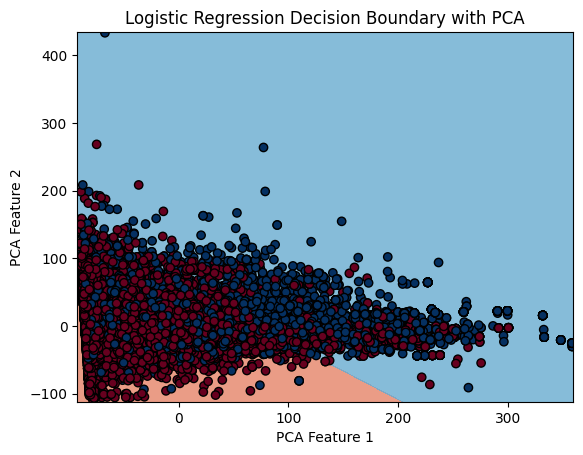

Executing logistic regression with: newton-cholesky, l2, 0.9, 100
Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


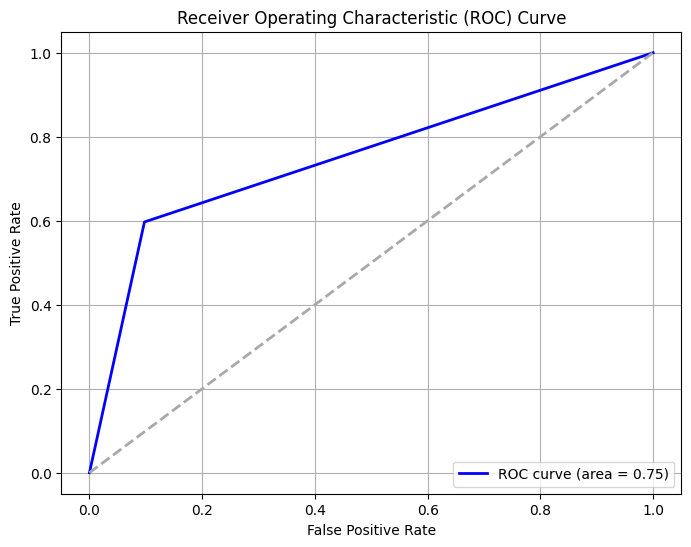

Cost-Sensitive Accuracy: 0.6002204666544184


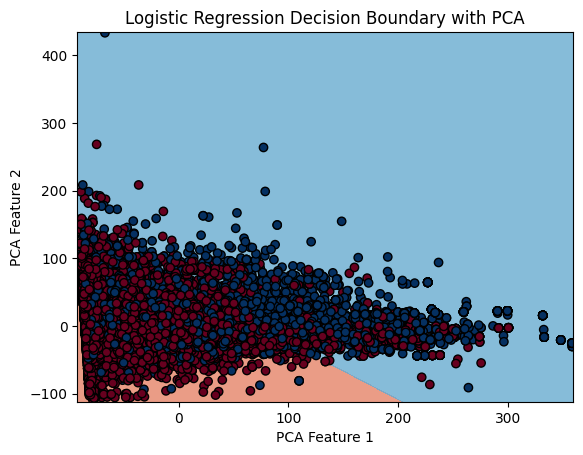

Executing logistic regression with: newton-cholesky, None, 0.1, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


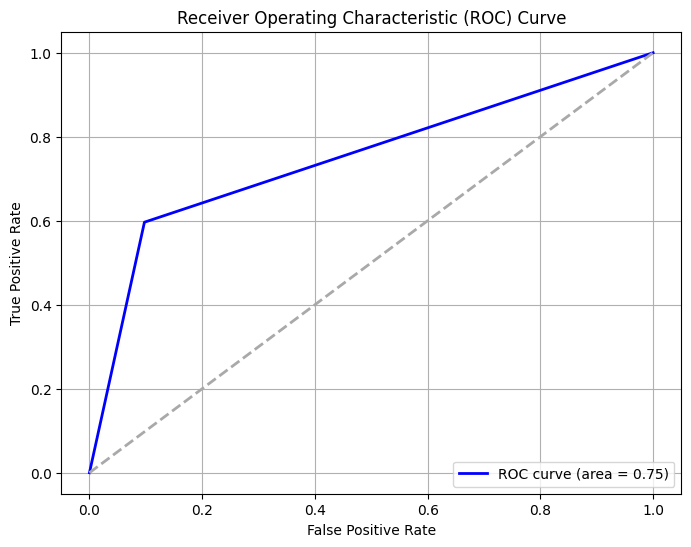

Cost-Sensitive Accuracy: 0.5998530222303877


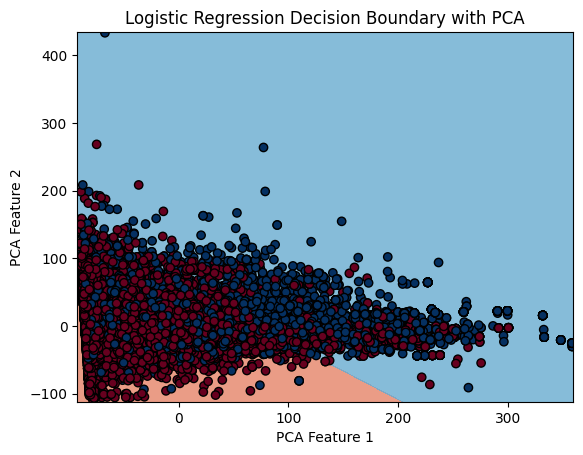

Executing logistic regression with: newton-cholesky, None, 0.1, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


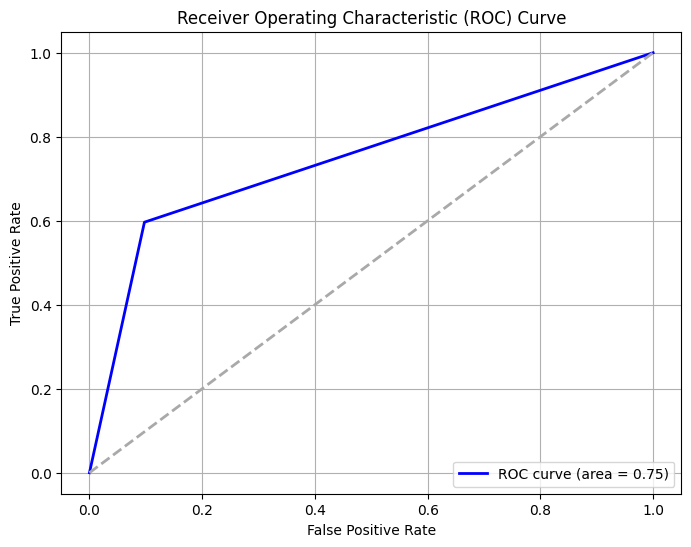

Cost-Sensitive Accuracy: 0.5998530222303877


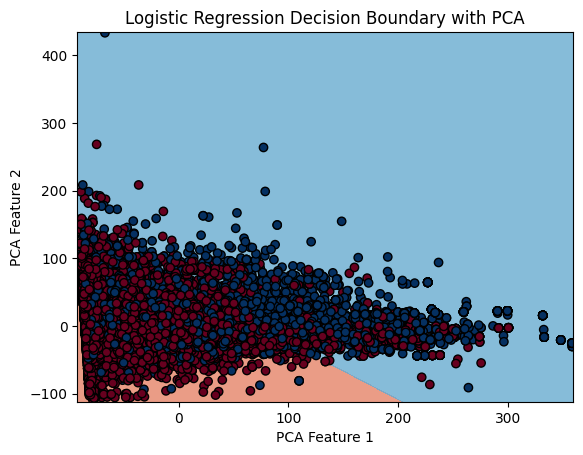

Executing logistic regression with: newton-cholesky, None, 0.3, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


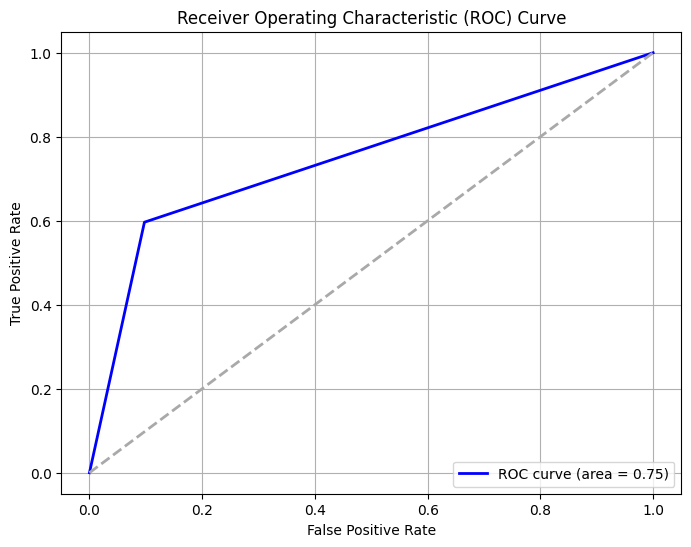

Cost-Sensitive Accuracy: 0.5998530222303877


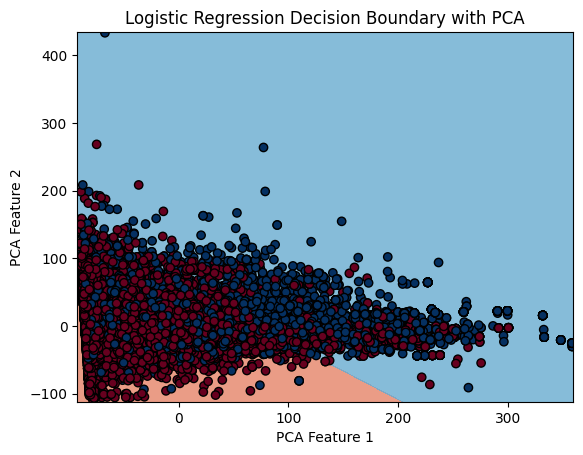

Executing logistic regression with: newton-cholesky, None, 0.3, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


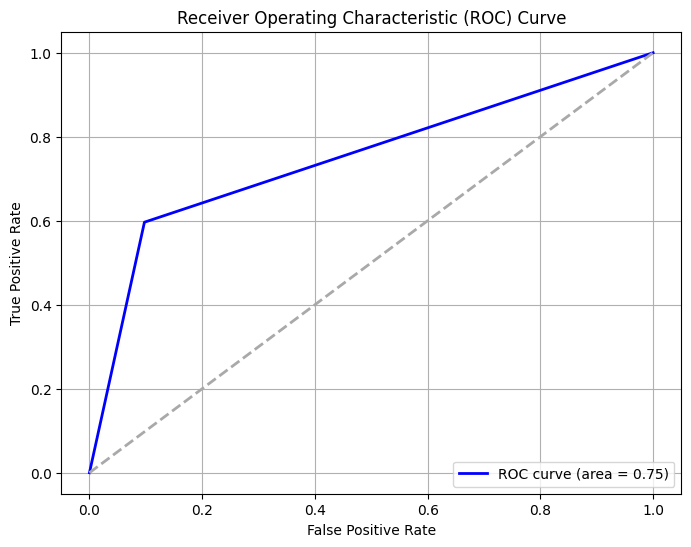

Cost-Sensitive Accuracy: 0.5998530222303877


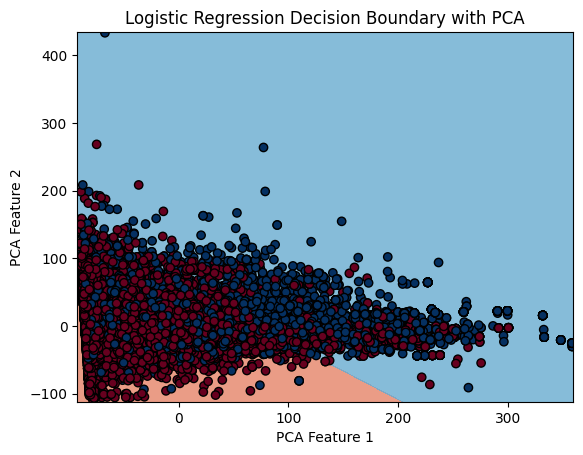

Executing logistic regression with: newton-cholesky, None, 0.5, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


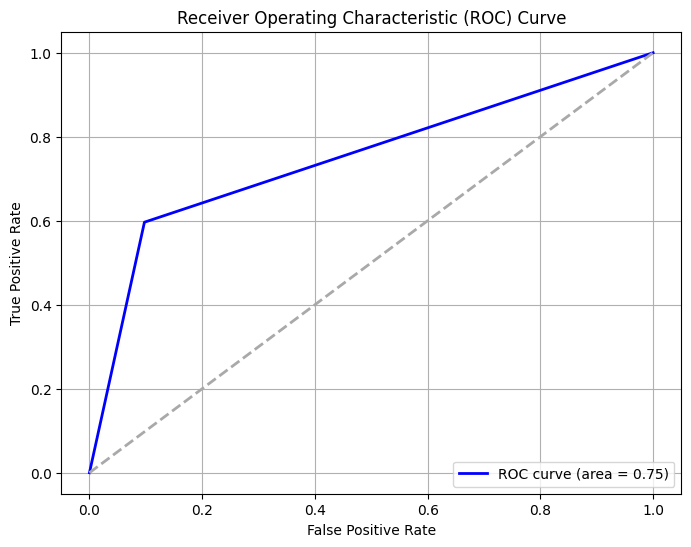

Cost-Sensitive Accuracy: 0.5998530222303877


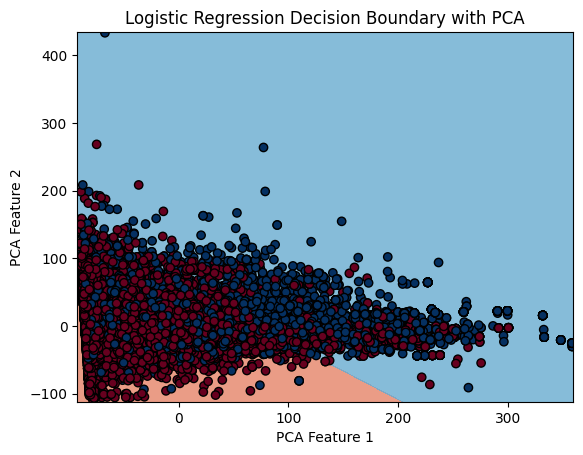

Executing logistic regression with: newton-cholesky, None, 0.5, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


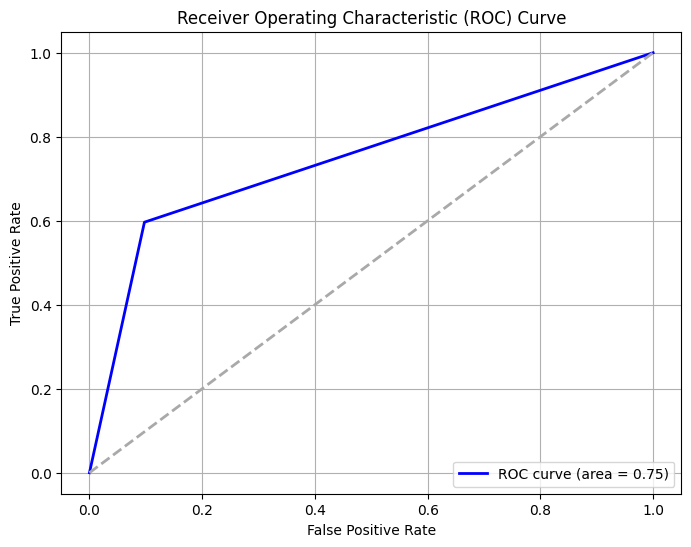

Cost-Sensitive Accuracy: 0.5998530222303877


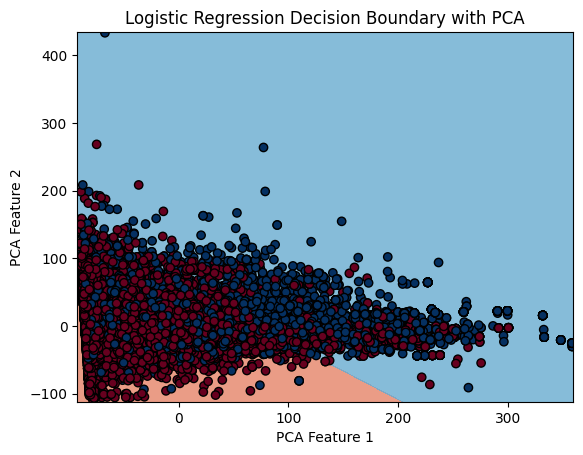

Executing logistic regression with: newton-cholesky, None, 0.7, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


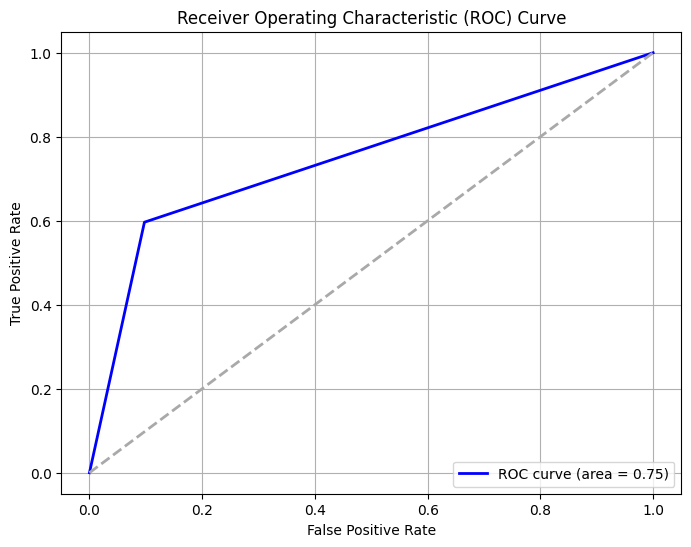

Cost-Sensitive Accuracy: 0.5998530222303877


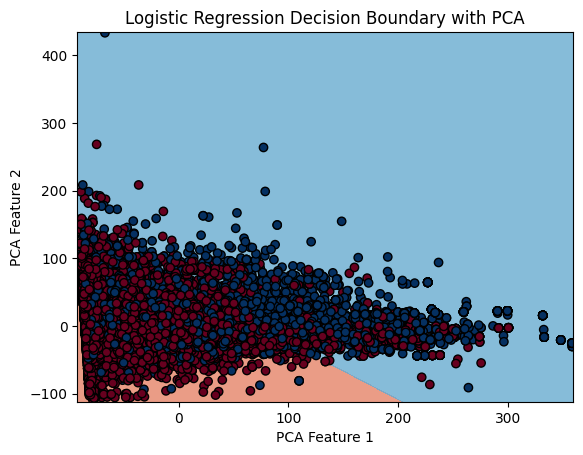

Executing logistic regression with: newton-cholesky, None, 0.7, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


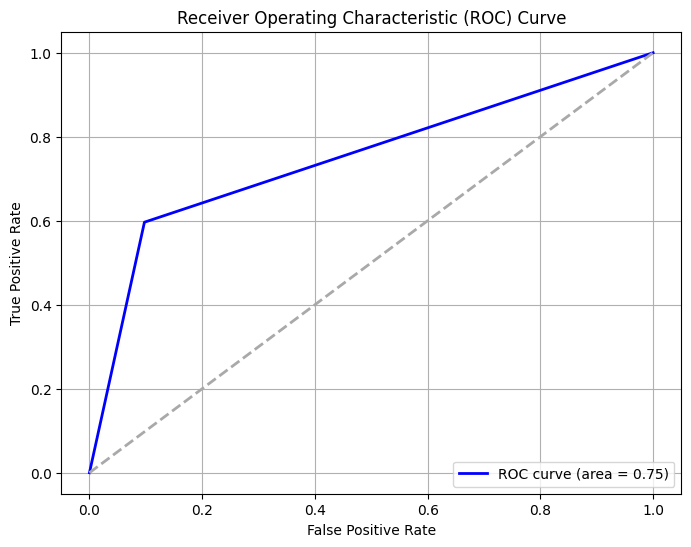

Cost-Sensitive Accuracy: 0.5998530222303877


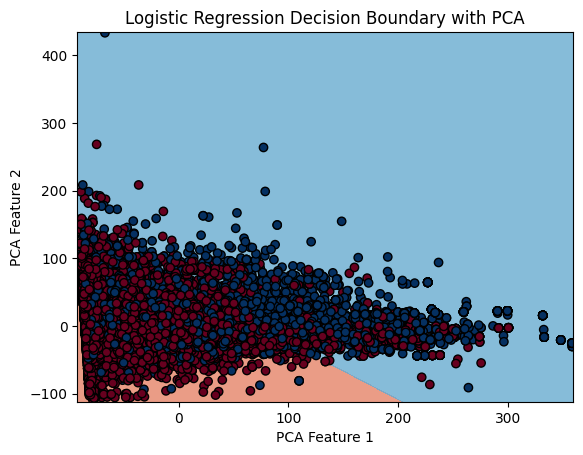

Executing logistic regression with: newton-cholesky, None, 0.9, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


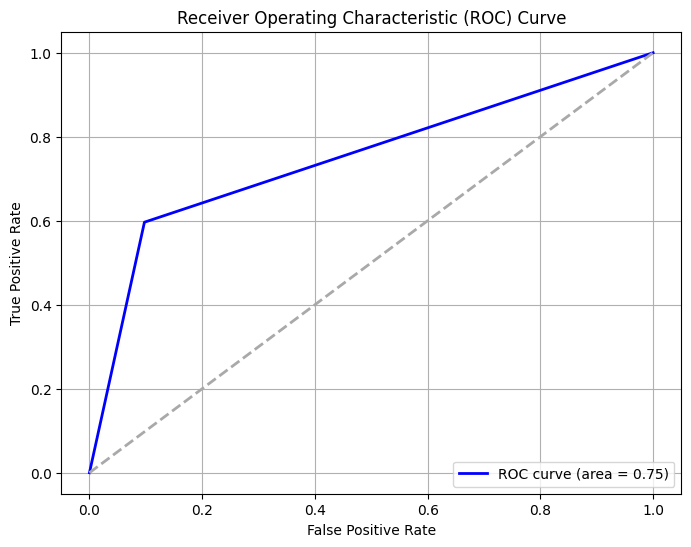

Cost-Sensitive Accuracy: 0.5998530222303877


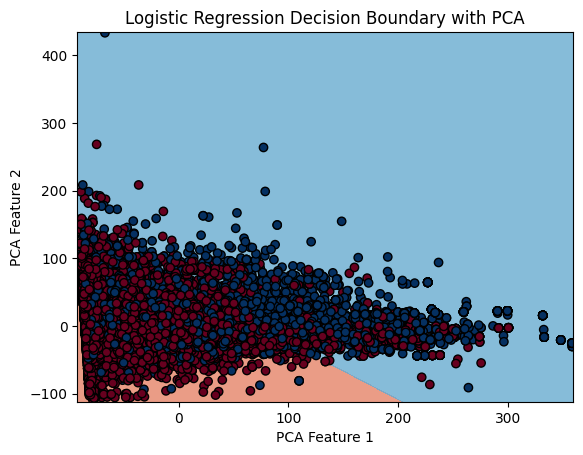

Executing logistic regression with: newton-cholesky, None, 0.9, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_glm/_newton_solver.py:491: LinAlgWarning: The inner solver of NewtonCholeskySolver stumbled upon a singular or very ill-conditioned Hessian matrix at iteration #1. It will now resort to lbfgs instead.
Further options are to use another solver or to avoid such situation in the first place. Possible remedies are removing collinear features of X or increasing the penalization strengths.
The original Linear Algebra message was:
Ill-conditioned matrix (rcond=3.50257e-17): result may not be accurate.
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


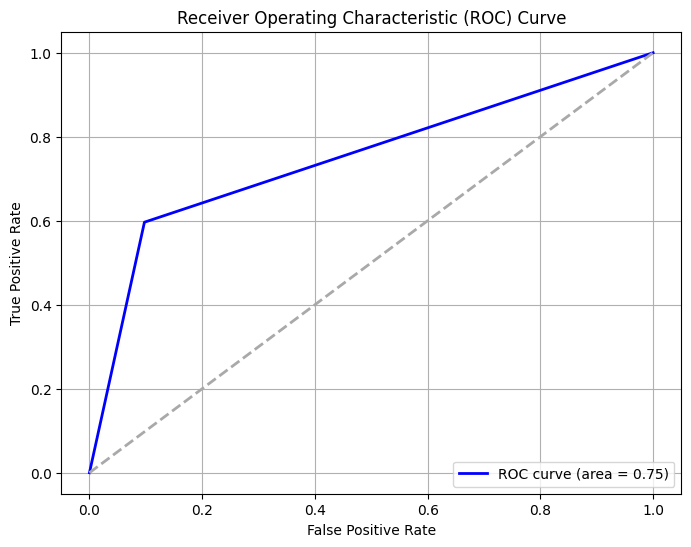

Cost-Sensitive Accuracy: 0.5998530222303877


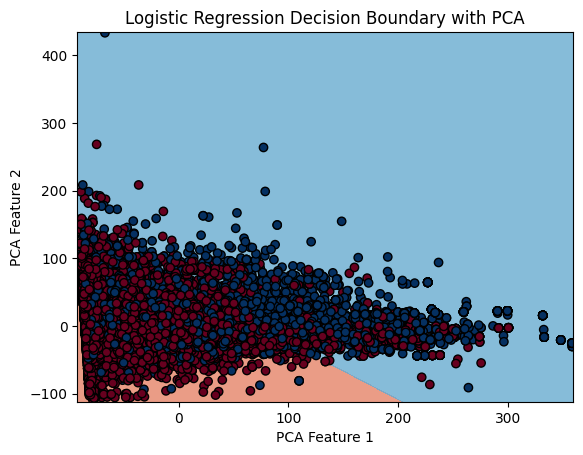

Executing logistic regression with: sag, l2, 0.1, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.59      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 739 1085]]
AUC: 0.7486528670564225


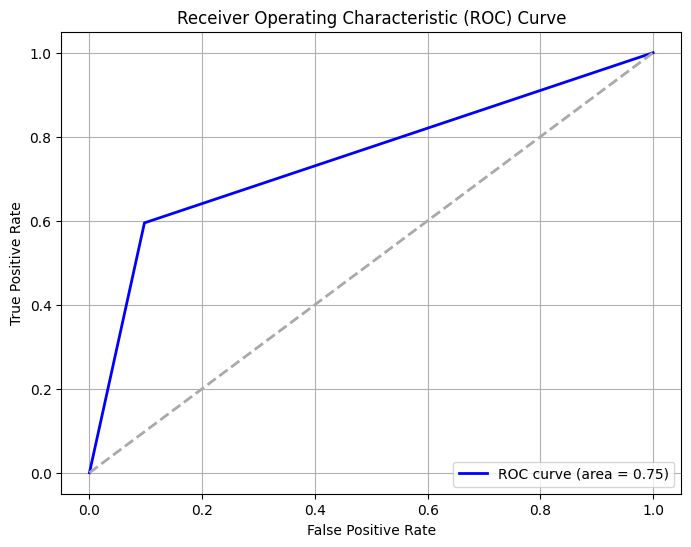

Cost-Sensitive Accuracy: 0.598750688958295


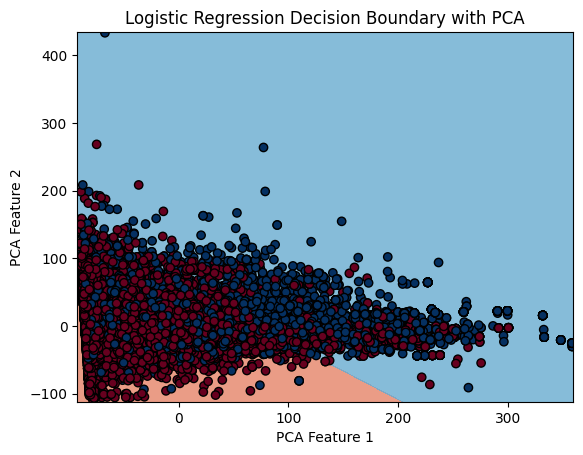

Executing logistic regression with: sag, l2, 0.1, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.59      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 739 1085]]
AUC: 0.7486528670564225


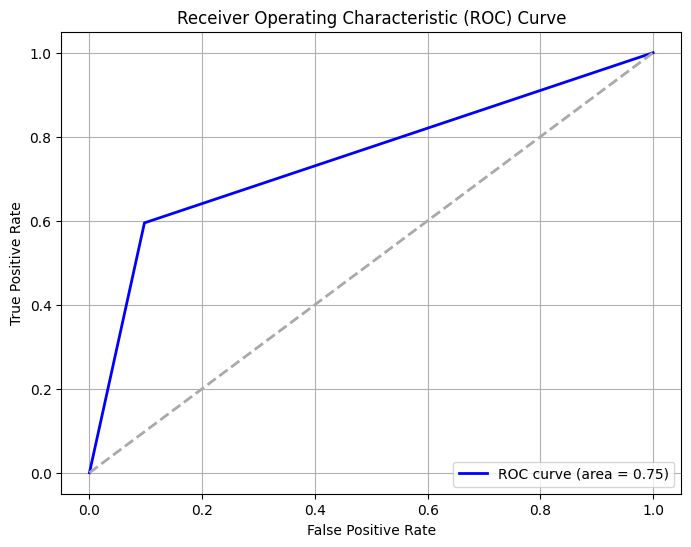

Cost-Sensitive Accuracy: 0.598750688958295


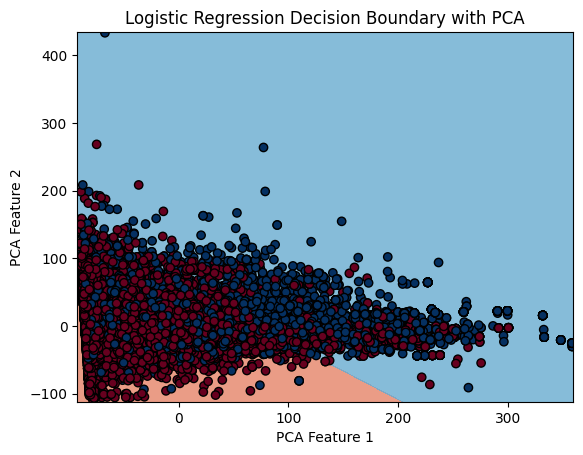

Executing logistic regression with: sag, l2, 0.3, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


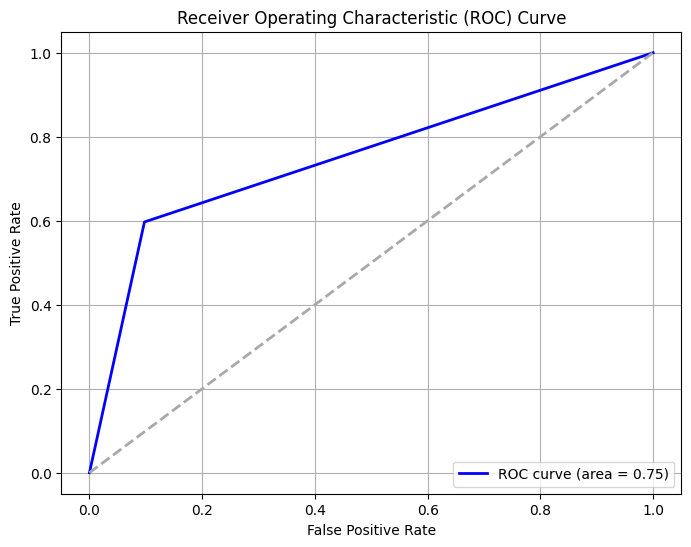

Cost-Sensitive Accuracy: 0.6002204666544184


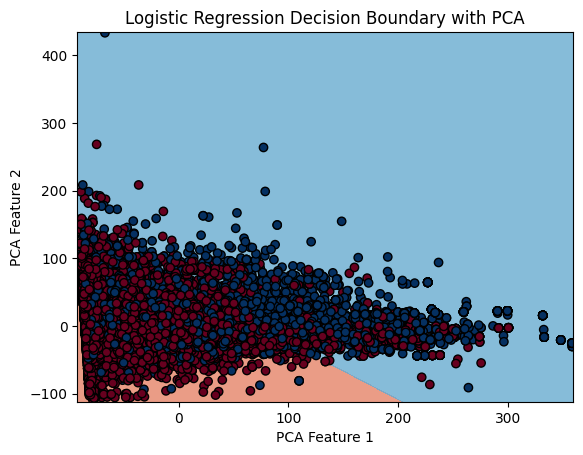

Executing logistic regression with: sag, l2, 0.3, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


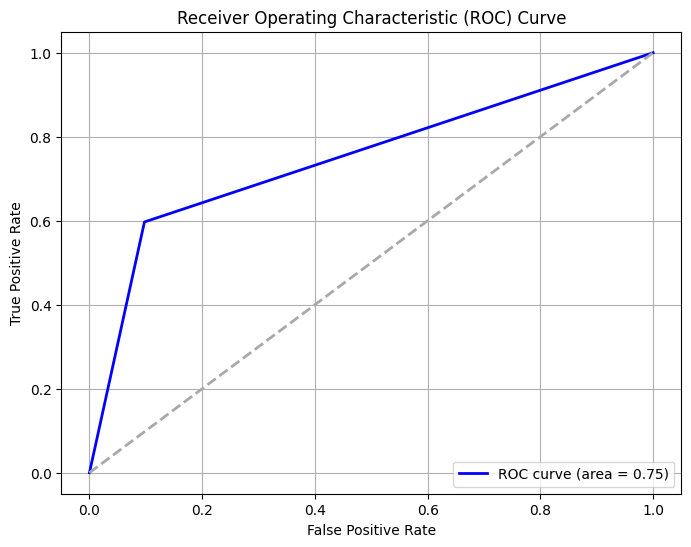

Cost-Sensitive Accuracy: 0.6002204666544184


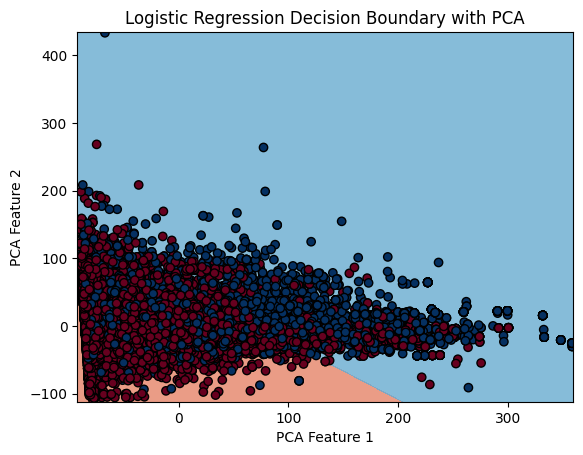

Executing logistic regression with: sag, l2, 0.5, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


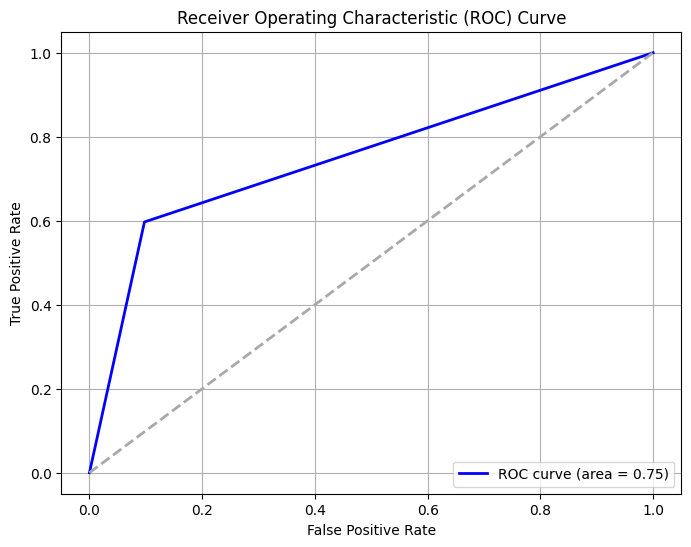

Cost-Sensitive Accuracy: 0.6002204666544184


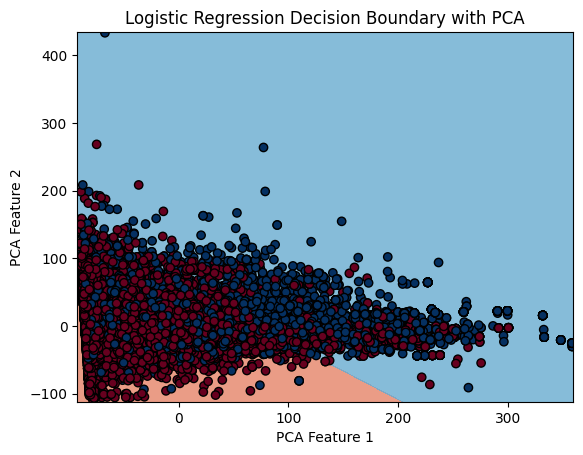

Executing logistic regression with: sag, l2, 0.5, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


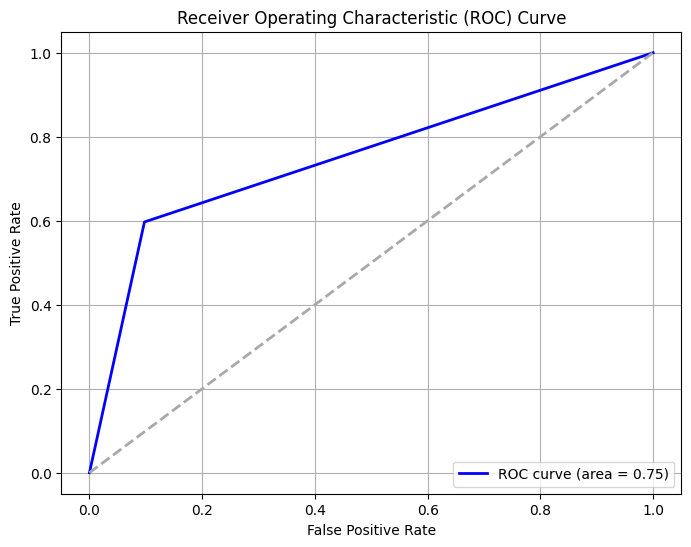

Cost-Sensitive Accuracy: 0.6002204666544184


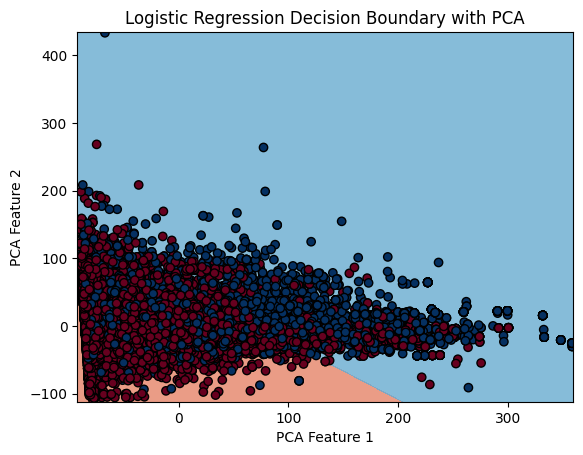

Executing logistic regression with: sag, l2, 0.7, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


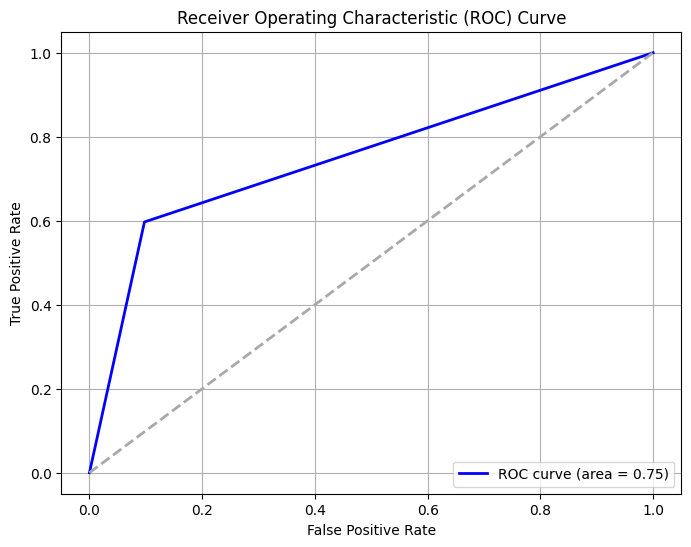

Cost-Sensitive Accuracy: 0.6002204666544184


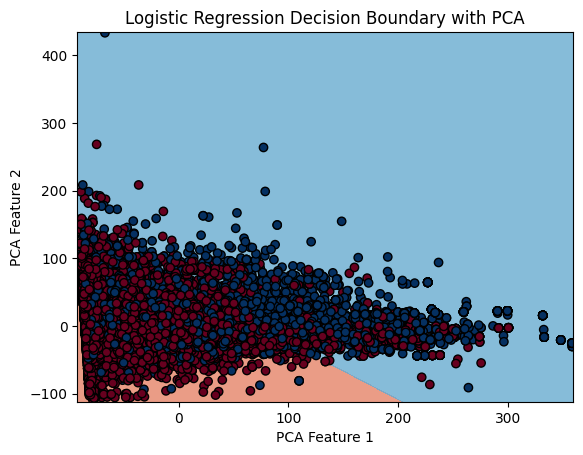

Executing logistic regression with: sag, l2, 0.7, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


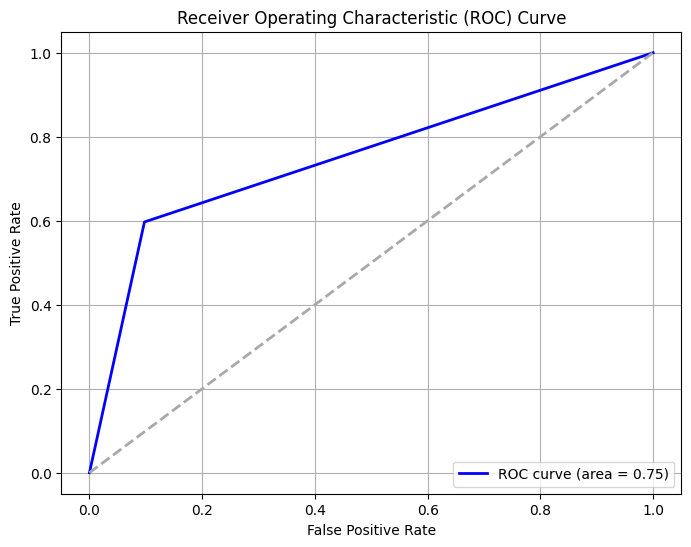

Cost-Sensitive Accuracy: 0.6002204666544184


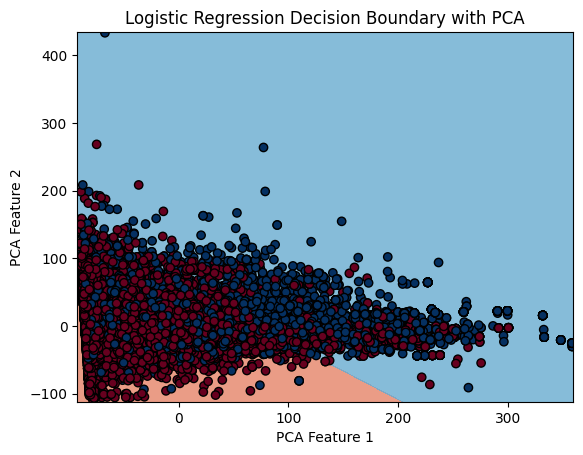

Executing logistic regression with: sag, l2, 0.9, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


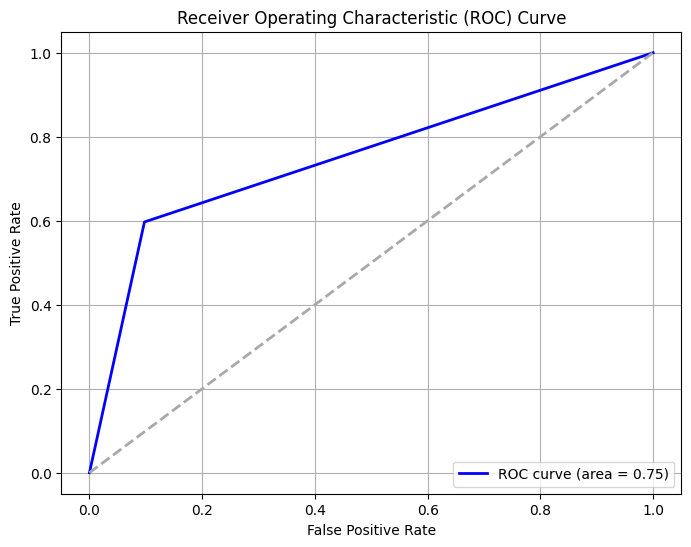

Cost-Sensitive Accuracy: 0.6002204666544184


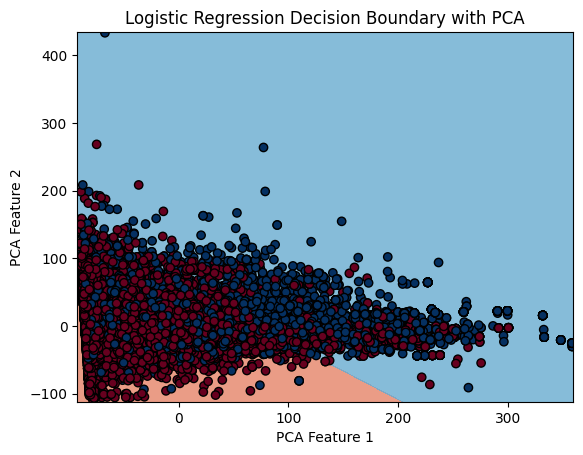

Executing logistic regression with: sag, l2, 0.9, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


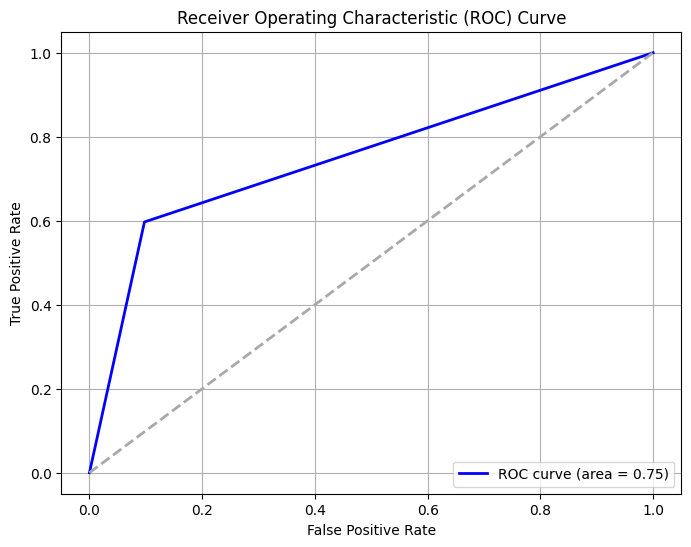

Cost-Sensitive Accuracy: 0.6002204666544184


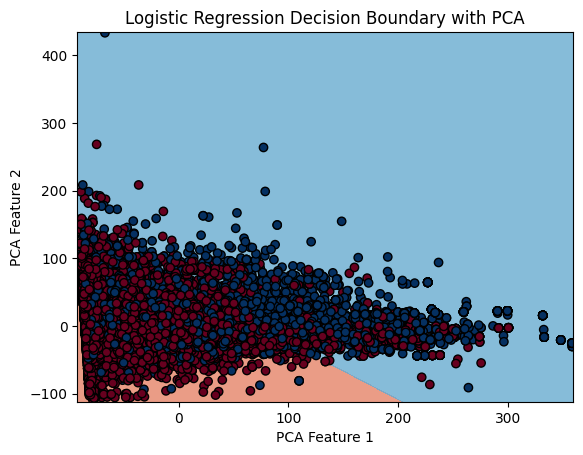

Executing logistic regression with: saga, l1, 0.1, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.78      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 738 1086]]
AUC: 0.7487888301508123


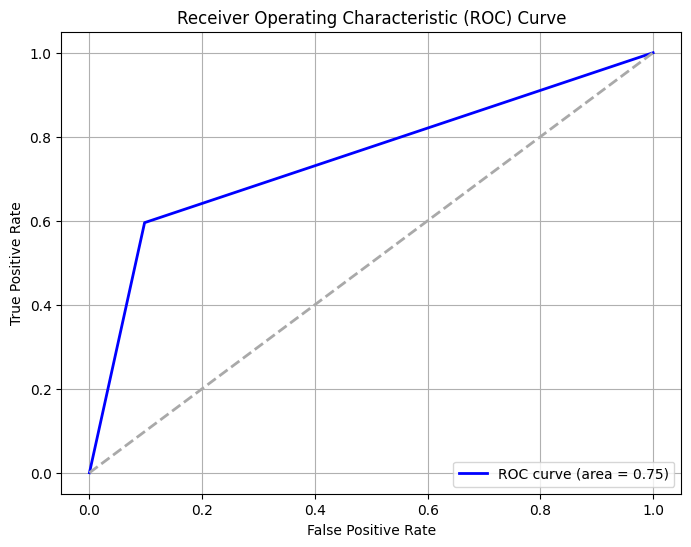

Cost-Sensitive Accuracy: 0.598750688958295


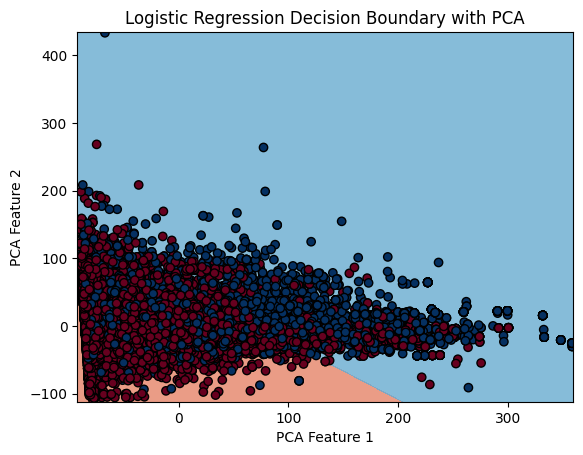

Executing logistic regression with: saga, l1, 0.1, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.78      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 738 1086]]
AUC: 0.7487888301508123


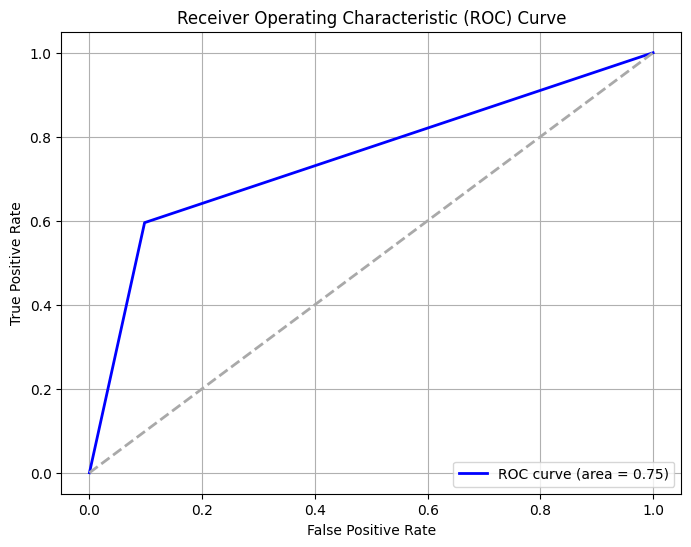

Cost-Sensitive Accuracy: 0.598750688958295


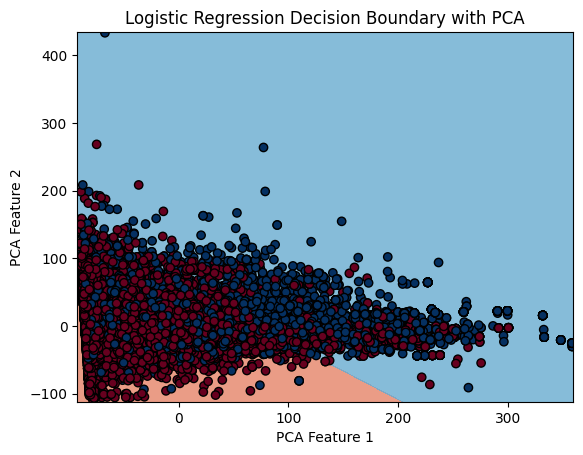

Executing logistic regression with: saga, l1, 0.3, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20044093330883703
R-squared: 0.1003995421338646
Accuracy: 0.799559066691163
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 737 1087]]
AUC: 0.7490629529578298


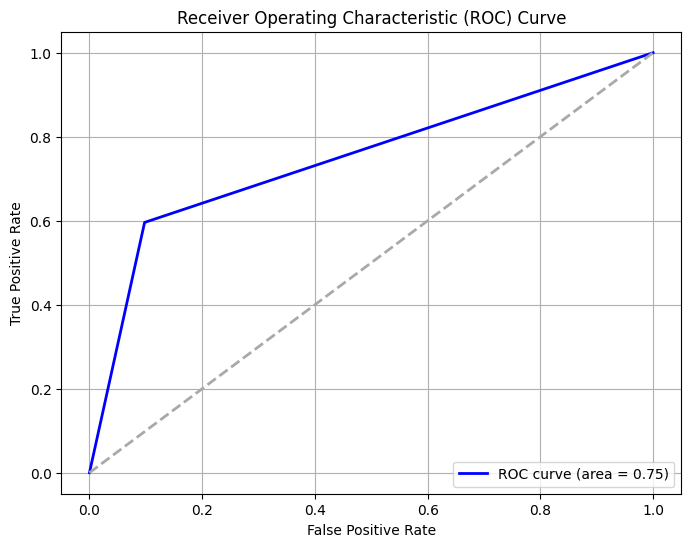

Cost-Sensitive Accuracy: 0.5991181333823259


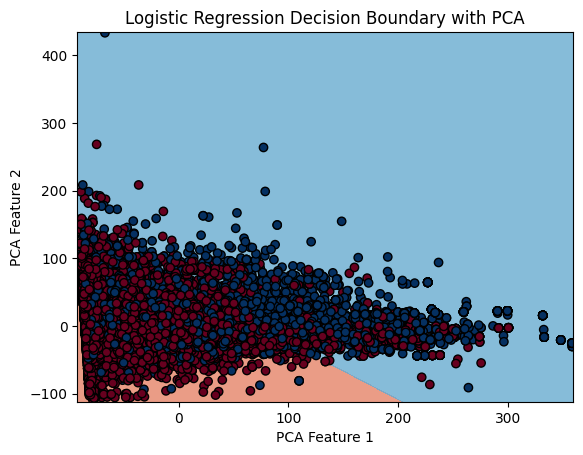

Executing logistic regression with: saga, l1, 0.3, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20044093330883703
R-squared: 0.1003995421338646
Accuracy: 0.799559066691163
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 737 1087]]
AUC: 0.7490629529578298


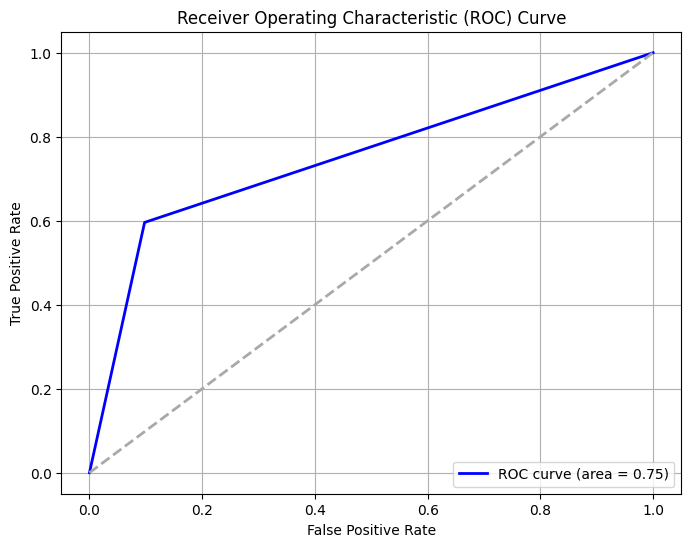

Cost-Sensitive Accuracy: 0.5991181333823259


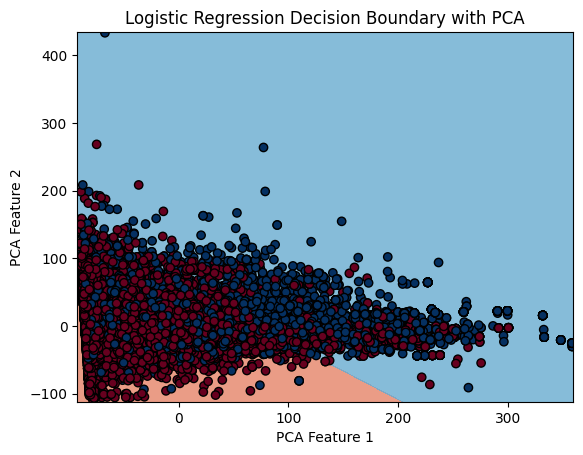

Executing logistic regression with: saga, l1, 0.5, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


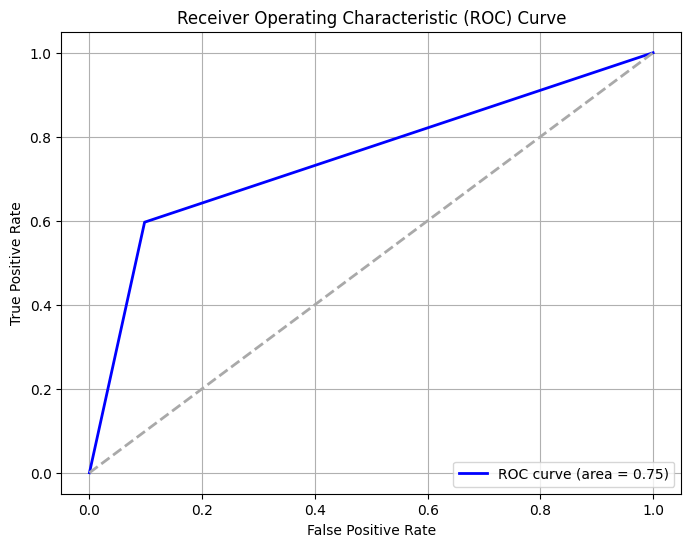

Cost-Sensitive Accuracy: 0.5994855778063568


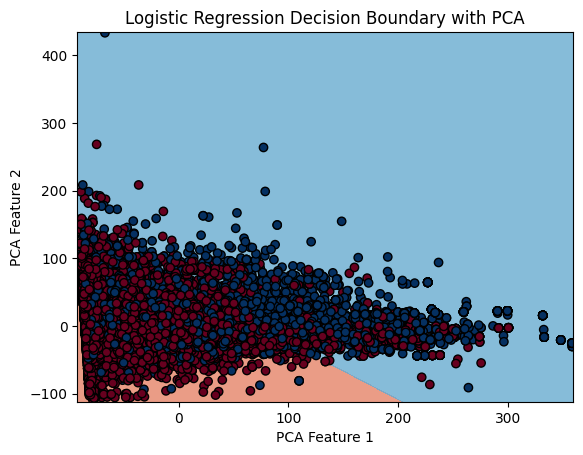

Executing logistic regression with: saga, l1, 0.5, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


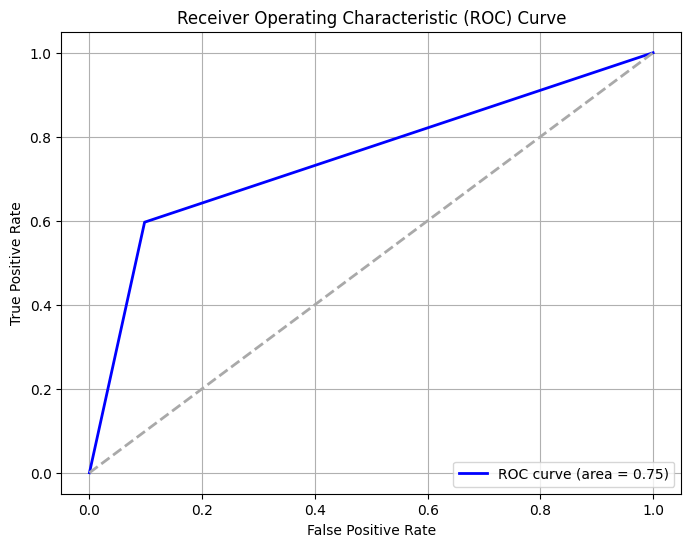

Cost-Sensitive Accuracy: 0.5994855778063568


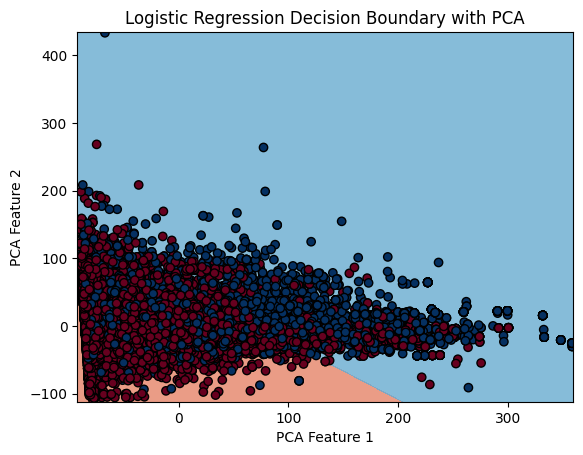

Executing logistic regression with: saga, l1, 0.7, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


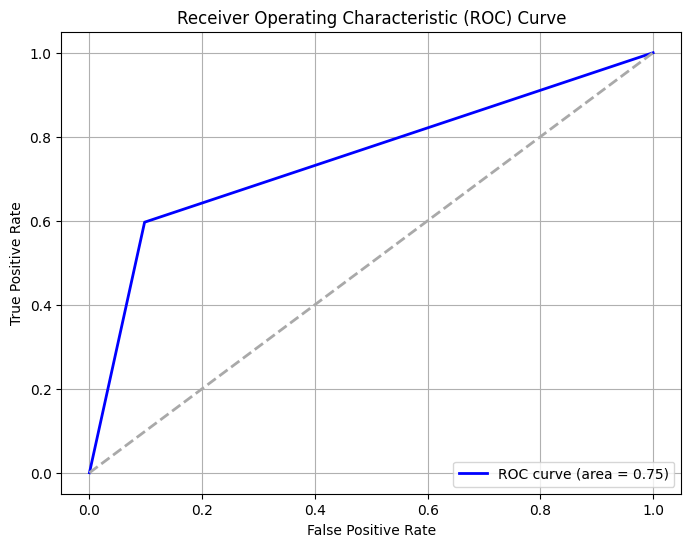

Cost-Sensitive Accuracy: 0.5994855778063568


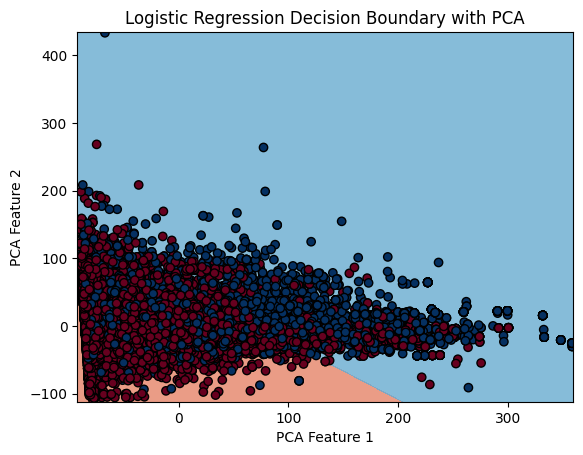

Executing logistic regression with: saga, l1, 0.7, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


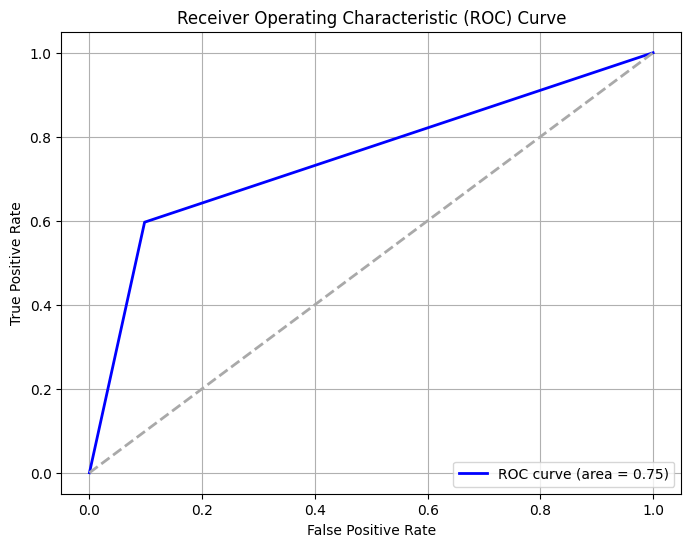

Cost-Sensitive Accuracy: 0.5994855778063568


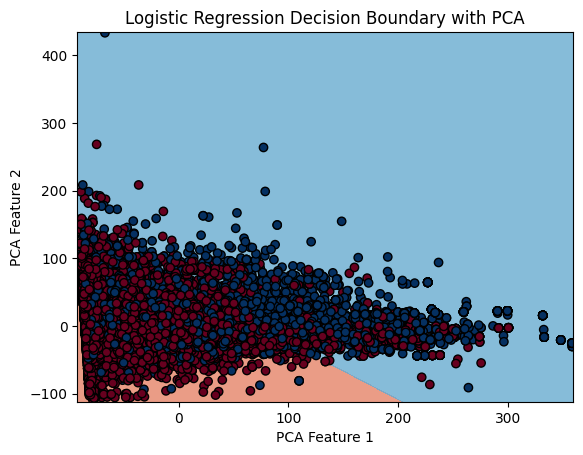

Executing logistic regression with: saga, l1, 0.9, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.2002572110968216
R-squared: 0.10122410717315522
Accuracy: 0.7997427889031784
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3265  354]
 [ 736 1088]]
AUC: 0.7493370757648473


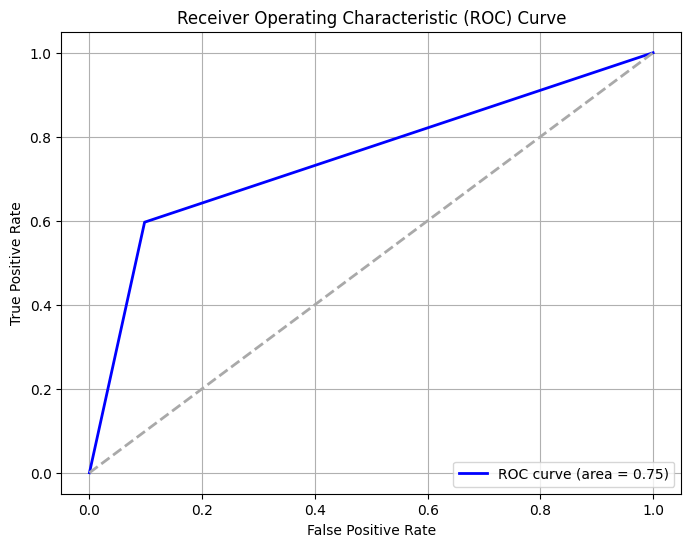

Cost-Sensitive Accuracy: 0.5994855778063568


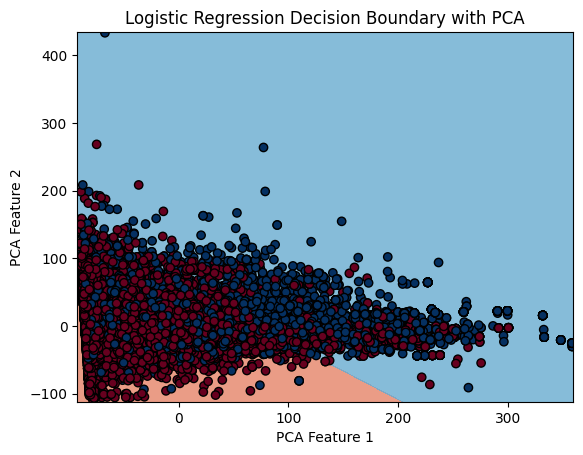

Executing logistic regression with: saga, l1, 0.9, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20007348888480617
R-squared: 0.10204867221244596
Accuracy: 0.7999265111151939
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 736 1088]]
AUC: 0.7494752354774752


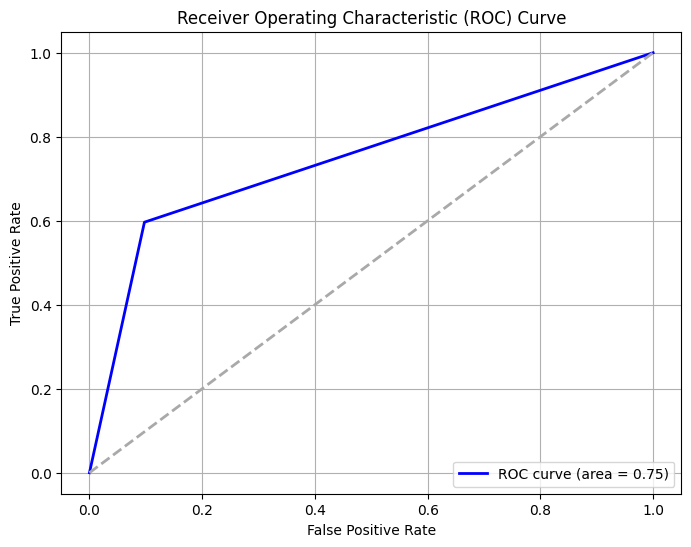

Cost-Sensitive Accuracy: 0.5998530222303877


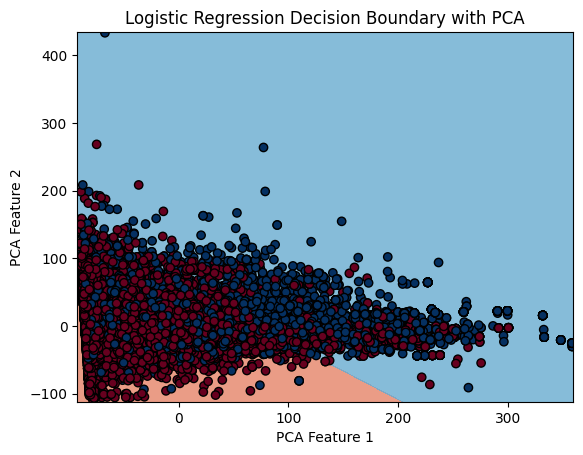

Executing logistic regression with: saga, l2, 0.1, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20044093330883703
R-squared: 0.1003995421338646
Accuracy: 0.799559066691163
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 738 1086]]
AUC: 0.7489269898634401


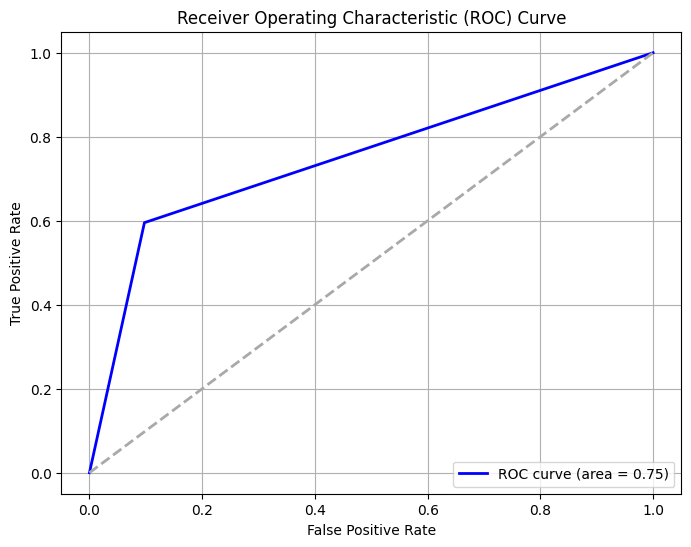

Cost-Sensitive Accuracy: 0.5991181333823259


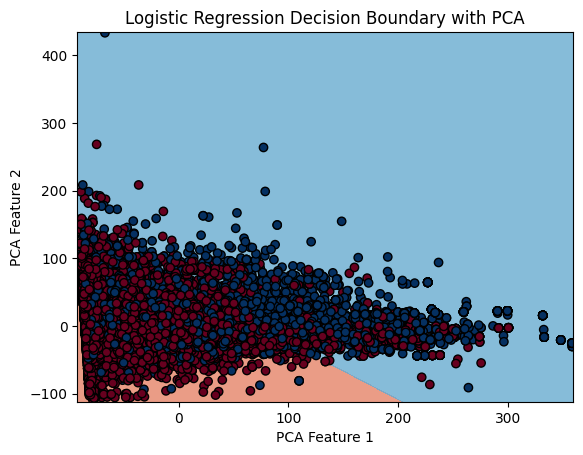

Executing logistic regression with: saga, l2, 0.1, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.20062465552085246
R-squared: 0.09957497709457386
Accuracy: 0.7993753444791475
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.75      0.59      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 739 1085]]
AUC: 0.7486528670564225


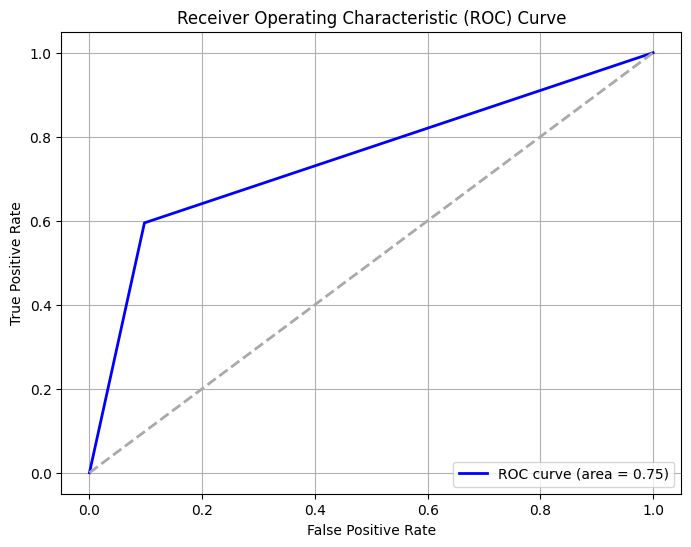

Cost-Sensitive Accuracy: 0.598750688958295


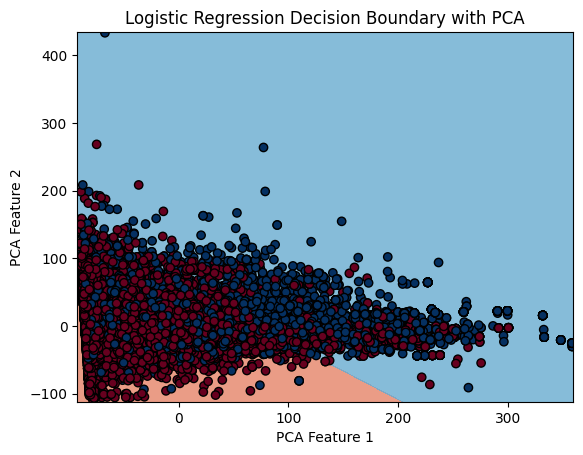

Executing logistic regression with: saga, l2, 0.3, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


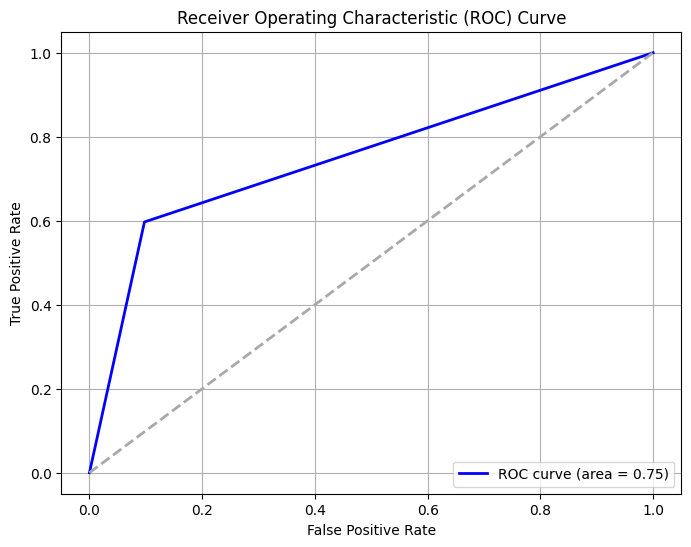

Cost-Sensitive Accuracy: 0.6002204666544184


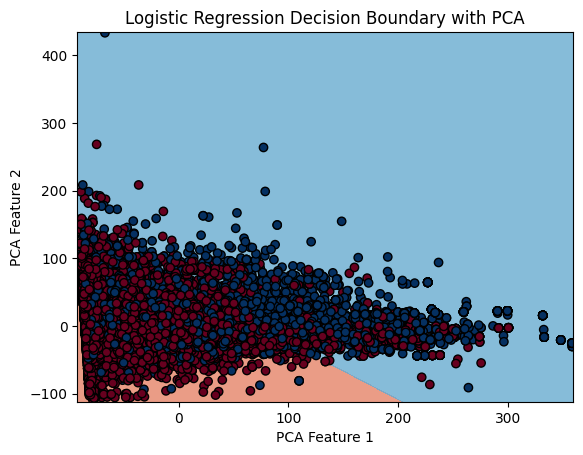

Executing logistic regression with: saga, l2, 0.3, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


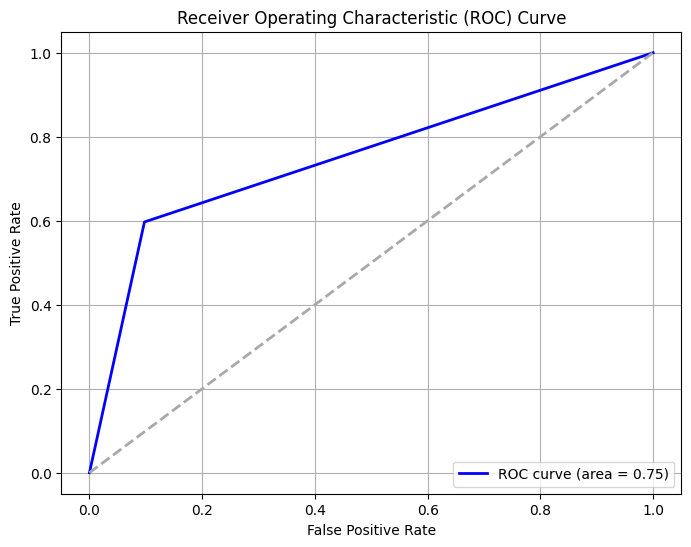

Cost-Sensitive Accuracy: 0.6002204666544184


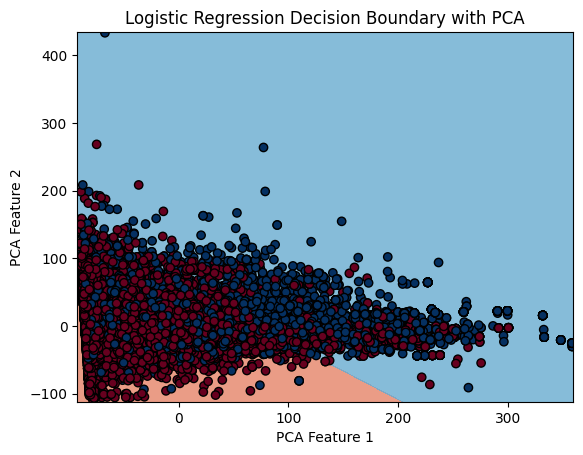

Executing logistic regression with: saga, l2, 0.5, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


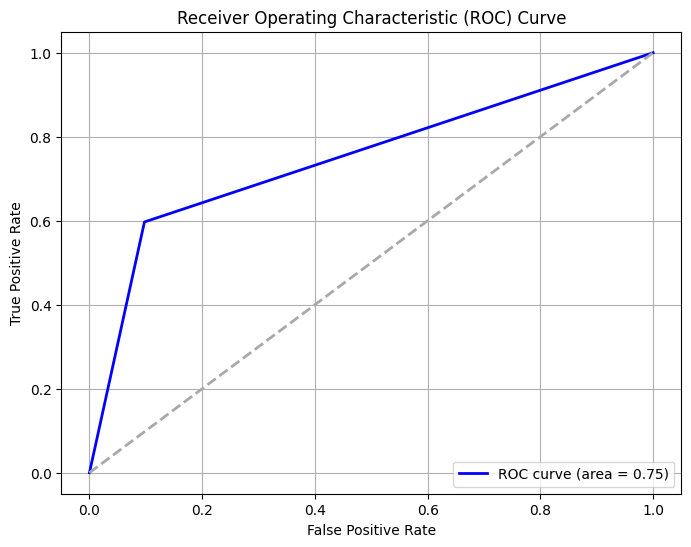

Cost-Sensitive Accuracy: 0.6002204666544184


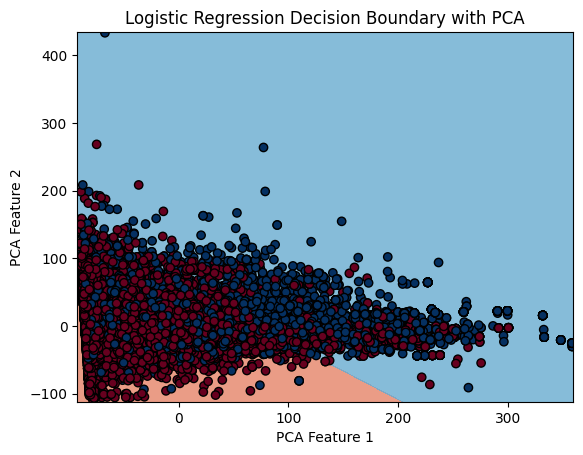

Executing logistic regression with: saga, l2, 0.5, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


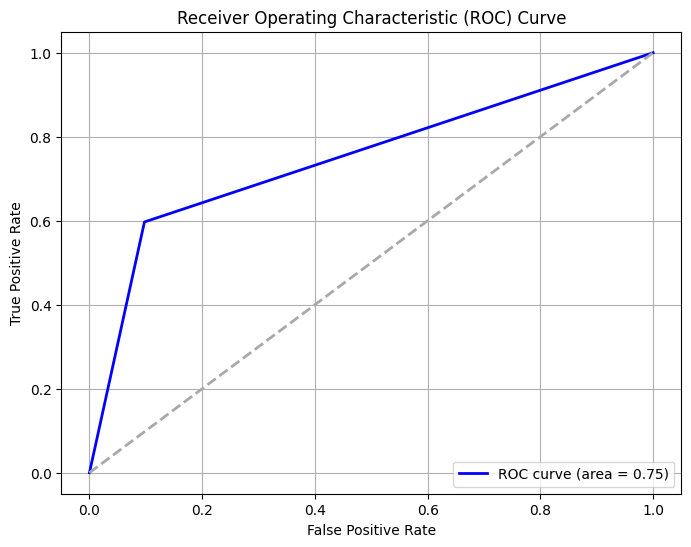

Cost-Sensitive Accuracy: 0.6002204666544184


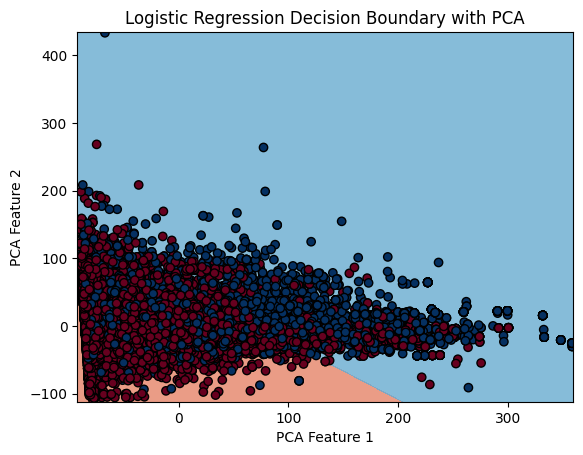

Executing logistic regression with: saga, l2, 0.7, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


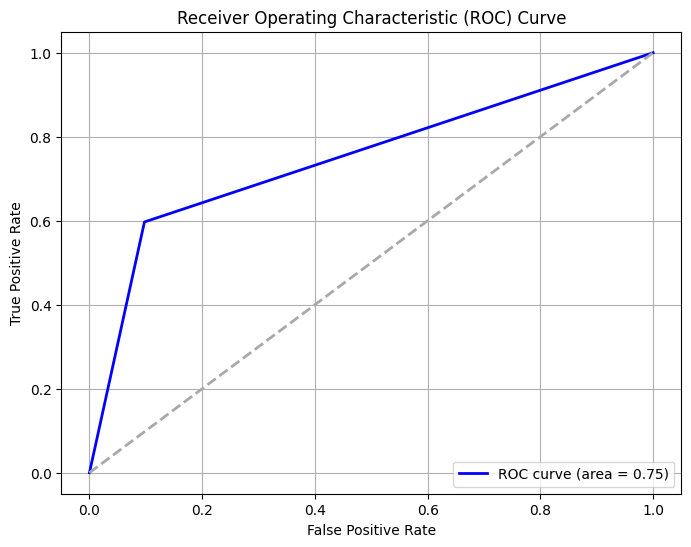

Cost-Sensitive Accuracy: 0.6002204666544184


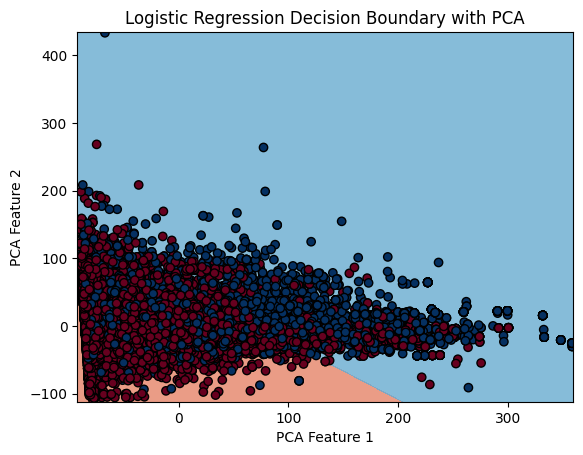

Executing logistic regression with: saga, l2, 0.7, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


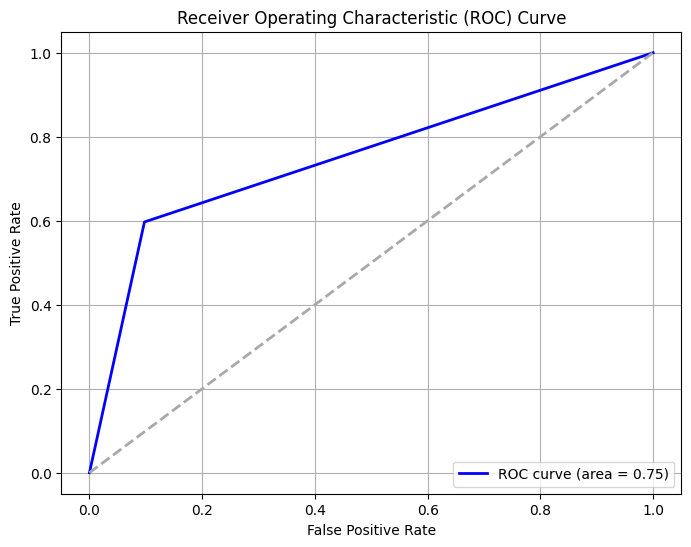

Cost-Sensitive Accuracy: 0.6002204666544184


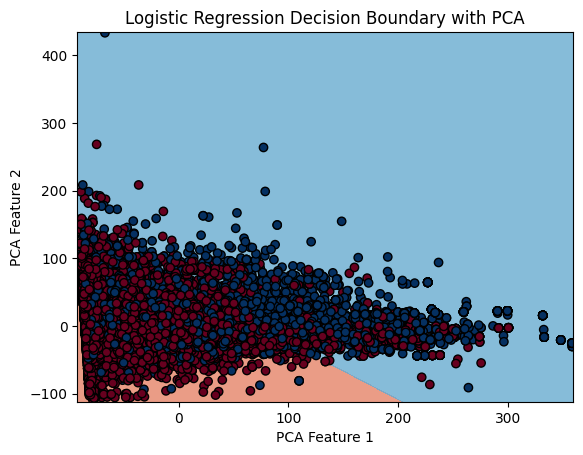

Executing logistic regression with: saga, l2, 0.9, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


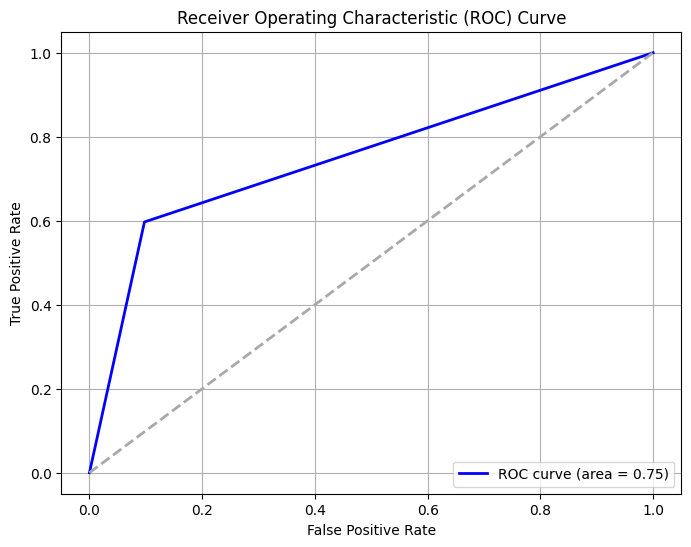

Cost-Sensitive Accuracy: 0.6002204666544184


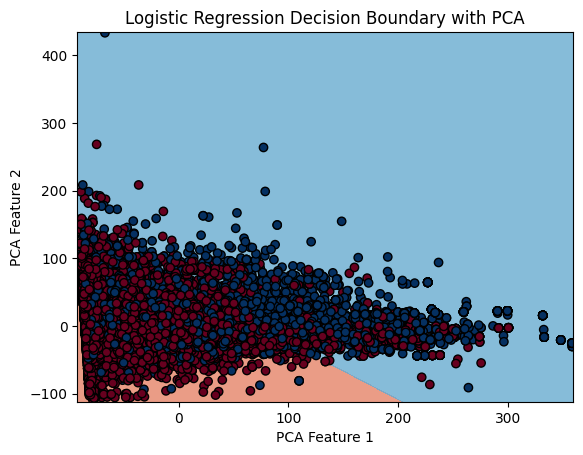

Executing logistic regression with: saga, l2, 0.9, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


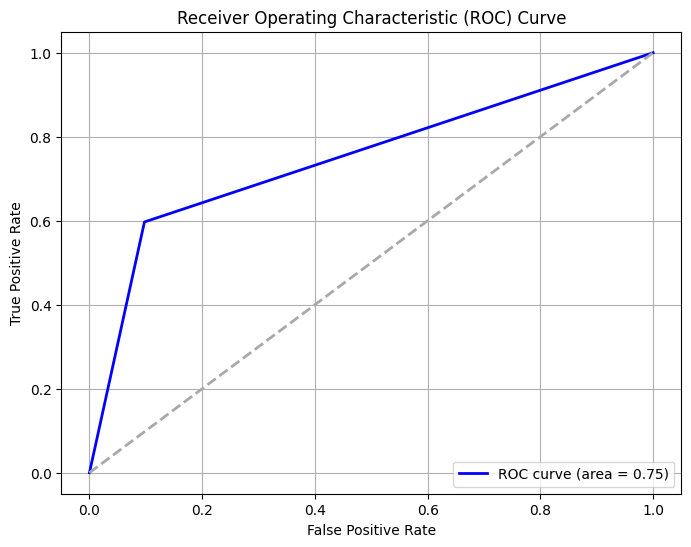

Cost-Sensitive Accuracy: 0.6002204666544184


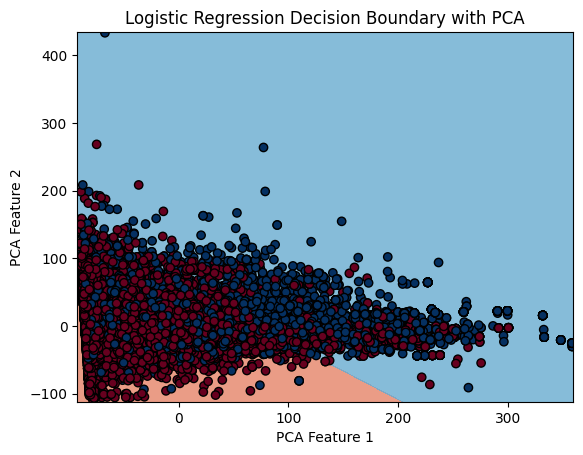

Executing logistic regression with: saga, None, 0.1, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


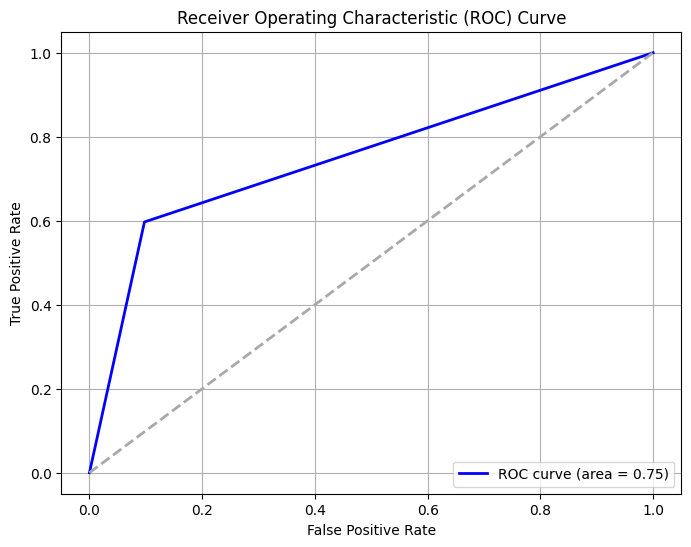

Cost-Sensitive Accuracy: 0.6002204666544184


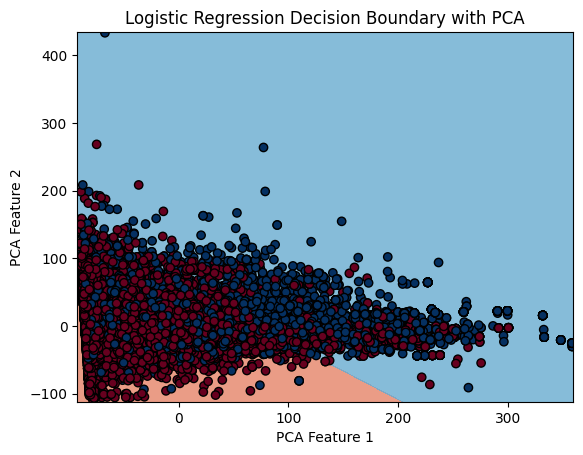

Executing logistic regression with: saga, None, 0.1, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


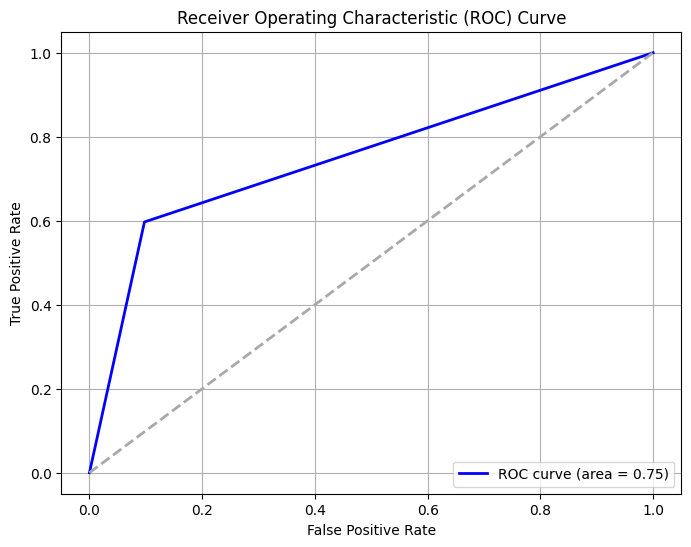

Cost-Sensitive Accuracy: 0.6002204666544184


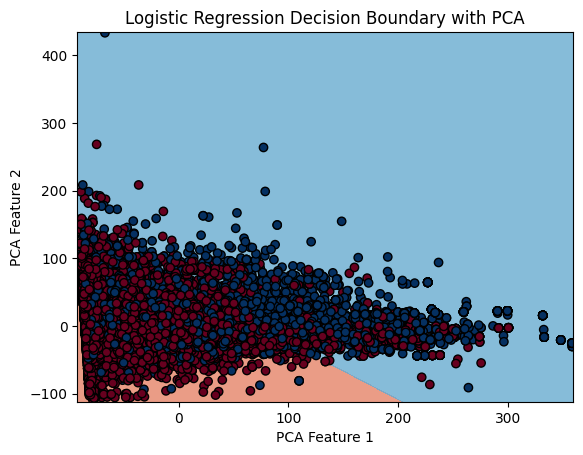

Executing logistic regression with: saga, None, 0.3, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


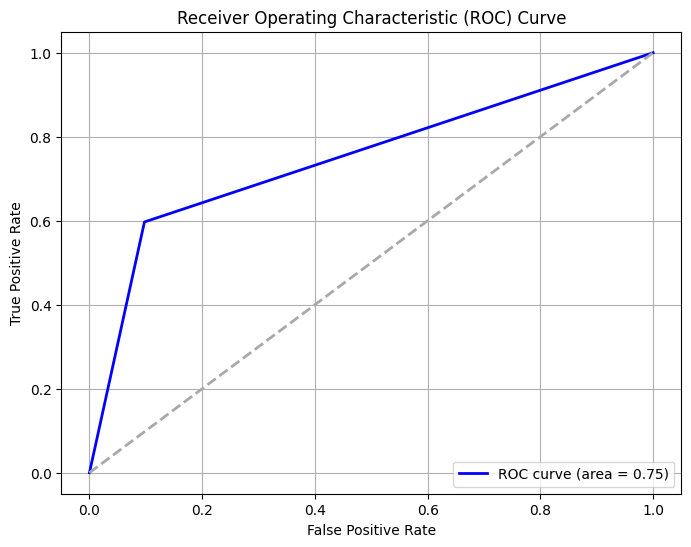

Cost-Sensitive Accuracy: 0.6002204666544184


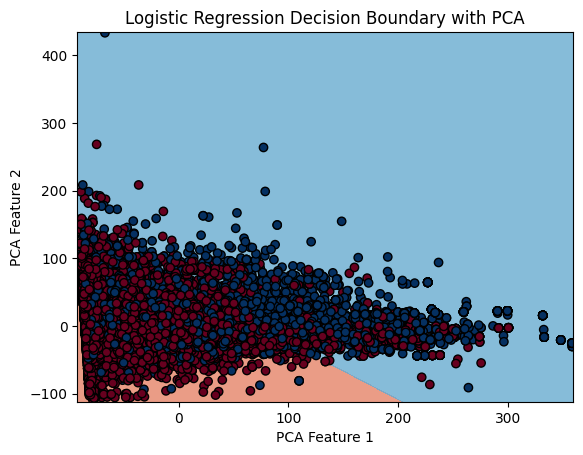

Executing logistic regression with: saga, None, 0.3, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


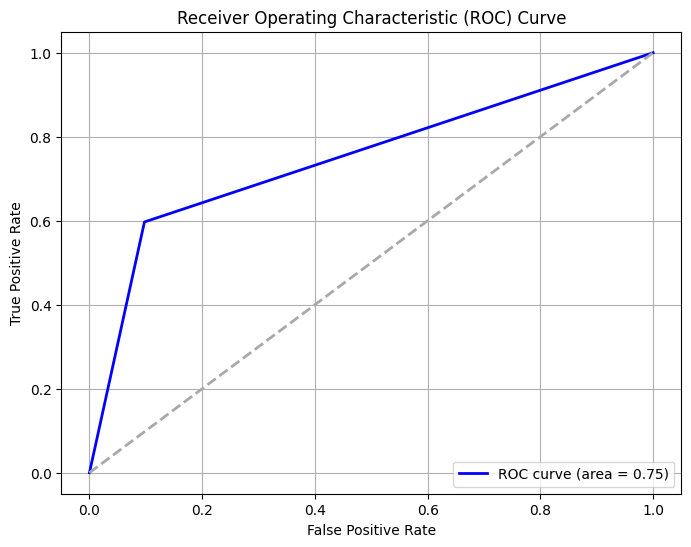

Cost-Sensitive Accuracy: 0.6002204666544184


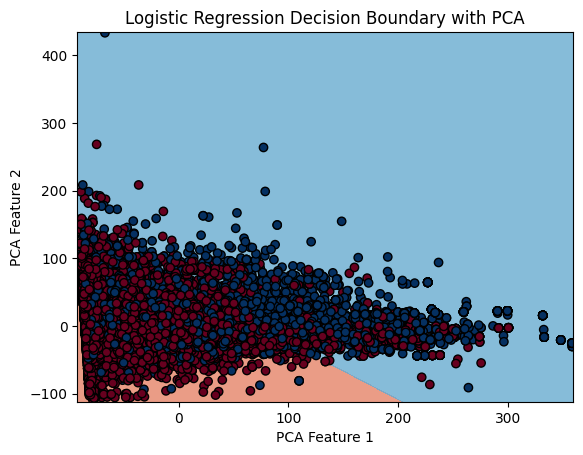

Executing logistic regression with: saga, None, 0.5, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


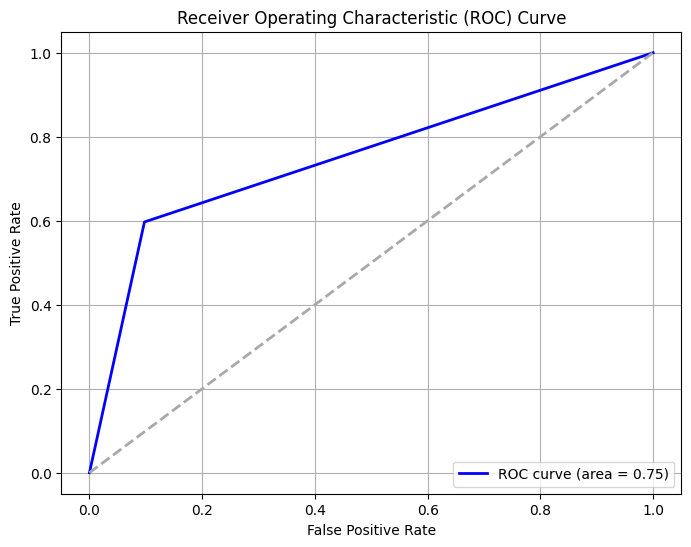

Cost-Sensitive Accuracy: 0.6002204666544184


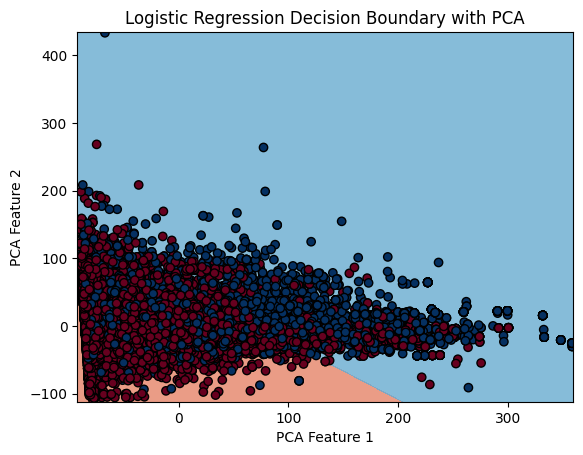

Executing logistic regression with: saga, None, 0.5, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


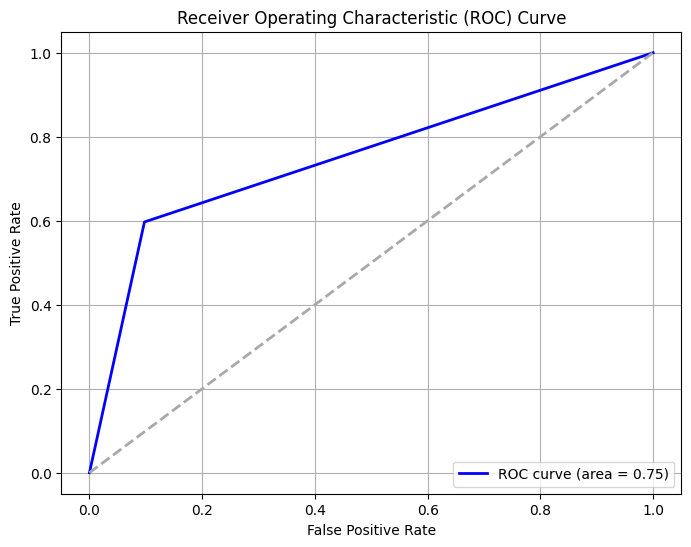

Cost-Sensitive Accuracy: 0.6002204666544184


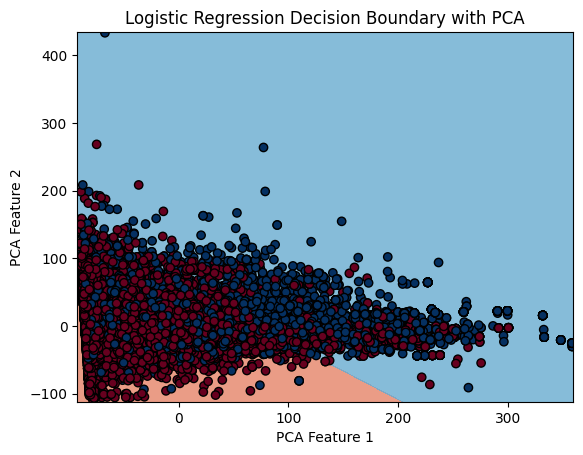

Executing logistic regression with: saga, None, 0.7, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


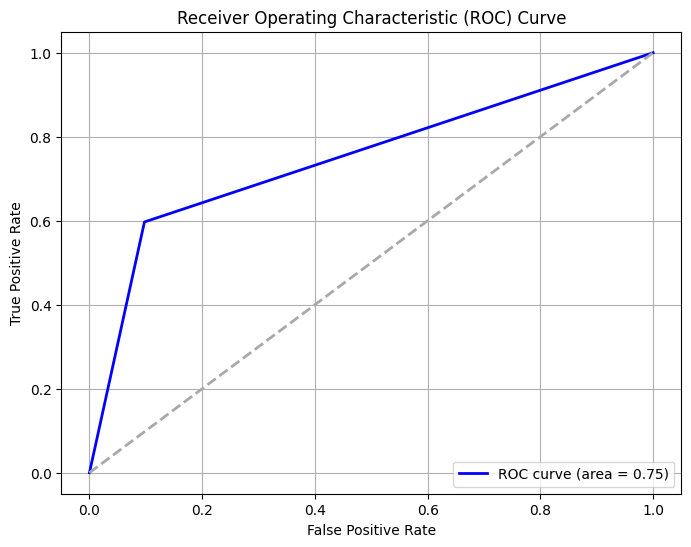

Cost-Sensitive Accuracy: 0.6002204666544184


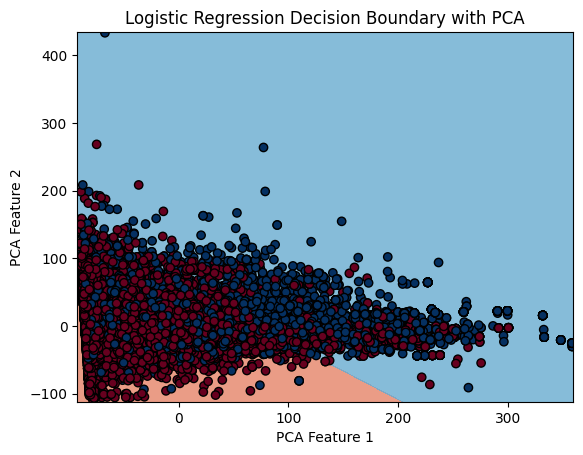

Executing logistic regression with: saga, None, 0.7, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


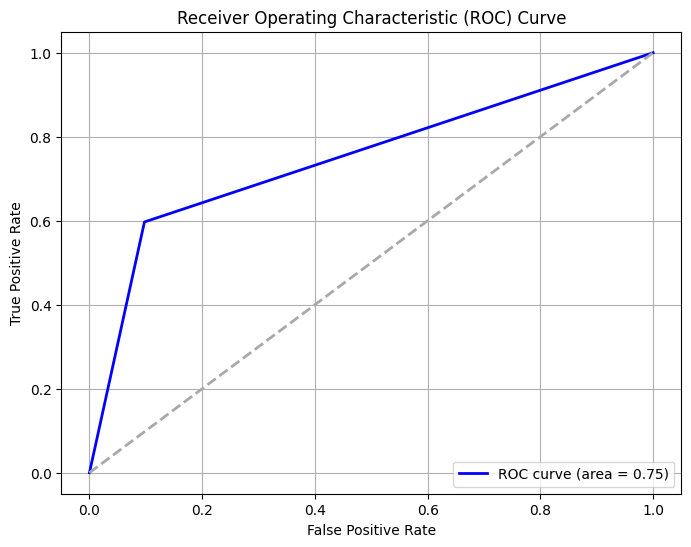

Cost-Sensitive Accuracy: 0.6002204666544184


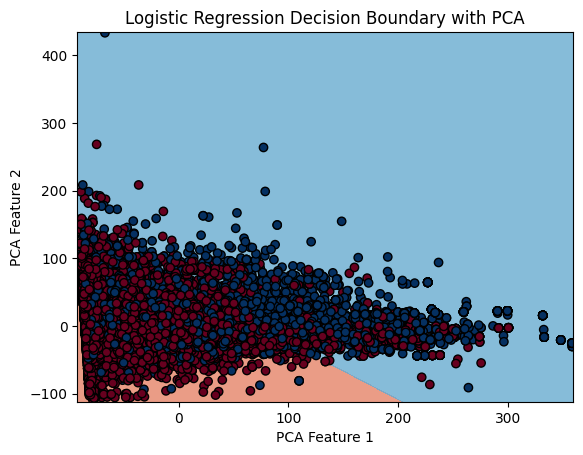

Executing logistic regression with: saga, None, 0.9, 50


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


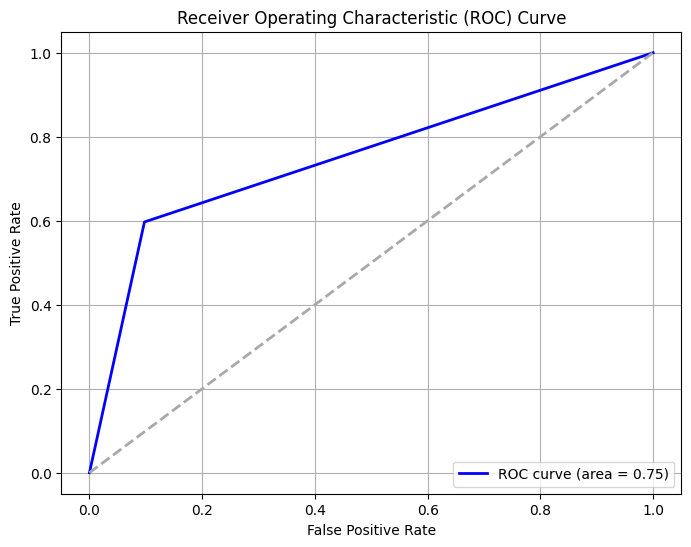

Cost-Sensitive Accuracy: 0.6002204666544184


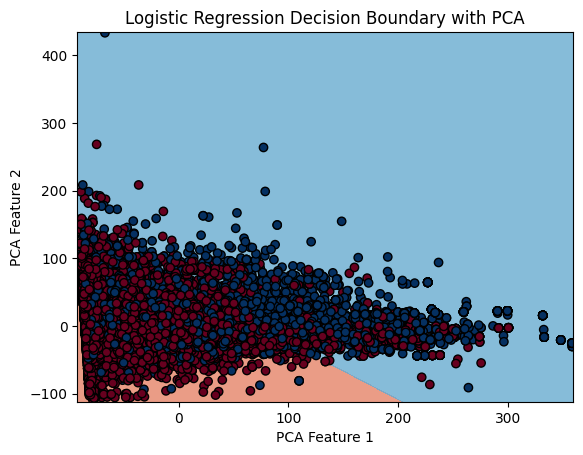

Executing logistic regression with: saga, None, 0.9, 100


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:1181: UserWarning: Setting penalty=None will ignore the C and l1_ratio parameters
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(


Mean Squared Error: 0.19988976667279074
R-squared: 0.10287323725173658
Accuracy: 0.8001102333272092
Classification Report:
              precision    recall  f1-score   support

           0       0.82      0.90      0.86      3619
           1       0.76      0.60      0.67      1824

    accuracy                           0.80      5443
   macro avg       0.79      0.75      0.76      5443
weighted avg       0.80      0.80      0.79      5443

Confusion Matrix:
[[3266  353]
 [ 735 1089]]
AUC: 0.7497493582844927


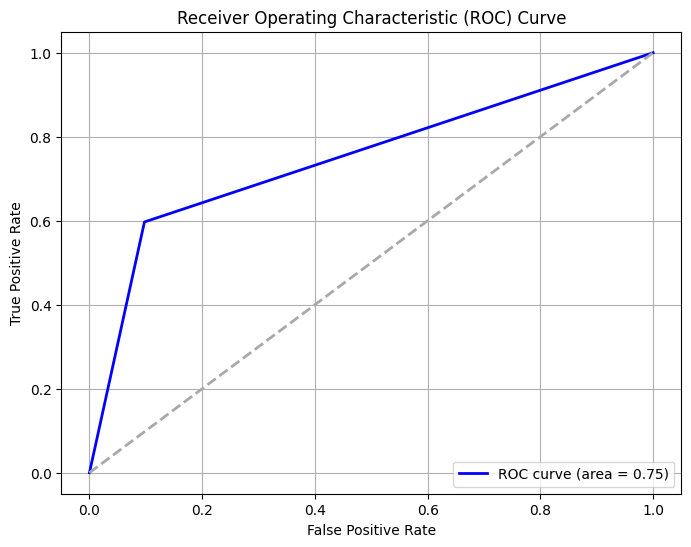

Cost-Sensitive Accuracy: 0.6002204666544184


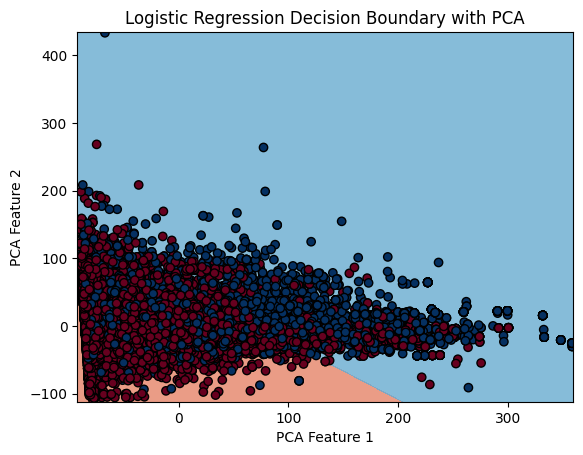

[[{'mse': 0.20044093330883703, 'r2': 0.1003995421338646, 'accuracy': 0.799559066691163, 'auc': 0.7489269898634401, 'cost-sensitive-acc': 0.5991181333823259}, 'lbfgs', 'l2', 0.1, 50], [{'mse': 0.20044093330883703, 'r2': 0.1003995421338646, 'accuracy': 0.799559066691163, 'auc': 0.7489269898634401, 'cost-sensitive-acc': 0.5991181333823259}, 'lbfgs', 'l2', 0.1, 100], [{'mse': 0.19988976667279074, 'r2': 0.10287323725173658, 'accuracy': 0.8001102333272092, 'auc': 0.7497493582844927, 'cost-sensitive-acc': 0.6002204666544184}, 'lbfgs', 'l2', 0.3, 50], [{'mse': 0.19988976667279074, 'r2': 0.10287323725173658, 'accuracy': 0.8001102333272092, 'auc': 0.7497493582844927, 'cost-sensitive-acc': 0.6002204666544184}, 'lbfgs', 'l2', 0.3, 100], [{'mse': 0.19988976667279074, 'r2': 0.10287323725173658, 'accuracy': 0.8001102333272092, 'auc': 0.7497493582844927, 'cost-sensitive-acc': 0.6002204666544184}, 'lbfgs', 'l2', 0.5, 50], [{'mse': 0.19988976667279074, 'r2': 0.10287323725173658, 'accuracy': 0.8001102333

In [33]:
C_values = [x / 10.0 for x in range(1, 10, 2)]
max_iter_values = range(50, 150, 50)
solver_penalty_values = [
    ['lbfgs', 'l2'],
    ['lbfgs', None],
    ['liblinear', 'l1'],
    ['liblinear', 'l2'],
    ['newton-cg', 'l2'],
    ['newton-cg', None],
    ['newton-cholesky', 'l2'],
    ['newton-cholesky', None],
    ['sag', 'l2'],
    # ['saga', 'elasticnet'], <-
    ['saga', 'l1'],
    ['saga', 'l2'],
    ['saga', None],
]

scores_logistic_regression = []
for solver, penalty in solver_penalty_values:
  for C in C_values:
    for max_iter in max_iter_values:
      print(f'Executing logistic regression with: {solver}, {penalty}, {C}, {max_iter}')
      score = train_logistic_regression(df, penalty, C, solver, max_iter)
      scores_logistic_regression.append([score, solver, penalty, C, max_iter])

print(scores_logistic_regression)
# slices = slice_n(df, 5)
# for slice in slices:
#   train_logistic_regression(slice)

# Decission Tree Learning

In [34]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score

import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

def train_decision_tree(df, criterion='gini', splitter='best', max_features=None, class_weight=None):
  [df_train, df_test, df_validation] = split_train_test_validation(df)

  [X_train, y_train] = extract_features_X_y(df_train)
  [X_test, y_test] = extract_features_X_y(df_test)
  [X_validation, y_validation] = extract_features_X_y(df_validation)

  # Create the Decision Tree model
  model = DecisionTreeClassifier(random_state=42, criterion=criterion, splitter=splitter, max_features=max_features, class_weight=class_weight)

  # Train the model
  model.fit(X_train, y_train)

  # Make predictions
  predictions = model.predict(X_test)

  score = evaluate_results(y_test, predictions)

  # Plot the first 3 levels from the decision tree
  # Plot the decision tree
  plt.figure(figsize=(14, 10))  # Adjust the size as needed
  plot_tree(model, max_depth=2, filled=True, feature_names=X_train.columns, class_names=True, rounded=True)
  plt.show()

  return score

Executing decission tree with: gini, best, auto, balanced
Mean Squared Error: 0.15101965827668565
R-squared: 0.3222075377030583
Accuracy: 0.8489803417233144
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      3619
           1       0.77      0.78      0.78      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3195  424]
 [ 398 1426]]
AUC: 0.8323194046528314


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


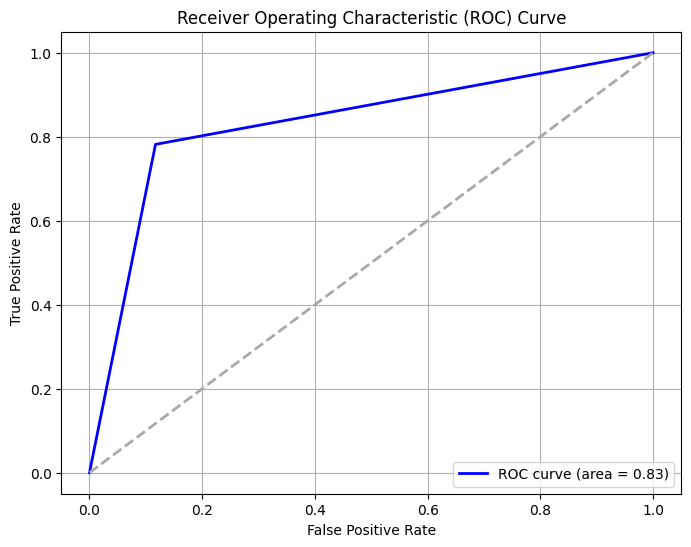

Cost-Sensitive Accuracy: 0.6979606834466288


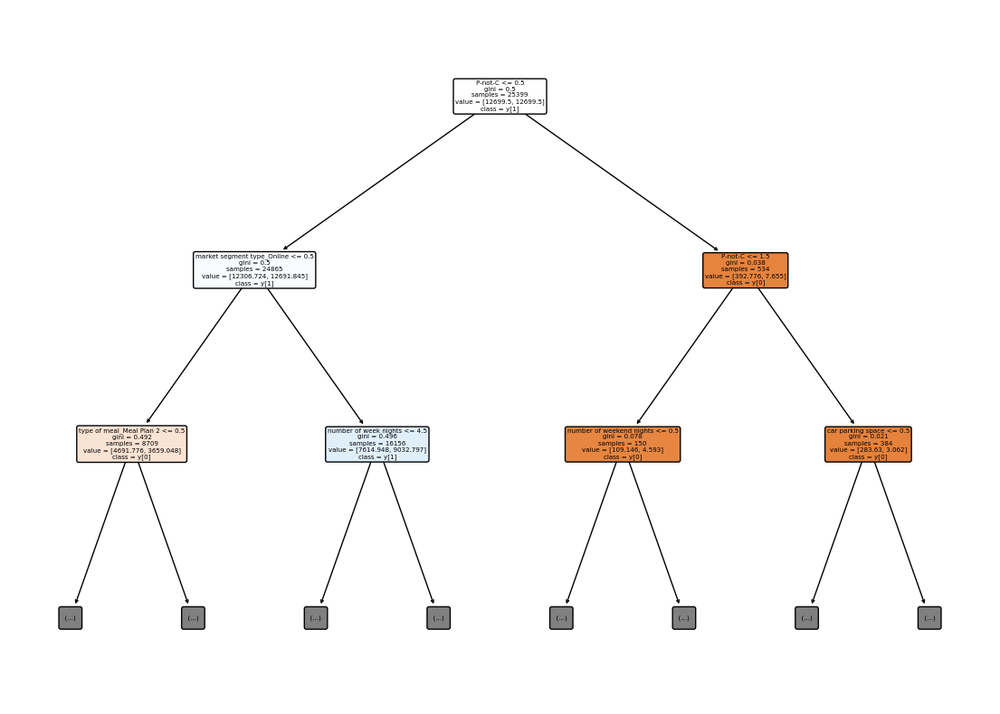

Executing decission tree with: gini, best, auto, None
Mean Squared Error: 0.16130810214954988
R-squared: 0.27603189550278007
Accuracy: 0.8386918978504502
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.76      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3178  441]
 [ 437 1387]]
AUC: 0.8192799000644745


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


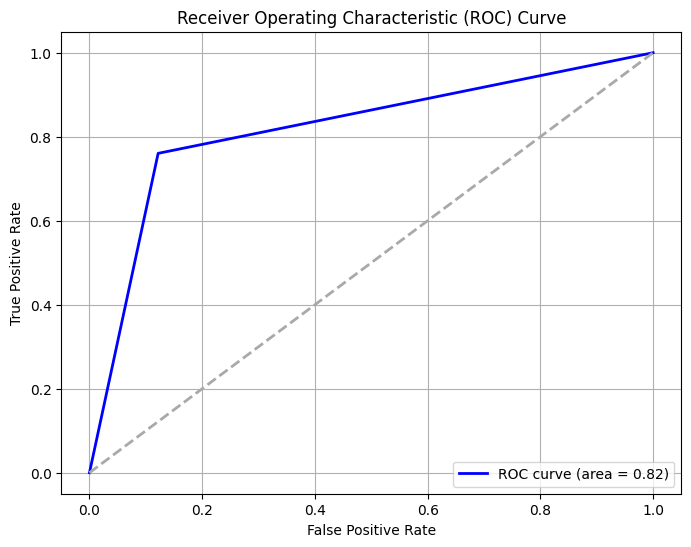

Cost-Sensitive Accuracy: 0.6773837957009003


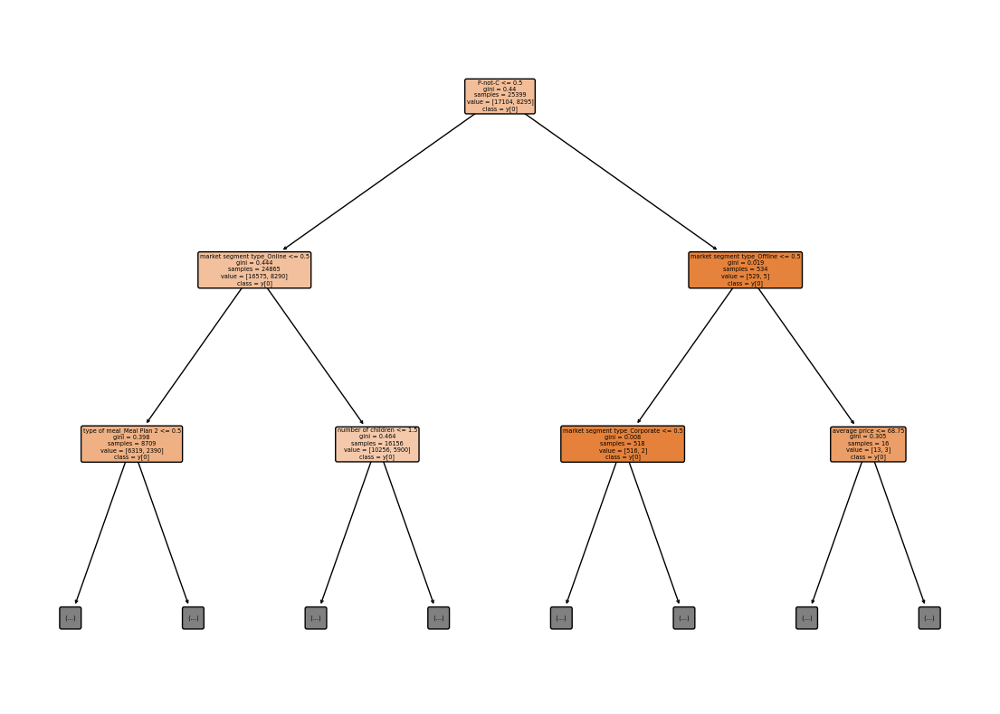

Executing decission tree with: gini, best, sqrt, balanced
Mean Squared Error: 0.15101965827668565
R-squared: 0.3222075377030583
Accuracy: 0.8489803417233144
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      3619
           1       0.77      0.78      0.78      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3195  424]
 [ 398 1426]]
AUC: 0.8323194046528314


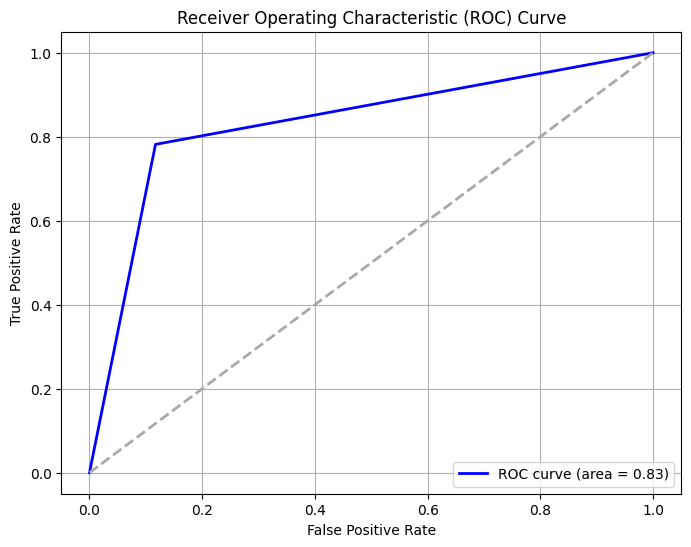

Cost-Sensitive Accuracy: 0.6979606834466288


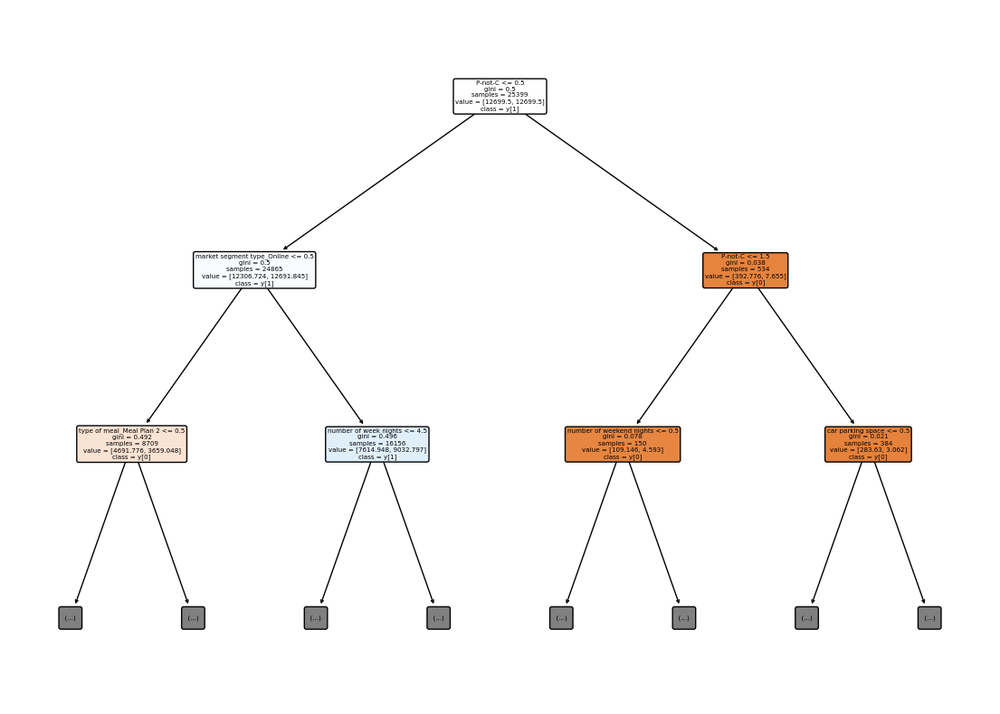

Executing decission tree with: gini, best, sqrt, None
Mean Squared Error: 0.16130810214954988
R-squared: 0.27603189550278007
Accuracy: 0.8386918978504502
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.76      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3178  441]
 [ 437 1387]]
AUC: 0.8192799000644745


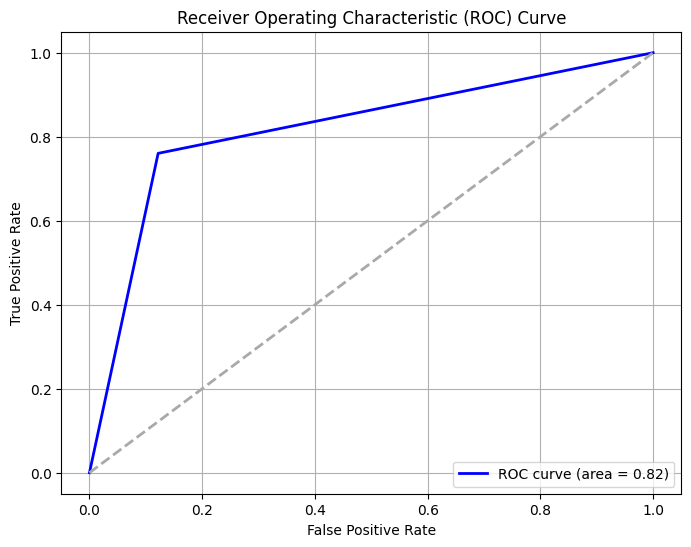

Cost-Sensitive Accuracy: 0.6773837957009003


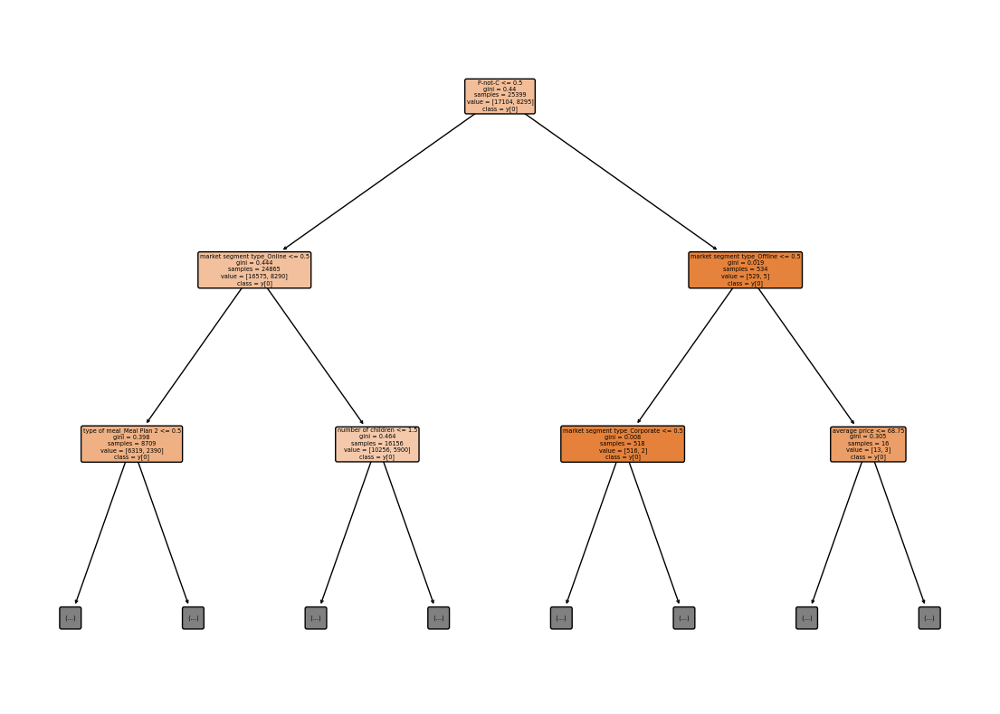

Executing decission tree with: gini, best, log2, balanced
Mean Squared Error: 0.15414293588094802
R-squared: 0.3081899320351168
Accuracy: 0.845857064119052
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.88      3619
           1       0.76      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3182  437]
 [ 402 1422]]
AUC: 0.8294268371605997


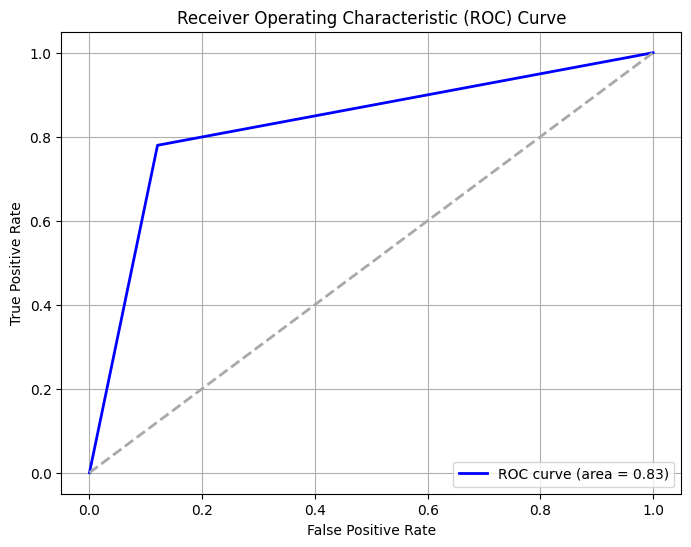

Cost-Sensitive Accuracy: 0.6917141282381041


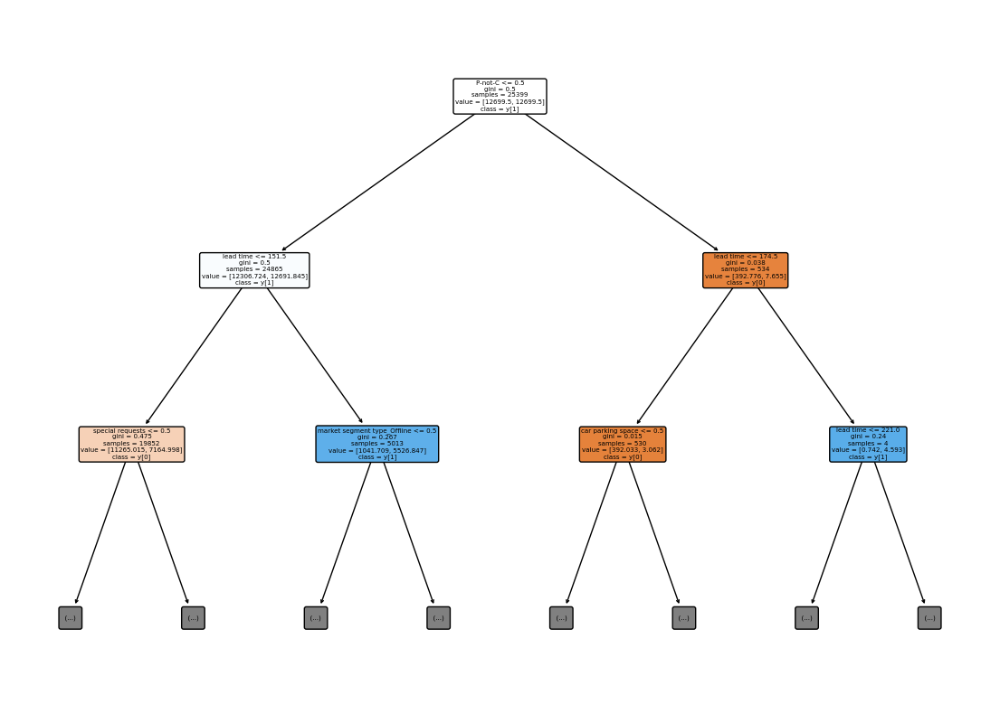

Executing decission tree with: gini, best, log2, None
Mean Squared Error: 0.1513871027007165
R-squared: 0.32055840762447696
Accuracy: 0.8486128972992835
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89      3619
           1       0.78      0.77      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3220  399]
 [ 425 1399]]
AUC: 0.8283720816790525


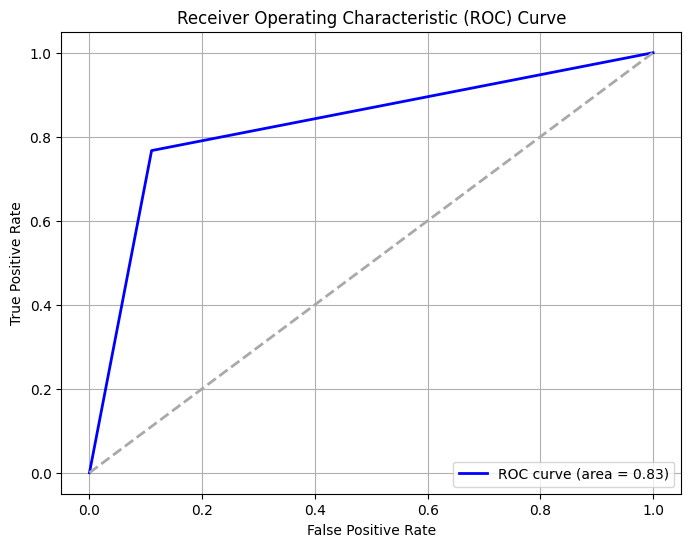

Cost-Sensitive Accuracy: 0.6972257945985669


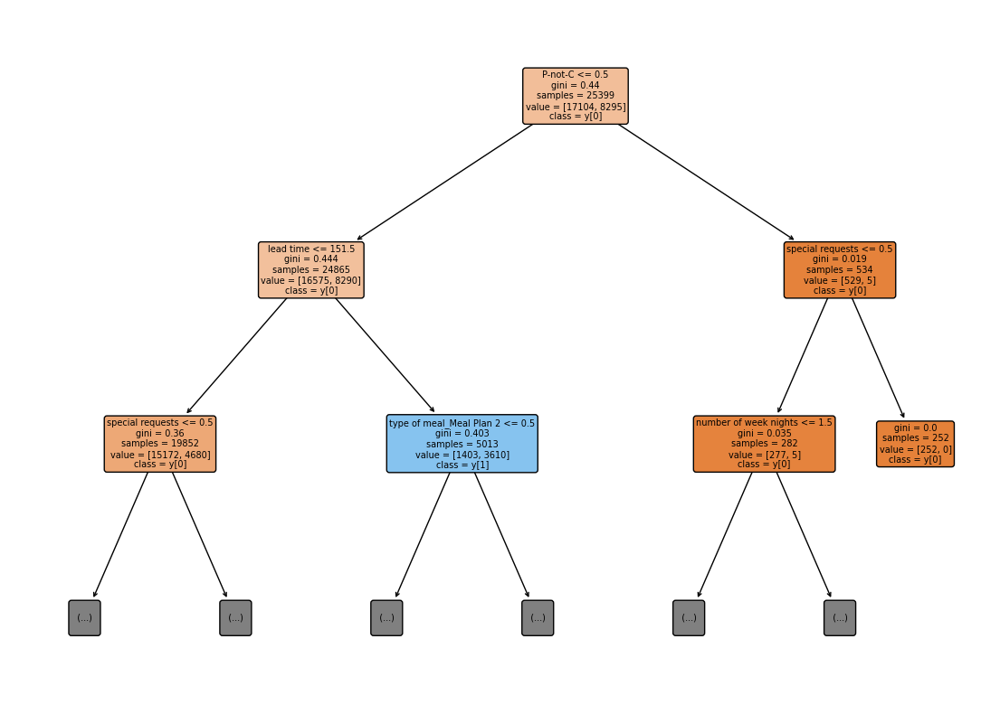

Executing decission tree with: gini, best, None, balanced
Mean Squared Error: 0.15616388021311778
R-squared: 0.29911971660291925
Accuracy: 0.8438361197868822
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.77      0.76      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.83      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3200  419]
 [ 431 1393]]
AUC: 0.8239641505843913


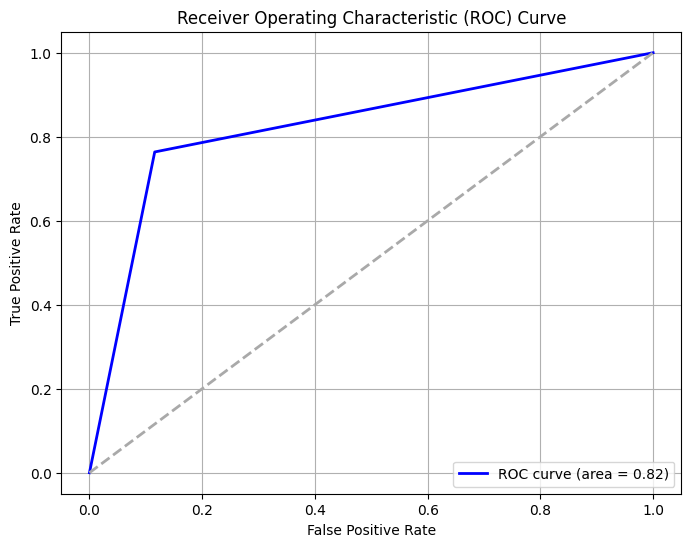

Cost-Sensitive Accuracy: 0.6876722395737644


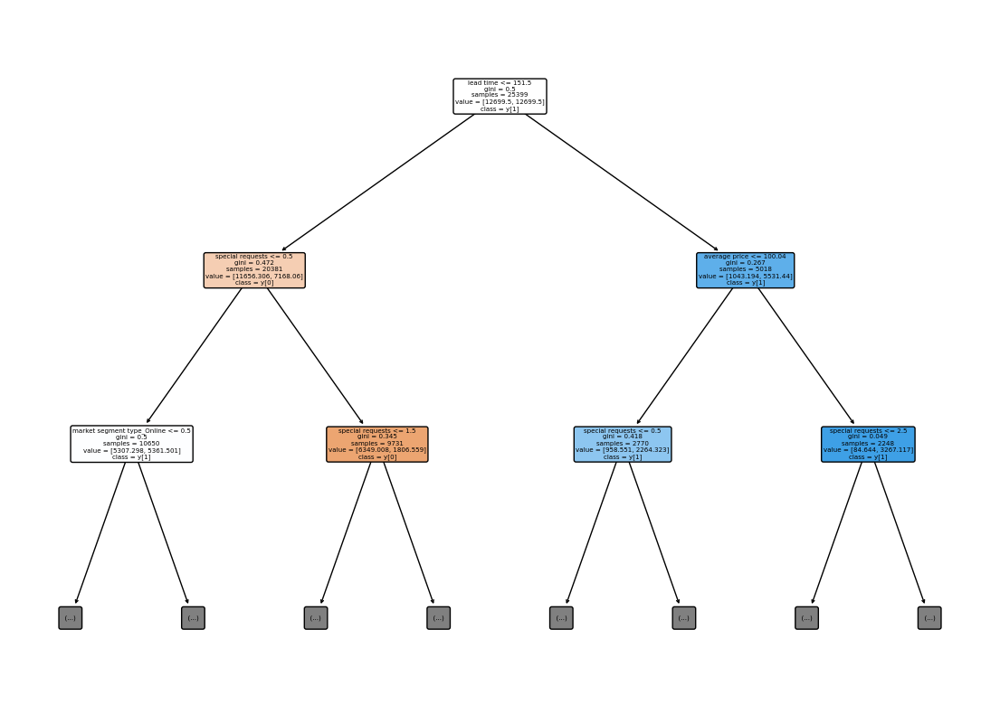

Executing decission tree with: gini, best, None, None
Mean Squared Error: 0.1513871027007165
R-squared: 0.32055840762447696
Accuracy: 0.8486128972992835
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      3619
           1       0.77      0.79      0.78      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3186  433]
 [ 391 1433]]
AUC: 0.8329948268883041


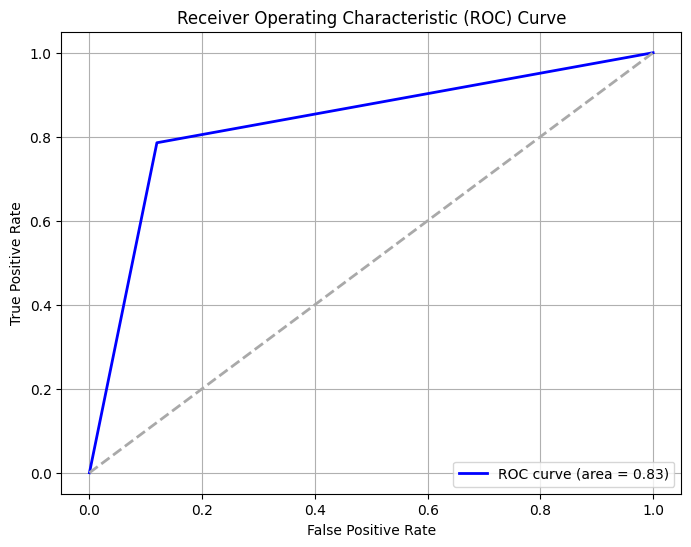

Cost-Sensitive Accuracy: 0.6972257945985669


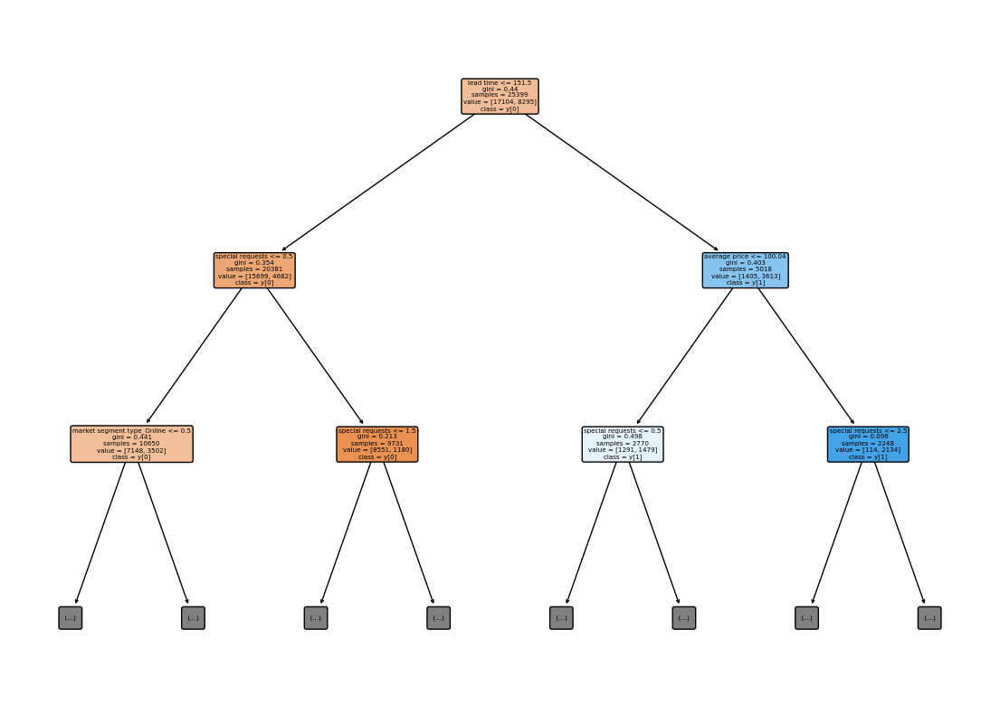

Executing decission tree with: gini, random, auto, balanced
Mean Squared Error: 0.16847326841815174
R-squared: 0.24387385897044345
Accuracy: 0.8315267315818482
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.87      3619
           1       0.75      0.74      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.81      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3168  451]
 [ 466 1358]]
AUC: 0.8099487415346877


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


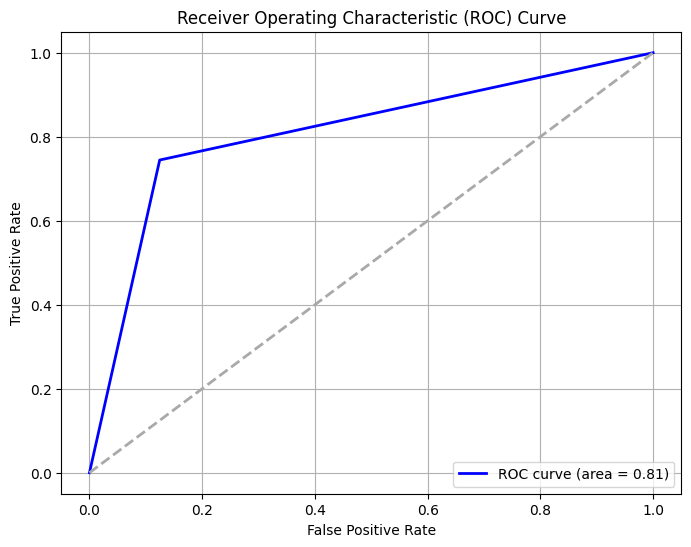

Cost-Sensitive Accuracy: 0.6630534631636964


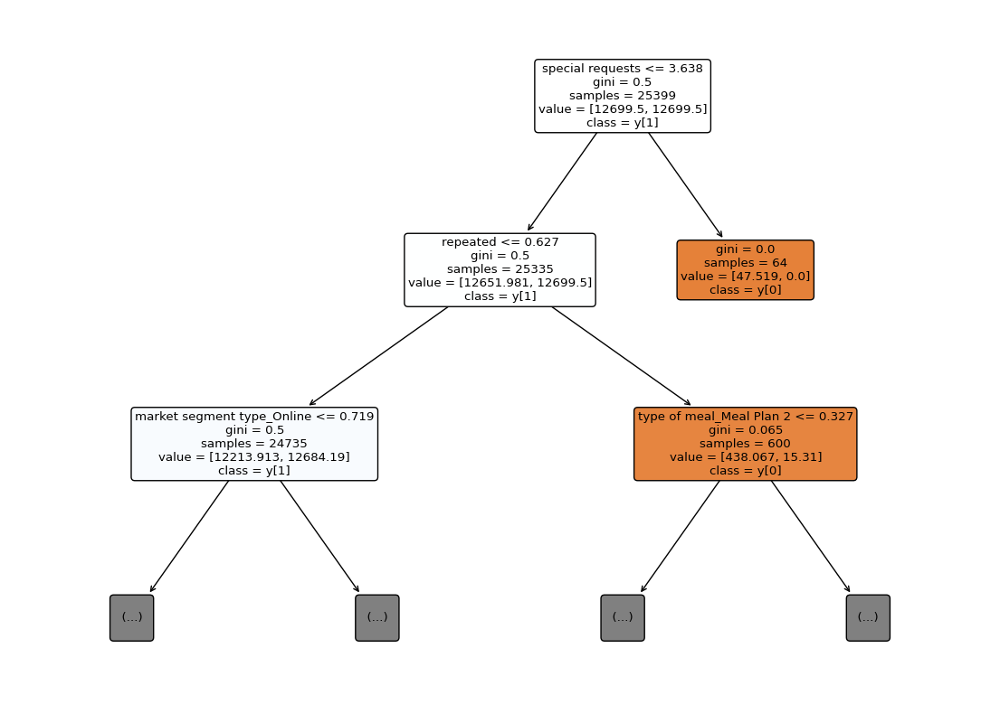

Executing decission tree with: gini, random, auto, None
Mean Squared Error: 0.15763365790924122
R-squared: 0.2925231962885938
Accuracy: 0.8423663420907588
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.88      3619
           1       0.77      0.76      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3206  413]
 [ 445 1379]]
AUC: 0.8209553895619125


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


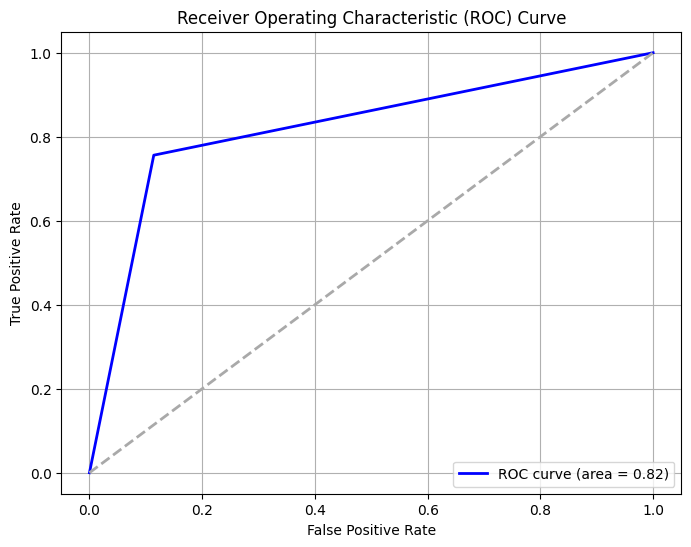

Cost-Sensitive Accuracy: 0.6847326841815176


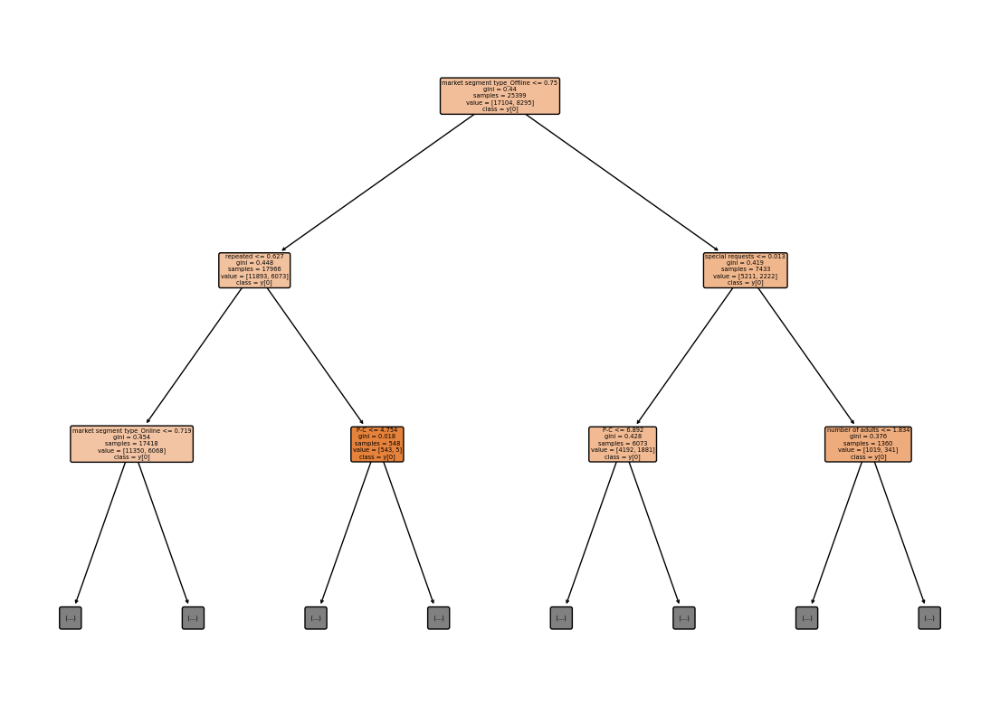

Executing decission tree with: gini, random, sqrt, balanced
Mean Squared Error: 0.16847326841815174
R-squared: 0.24387385897044345
Accuracy: 0.8315267315818482
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.87      3619
           1       0.75      0.74      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.81      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3168  451]
 [ 466 1358]]
AUC: 0.8099487415346877


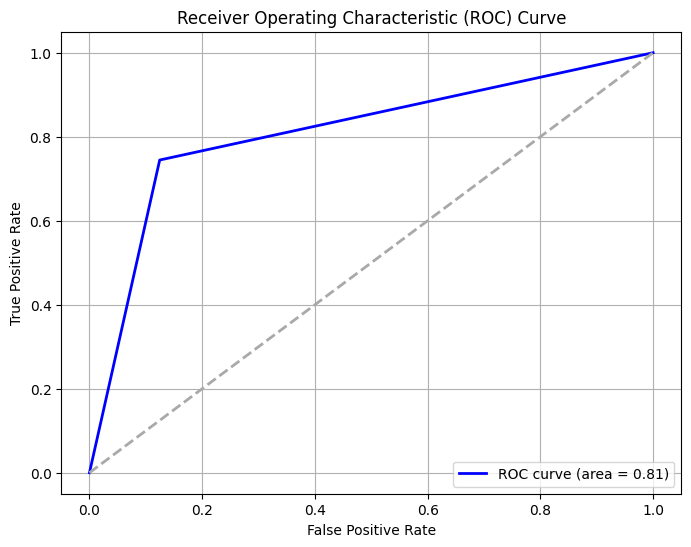

Cost-Sensitive Accuracy: 0.6630534631636964


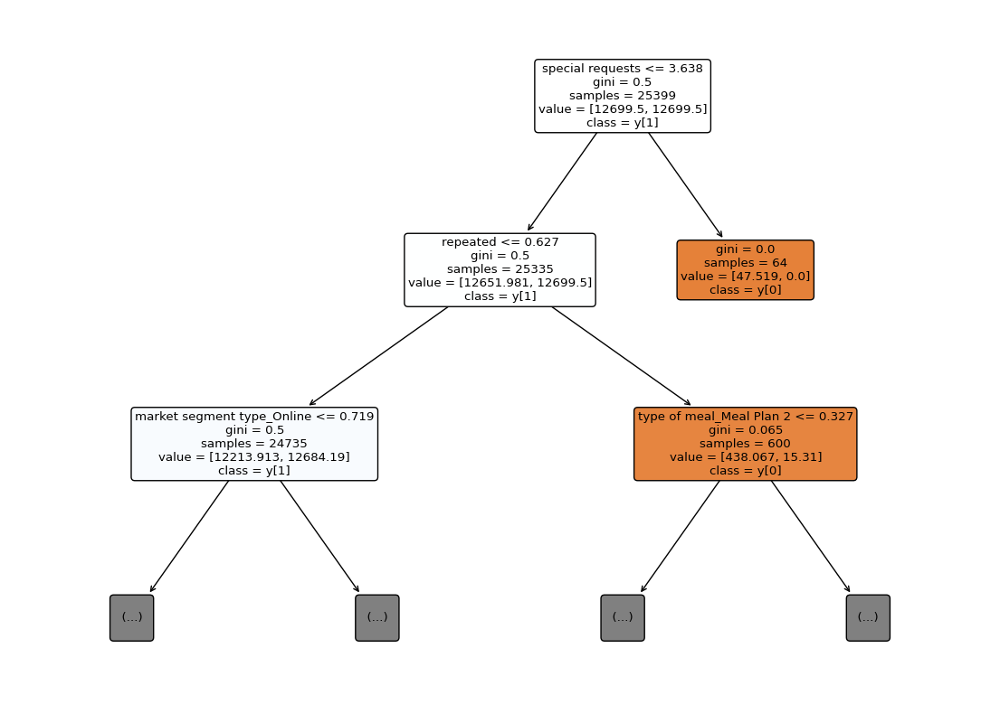

Executing decission tree with: gini, random, sqrt, None
Mean Squared Error: 0.15763365790924122
R-squared: 0.2925231962885938
Accuracy: 0.8423663420907588
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.88      3619
           1       0.77      0.76      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3206  413]
 [ 445 1379]]
AUC: 0.8209553895619125


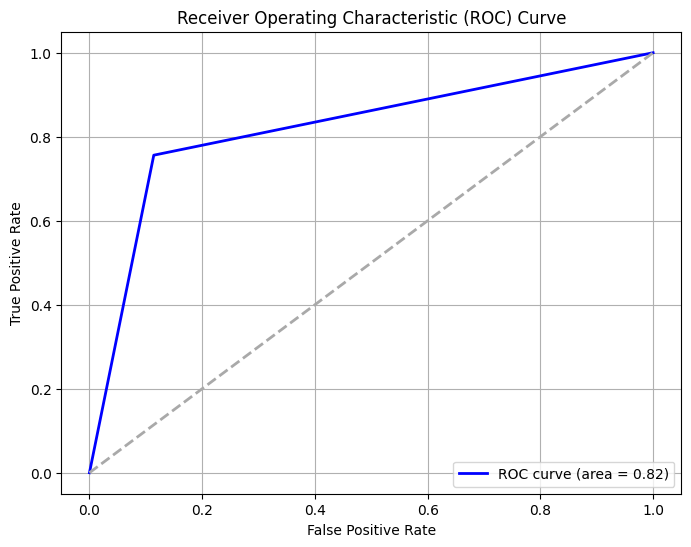

Cost-Sensitive Accuracy: 0.6847326841815176


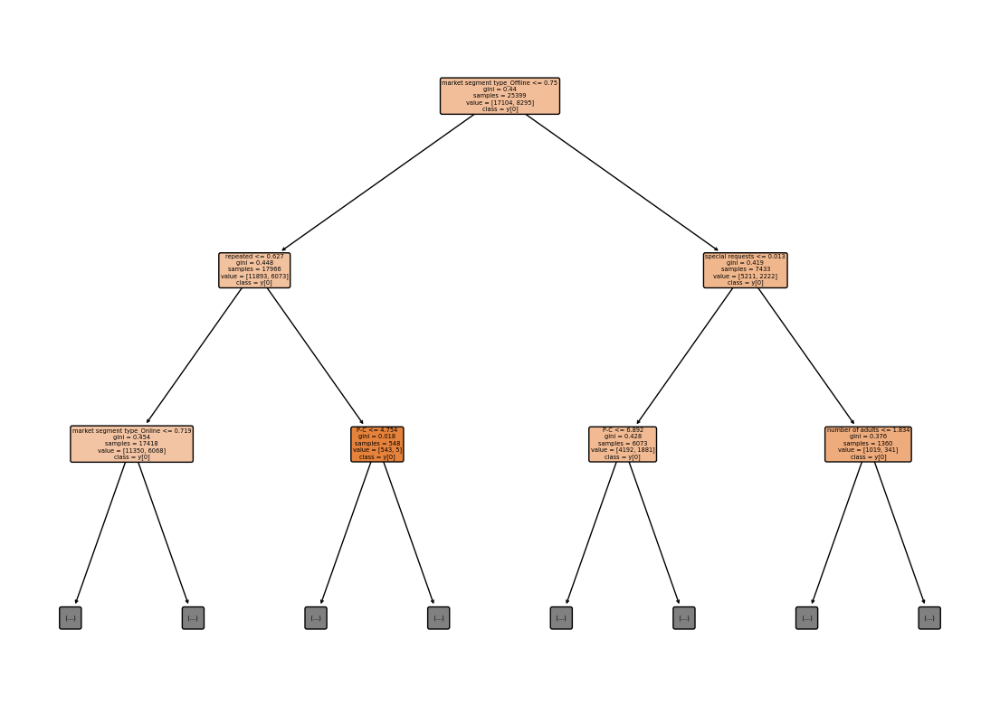

Executing decission tree with: gini, random, log2, balanced
Mean Squared Error: 0.16865699063016718
R-squared: 0.2430492939311527
Accuracy: 0.8313430093698329
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.87      0.87      3619
           1       0.75      0.75      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.81      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3162  457]
 [ 461 1363]]
AUC: 0.8104903972940087


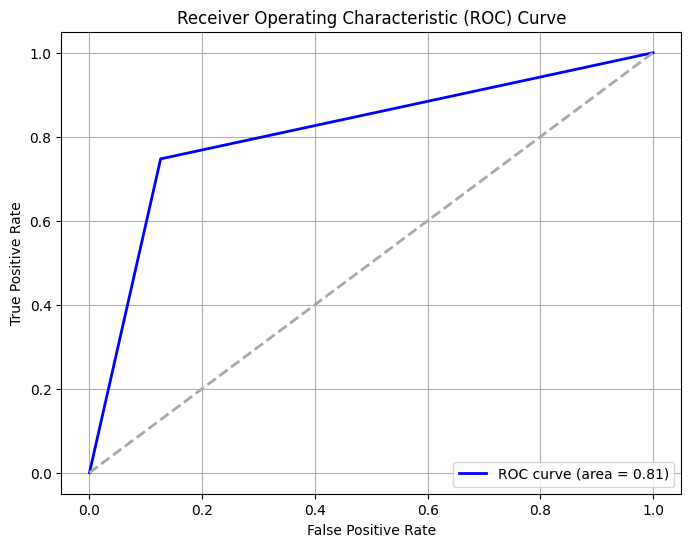

Cost-Sensitive Accuracy: 0.6626860187396657


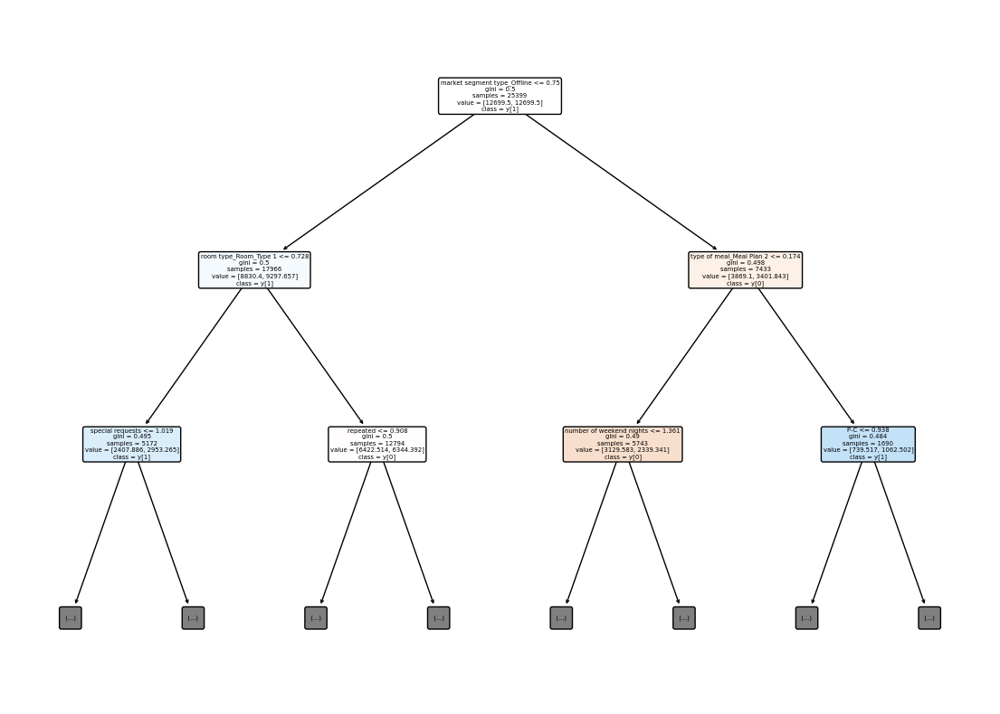

Executing decission tree with: gini, random, log2, None
Mean Squared Error: 0.16828954620613631
R-squared: 0.24469842400973418
Accuracy: 0.8317104537938637
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.87      3619
           1       0.75      0.74      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.81      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3169  450]
 [ 466 1358]]
AUC: 0.8100869012473155


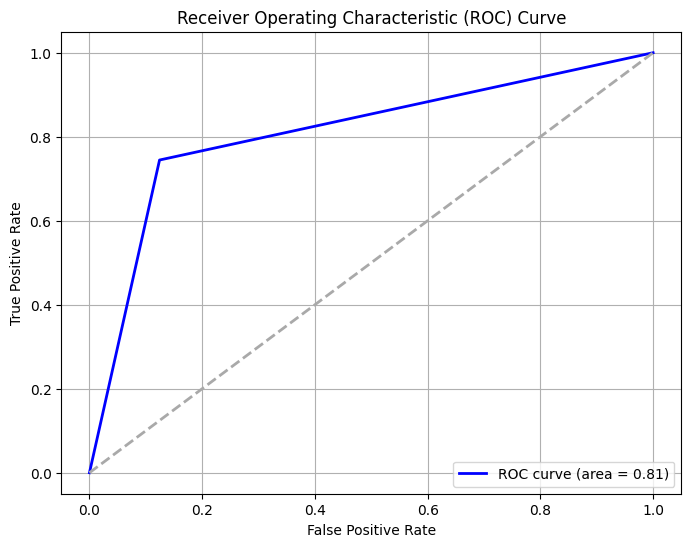

Cost-Sensitive Accuracy: 0.6634209075877273


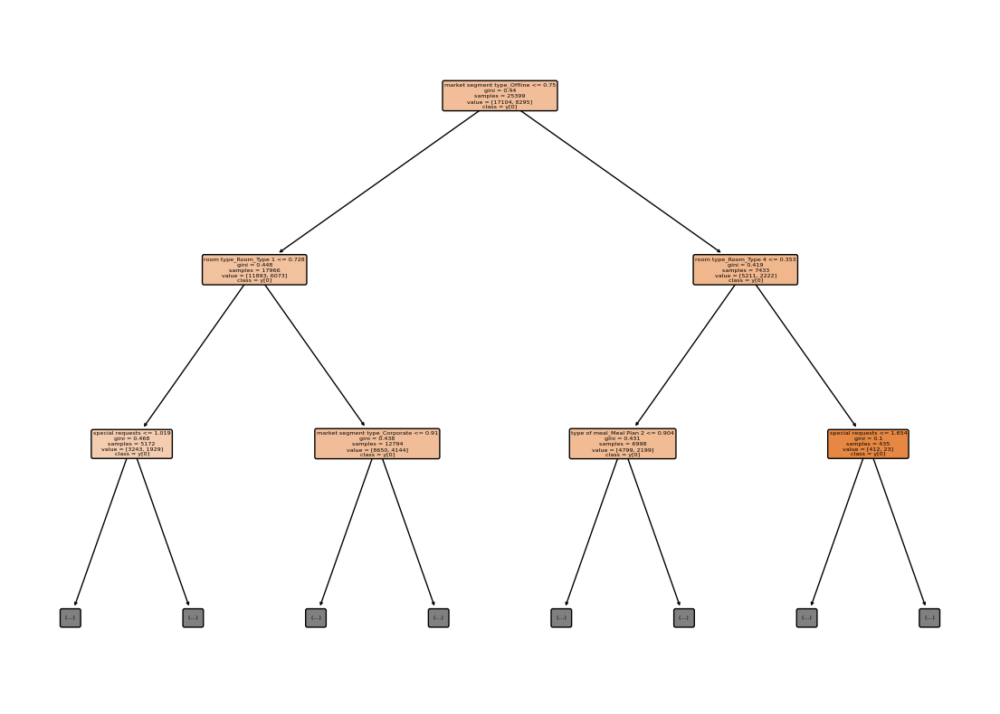

Executing decission tree with: gini, random, None, balanced
Mean Squared Error: 0.15818482454528754
R-squared: 0.2900495011707217
Accuracy: 0.8418151754547125
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.77      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3177  442]
 [ 419 1405]]
AUC: 0.8240759508781627


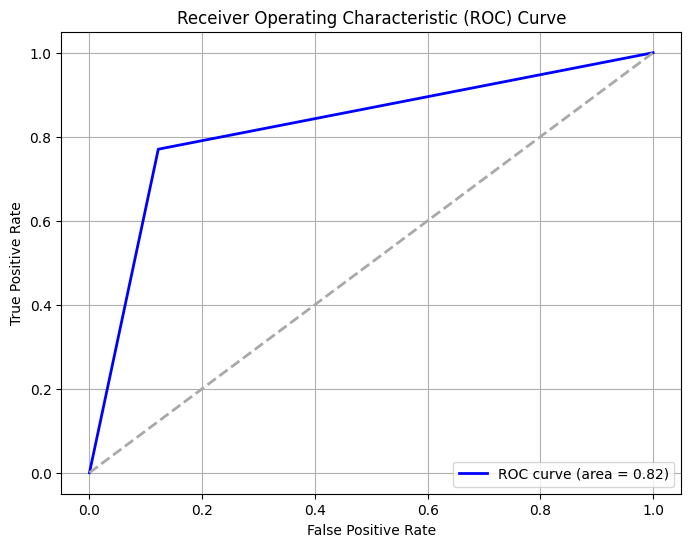

Cost-Sensitive Accuracy: 0.683630350909425


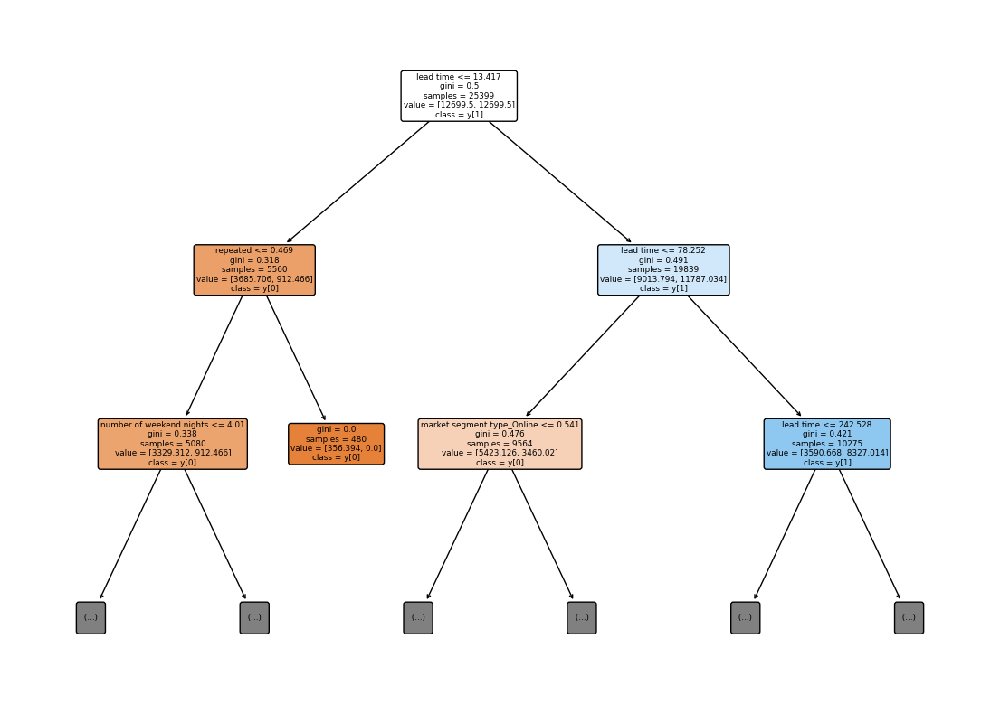

Executing decission tree with: gini, random, None, None
Mean Squared Error: 0.16038949108947273
R-squared: 0.28015472069923353
Accuracy: 0.8396105089105272
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.76      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3176  443]
 [ 430 1394]]
AUC: 0.8209224402883417


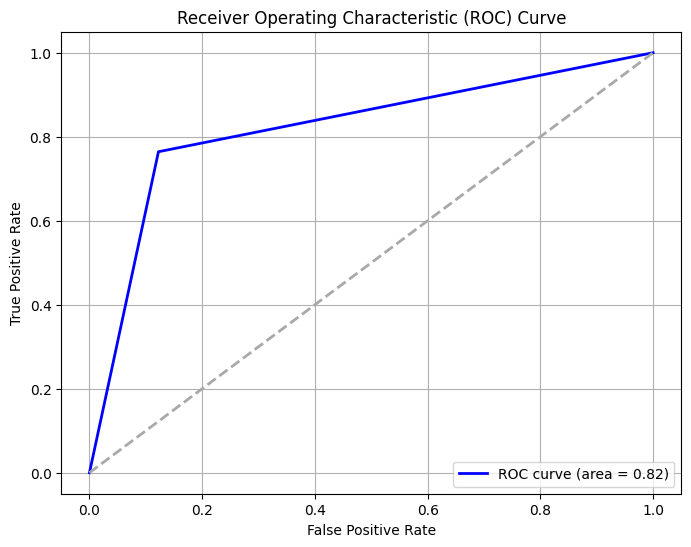

Cost-Sensitive Accuracy: 0.6792210178210545


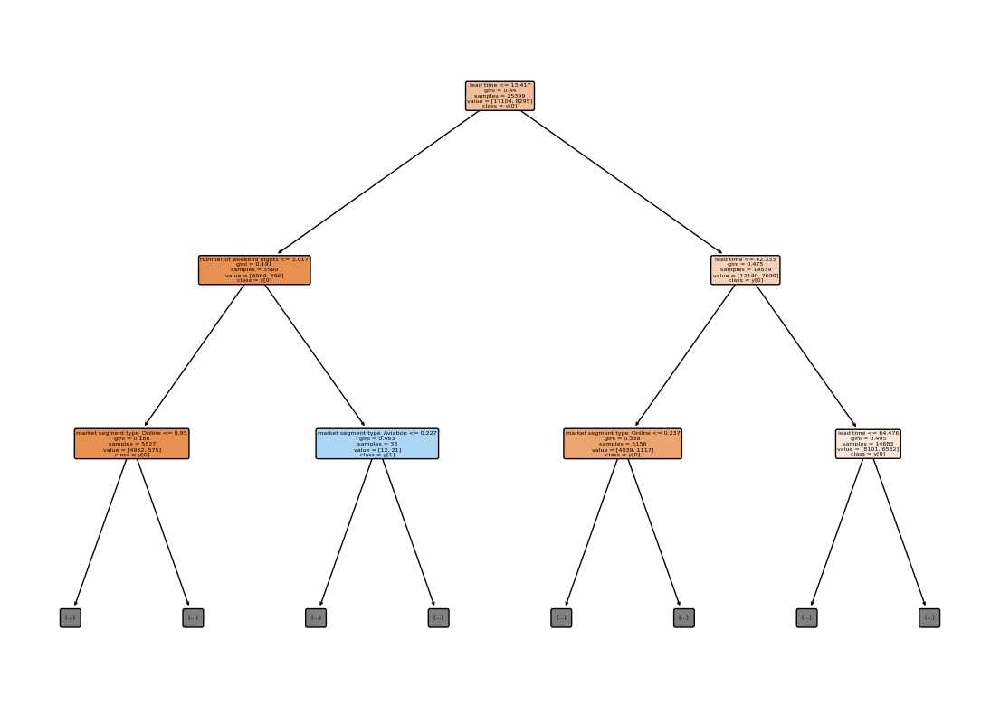

Executing decission tree with: entropy, best, auto, balanced
Mean Squared Error: 0.15763365790924122
R-squared: 0.2925231962885938
Accuracy: 0.8423663420907588
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.77      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3179  440]
 [ 418 1406]]
AUC: 0.8246263931104357


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


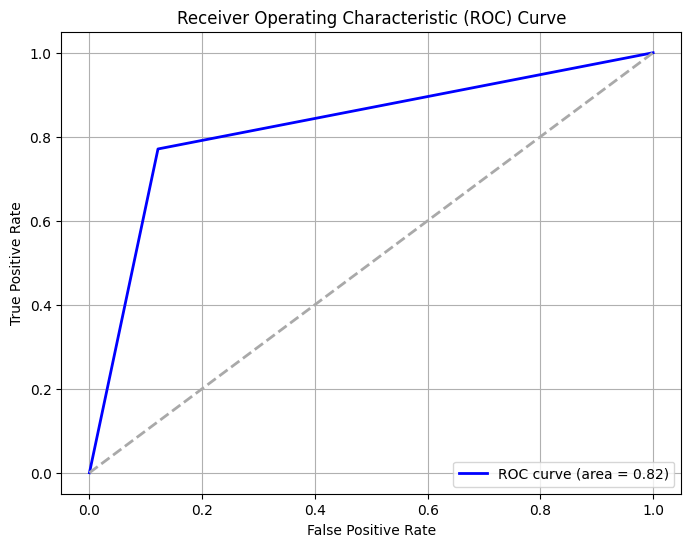

Cost-Sensitive Accuracy: 0.6847326841815176


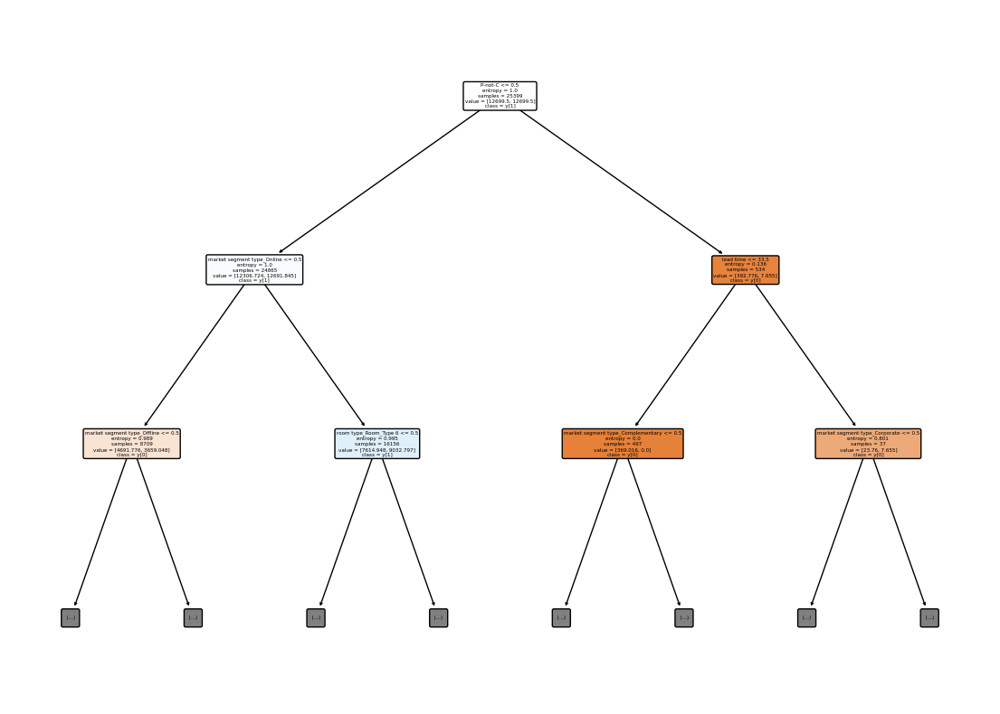

Executing decission tree with: entropy, best, auto, None
Mean Squared Error: 0.15120338048870108
R-squared: 0.3213829726637677
Accuracy: 0.8487966195112989
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.89      0.89      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3205  414]
 [ 409 1415]]
AUC: 0.8306856509019162


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


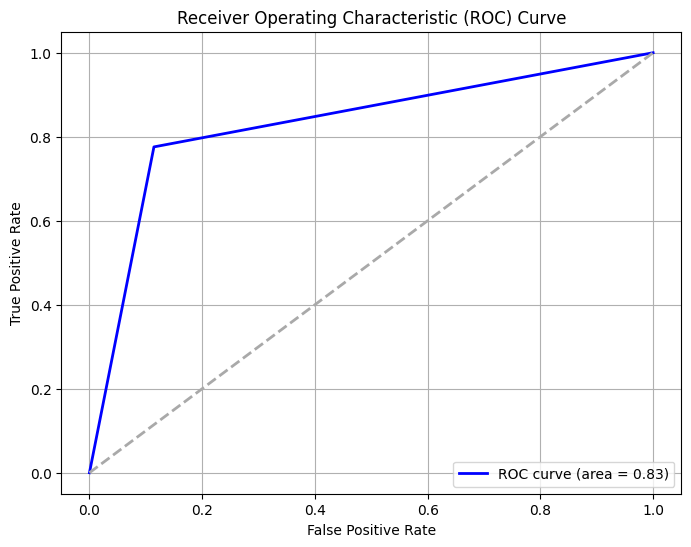

Cost-Sensitive Accuracy: 0.6975932390225978


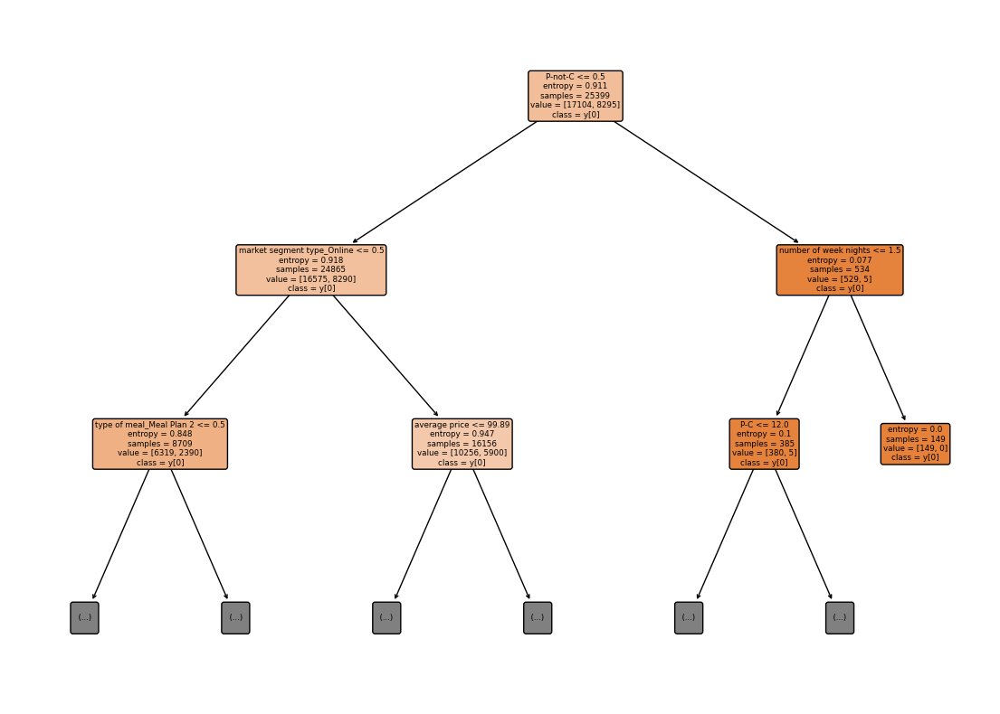

Executing decission tree with: entropy, best, sqrt, balanced
Mean Squared Error: 0.15763365790924122
R-squared: 0.2925231962885938
Accuracy: 0.8423663420907588
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.77      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3179  440]
 [ 418 1406]]
AUC: 0.8246263931104357


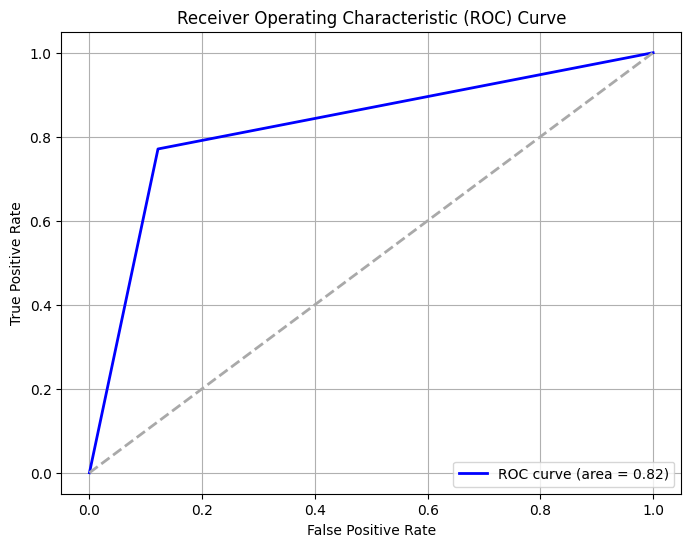

Cost-Sensitive Accuracy: 0.6847326841815176


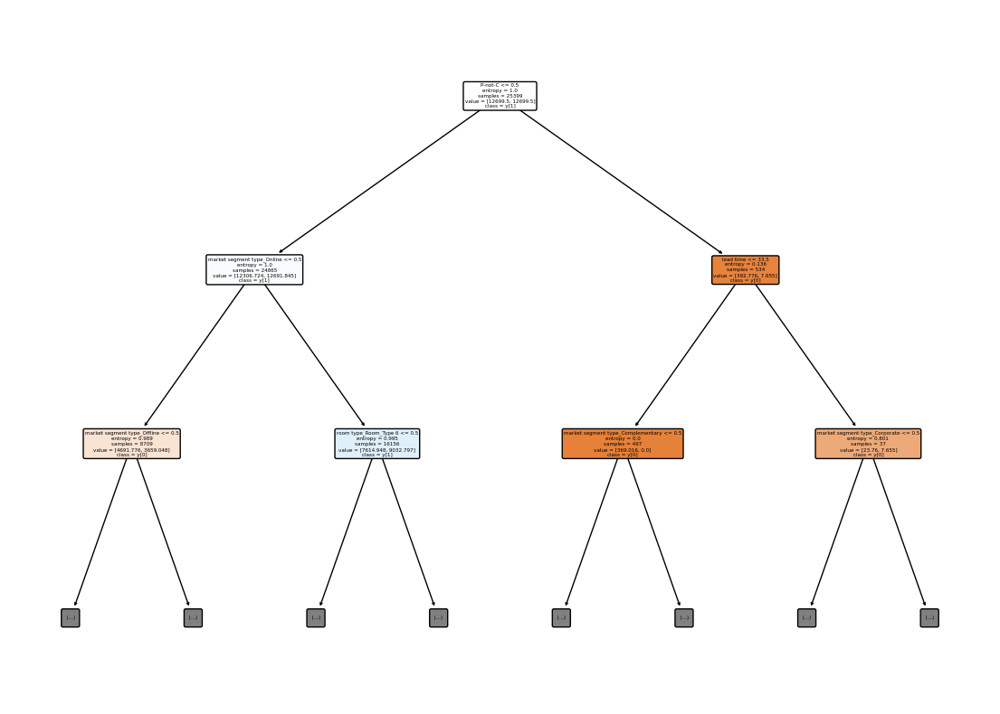

Executing decission tree with: entropy, best, sqrt, None
Mean Squared Error: 0.15120338048870108
R-squared: 0.3213829726637677
Accuracy: 0.8487966195112989
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.89      0.89      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3205  414]
 [ 409 1415]]
AUC: 0.8306856509019162


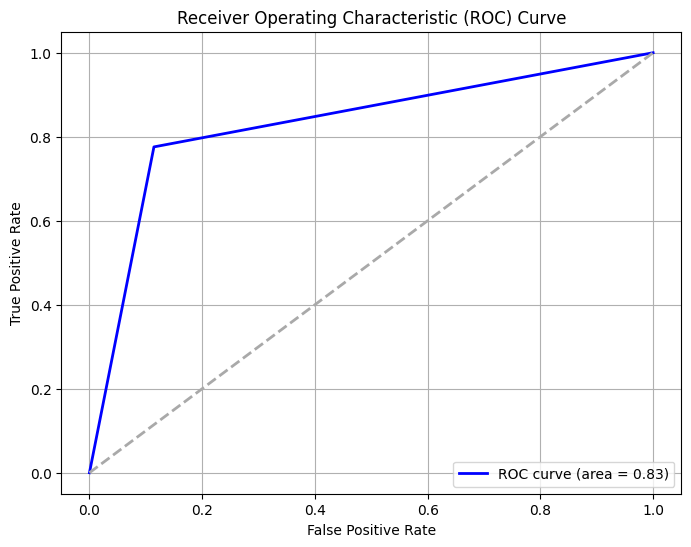

Cost-Sensitive Accuracy: 0.6975932390225978


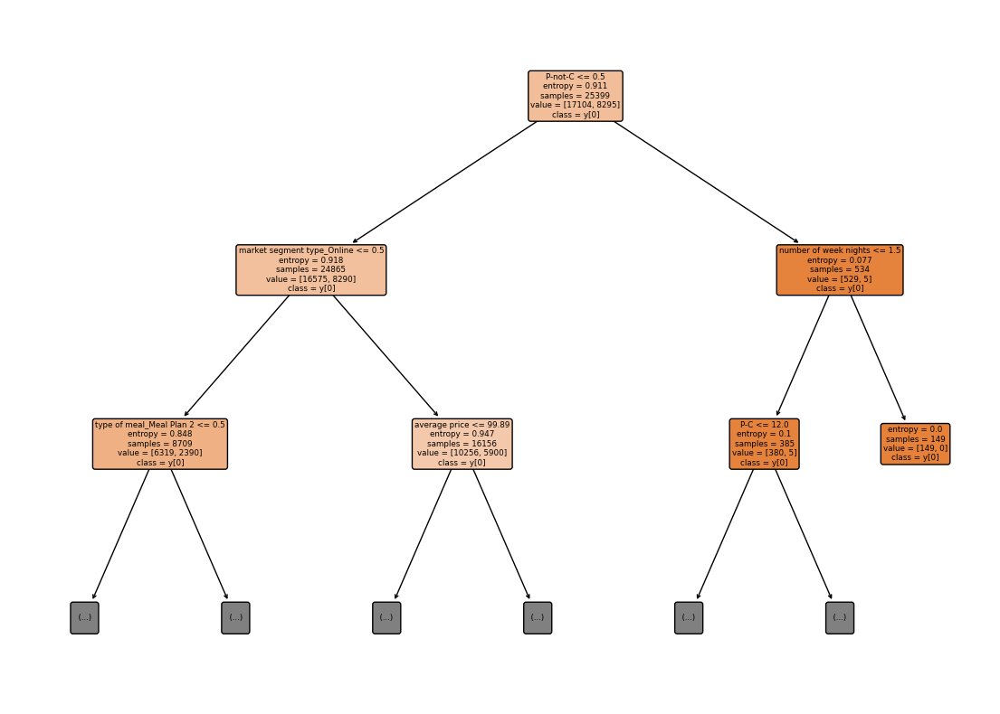

Executing decission tree with: entropy, best, log2, balanced
Mean Squared Error: 0.16057321330148816
R-squared: 0.2793301556599428
Accuracy: 0.8394267866985119
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.88      3619
           1       0.76      0.77      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3166  453]
 [ 421 1403]]
AUC: 0.8220079484252217


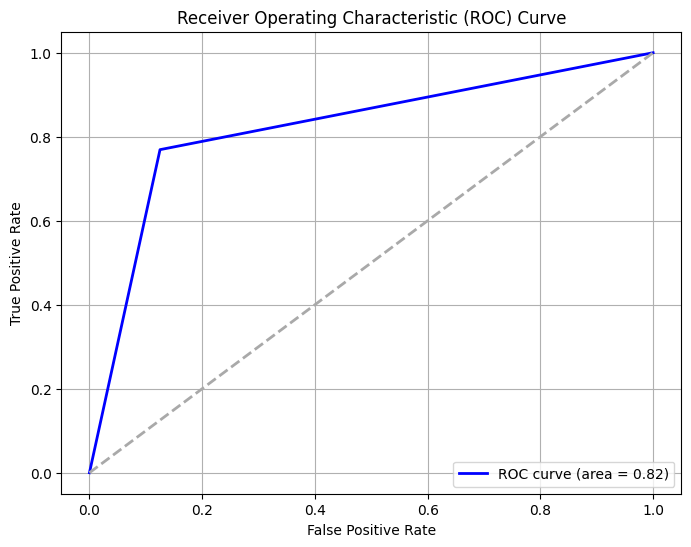

Cost-Sensitive Accuracy: 0.6788535733970238


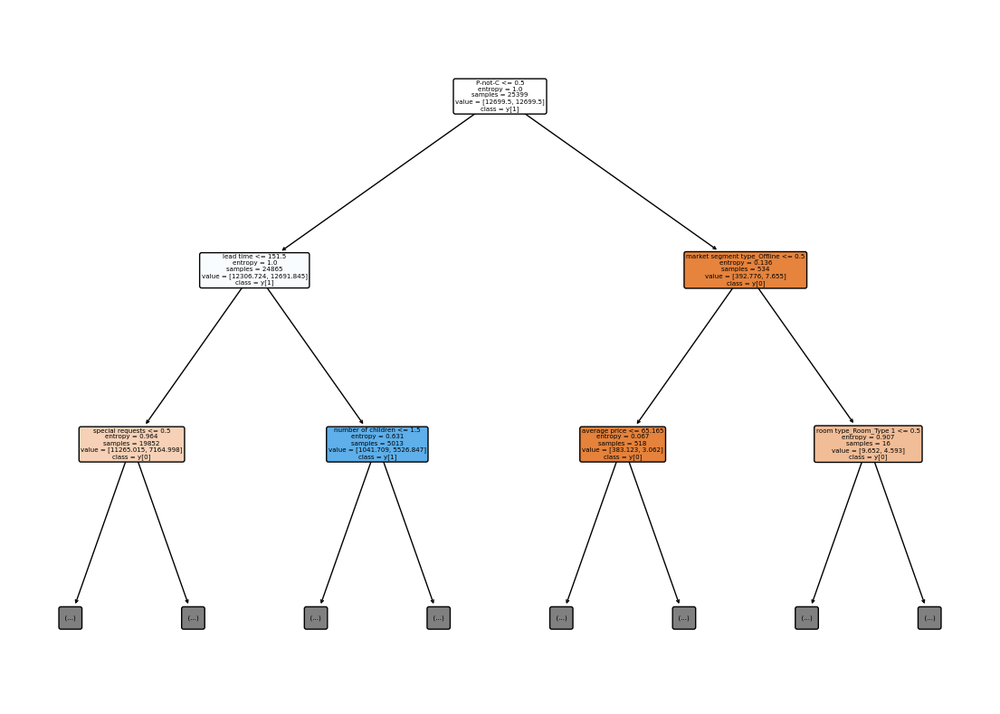

Executing decission tree with: entropy, best, log2, None
Mean Squared Error: 0.14973360279257764
R-squared: 0.32797949297809315
Accuracy: 0.8502663972074224
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89      3619
           1       0.78      0.77      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3229  390]
 [ 425 1399]]
AUC: 0.8296155190927028


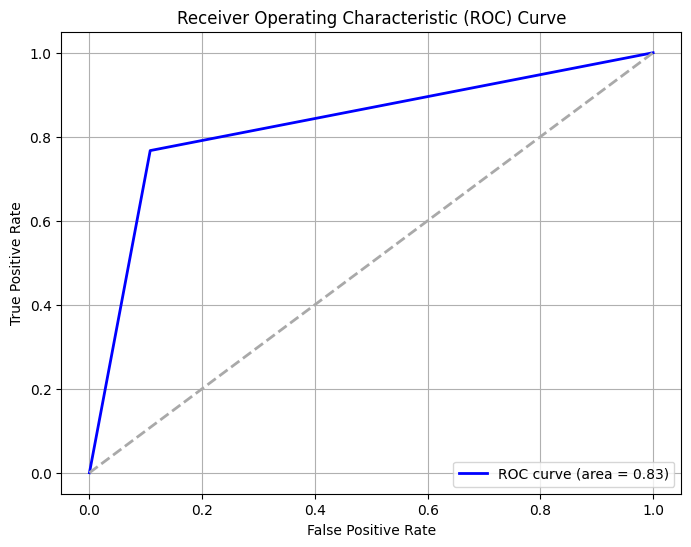

Cost-Sensitive Accuracy: 0.7005327944148447


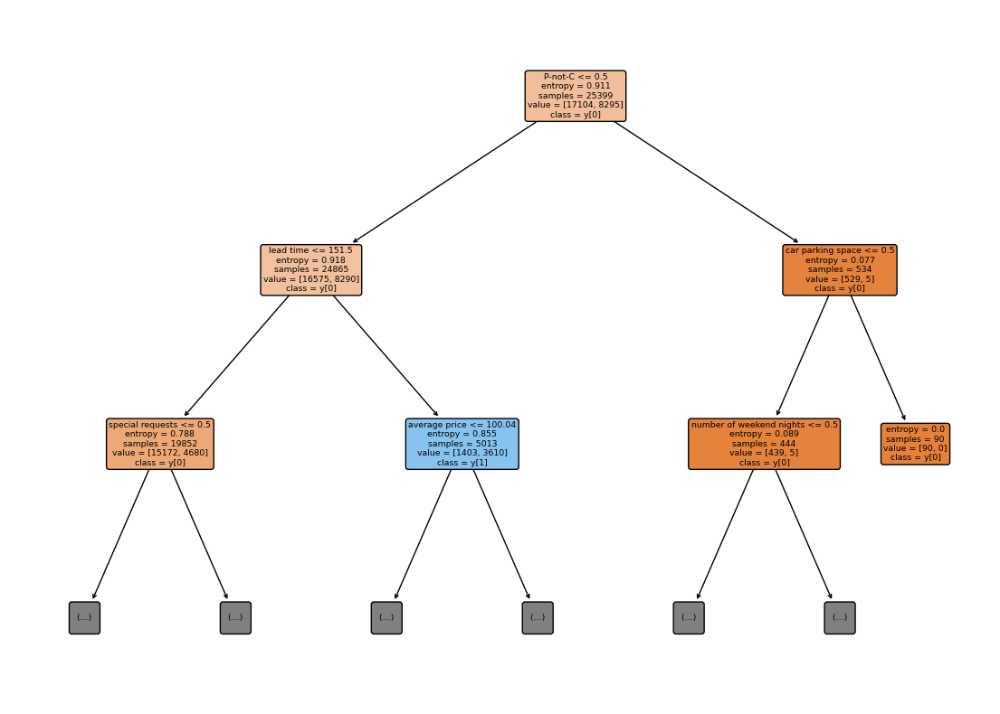

Executing decission tree with: entropy, best, None, balanced
Mean Squared Error: 0.1523057137607937
R-squared: 0.3164355824280236
Accuracy: 0.8476942862392063
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3193  426]
 [ 403 1421]]
AUC: 0.830672471192488


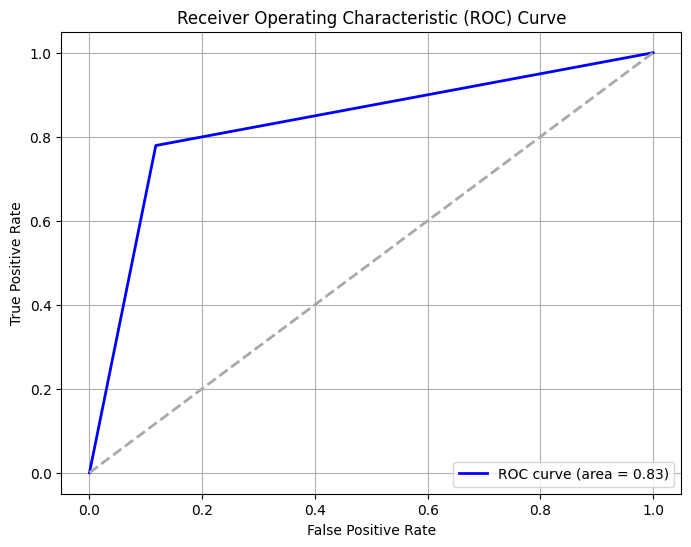

Cost-Sensitive Accuracy: 0.6953885724784126


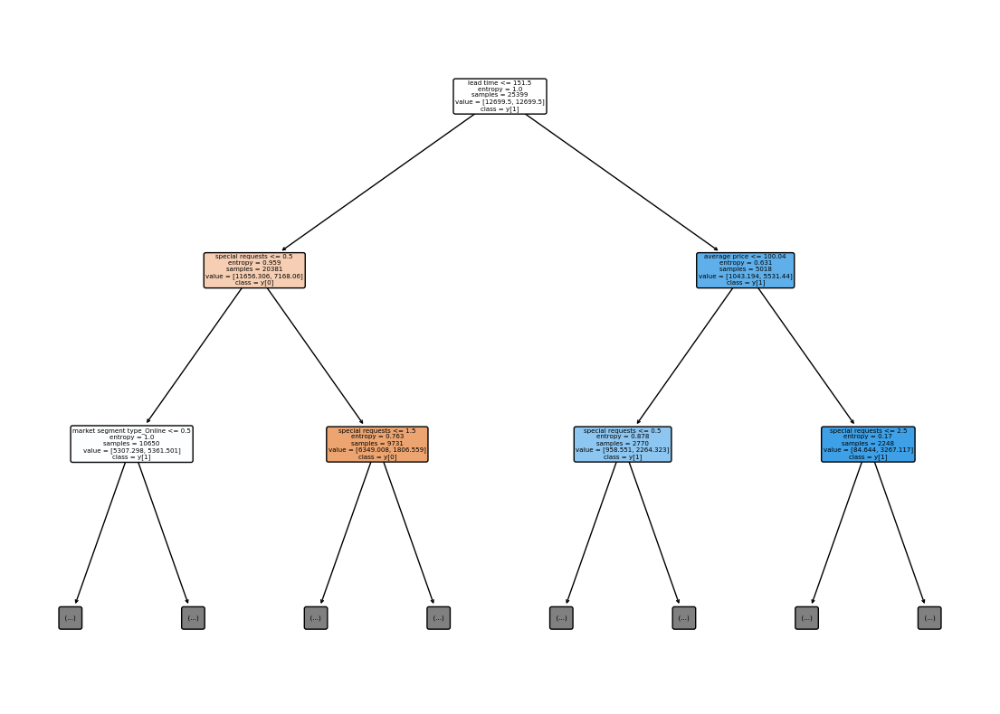

Executing decission tree with: entropy, best, None, None
Mean Squared Error: 0.1539592136689326
R-squared: 0.3090144970744074
Accuracy: 0.8460407863310674
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.88      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3188  431]
 [ 407 1417]]
AUC: 0.8288851814012788


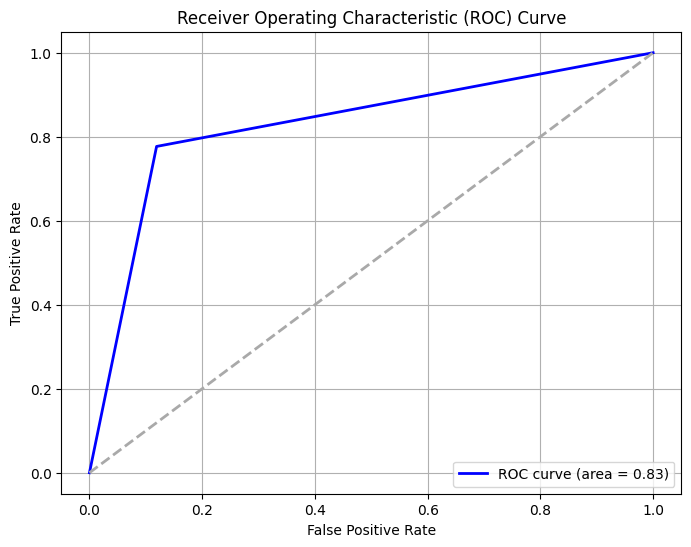

Cost-Sensitive Accuracy: 0.6920815726621348


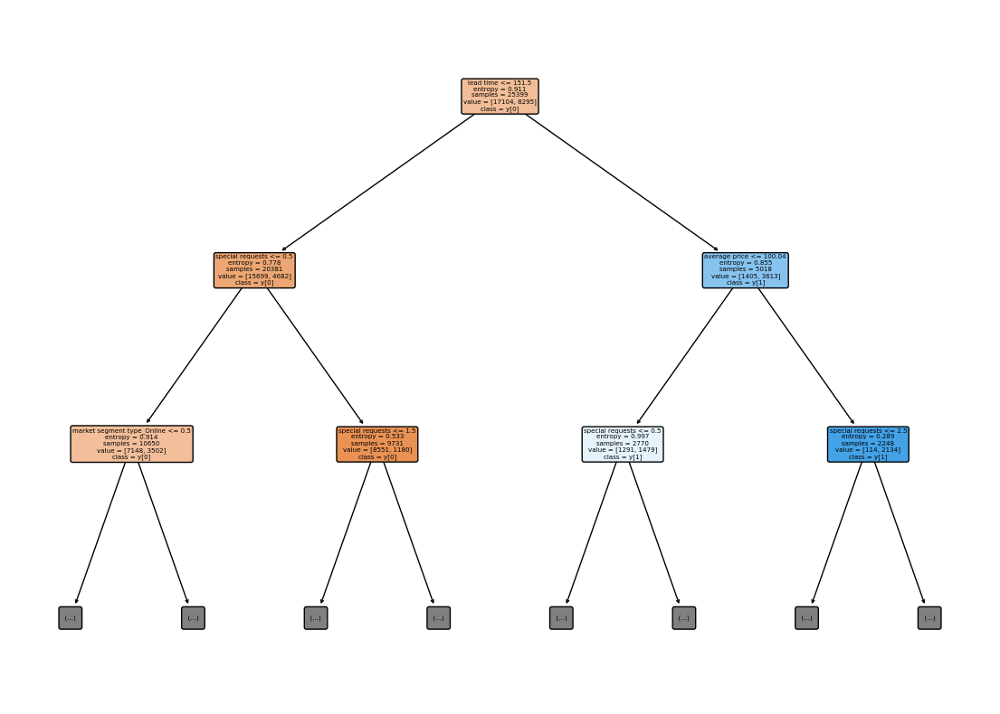

Executing decission tree with: entropy, random, auto, balanced
Mean Squared Error: 0.16626860187396655
R-squared: 0.2537686394419316
Accuracy: 0.8337313981260335
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.87      3619
           1       0.75      0.76      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.82      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3155  464]
 [ 441 1383]]
AUC: 0.815005735445965


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


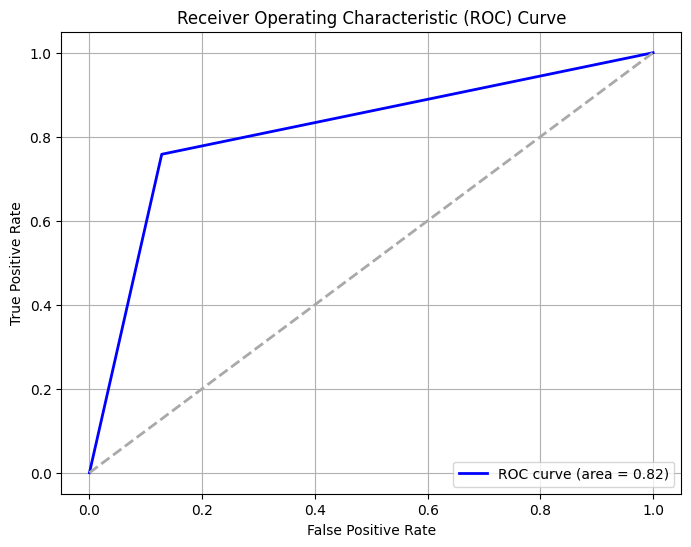

Cost-Sensitive Accuracy: 0.667462796252067


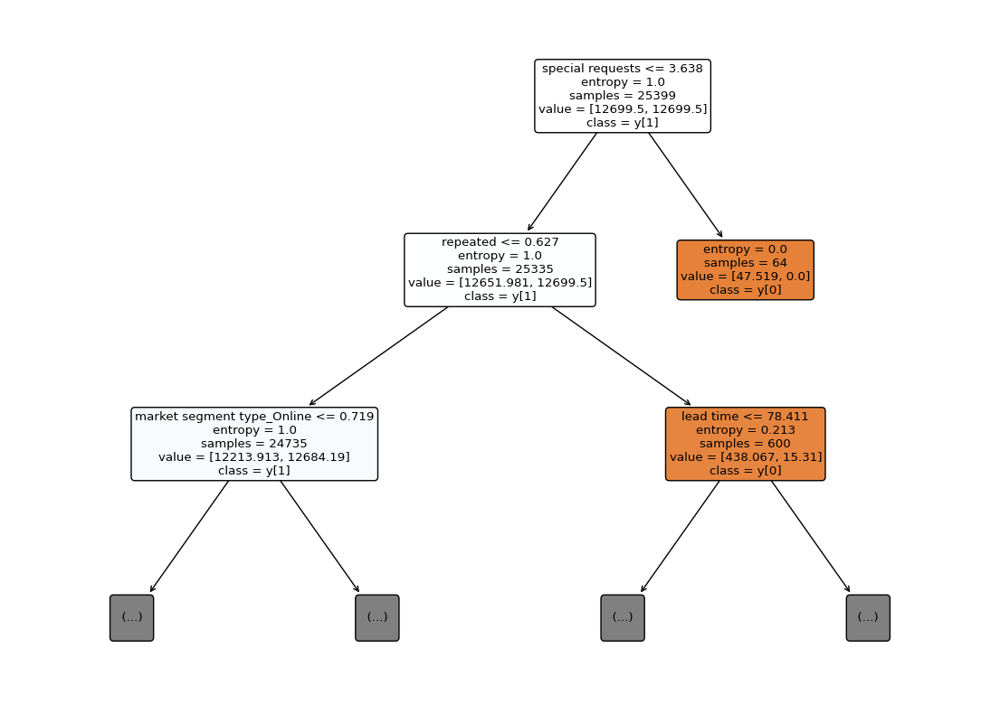

Executing decission tree with: entropy, random, auto, None
Mean Squared Error: 0.16094065772551902
R-squared: 0.27768102558136143
Accuracy: 0.839059342274481
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.88      3619
           1       0.77      0.75      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3202  417]
 [ 459 1365]]
AUC: 0.8165650314131557


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


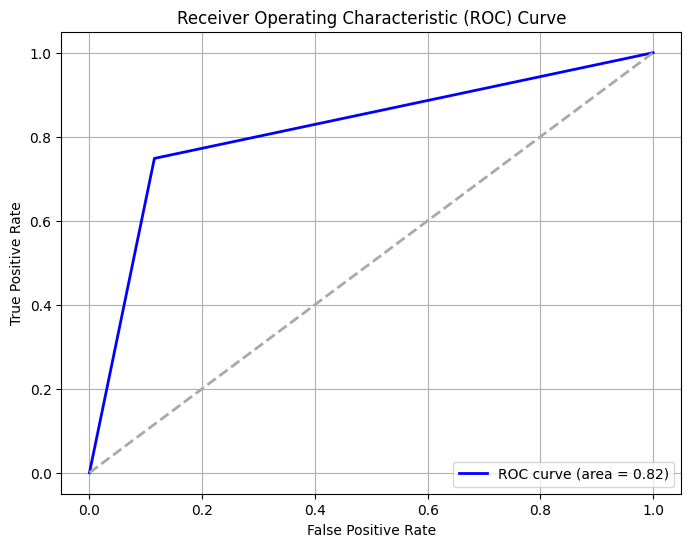

Cost-Sensitive Accuracy: 0.678118684548962


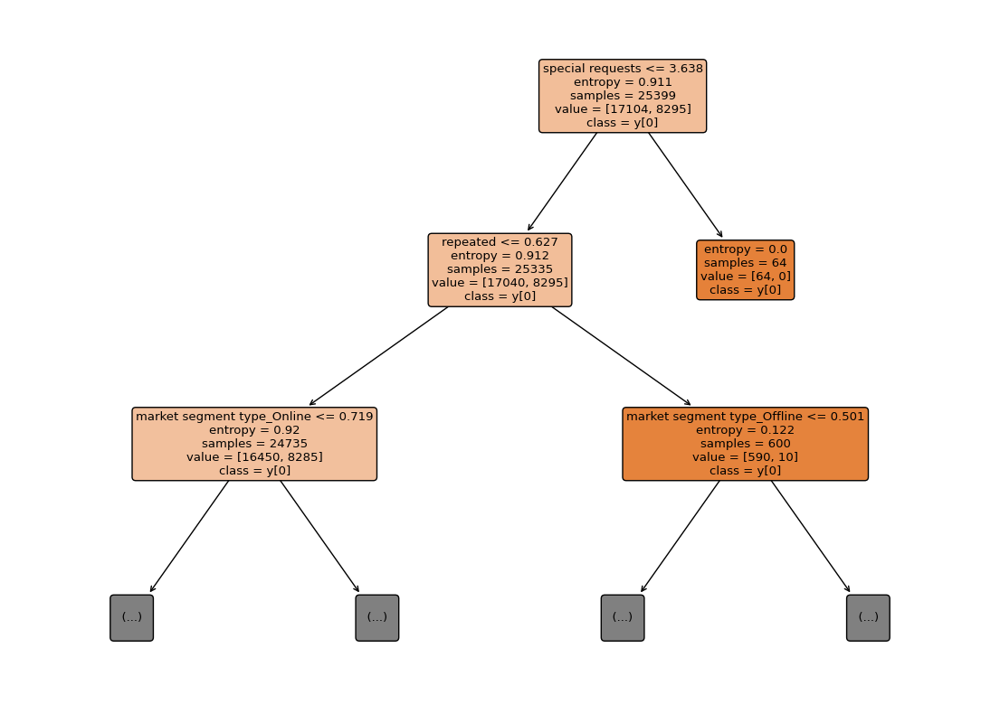

Executing decission tree with: entropy, random, sqrt, balanced
Mean Squared Error: 0.16626860187396655
R-squared: 0.2537686394419316
Accuracy: 0.8337313981260335
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.87      3619
           1       0.75      0.76      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.82      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3155  464]
 [ 441 1383]]
AUC: 0.815005735445965


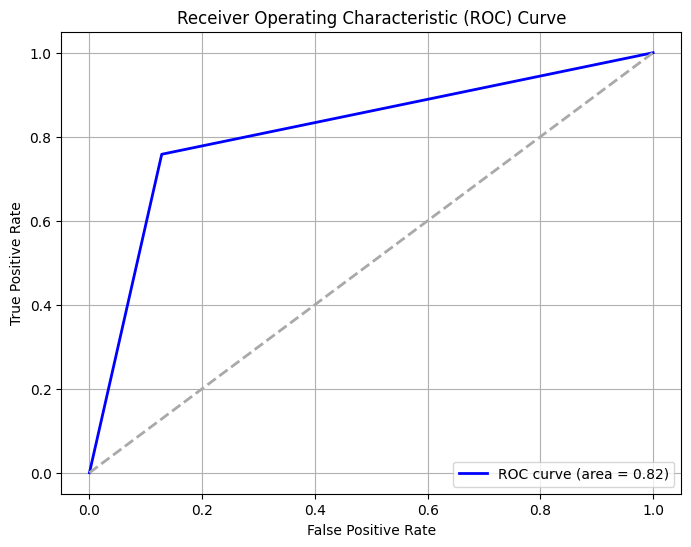

Cost-Sensitive Accuracy: 0.667462796252067


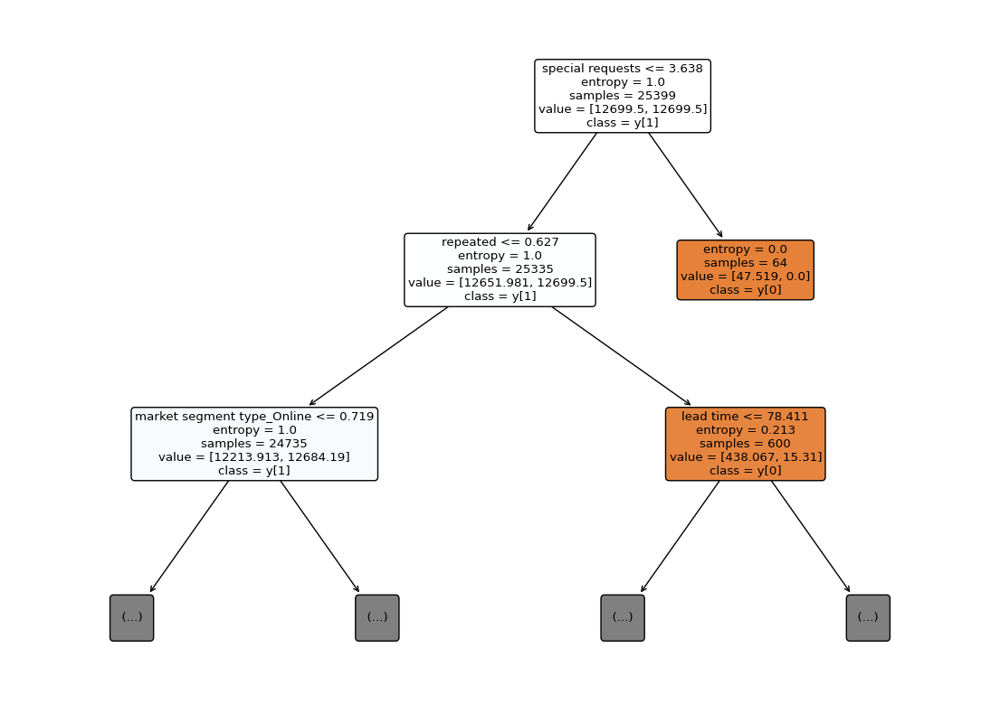

Executing decission tree with: entropy, random, sqrt, None
Mean Squared Error: 0.16094065772551902
R-squared: 0.27768102558136143
Accuracy: 0.839059342274481
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.88      3619
           1       0.77      0.75      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3202  417]
 [ 459 1365]]
AUC: 0.8165650314131557


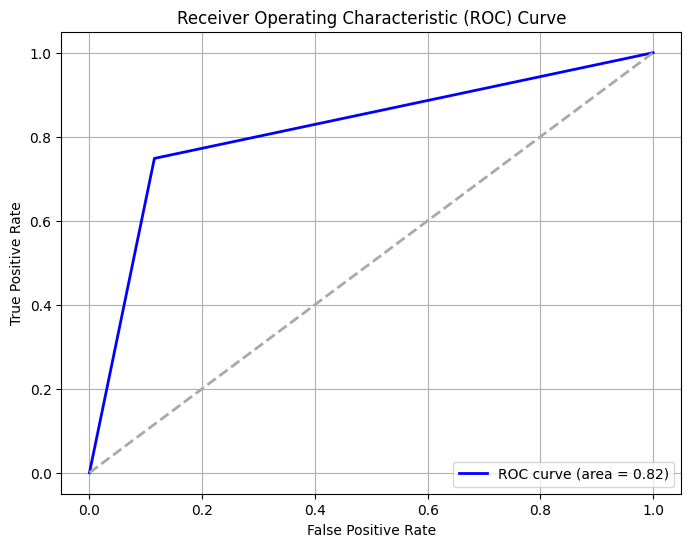

Cost-Sensitive Accuracy: 0.678118684548962


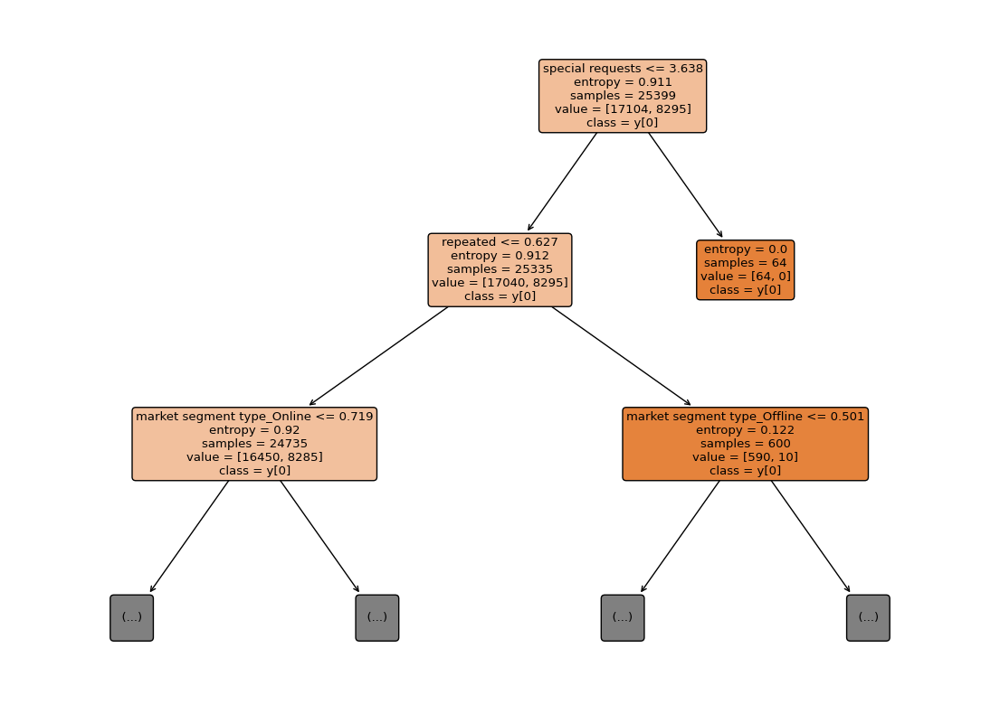

Executing decission tree with: entropy, random, log2, balanced
Mean Squared Error: 0.16167554657358074
R-squared: 0.2743827654241987
Accuracy: 0.8383244534264193
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.76      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3174  445]
 [ 435 1389]]
AUC: 0.8192755068279984


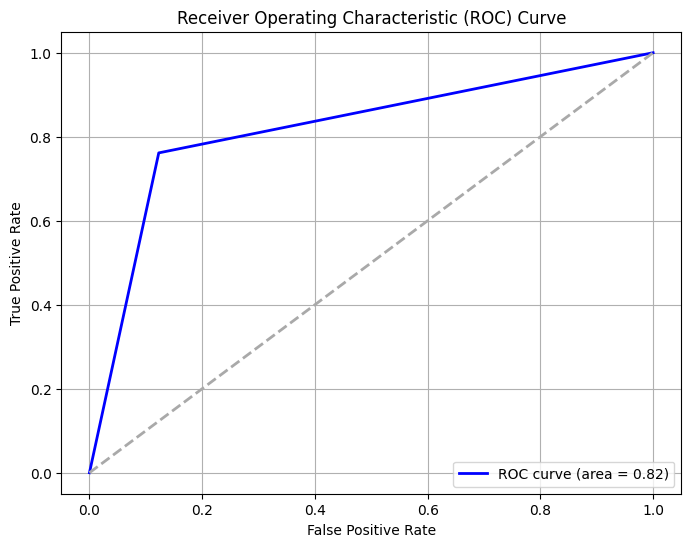

Cost-Sensitive Accuracy: 0.6766489068528385


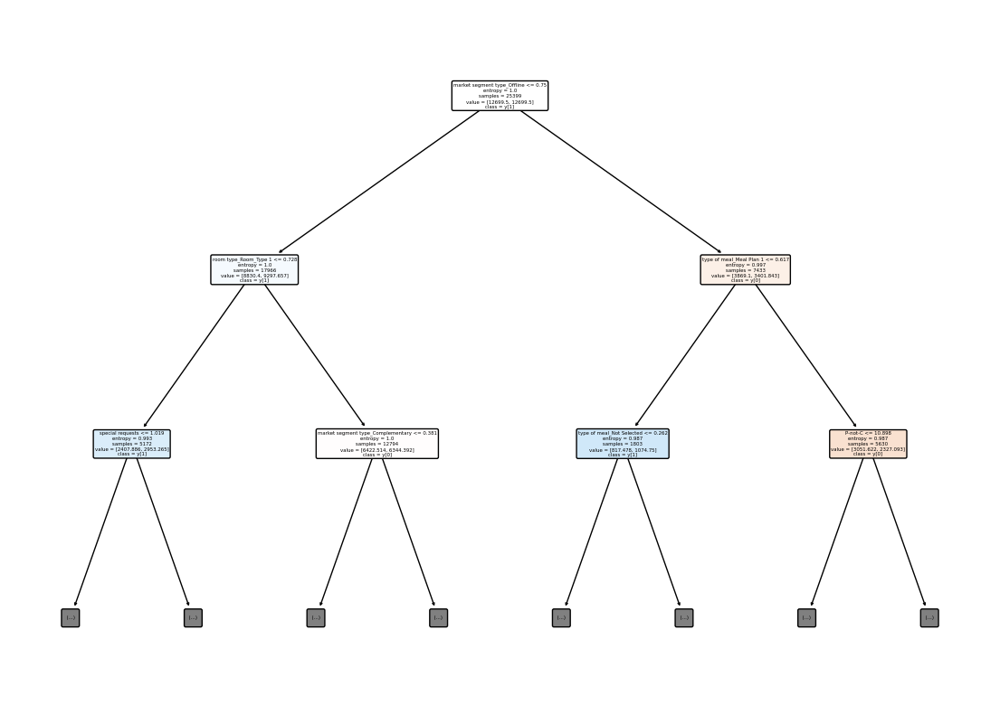

Executing decission tree with: entropy, random, log2, None
Mean Squared Error: 0.16975932390225978
R-squared: 0.23810190369540862
Accuracy: 0.8302406760977402
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.87      0.87      3619
           1       0.75      0.74      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.81      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3161  458]
 [ 466 1358]]
AUC: 0.8089816235462931


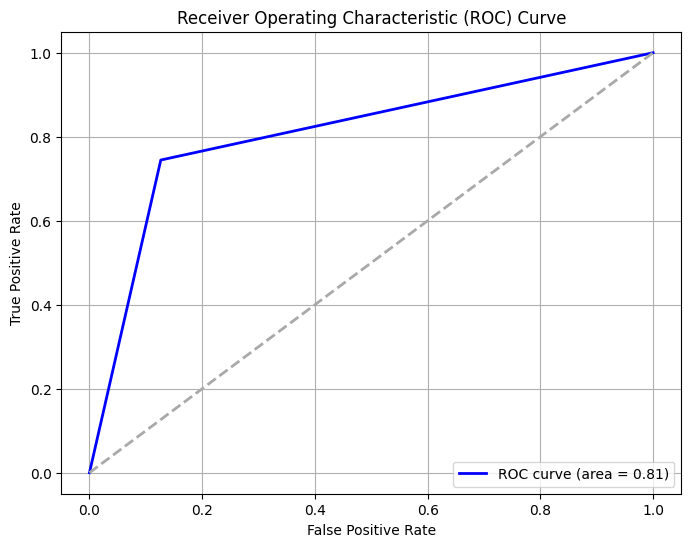

Cost-Sensitive Accuracy: 0.6604813521954804


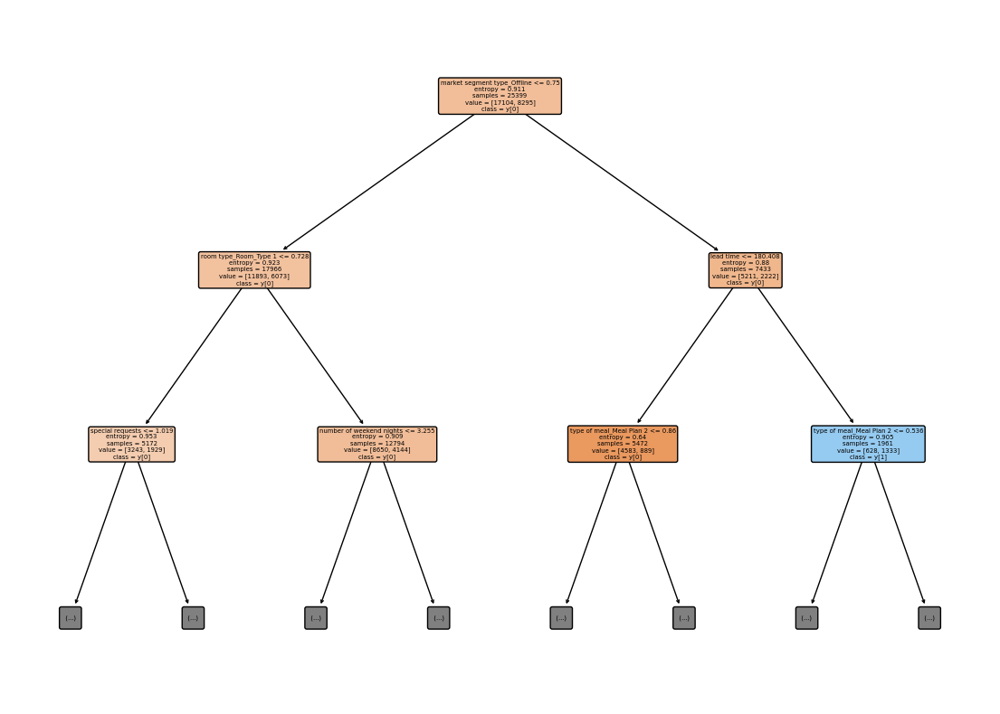

Executing decission tree with: entropy, random, None, balanced
Mean Squared Error: 0.15451038030497888
R-squared: 0.3065408019565353
Accuracy: 0.8454896196950211
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.77      0.77      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3193  426]
 [ 415 1409]]
AUC: 0.8273829975082775


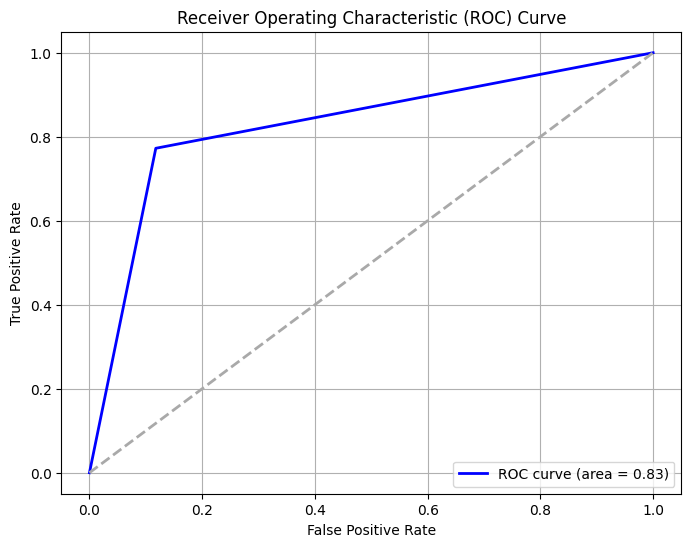

Cost-Sensitive Accuracy: 0.6909792393900422


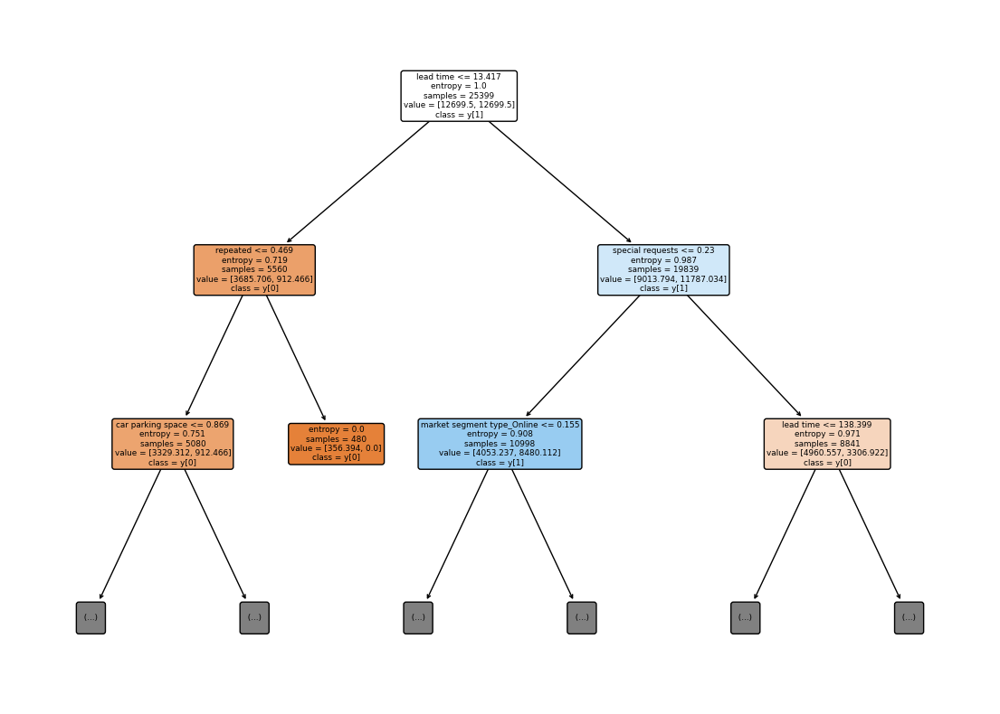

Executing decission tree with: entropy, random, None, None
Mean Squared Error: 0.15542899136505603
R-squared: 0.302417976760082
Accuracy: 0.8445710086349439
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.77      0.77      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3198  421]
 [ 425 1399]]
AUC: 0.825332568001241


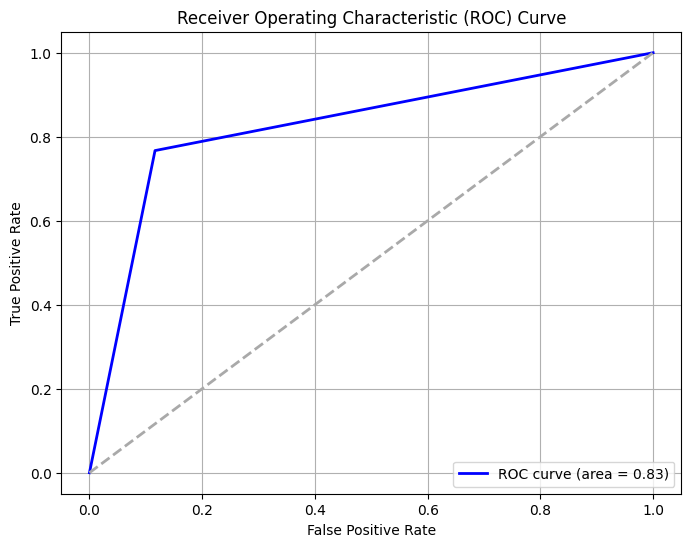

Cost-Sensitive Accuracy: 0.6891420172698879


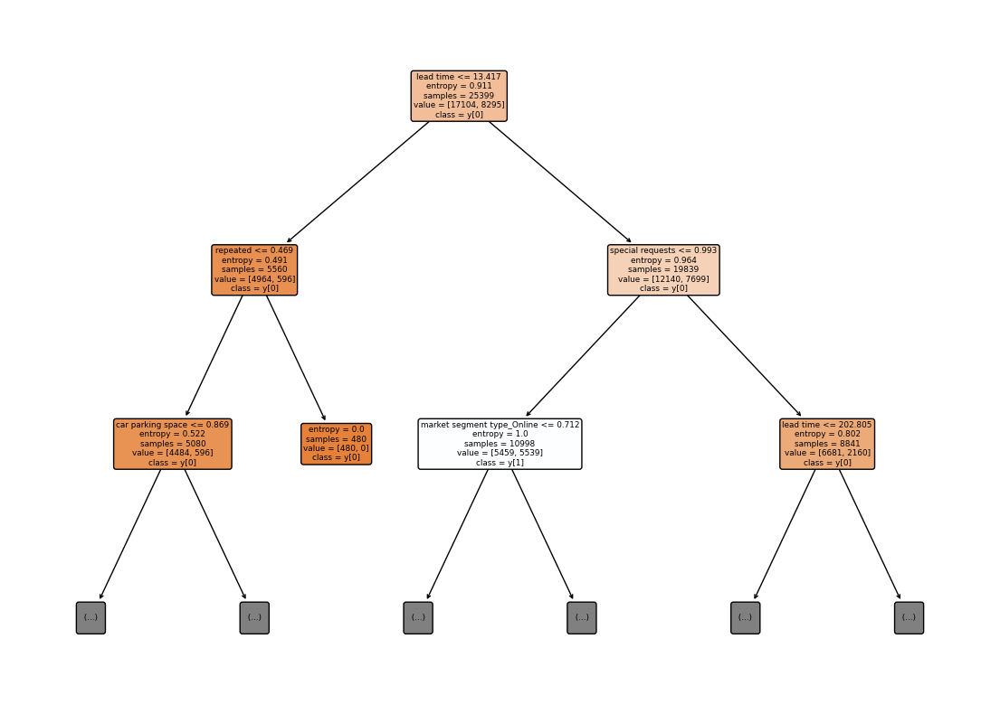

Executing decission tree with: log_loss, best, auto, balanced
Mean Squared Error: 0.15763365790924122
R-squared: 0.2925231962885938
Accuracy: 0.8423663420907588
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.77      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3179  440]
 [ 418 1406]]
AUC: 0.8246263931104357


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


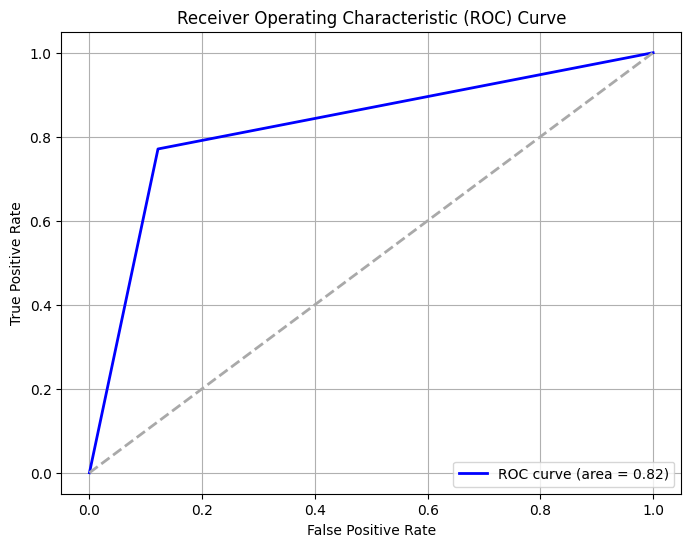

Cost-Sensitive Accuracy: 0.6847326841815176


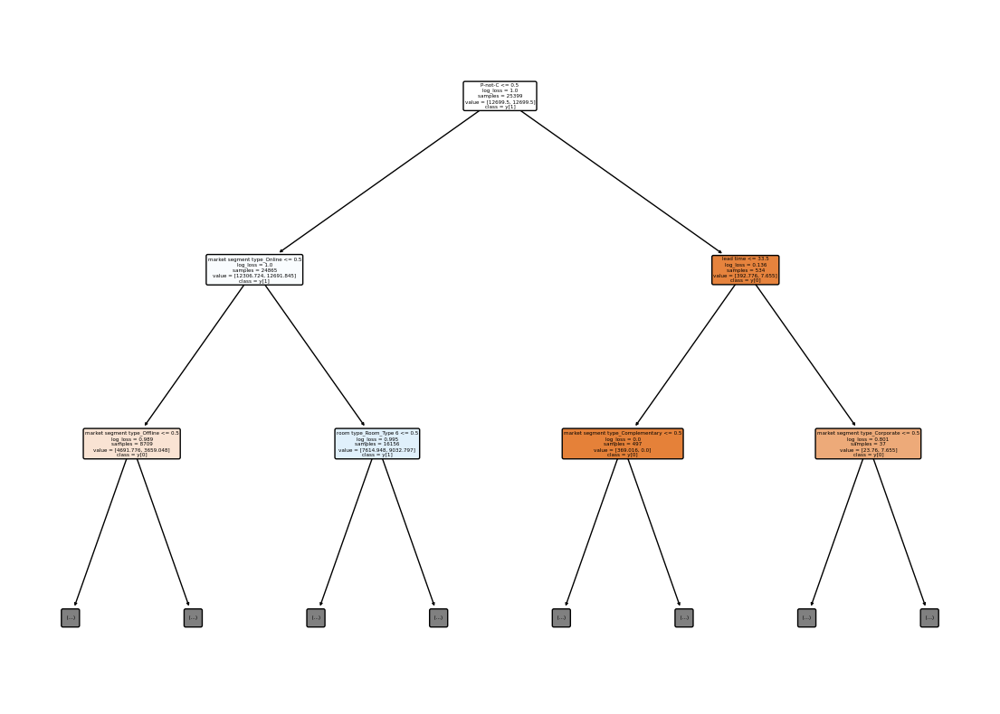

Executing decission tree with: log_loss, best, auto, None
Mean Squared Error: 0.15120338048870108
R-squared: 0.3213829726637677
Accuracy: 0.8487966195112989
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.89      0.89      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3205  414]
 [ 409 1415]]
AUC: 0.8306856509019162


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


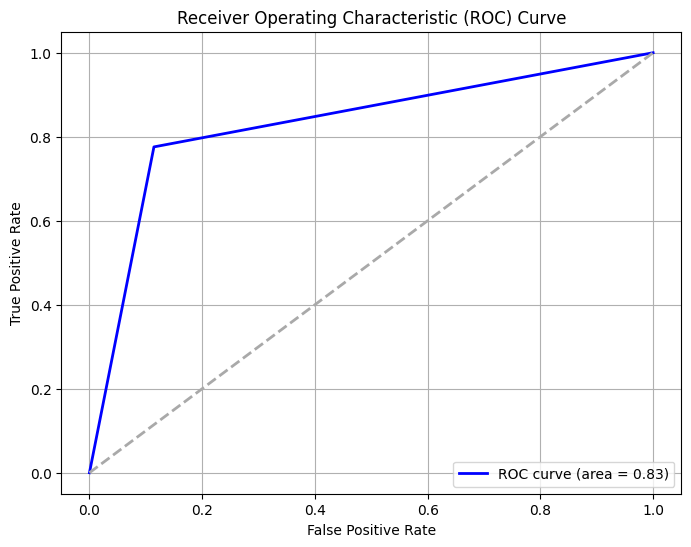

Cost-Sensitive Accuracy: 0.6975932390225978


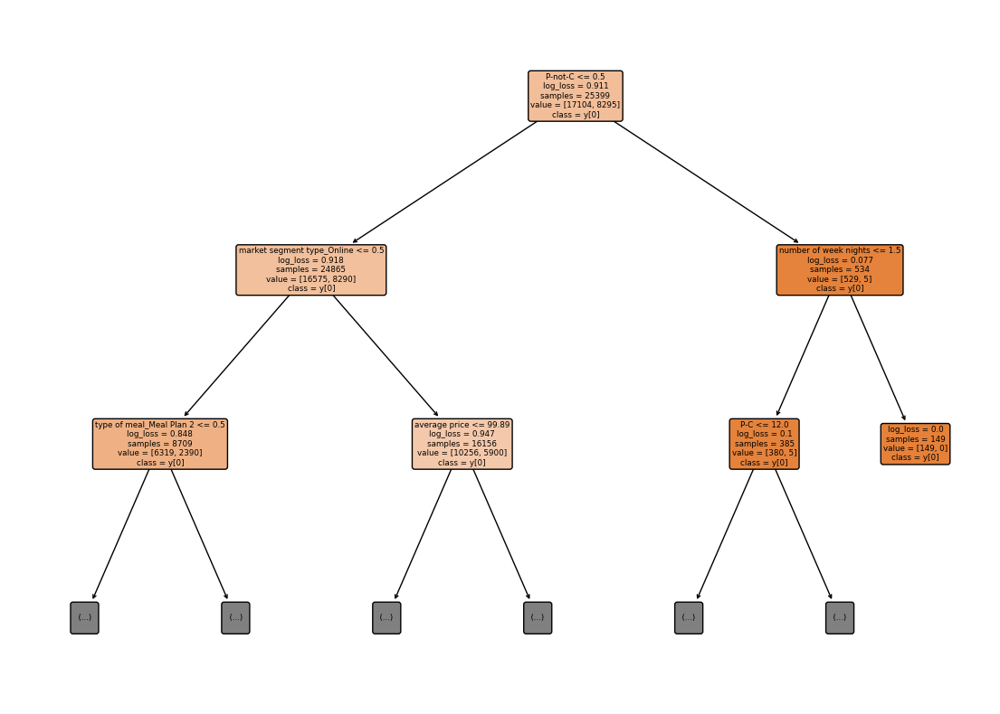

Executing decission tree with: log_loss, best, sqrt, balanced
Mean Squared Error: 0.15763365790924122
R-squared: 0.2925231962885938
Accuracy: 0.8423663420907588
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.77      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3179  440]
 [ 418 1406]]
AUC: 0.8246263931104357


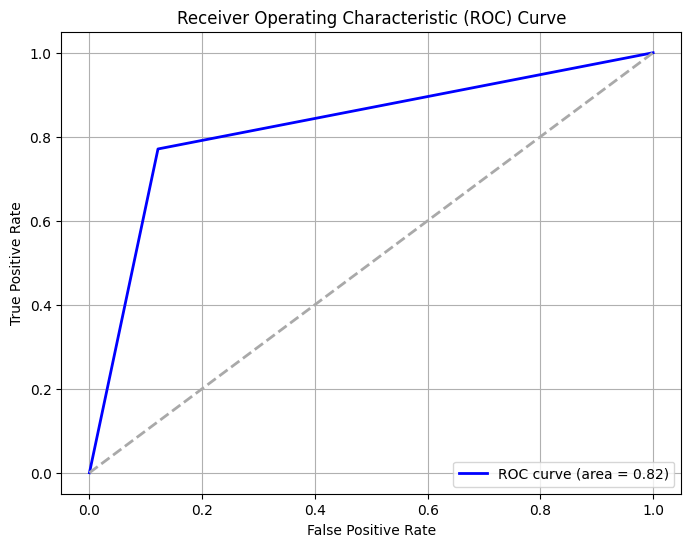

Cost-Sensitive Accuracy: 0.6847326841815176


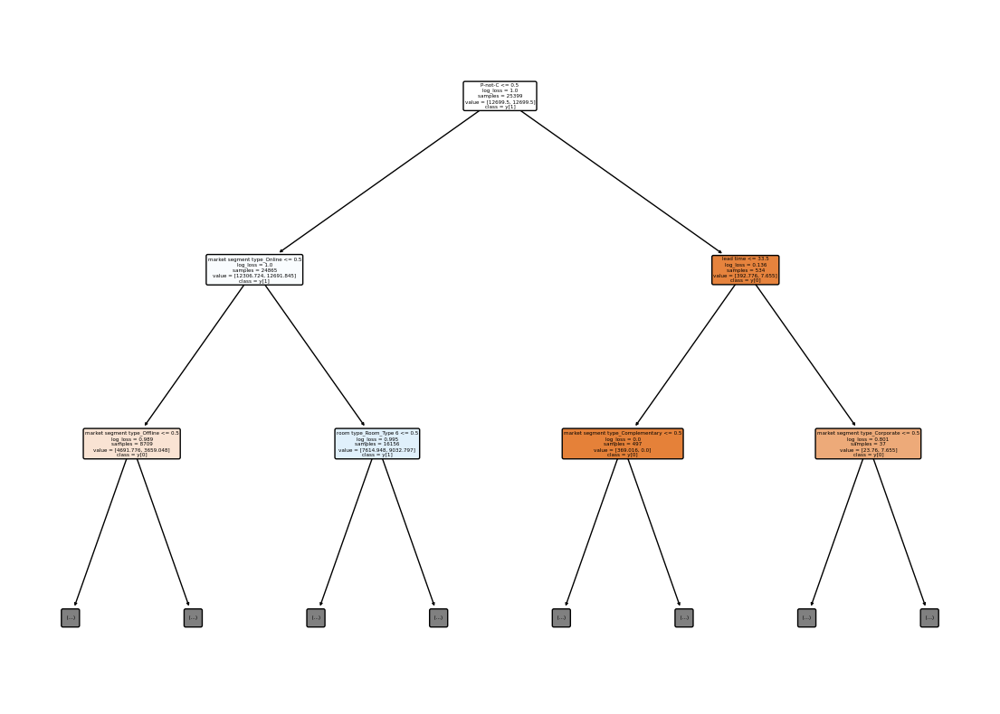

Executing decission tree with: log_loss, best, sqrt, None
Mean Squared Error: 0.15120338048870108
R-squared: 0.3213829726637677
Accuracy: 0.8487966195112989
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.89      0.89      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3205  414]
 [ 409 1415]]
AUC: 0.8306856509019162


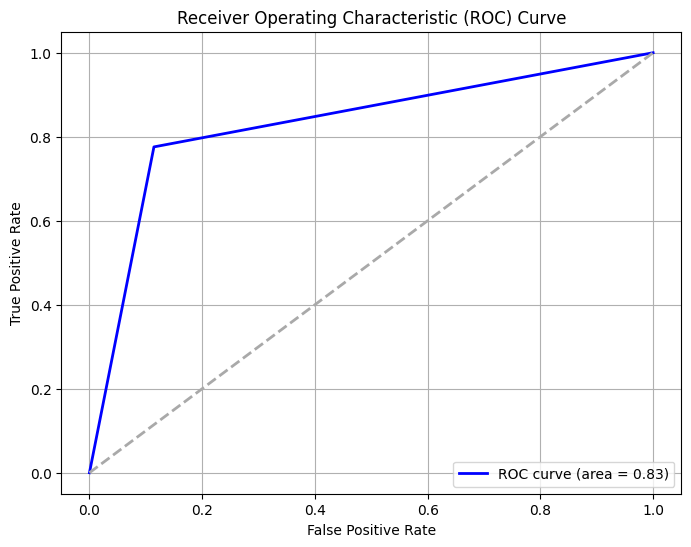

Cost-Sensitive Accuracy: 0.6975932390225978


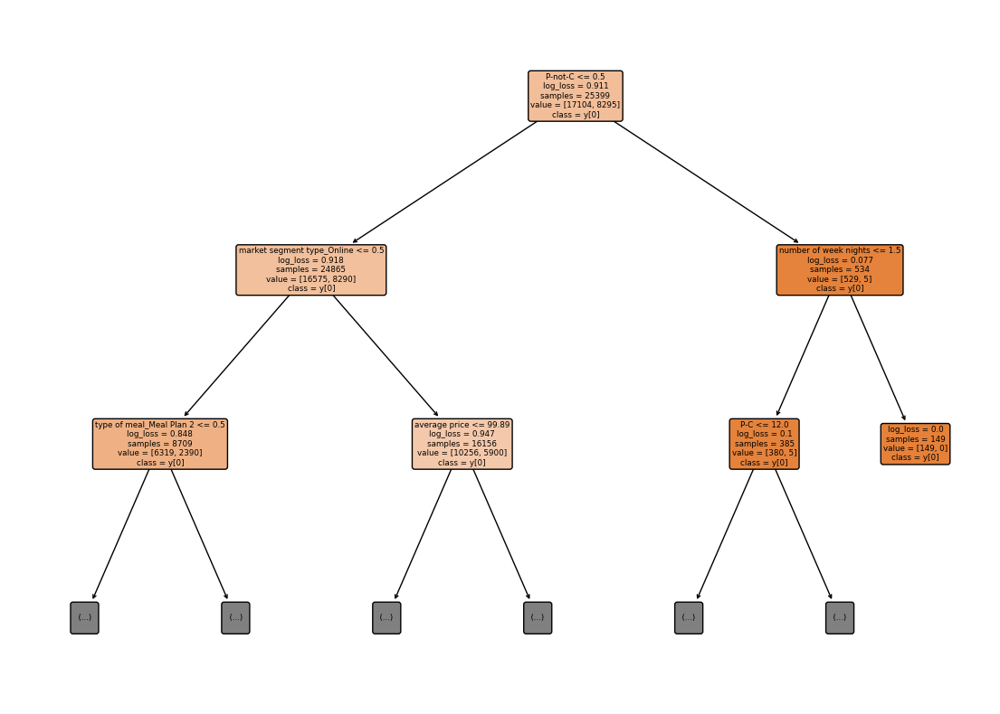

Executing decission tree with: log_loss, best, log2, balanced
Mean Squared Error: 0.16057321330148816
R-squared: 0.2793301556599428
Accuracy: 0.8394267866985119
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.88      3619
           1       0.76      0.77      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3166  453]
 [ 421 1403]]
AUC: 0.8220079484252217


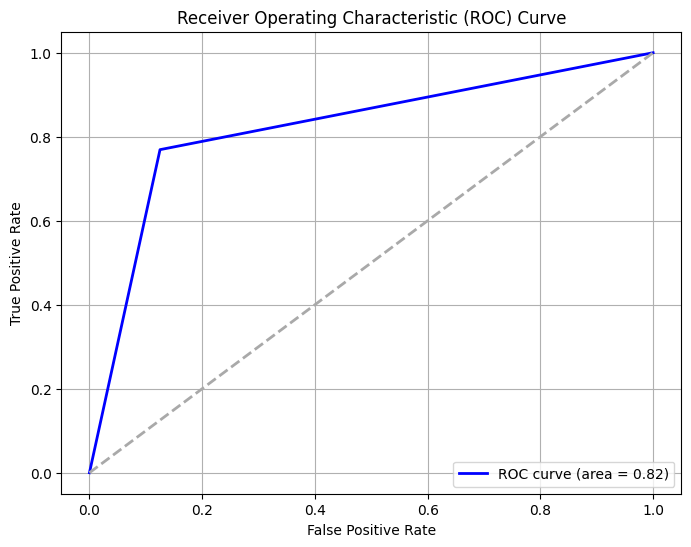

Cost-Sensitive Accuracy: 0.6788535733970238


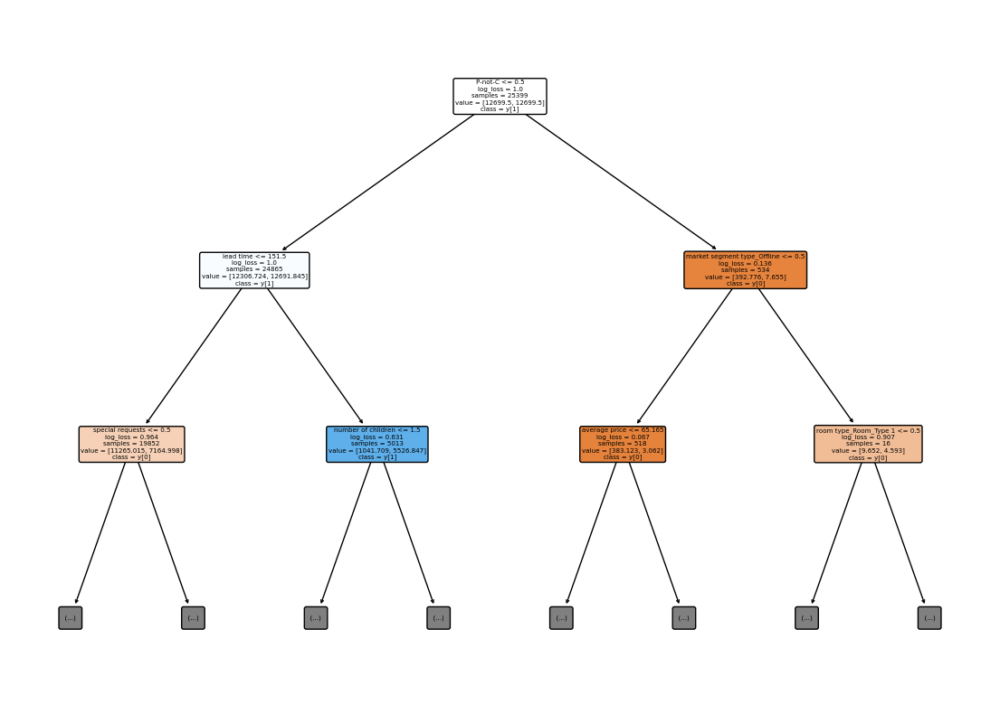

Executing decission tree with: log_loss, best, log2, None
Mean Squared Error: 0.14973360279257764
R-squared: 0.32797949297809315
Accuracy: 0.8502663972074224
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.89      0.89      3619
           1       0.78      0.77      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3229  390]
 [ 425 1399]]
AUC: 0.8296155190927028


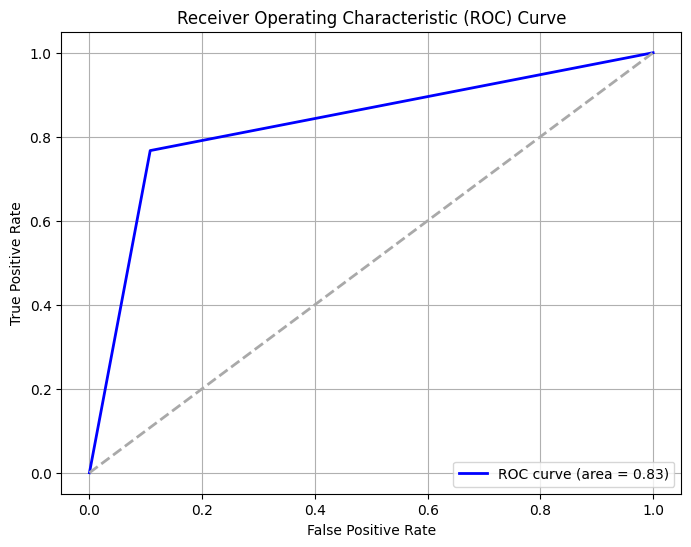

Cost-Sensitive Accuracy: 0.7005327944148447


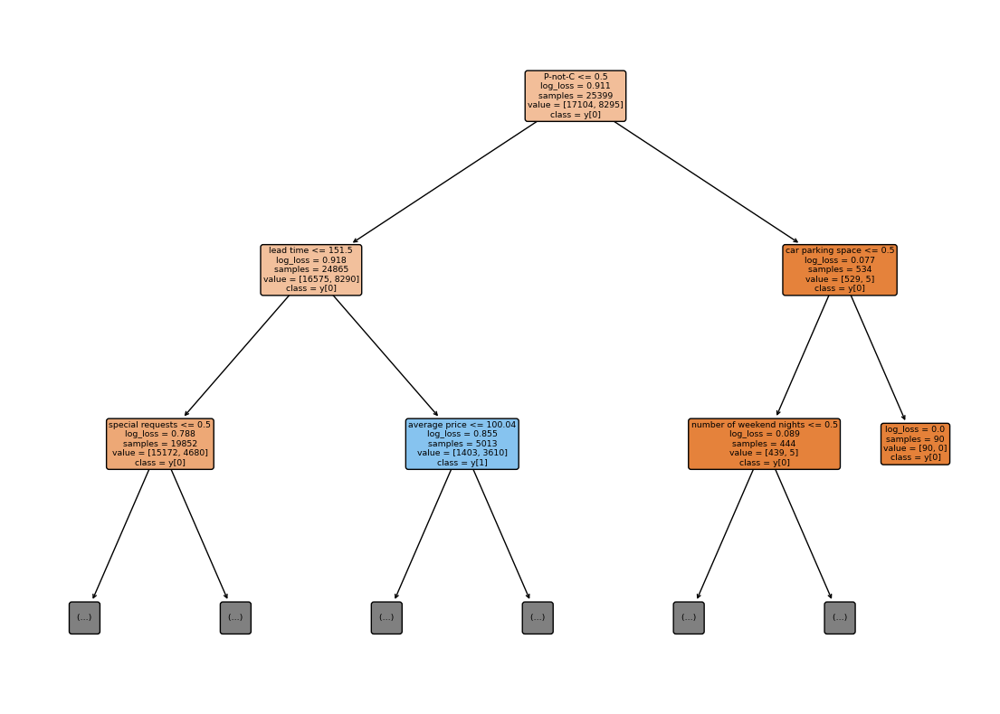

Executing decission tree with: log_loss, best, None, balanced
Mean Squared Error: 0.1523057137607937
R-squared: 0.3164355824280236
Accuracy: 0.8476942862392063
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.89      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3193  426]
 [ 403 1421]]
AUC: 0.830672471192488


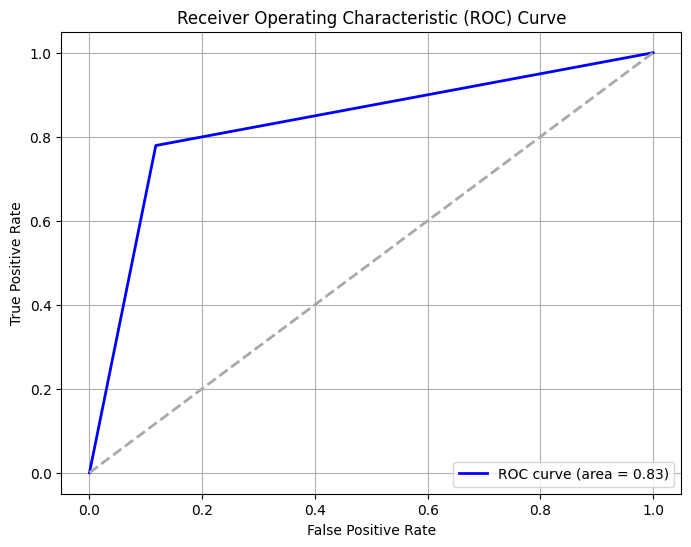

Cost-Sensitive Accuracy: 0.6953885724784126


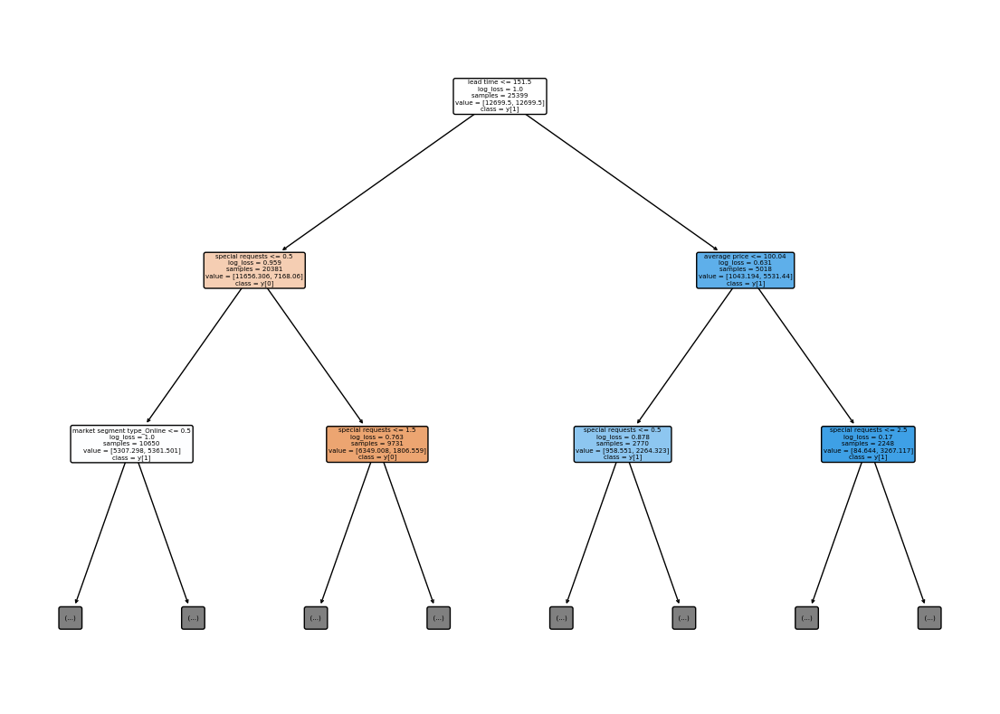

Executing decission tree with: log_loss, best, None, None
Mean Squared Error: 0.1539592136689326
R-squared: 0.3090144970744074
Accuracy: 0.8460407863310674
Classification Report:
              precision    recall  f1-score   support

           0       0.89      0.88      0.88      3619
           1       0.77      0.78      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3188  431]
 [ 407 1417]]
AUC: 0.8288851814012788


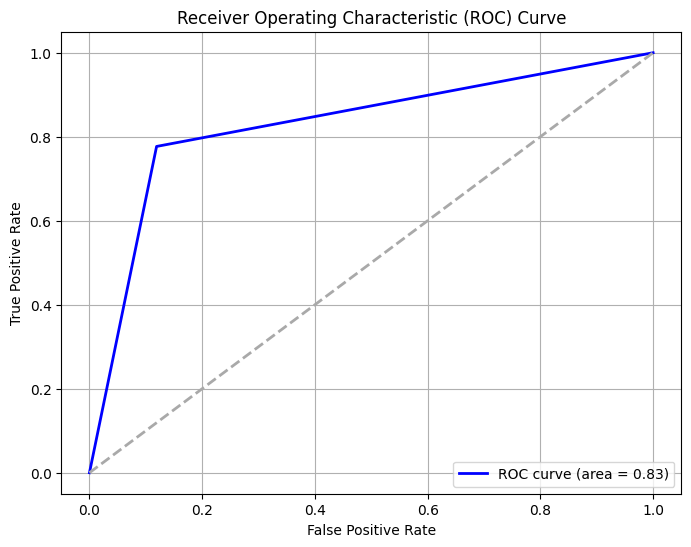

Cost-Sensitive Accuracy: 0.6920815726621348


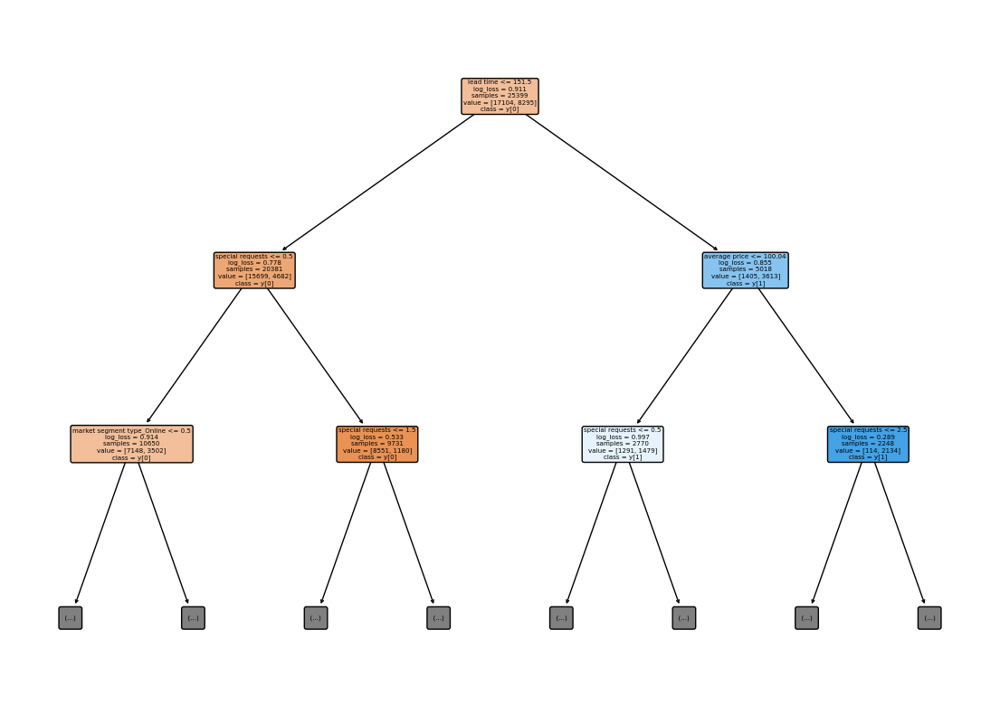

Executing decission tree with: log_loss, random, auto, balanced
Mean Squared Error: 0.16626860187396655
R-squared: 0.2537686394419316
Accuracy: 0.8337313981260335
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.87      3619
           1       0.75      0.76      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.82      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3155  464]
 [ 441 1383]]
AUC: 0.815005735445965


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


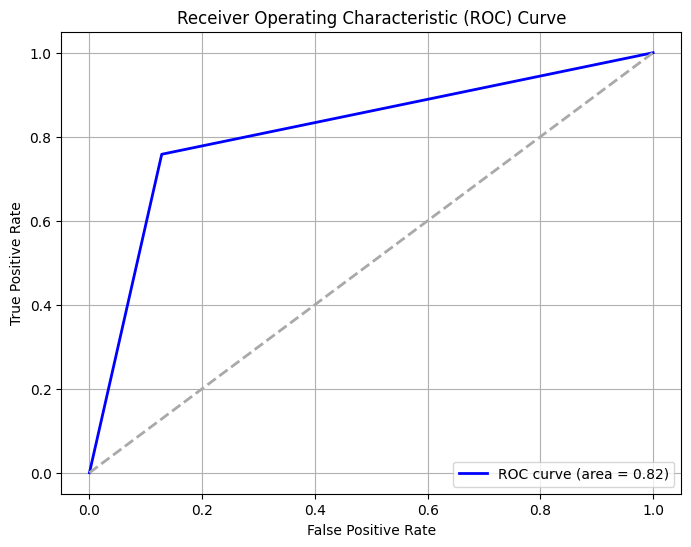

Cost-Sensitive Accuracy: 0.667462796252067


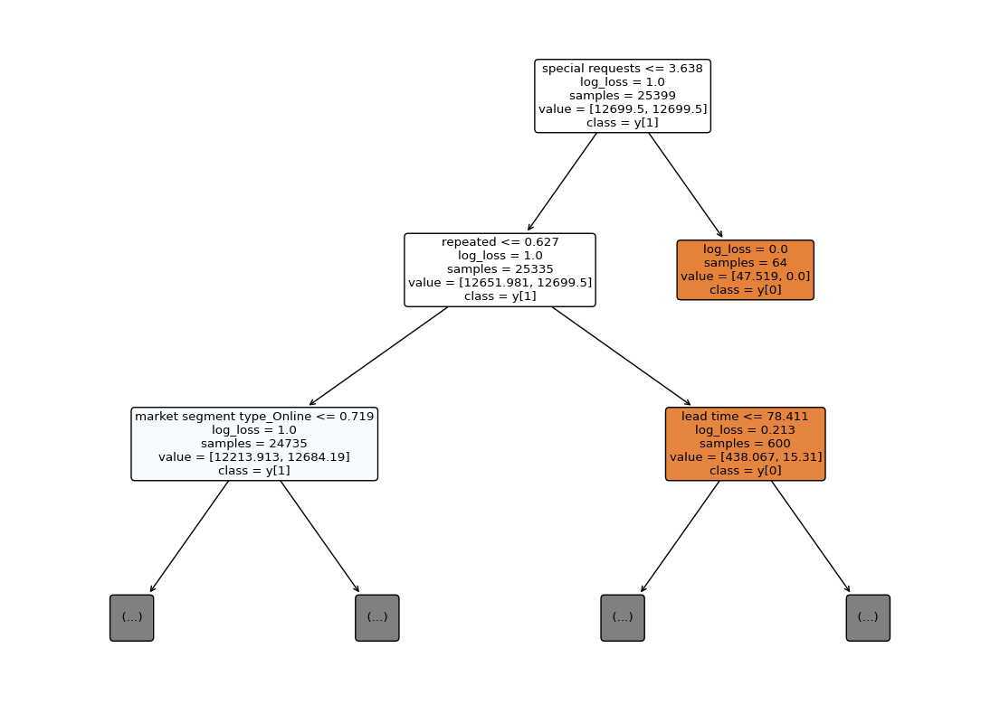

Executing decission tree with: log_loss, random, auto, None
Mean Squared Error: 0.16094065772551902
R-squared: 0.27768102558136143
Accuracy: 0.839059342274481
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.88      3619
           1       0.77      0.75      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3202  417]
 [ 459 1365]]
AUC: 0.8165650314131557


/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


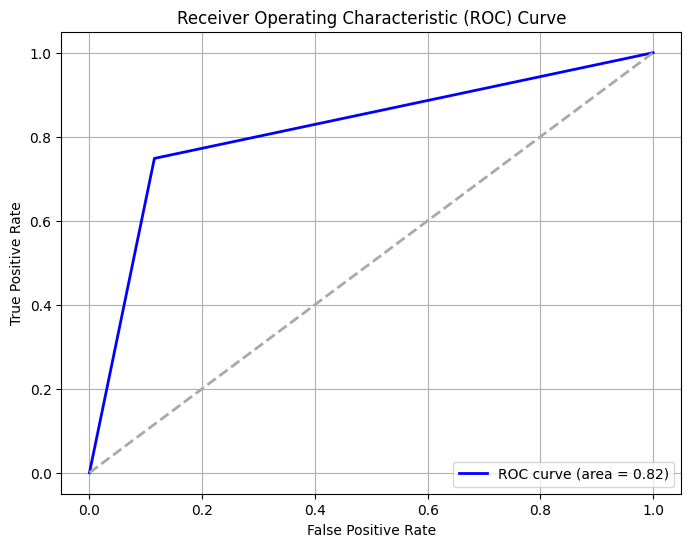

Cost-Sensitive Accuracy: 0.678118684548962


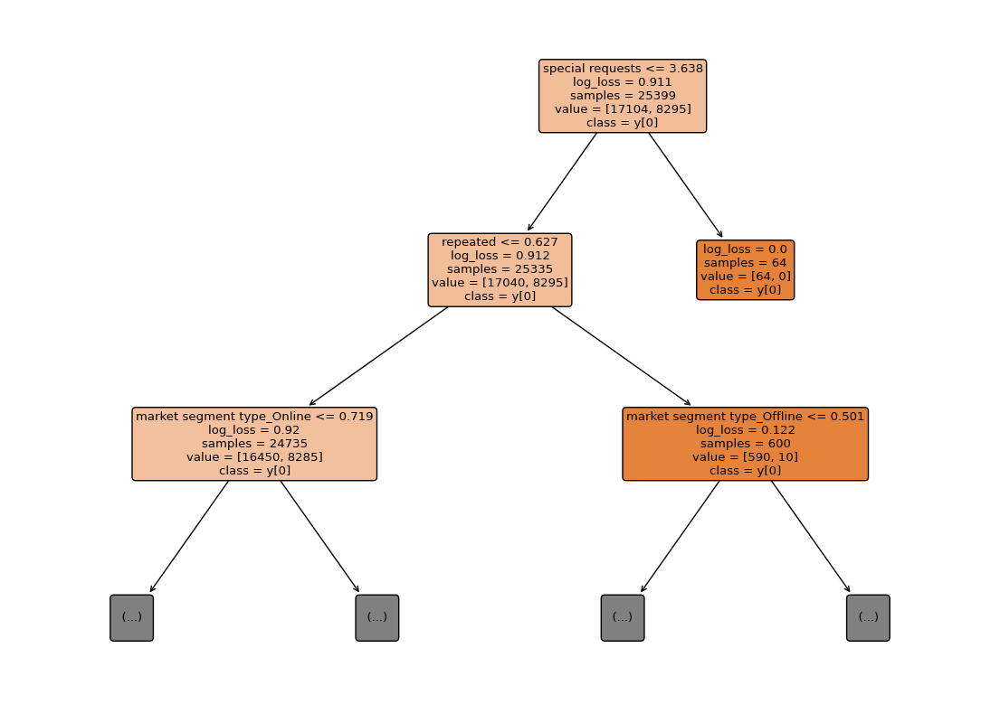

Executing decission tree with: log_loss, random, sqrt, balanced
Mean Squared Error: 0.16626860187396655
R-squared: 0.2537686394419316
Accuracy: 0.8337313981260335
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.87      0.87      3619
           1       0.75      0.76      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.82      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3155  464]
 [ 441 1383]]
AUC: 0.815005735445965


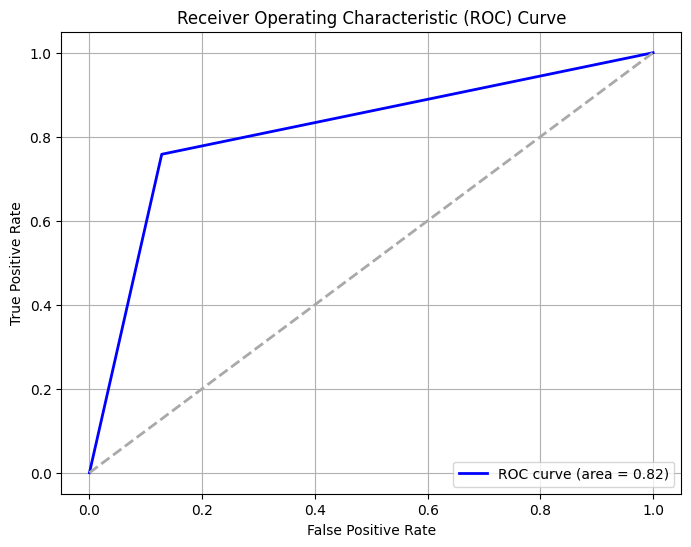

Cost-Sensitive Accuracy: 0.667462796252067


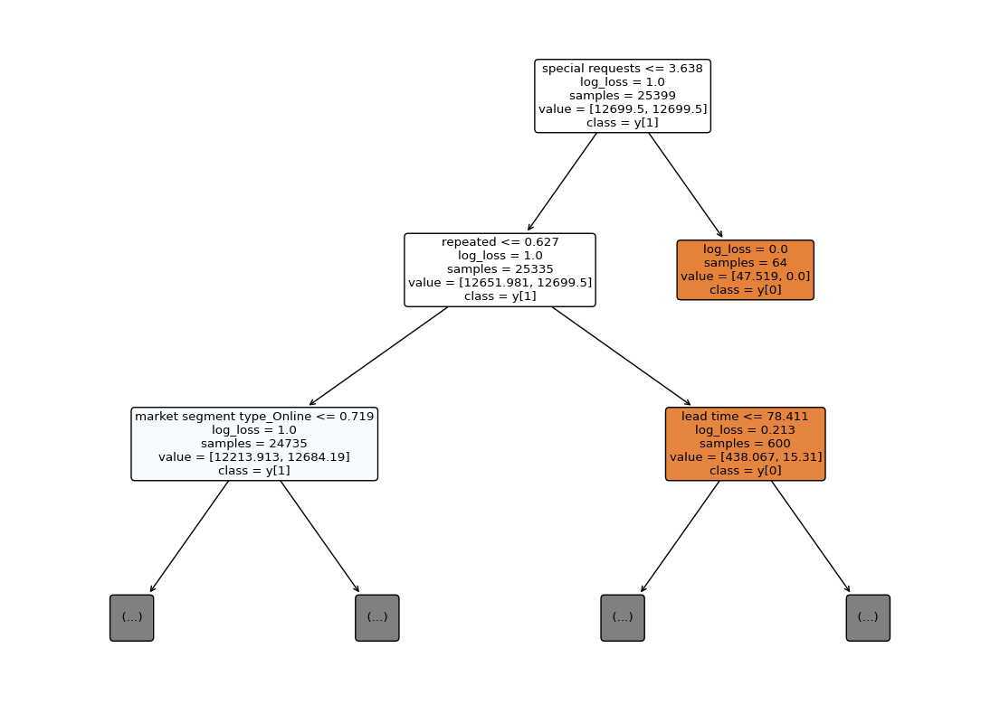

Executing decission tree with: log_loss, random, sqrt, None
Mean Squared Error: 0.16094065772551902
R-squared: 0.27768102558136143
Accuracy: 0.839059342274481
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.88      0.88      3619
           1       0.77      0.75      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3202  417]
 [ 459 1365]]
AUC: 0.8165650314131557


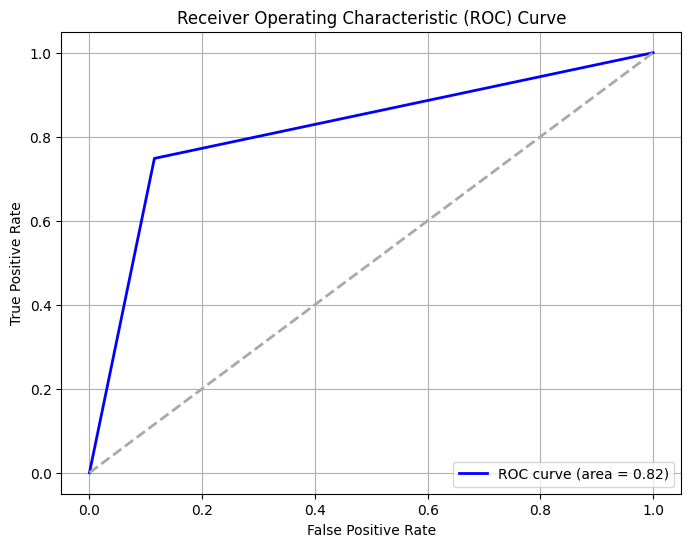

Cost-Sensitive Accuracy: 0.678118684548962


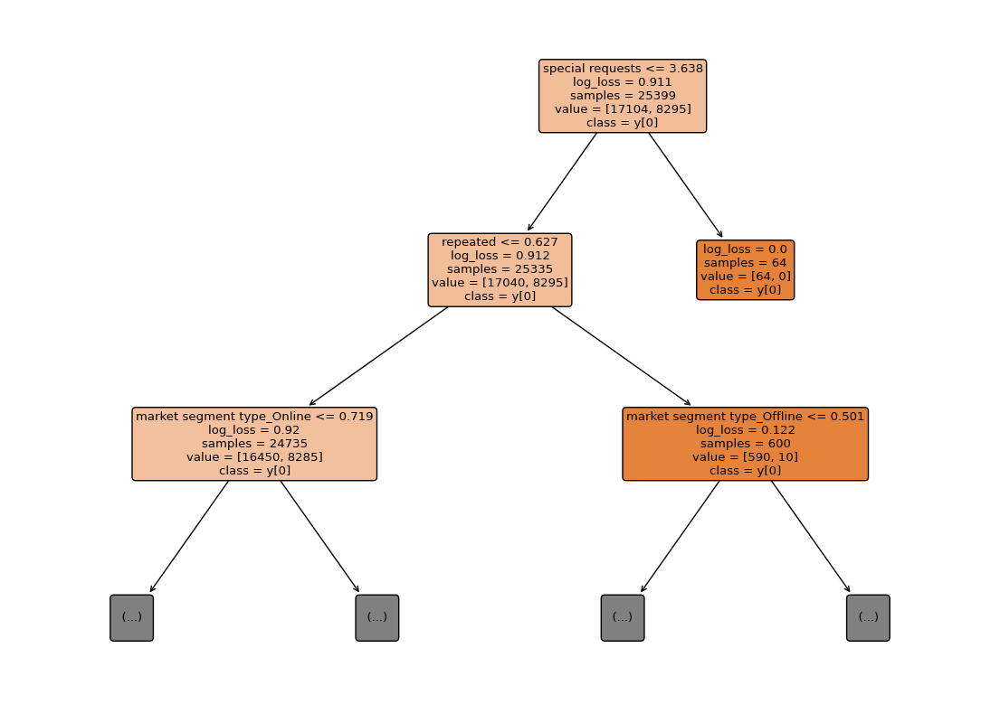

Executing decission tree with: log_loss, random, log2, balanced
Mean Squared Error: 0.16167554657358074
R-squared: 0.2743827654241987
Accuracy: 0.8383244534264193
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.76      0.76      0.76      1824

    accuracy                           0.84      5443
   macro avg       0.82      0.82      0.82      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3174  445]
 [ 435 1389]]
AUC: 0.8192755068279984


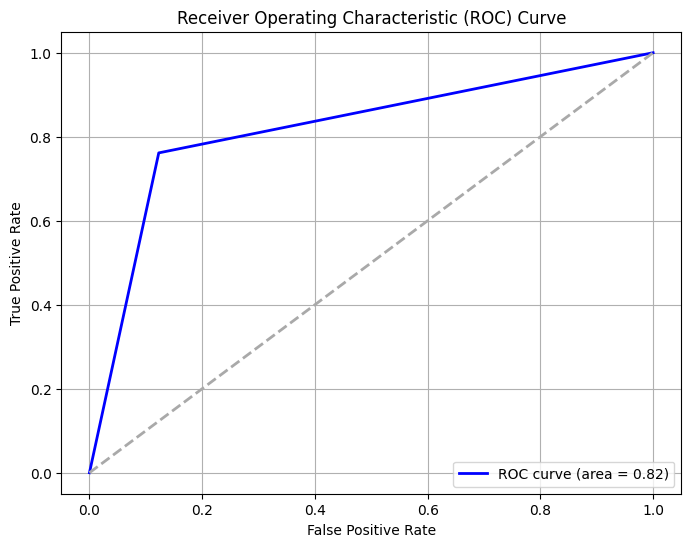

Cost-Sensitive Accuracy: 0.6766489068528385


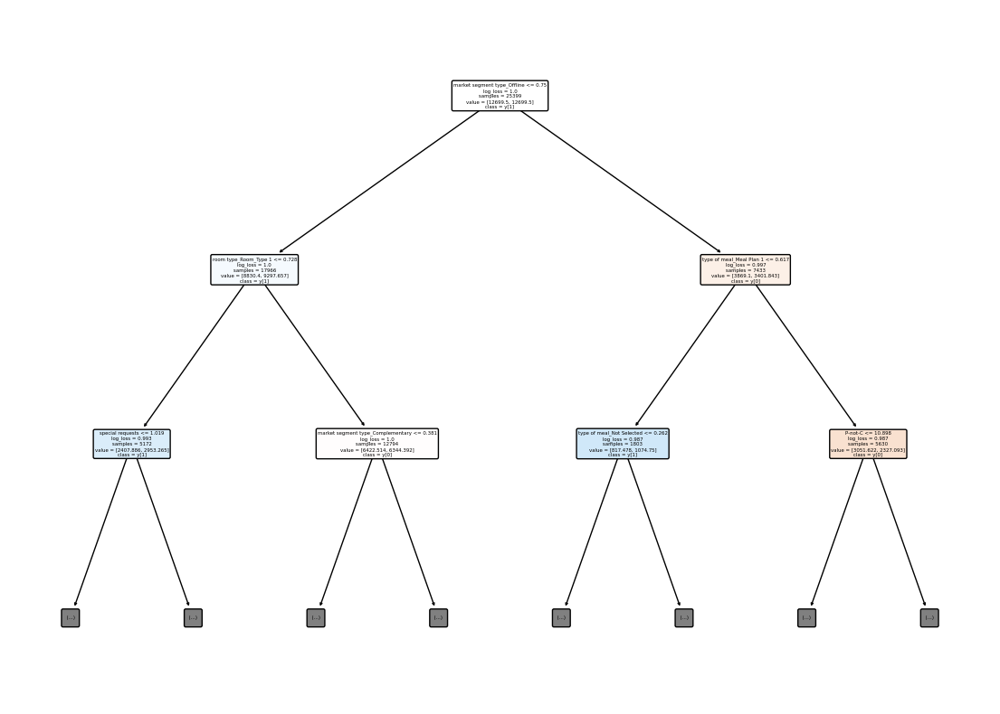

Executing decission tree with: log_loss, random, log2, None
Mean Squared Error: 0.16975932390225978
R-squared: 0.23810190369540862
Accuracy: 0.8302406760977402
Classification Report:
              precision    recall  f1-score   support

           0       0.87      0.87      0.87      3619
           1       0.75      0.74      0.75      1824

    accuracy                           0.83      5443
   macro avg       0.81      0.81      0.81      5443
weighted avg       0.83      0.83      0.83      5443

Confusion Matrix:
[[3161  458]
 [ 466 1358]]
AUC: 0.8089816235462931


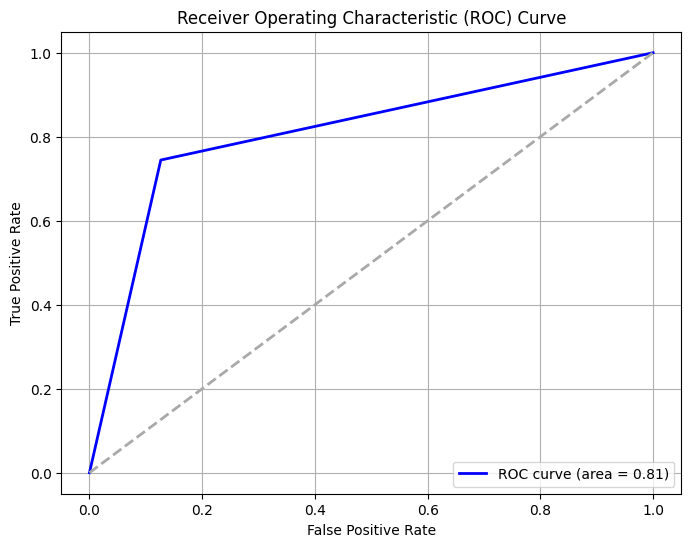

Cost-Sensitive Accuracy: 0.6604813521954804


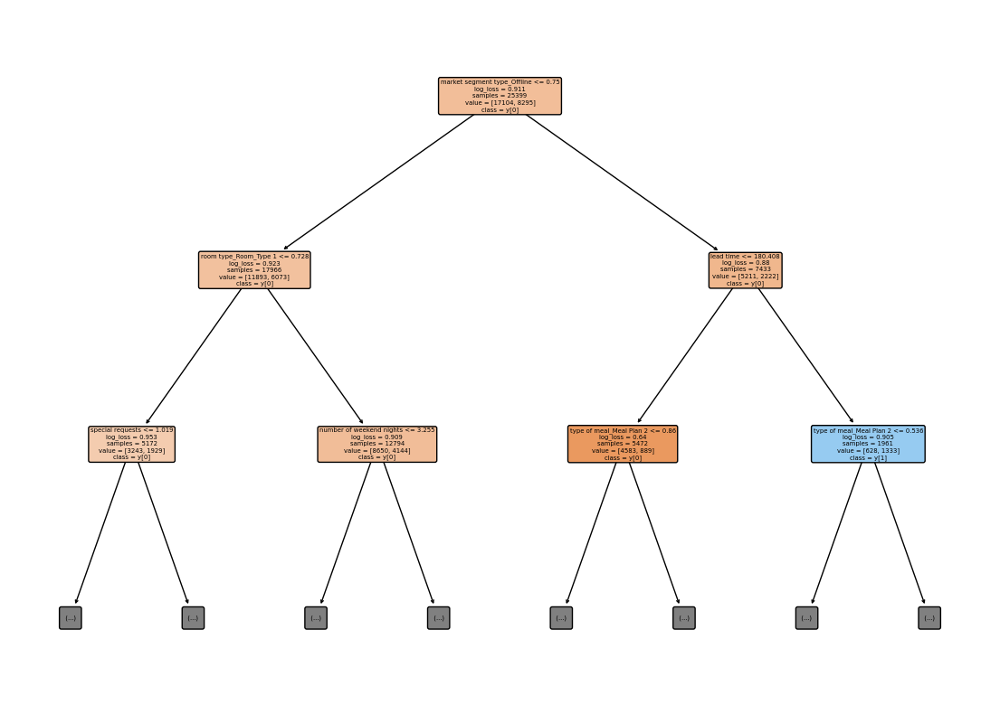

Executing decission tree with: log_loss, random, None, balanced
Mean Squared Error: 0.15451038030497888
R-squared: 0.3065408019565353
Accuracy: 0.8454896196950211
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.77      0.77      0.77      1824

    accuracy                           0.85      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.85      0.85      0.85      5443

Confusion Matrix:
[[3193  426]
 [ 415 1409]]
AUC: 0.8273829975082775


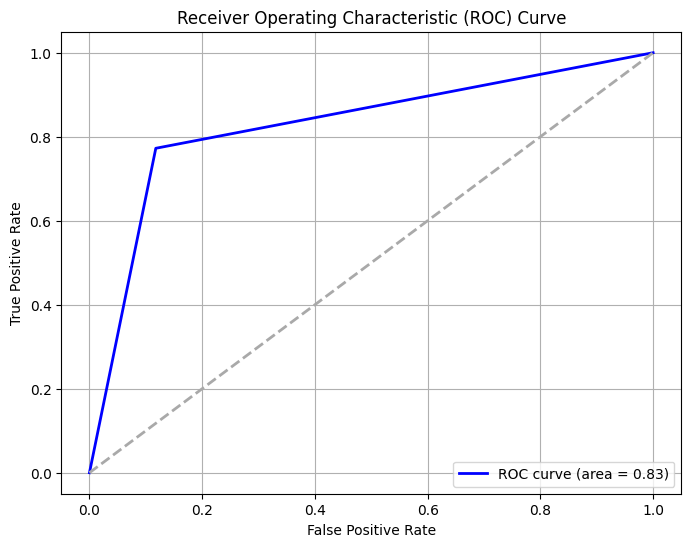

Cost-Sensitive Accuracy: 0.6909792393900422


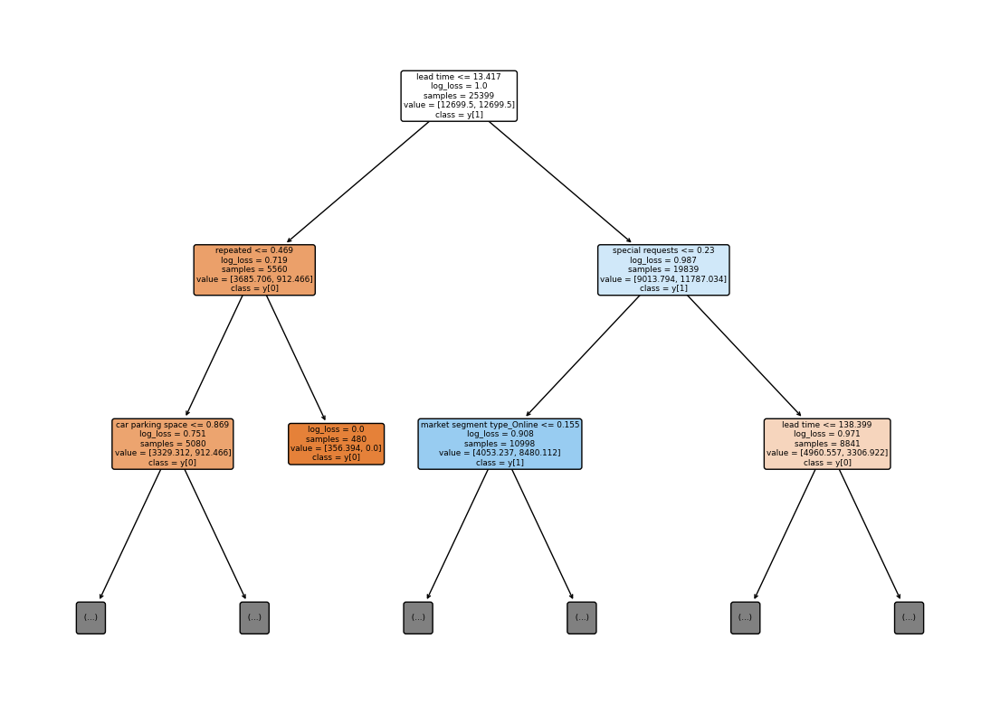

Executing decission tree with: log_loss, random, None, None
Mean Squared Error: 0.15542899136505603
R-squared: 0.302417976760082
Accuracy: 0.8445710086349439
Classification Report:
              precision    recall  f1-score   support

           0       0.88      0.88      0.88      3619
           1       0.77      0.77      0.77      1824

    accuracy                           0.84      5443
   macro avg       0.83      0.83      0.83      5443
weighted avg       0.84      0.84      0.84      5443

Confusion Matrix:
[[3198  421]
 [ 425 1399]]
AUC: 0.825332568001241


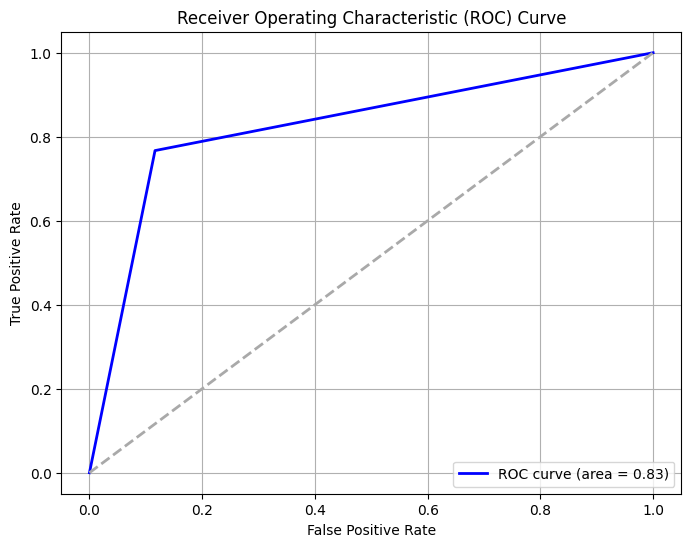

Cost-Sensitive Accuracy: 0.6891420172698879


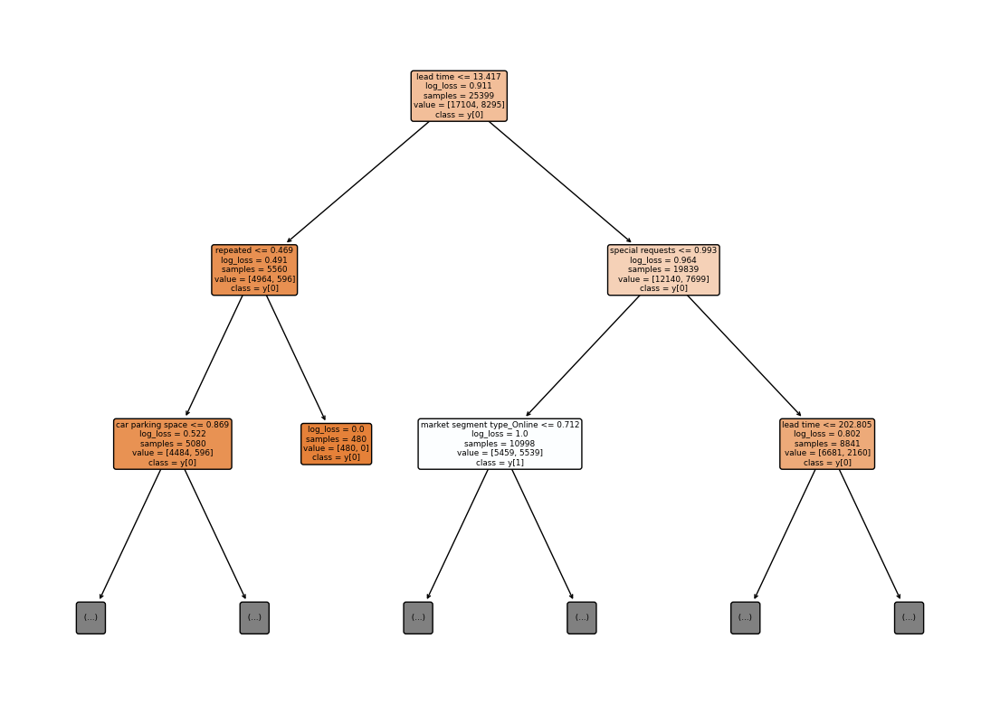

[[{'mse': 0.15101965827668565, 'r2': 0.3222075377030583, 'accuracy': 0.8489803417233144, 'auc': 0.8323194046528314, 'cost-sensitive-acc': 0.6979606834466288}, 'gini', 'best', 'auto', 'balanced'], [{'mse': 0.16130810214954988, 'r2': 0.27603189550278007, 'accuracy': 0.8386918978504502, 'auc': 0.8192799000644745, 'cost-sensitive-acc': 0.6773837957009003}, 'gini', 'best', 'auto', None], [{'mse': 0.15101965827668565, 'r2': 0.3222075377030583, 'accuracy': 0.8489803417233144, 'auc': 0.8323194046528314, 'cost-sensitive-acc': 0.6979606834466288}, 'gini', 'best', 'sqrt', 'balanced'], [{'mse': 0.16130810214954988, 'r2': 0.27603189550278007, 'accuracy': 0.8386918978504502, 'auc': 0.8192799000644745, 'cost-sensitive-acc': 0.6773837957009003}, 'gini', 'best', 'sqrt', None], [{'mse': 0.15414293588094802, 'r2': 0.3081899320351168, 'accuracy': 0.845857064119052, 'auc': 0.8294268371605997, 'cost-sensitive-acc': 0.6917141282381041}, 'gini', 'best', 'log2', 'balanced'], [{'mse': 0.1513871027007165, 'r2': 

In [35]:
criterion_values = ['gini', 'entropy', 'log_loss']
splitter_values = ['best', 'random']
max_features_values = ['auto', 'sqrt', 'log2', None] # here we can add floats and integers
class_weight_values = ['balanced', None] # here we can assign weights to each feature to make some features more important than others

scores_decission_tree = []
for criterion in criterion_values:
  for splitter in splitter_values:
    for max_features in max_features_values:
      for class_weight in class_weight_values:
        print(f'Executing decission tree with: {criterion}, {splitter}, {max_features}, {class_weight}')
        score = train_decision_tree(df, criterion, splitter, max_features, class_weight)
        scores_decission_tree.append([score, criterion, splitter, max_features, class_weight])

print(scores_decission_tree)

In [36]:
print_scores(scores_decission_tree)

[{'mse': 0.15101965827668565, 'r2': 0.3222075377030583, 'accuracy': 0.8489803417233144, 'auc': 0.8323194046528314, 'cost-sensitive-acc': 0.6979606834466288}, 'gini', 'best', 'auto', 'balanced']
[{'mse': 0.16130810214954988, 'r2': 0.27603189550278007, 'accuracy': 0.8386918978504502, 'auc': 0.8192799000644745, 'cost-sensitive-acc': 0.6773837957009003}, 'gini', 'best', 'auto', None]
[{'mse': 0.15101965827668565, 'r2': 0.3222075377030583, 'accuracy': 0.8489803417233144, 'auc': 0.8323194046528314, 'cost-sensitive-acc': 0.6979606834466288}, 'gini', 'best', 'sqrt', 'balanced']
[{'mse': 0.16130810214954988, 'r2': 0.27603189550278007, 'accuracy': 0.8386918978504502, 'auc': 0.8192799000644745, 'cost-sensitive-acc': 0.6773837957009003}, 'gini', 'best', 'sqrt', None]
[{'mse': 0.15414293588094802, 'r2': 0.3081899320351168, 'accuracy': 0.845857064119052, 'auc': 0.8294268371605997, 'cost-sensitive-acc': 0.6917141282381041}, 'gini', 'best', 'log2', 'balanced']
[{'mse': 0.1513871027007165, 'r2': 0.3205

# Support Vector Machine

In [37]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score

def train_svm(df, kernel='linear', plots=True, basic_error_eval=False, C=1, gamma='scale'):
  [df_train, df_test, df_validation] = split_train_test_validation(df)

  [X_train, y_train] = extract_features_X_y(df_train)
  [X_test, y_test] = extract_features_X_y(df_test)
  [X_validation, y_validation] = extract_features_X_y(df_validation)

  # Create the SVM model
  model = SVC(random_state=42, kernel=kernel, C=C, gamma=gamma)
  model.fit(X_train, y_train)

  # Make predictions
  predictions = model.predict(X_test)

  print(f'--- Results for SVM: kernel={kernel}, C={C}, gamma={gamma}')

  score = evaluate_results(y_test, predictions, basic_error_eval)
  if plots:

    # Apply PCA for dimensionality reduction
    pca = PCA(n_components=2)
    X_pca = pca.fit_transform(X_train)

    # Fit SVM on the reduced data
    svm_model = SVC(random_state=42, kernel=kernel, C=C, gamma=gamma)
    svm_model.fit(X_pca, y_train)

    # Create a mesh grid for plotting
    x_min, x_max = X_pca[:, 0].min() - 1, X_pca[:, 0].max() + 1
    y_min, y_max = X_pca[:, 1].min() - 1, X_pca[:, 1].max() + 1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100), np.linspace(y_min, y_max, 100))

    # Predict on the mesh grid
    Z = svm_model.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    # Plotting
    plt.contourf(xx, yy, Z, alpha=0.8, cmap='viridis')
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=y_train, s=50, edgecolor='k', cmap='viridis')


    # Highlight the support vectors
    plt.scatter(svm_model.support_vectors_[:, 0], svm_model.support_vectors_[:, 1],
                s=100, facecolors='none', edgecolors='k')

    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title('SVM Decision Boundary with PCA')
    plt.show()

  return score


In [38]:
[n1, n2, n3, n4] = slice_n(df, 4)
# train_svm(n1, 'linear')
# train_svm(n2, 'poly')
# train_svm(n3, 'rbf')
# train_svm(n4, 'sigmoid')

kernel=linear has the optimal results for the default params c=1 and gamma='scale', but is the most expensive kernel in terms of time because it has as a complexity O(n^2), let's try to combine some values of hyperparameters using cross-validation

In [ ]:
# TODO

kernels = ['poly', 'rbf', 'sigmoid']
gammas = ['scale', 'auto'] + [x / 10.0 for x in range(1, 5, 1)]

ns = slice_n(df, 10)

scores_svm = []
for C in range(1, 5, 1):
  for gamma in gammas:
    for kernel in kernels:
      scores_svm.append([train_svm(ns[0], kernel, False, True, C, gamma), C, gamma, kernel])

--- Results for SVM: kernel=poly, C=1, gamma=scale
Mean Squared Error: 0.23119266055045873
R-squared: -0.03941513032422117
Accuracy: 0.7688073394495413
--- Results for SVM: kernel=rbf, C=1, gamma=scale
Mean Squared Error: 0.23669724770642203
R-squared: -0.06416310961765492
Accuracy: 0.763302752293578
--- Results for SVM: kernel=sigmoid, C=1, gamma=scale
Mean Squared Error: 0.44036697247706424
R-squared: -0.9798383434747069
Accuracy: 0.5596330275229358


# Neural networks

In [ ]:
# Install graphviz and pydot
!apt-get -qq install -y graphviz && pip install -q pydot
import pydot

In [ ]:
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.utils import plot_model
from IPython.display import display, Image

import numpy as np
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
from tensorflow.keras.models import Model

from mlxtend.plotting import plot_decision_regions

def train_neural_network(df, seed=42):
  np.random.seed(seed)
  tf.random.set_seed(seed)
  tf.keras.utils.set_random_seed(seed)

  [df_train, df_test, df_validation] = split_train_test_validation(df)

  [X_train, y_train] = extract_features_X_y(df_train)
  [X_test, y_test] = extract_features_X_y(df_test)
  [X_validation, y_validation] = extract_features_X_y(df_validation)

  scaler = StandardScaler()
  X_train_tr = scaler.fit_transform(X_train)
  X_test_tr = scaler.transform(X_test)

  # Create the neural network model
  model = tf.keras.models.Sequential([
      tf.keras.layers.Dense(20, activation='relu', input_shape=(X_train_tr.shape[1],)),
      tf.keras.layers.Dense(50, activation='relu'),
      tf.keras.layers.Dense(1, activation='sigmoid')
  ])

  # Compile the model
  model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])

  # Train the model
  model.fit(X_train_tr, y_train, epochs=10, batch_size=32, validation_split=0.2)

  # Evaluate the model
  loss, accuracy = model.evaluate(X_test_tr, y_test)
  print(f"Test Accuracy: {accuracy}")
  print(f"SEED: {seed}")

  # print(model.summary())


  # Generate the plot
  plot_file_path = 'model_plot.png'
  plot_model(model, to_file=plot_file_path, show_shapes=True, show_layer_names=True)

  # Display the image
  display(Image(filename=plot_file_path))

  # model_file = 'my_model.h5'
  # model.save(model_file)

  subset_size = 1000  # Adjust this based on your dataset size
  indices = np.random.choice(X_train.index, subset_size, replace=False)
  X_subset = X_train.loc[indices]
  y_subset = y_train[indices]

  # Reduce X to two dimensions using PCA
  pca = PCA(n_components=2, random_state=seed)
  X_reduced = pca.fit_transform(X_train_tr)

  # Create a meshgrid in the reduced space
  x_min, x_max = X_reduced[:, 0].min() - 1, X_reduced[:, 0].max() + 1
  y_min, y_max = X_reduced[:, 1].min() - 1, X_reduced[:, 1].max() + 1
  xx, yy = np.meshgrid(np.linspace(x_min, x_max, num=300),
                      np.linspace(y_min, y_max, num=300))

  # Pad the meshgrid points to match the original feature space
  num_original_features = X_train_tr.shape[1]
  mesh_points_padded = np.c_[xx.ravel(), yy.ravel(), np.zeros((len(xx.ravel()), num_original_features - 2))]

  # Predict the classes for the padded meshgrid points using the original model
  Z = model.predict(mesh_points_padded)
  Z = (Z > 0.5).astype(int).reshape(xx.shape)

  # print(Z)

  # Plot the decision boundary in the PCA reduced feature space
  plt.contourf(xx, yy, Z, alpha=0.3)
  # plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=y_train, edgecolor='k')
  plt.title('Decision Boundary in PCA Reduced Feature Space')
  plt.xlabel('PCA Component 1')
  plt.ylabel('PCA Component 2')
  plt.show()

  plt.contourf(xx, yy, Z, alpha=0.3)
  plt.scatter(X_reduced[:, 0], X_reduced[:, 1], c=y_train, edgecolor='k')
  plt.title('Decision Boundary in PCA Reduced Feature Space')
  plt.xlabel('PCA Component 1')
  plt.ylabel('PCA Component 2')
  plt.show()


In [ ]:
# for seed in range(1, 2000, 100):
#   train_neural_network(df, seed)

# After some iterations, we will use the seed 401, which has as accuracy 0.832,
# and we can see the decision boundary clearly in two dimensions, this plot representation
# is not accurated because when we reduce the dimensionality we are loosing resolution
# but it is useful to see how the decision boundary is shown, we can see that
# is not linear.
train_neural_network(df, 401)

In [ ]:
train_neural_network(df, 401)